In [211]:
import warnings
warnings.filterwarnings('ignore')

In [212]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point
import matplotlib as mpl
import pyproj
from scipy.spatial import Voronoi
from pykrige.uk import UniversalKriging
from shapely.geometry import Point
import seaborn as sns

In [213]:
#municipios 
municipios=gpd.read_file(r"C:\Users\Documents\unal\analisis geoespacial\municipios.shp")
print(municipios)

    COD_MPIO             MPIO_NOMBR        SUBREGION  ALERTA DESCRIPCI   
0      05761               SOPETRÁN        OCCIDENTE       0      None  \
1      05425                  MACEO  MAGDALENA MEDIO       0      None   
2      05501                  OLAYA        OCCIDENTE       0      None   
3      05264             ENTRERRIOS            NORTE       0      None   
4      05042  SANTA FE DE ANTIOQUIA        OCCIDENTE       1      None   
..       ...                    ...              ...     ...       ...   
120    05031                 AMALFI         NORDESTE       0      None   
121    05893                  YONDÓ  MAGDALENA MEDIO       0      None   
122    05091                BETANIA         SUROESTE       0      None   
123    05086                BELMIRA            NORTE       0      None   
124    05411               LIBORINA        OCCIDENTE       0      None   

    SymbolID                                           geometry  
0       None  POLYGON ((-8427867 738709, -842

In [214]:
#separando solo por mis municipios del valle de aburrá 
munic_sle=["MEDELLÍN", "ITAGÜÍ", "SABANETA","ENVIGADO","GIRARDOTA","BELLO","LA ESTRELLA", "CALDAS", "COPACABANA","BARBOSA"]
municipios=municipios[municipios["MPIO_NOMBR"].isin(munic_sle)]
print(municipios)

   COD_MPIO   MPIO_NOMBR        SUBREGION  ALERTA DESCRIPCI SymbolID   
5     05129       CALDAS  VALLE DE ABURRA       0      None     None  \
9     05631     SABANETA  VALLE DE ABURRA       3      None     None   
25    05212   COPACABANA  VALLE DE ABURRA       0      None     None   
29    05079      BARBOSA  VALLE DE ABURRA       0      None     None   
58    05088        BELLO  VALLE DE ABURRA       3      None     None   
60    05308    GIRARDOTA  VALLE DE ABURRA       3      None     None   
95    05001     MEDELLÍN  VALLE DE ABURRA       0      None     None   
96    05380  LA ESTRELLA  VALLE DE ABURRA       0      None     None   
98    05360       ITAGÜÍ  VALLE DE ABURRA       0      None     None   
99    05266     ENVIGADO  VALLE DE ABURRA       0      None     None   

                                             geometry  
5   POLYGON ((-8423133 682404, -8423156 682478, -8...  
9   POLYGON ((-8416321 687413, -8416447 687349, -8...  
25  POLYGON ((-8403569 716459, -8403565

In [215]:
municipios.to_file(r'C:\Users\Documents\unal\analisis geoespacial\Trabajo3\MUNICIPIOS.shp')

In [216]:
municipios.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [217]:
#Estaciones pm2.5
dpm25=pd.read_csv(r"C:\Users\Documents\unal\analisis geoespacial\datos pm25\dffinalpm25.csv")
print(dpm25)

     fecha_hora  Codigo_calidad       pm25  pp_diaria  temperatura  superado
0    2022-03-01              12  23.095238      1.524    21.068653         1
1    2022-03-01              90  16.620707      4.064    19.842549         1
2    2022-03-01              69  18.233983      1.016    18.282292         1
3    2022-03-01              94   5.529111      0.508    13.678354         0
4    2022-03-01              84  18.473157      1.778    19.714701         1
..          ...             ...        ...        ...          ...       ...
460  2022-03-31              87  16.540717      2.286    18.401757         1
461  2022-03-31              69  24.250258     11.684    17.666806         1
462  2022-03-31              38  24.083333      0.762    18.023326         1
463  2022-03-31              82  13.351865      2.286    19.426250         0
464  2022-03-31              94   7.542362      8.636    12.919854         0

[465 rows x 6 columns]


In [218]:
dpm25=dpm25.rename(columns={"Codigo_calidad":"Codigo"})

In [219]:
dpm25

,fecha_hora,Codigo,pm25,pp_diaria,temperatura,superado
0,2022-03-01,12,23.095238,1.524,21.068653,1
1,2022-03-01,90,16.620707,4.064,19.842549,1
2,2022-03-01,69,18.233983,1.016,18.282292,1
3,2022-03-01,94,5.529111,0.508,13.678354,0
4,2022-03-01,84,18.473157,1.778,19.714701,1
...,...,...,...,...,...,...
460,2022-03-31,87,16.540717,2.286,18.401757,1
461,2022-03-31,69,24.250258,11.684,17.666806,1
462,2022-03-31,38,24.083333,0.762,18.023326,1
463,2022-03-31,82,13.351865,2.286,19.426250,0


In [220]:
dpm25.describe()

,Codigo,pm25,pp_diaria,temperatura,superado
count,465.000000,465.000000,465.000000,465.000000,465.000000
mean,75.333333,20.863818,5.578168,18.968743,0.733333
std,21.080272,8.131293,7.688243,1.988037,0.442693
min,12.000000,4.332727,0.000000,11.644944,0.000000
25%,78.000000,14.591093,0.000000,18.304444,0.000000
50%,82.000000,19.434886,2.032000,19.253771,1.000000
75%,87.000000,26.648183,8.382000,20.133722,1.000000
max,94.000000,47.087908,40.386000,22.426111,1.000000


In [221]:
#localización de estaciones 
estpm=pd.read_csv(r"C:\Users\Documents\unal\analisis geoespacial\Trabajo3\locestaciones.csv")
estpm

,Unnamed: 0,Codigo,Estacion,Ciudad,Longitud,Latitud
0,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256
1,194998,38,Itagüí - I.E. Concejo Municipal de Itagüí,Itagüí,-75.64436,6.16850
2,398882,69,Caldas - E U Joaquín Aristizabal,Caldas,-75.63776,6.09308
3,510060,78,La Estrella - Hospital,La Estrella,-75.64417,6.15553
4,634004,79,"Medellín, Altavista - I.E. Pedro Octavio Amado",Medellin,-75.61060,6.22189
5,754420,80,"Medellín, Villahermosa - Planta de producción ...",Medellin,-75.54826,6.25891
6,874154,81,Barbosa - Torre Social,Barbosa,-75.33040,6.43696
7,989170,82,Copacabana - Ciudadela Educativa La Vida,Copacabana,-75.50475,6.34536
8,1109608,83,"Medellin, Belén - I.E Pedro Justo Berrio",Medellin,-75.61047,6.23723
9,1229588,84,"Medellín, El Poblado - I.E INEM sede Santa Cat...",Medellin,-75.56095,6.19987


In [222]:
geometry = [Point(xy) for xy in zip(estpm['Longitud'], estpm['Latitud'])]

# Convertir a GeoDataFrame
estpm = gpd.GeoDataFrame(estpm, geometry=geometry)

# Establecer el sistema de referencia de coordenadas (CRS)
estpm.crs = 'EPSG:4326'

In [223]:
# Asegurar que municipios y estpm estén en EPSG:4326 (WGS84)
municipios = municipios.to_crs(epsg=4326)
estpm = estpm.to_crs(epsg=4326)


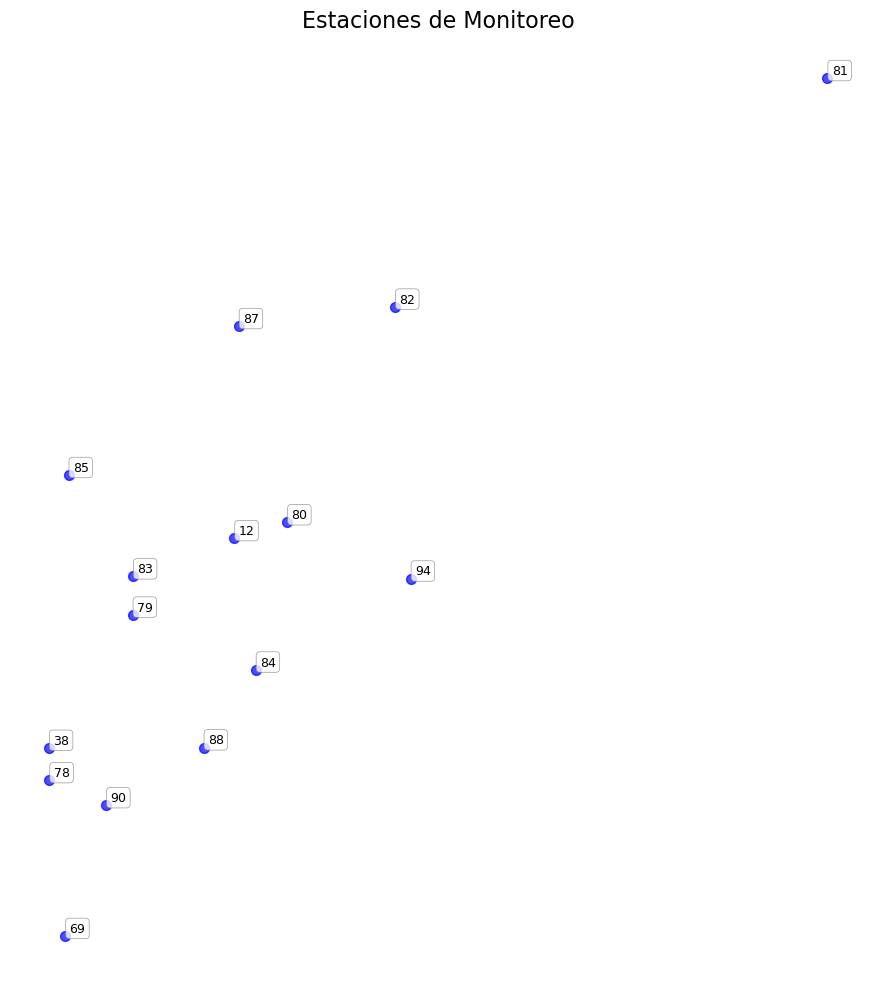

In [398]:
import matplotlib.pyplot as plt
import geopandas as gpd

# Asumiendo que 'estpm' es tu GeoDataFrame y tiene una columna 'Codigo'
fig, ax = plt.subplots(figsize=(12, 10))

# Graficar las geometrías (puntos)
estpm.plot(ax=ax, color='blue', markersize=50, alpha=0.7)

# Añadir etiquetas con los códigos
for x, y, label in zip(estpm.geometry.x, estpm.geometry.y, estpm['Codigo']):
    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points",
                fontsize=9, bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", lw=0.5, alpha=0.8))

# Personalización del mapa
ax.set_title('Estaciones de Monitoreo', fontsize=16)
ax.set_axis_off()  # Opcional: oculta los ejes

# Mostrar el mapa
plt.tight_layout()
plt.show()

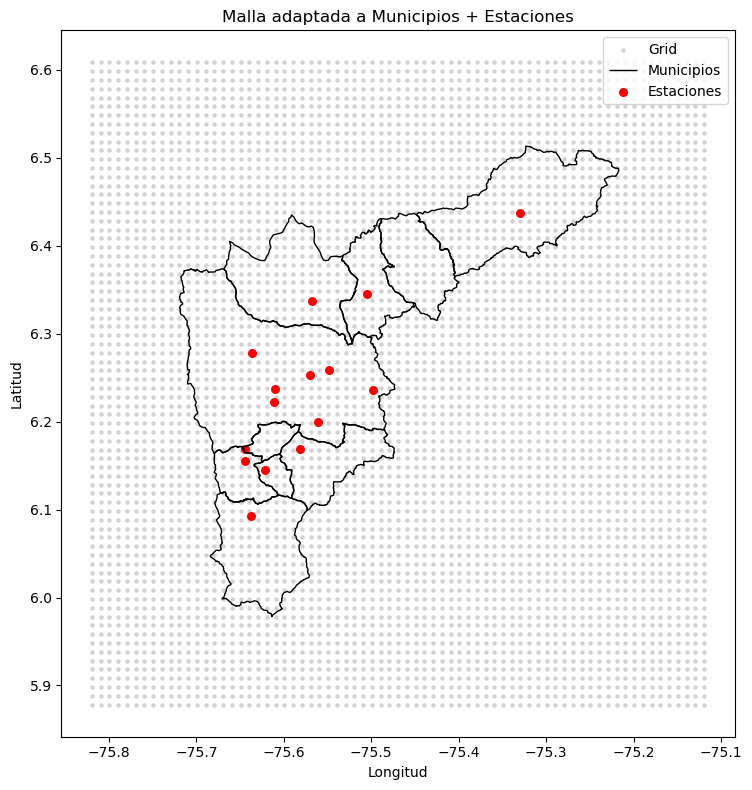

In [224]:

# --- 2. Obtener límites del shapefile de municipios ---
bounds = municipios.total_bounds  # [xmin, ymin, xmax, ymax]
lon_min, lat_min, lon_max, lat_max = bounds

# Opcional: expandir límites un poco para margen visual
margin = 0.1
lon_min -= margin
lon_max += margin
lat_min -= margin
lat_max += margin

# --- 3. Crear malla (grid) basada en el shape ---
grid_res = 0.01  # ajusta la resolución si es necesario
grid_lon, grid_lat = np.meshgrid(
    np.arange(lon_min, lon_max, grid_res),
    np.arange(lat_min, lat_max, grid_res)
)

# --- 4. Graficar ---
fig, ax = plt.subplots(figsize=(10, 8))

# Malla como puntos grises
ax.scatter(grid_lon, grid_lat, color='lightgray', s=5, label='Grid')

# Municipios
municipios.boundary.plot(ax=ax, color='black', linewidth=1, label='Municipios')

# Estaciones
estpm.plot(ax=ax, color='red', markersize=30, label='Estaciones')

# Estética
ax.set_title("Malla adaptada a Municipios + Estaciones")
ax.set_xlabel("Longitud")
ax.set_ylabel("Latitud")
ax.legend()
plt.tight_layout()
plt.show()


In [11]:
Estaciones=estpm.merge(
    dpm25,
    on='Codigo',  # Columna común para unir
    how='right'  # 'right' para mantener todas las estaciones de df_meteo
    # También puedes usar 'inner' para solo las estaciones que coincidan en ambos
)

In [15]:
Estaciones

,Unnamed: 0,Codigo,Estacion,Ciudad,Longitud,Latitud,geometry,fecha_hora,pm25,pp_diaria,temperatura,superado
0,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),2022-03-01,23.095238,1.524,21.068653,1
1,1704290,90,Sabaneta - I.E. Rafael J. Mejía,Sabaneta,-75.62126,6.14550,POINT (-75.62126 6.1455),2022-03-01,16.620707,4.064,19.842549,1
2,398882,69,Caldas - E U Joaquín Aristizabal,Caldas,-75.63776,6.09308,POINT (-75.63776 6.09308),2022-03-01,18.233983,1.016,18.282292,1
3,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),2022-03-01,5.529111,0.508,13.678354,0
4,1229588,84,"Medellín, El Poblado - I.E INEM sede Santa Cat...",Medellin,-75.56095,6.19987,POINT (-75.56095 6.19987),2022-03-01,18.473157,1.778,19.714701,1
...,...,...,...,...,...,...,...,...,...,...,...,...
460,1467660,87,Bello - I.E. Fernando Vélez,Bello,-75.56780,6.33755,POINT (-75.5678 6.33755),2022-03-31,16.540717,2.286,18.401757,1
461,398882,69,Caldas - E U Joaquín Aristizabal,Caldas,-75.63776,6.09308,POINT (-75.63776 6.09308),2022-03-31,24.250258,11.684,17.666806,1
462,194998,38,Itagüí - I.E. Concejo Municipal de Itagüí,Itagüí,-75.64436,6.16850,POINT (-75.64436 6.1685),2022-03-31,24.083333,0.762,18.023326,1
463,989170,82,Copacabana - Ciudadela Educativa La Vida,Copacabana,-75.50475,6.34536,POINT (-75.50475 6.34536),2022-03-31,13.351865,2.286,19.426250,0


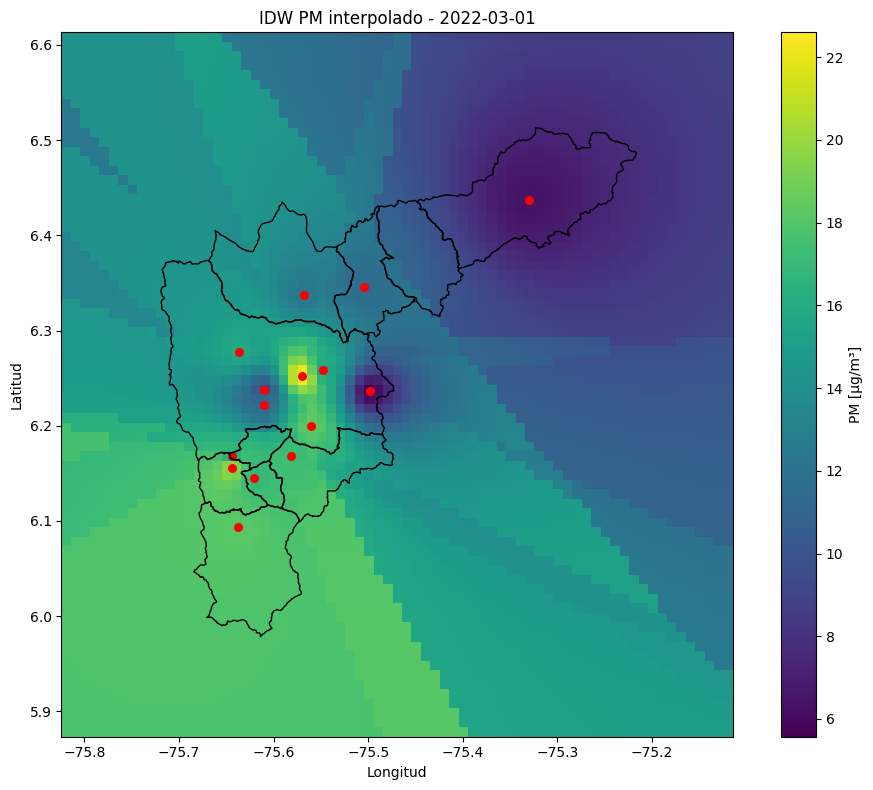

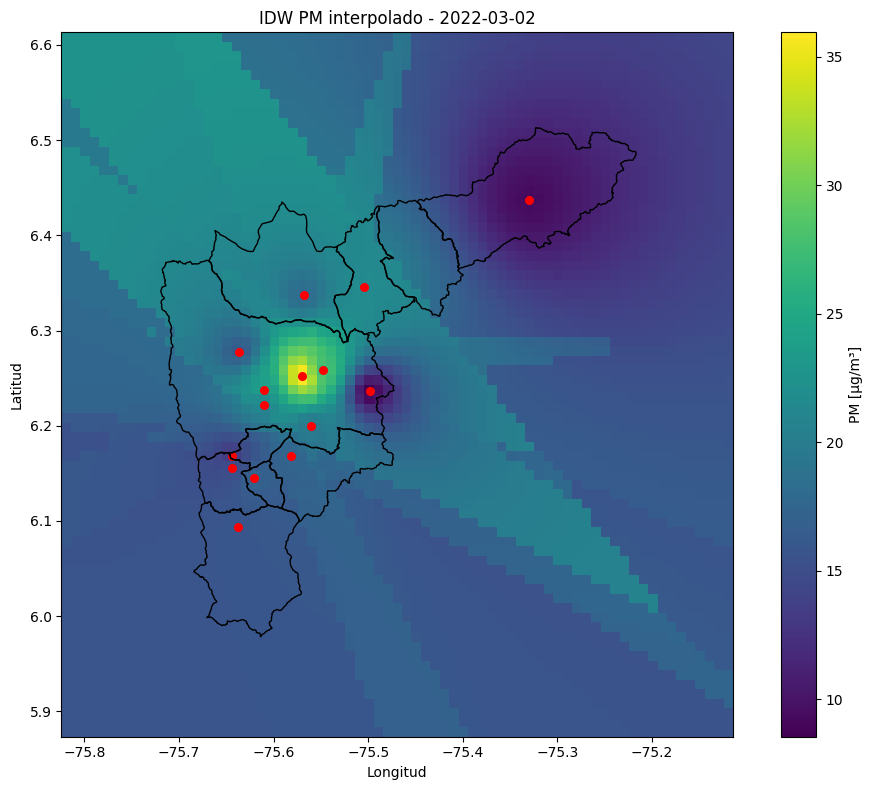

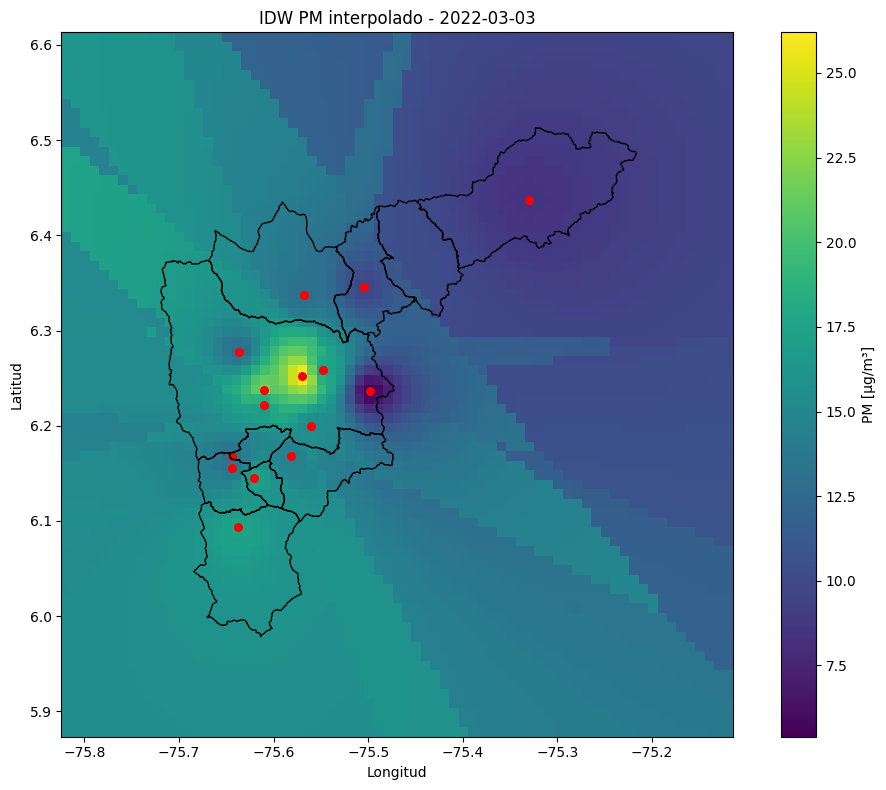

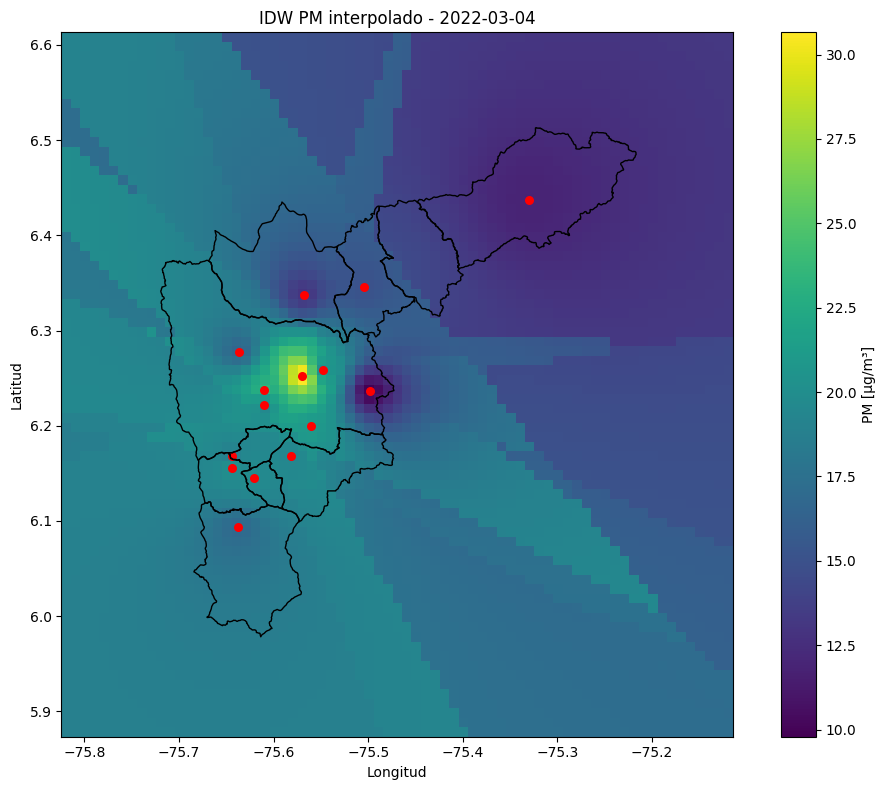

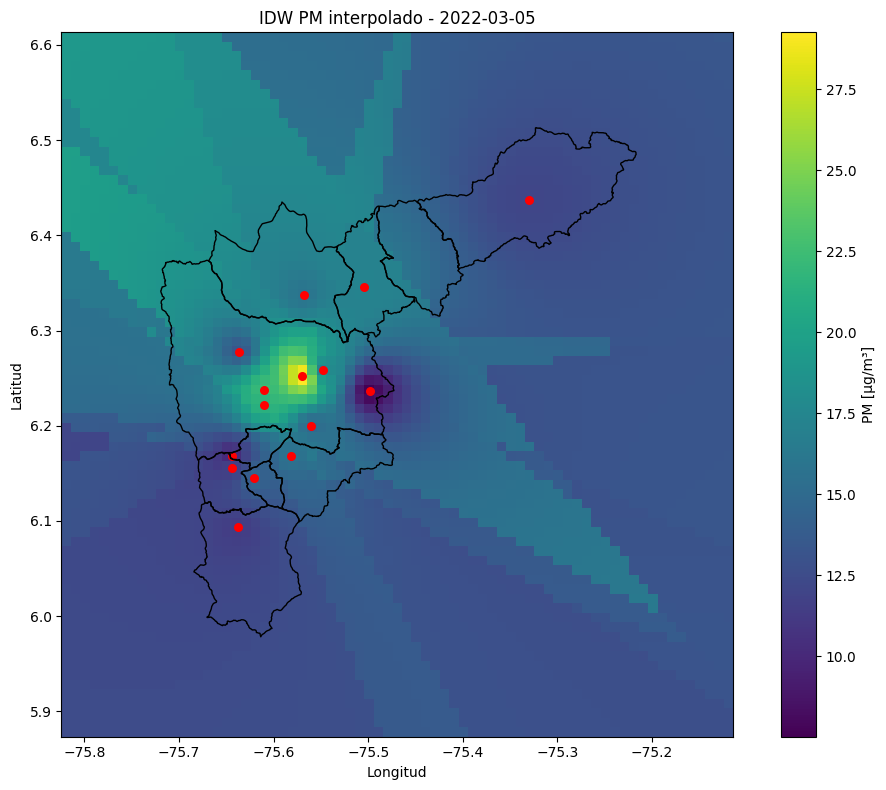

...

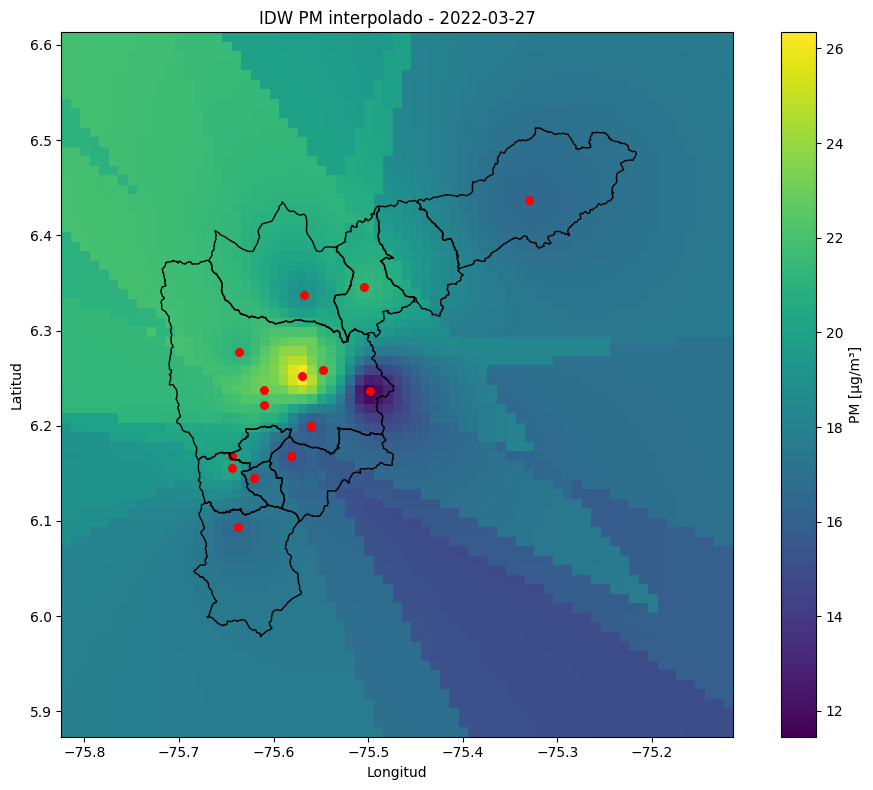

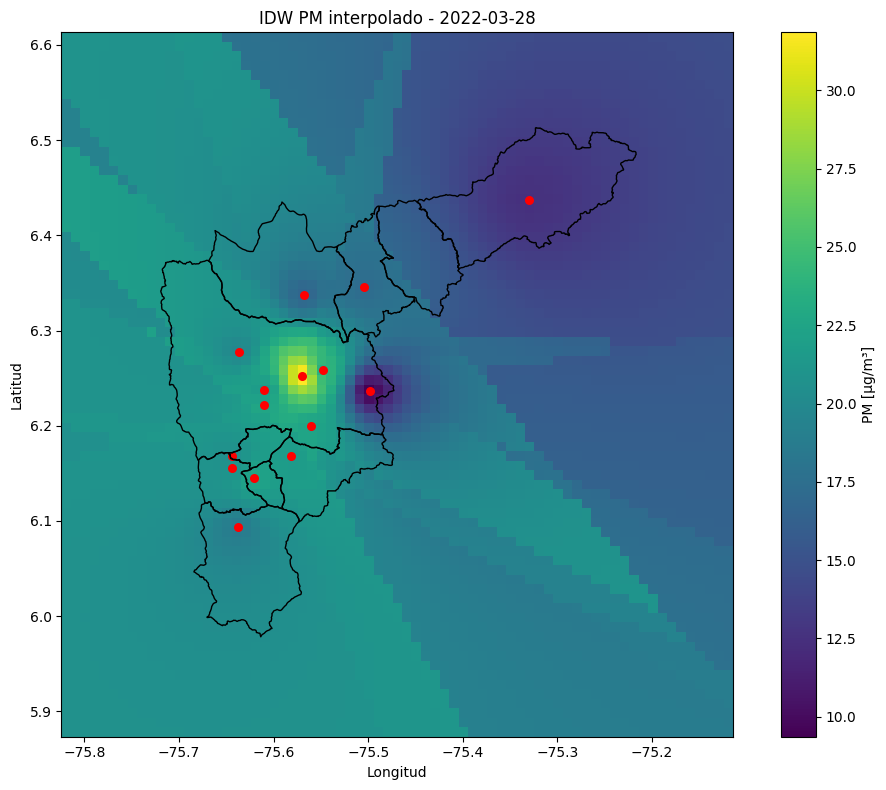

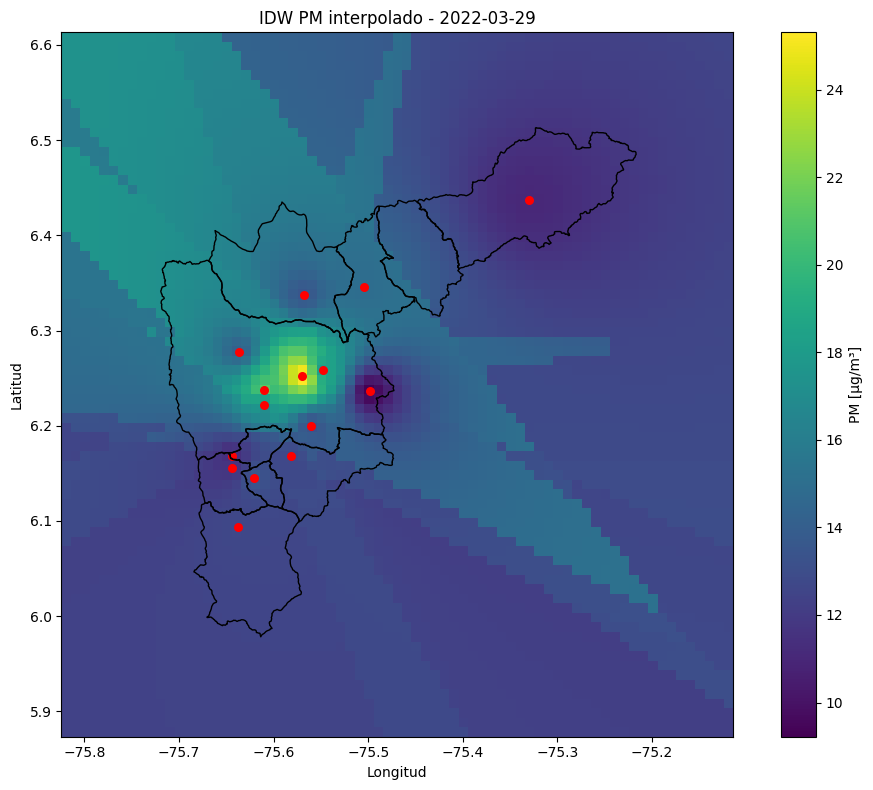

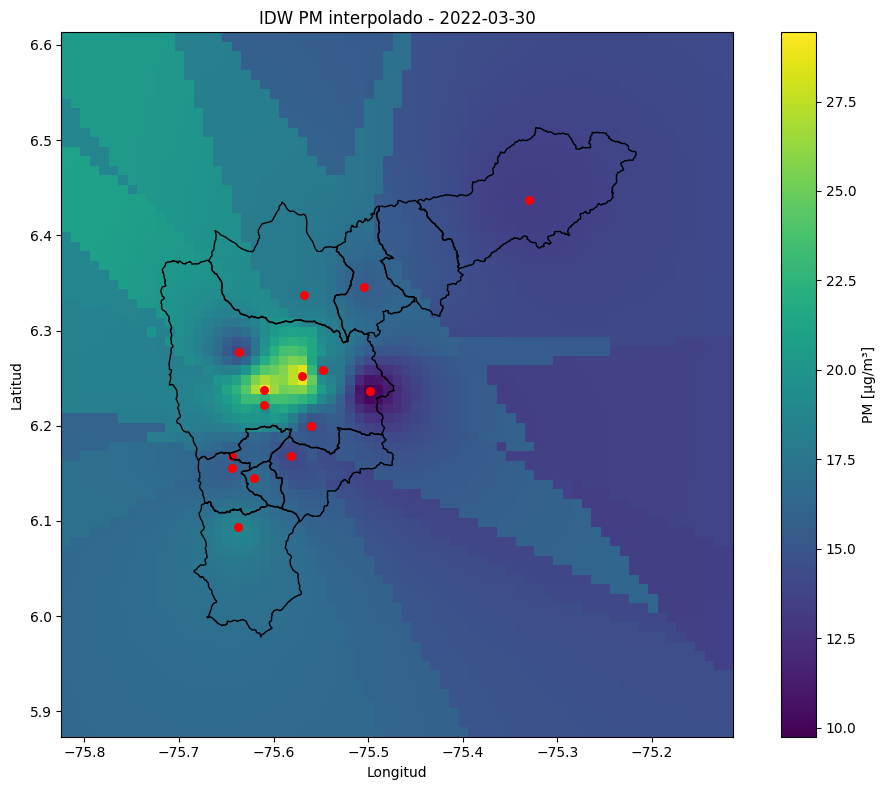

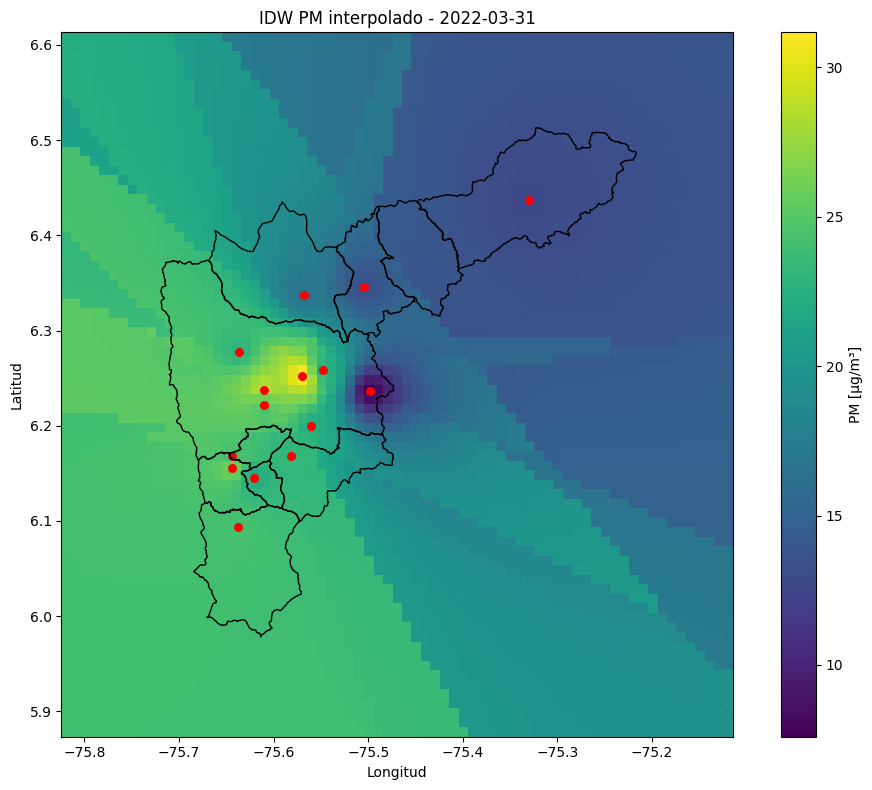

In [36]:
from sklearn.neighbors import KNeighborsRegressor
from functools import partial
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# --- Definir pesos IDW ---
def idw_weights(distances, p=2):
    distances = distances.copy()
    distances[distances == 0] = 1e-12
    return 1 / distances**p

weights_idw = partial(idw_weights, p=2)

# --- Preparar grid de interpolación ---
grid_points = np.vstack([grid_lon.ravel(), grid_lat.ravel()]).T

# --- Iterar sobre días únicos ---
for fecha in Estaciones['fecha_hora'].unique():
    df_dia = Estaciones[Estaciones['fecha_hora'] == fecha].dropna(subset=['pm25'])

    # Entradas para el modelo
    X_train = df_dia[['Longitud', 'Latitud']].values
    y_train = df_dia['pm25'].values

    # Asegurar que hay suficientes datos
    if len(X_train) < 3:
        print(f"No se interpola {fecha}, pocos datos.")
        continue

    # Entrenar modelo IDW con KNN
    model = KNeighborsRegressor(n_neighbors=min(5, len(X_train)), weights=weights_idw)
    model.fit(X_train, y_train)

    # Interpolar en el grid
    y_pred = model.predict(grid_points)
    interp_grid = y_pred.reshape(grid_lon.shape)

    # --- Graficar ---
    fig, ax = plt.subplots(figsize=(10, 8))
    c = ax.pcolormesh(grid_lon, grid_lat, interp_grid, cmap='viridis', shading='auto')
    plt.colorbar(c, ax=ax, label='PM [µg/m³]')

    municipios.boundary.plot(ax=ax, color='black', linewidth=1)
    estpm.plot(ax=ax, color='red', markersize=30)

    ax.set_title(f"IDW PM interpolado - {pd.to_datetime(fecha).strftime('%Y-%m-%d')}")
    ax.set_xlabel("Longitud")
    ax.set_ylabel("Latitud")
    plt.tight_layout()
    
    # Guardar imagen si quieres
    # plt.savefig(f"interpolacion_pm_{fecha}.png", dpi=300)
    plt.show()


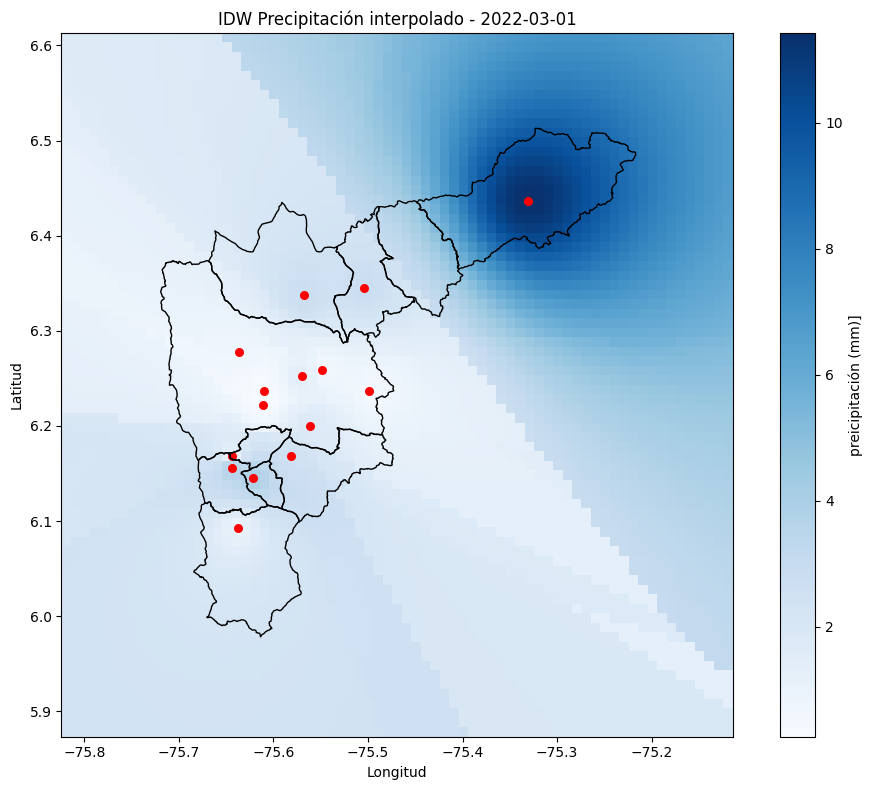

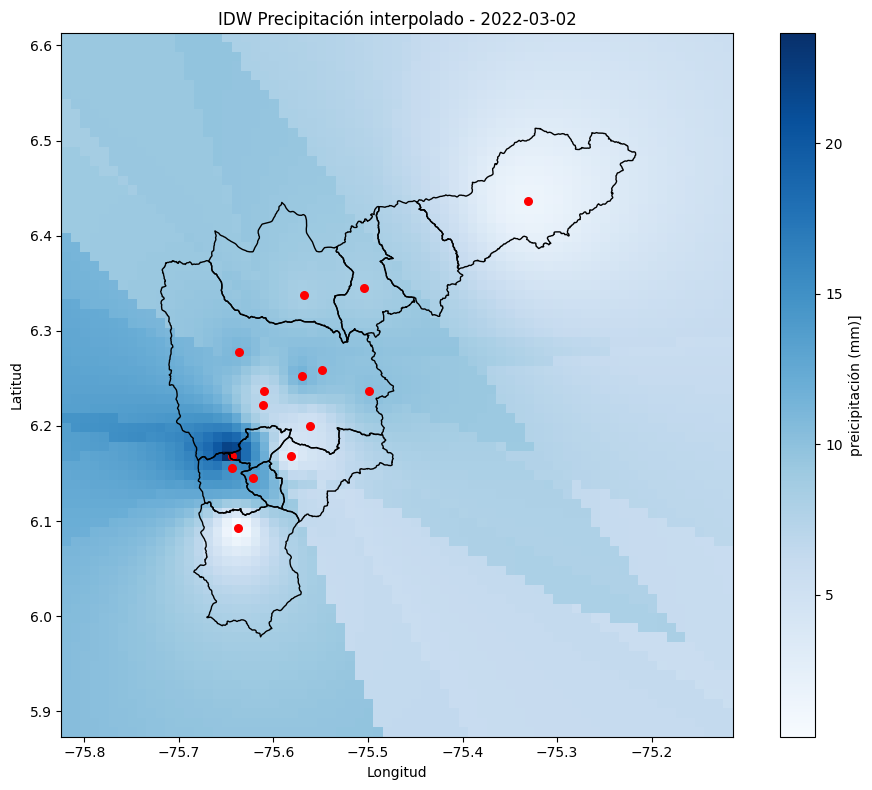

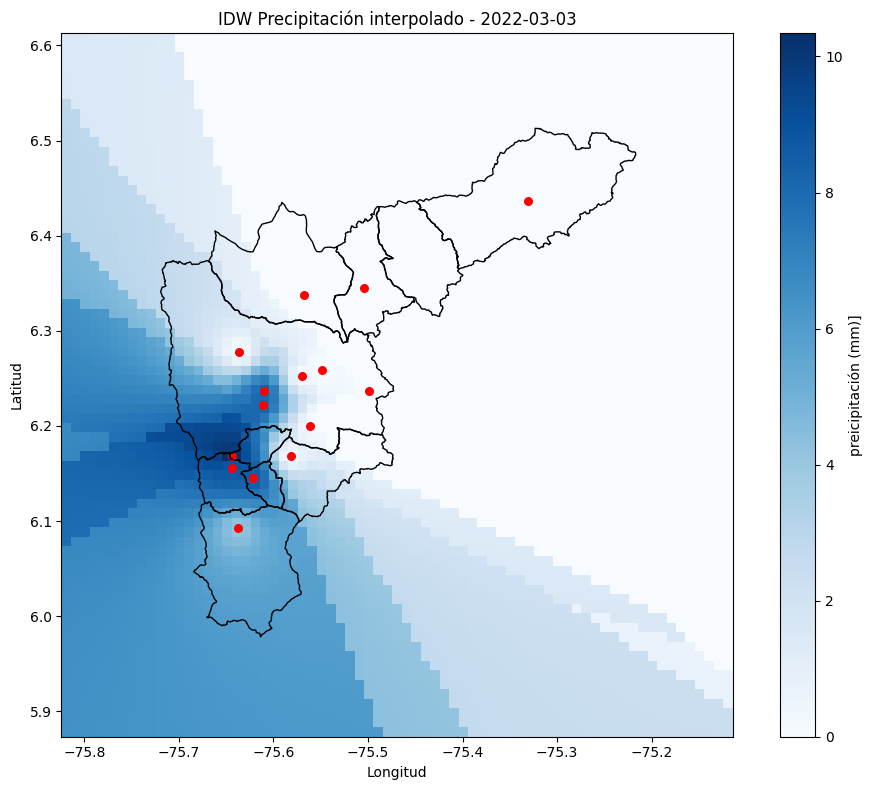

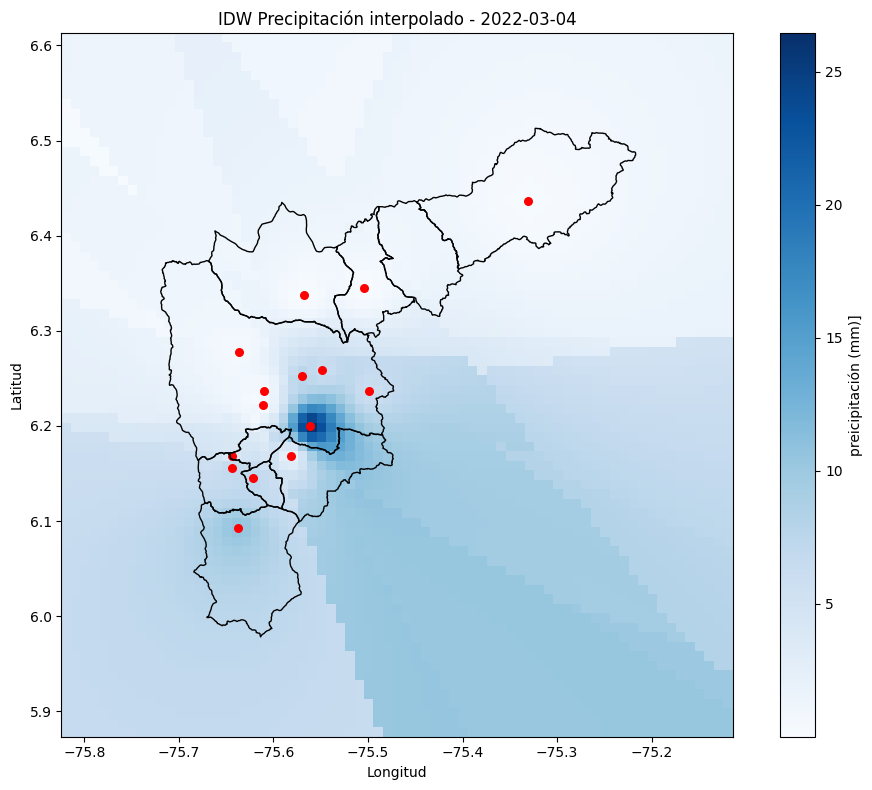

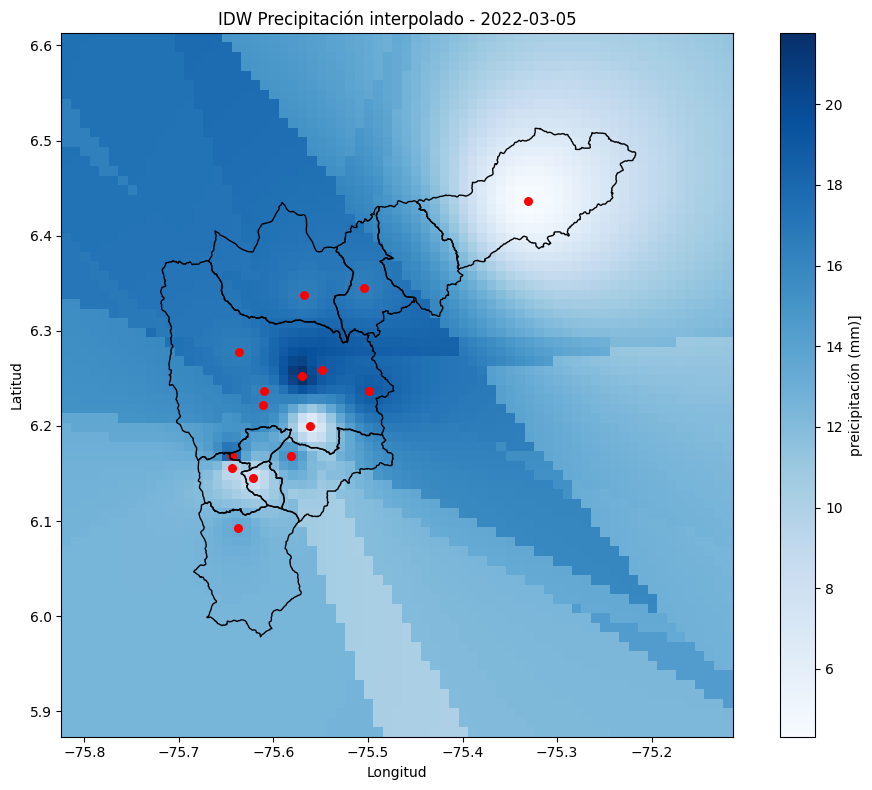

...

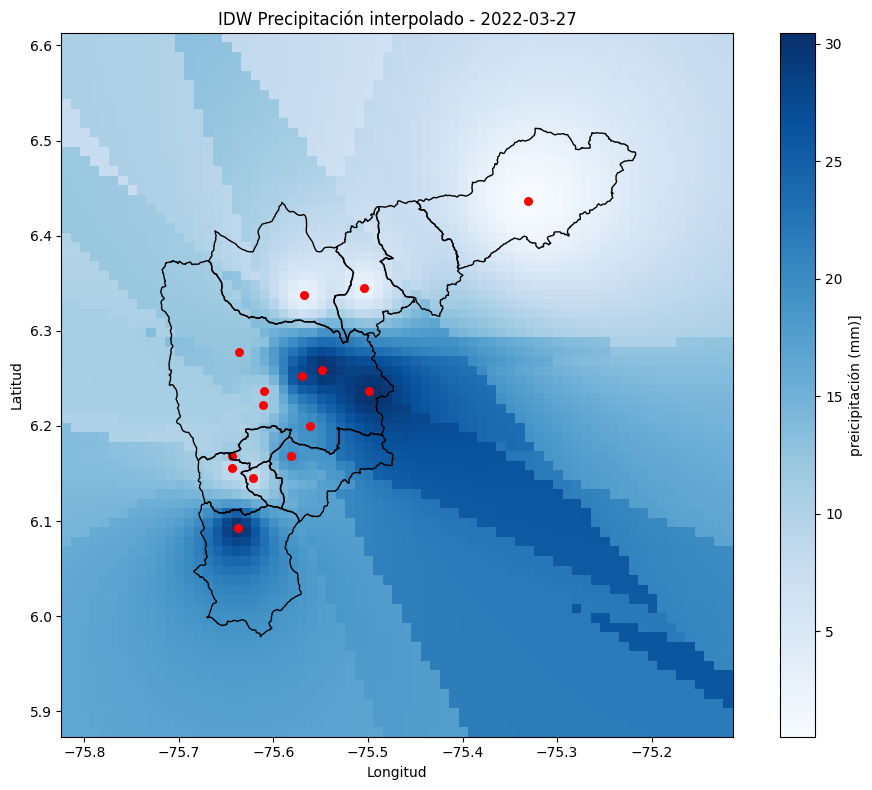

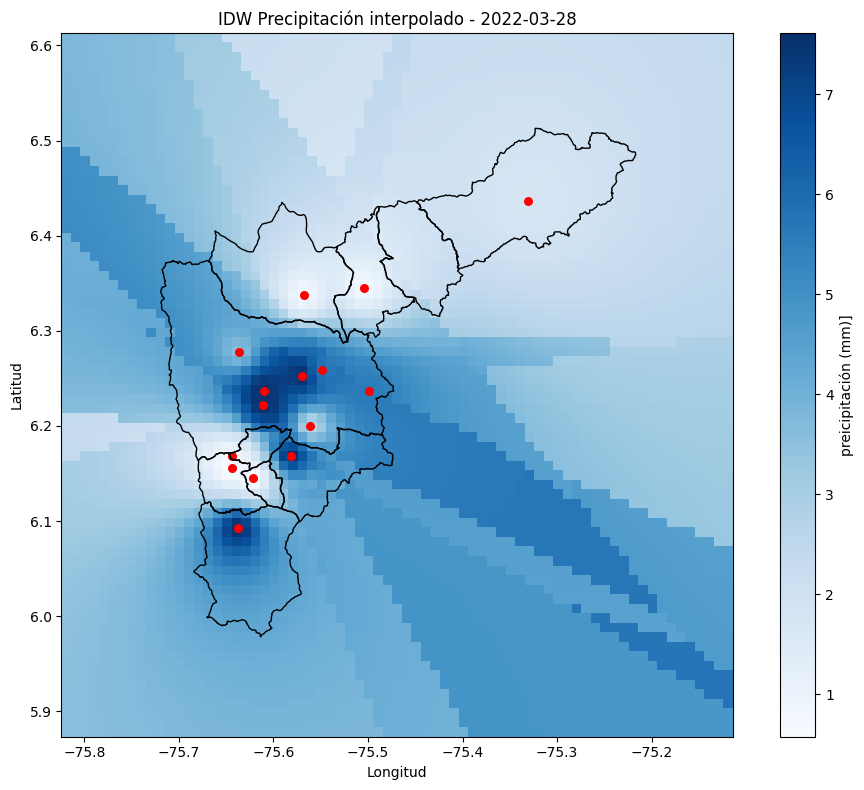

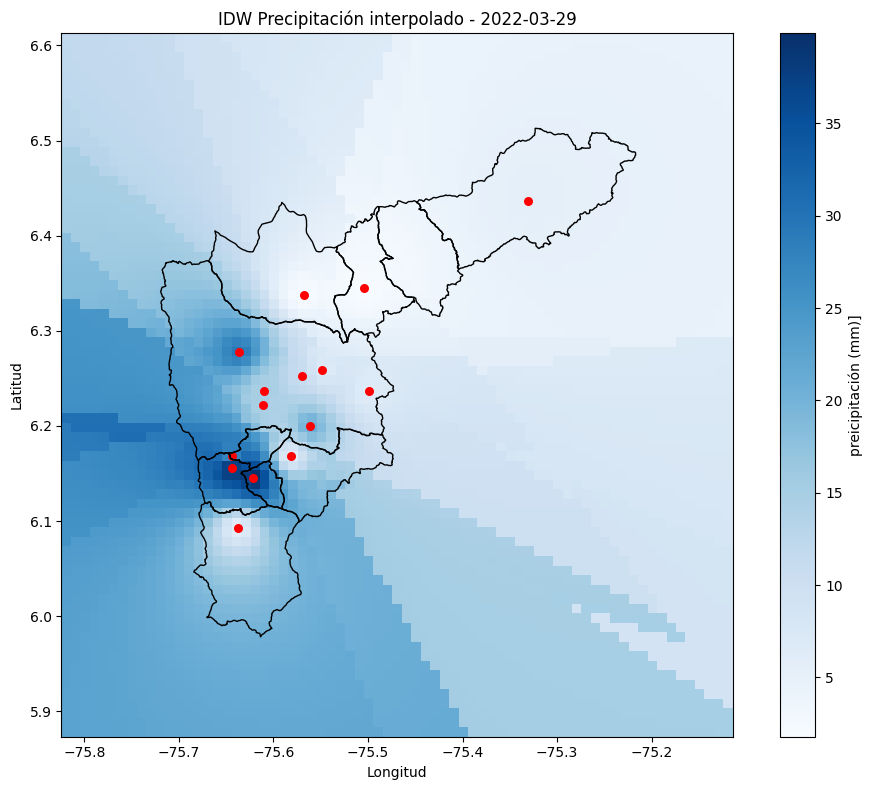

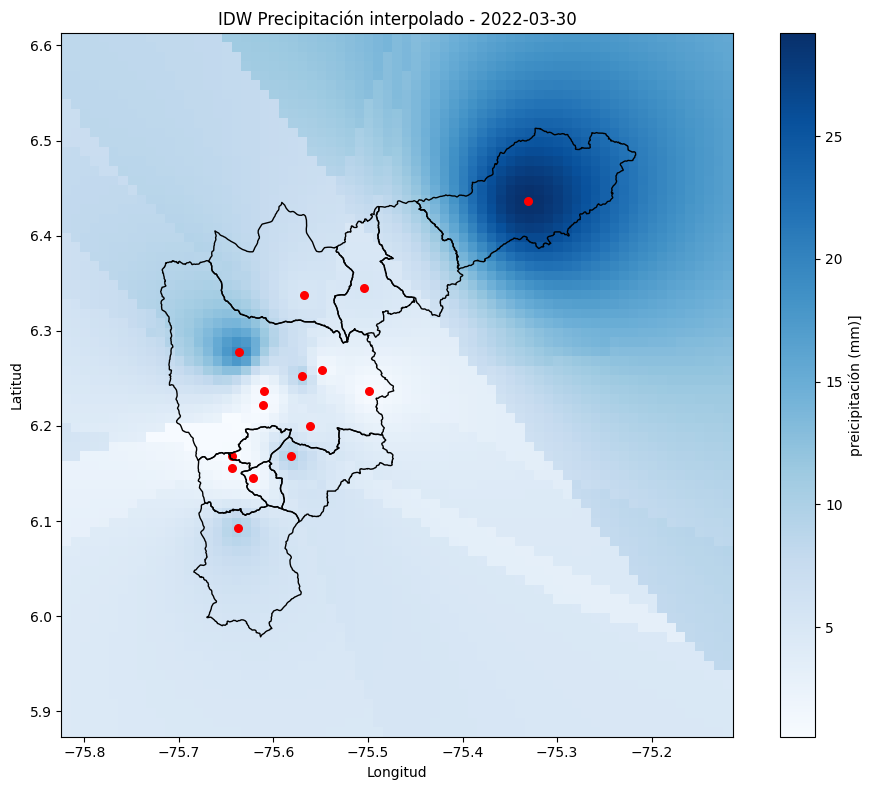

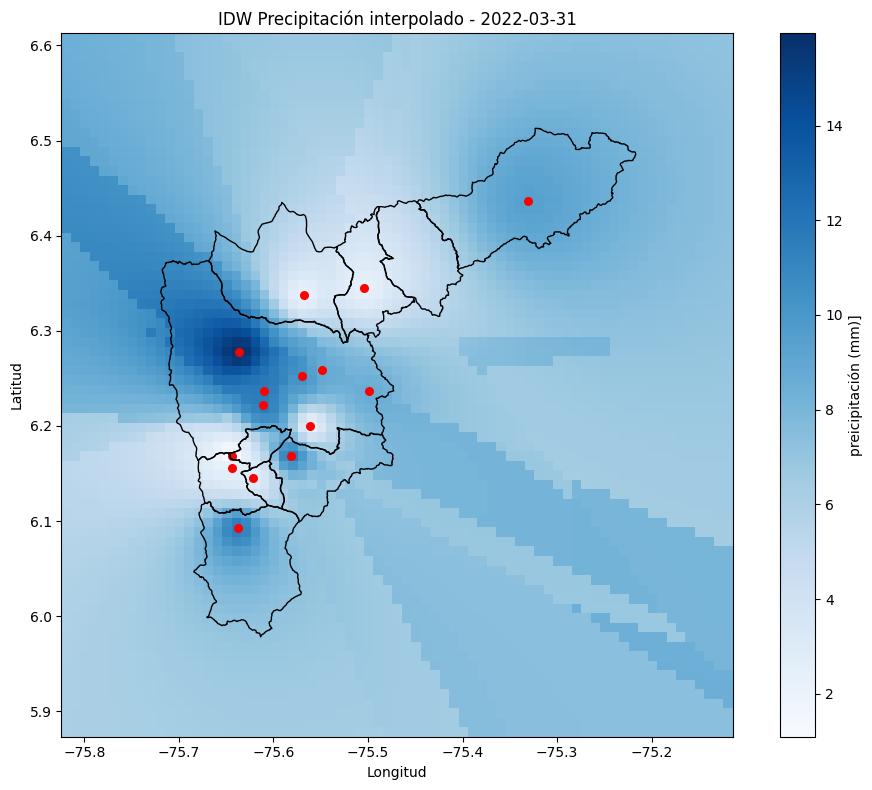

In [53]:
#precipitación 
# --- Definir pesos IDW ---
def idw_weights(distances, p=2):
    distances = distances.copy()
    distances[distances == 0] = 1e-12
    return 1 / distances**p

weights_idw = partial(idw_weights, p=2)

# --- Preparar grid de interpolación ---
grid_points = np.vstack([grid_lon.ravel(), grid_lat.ravel()]).T

# --- Iterar sobre días únicos ---
for fecha in Estaciones['fecha_hora'].unique():
    df_dia = Estaciones[Estaciones['fecha_hora'] == fecha].dropna(subset=['pp_diaria'])

    # Entradas para el modelo
    X_train = df_dia[['Longitud', 'Latitud']].values
    y_train = df_dia['pp_diaria'].values

    # Asegurar que hay suficientes datos
    if len(X_train) < 3:
        print(f"No se interpola {fecha}, pocos datos.")
        continue

    # Entrenar modelo IDW con KNN
    model = KNeighborsRegressor(n_neighbors=min(5, len(X_train)), weights=weights_idw)
    model.fit(X_train, y_train)

    # Interpolar en el grid
    y_pred = model.predict(grid_points)
    interp_grid = y_pred.reshape(grid_lon.shape)

    # --- Graficar ---
    fig, ax = plt.subplots(figsize=(10, 8))
    c = ax.pcolormesh(grid_lon, grid_lat, interp_grid, cmap='Blues', shading='auto')
    plt.colorbar(c, ax=ax, label='preicipitación (mm)]')

    municipios.boundary.plot(ax=ax, color='black', linewidth=1)
    estpm.plot(ax=ax, color='red', markersize=30)

    ax.set_title(f"IDW Precipitación interpolado - {pd.to_datetime(fecha).strftime('%Y-%m-%d')}")
    ax.set_xlabel("Longitud")
    ax.set_ylabel("Latitud")
    plt.tight_layout()
    
    # Guardar imagen si quieres
    # plt.savefig(f"interpolacion_pm_{fecha}.png", dpi=300)
    plt.show()



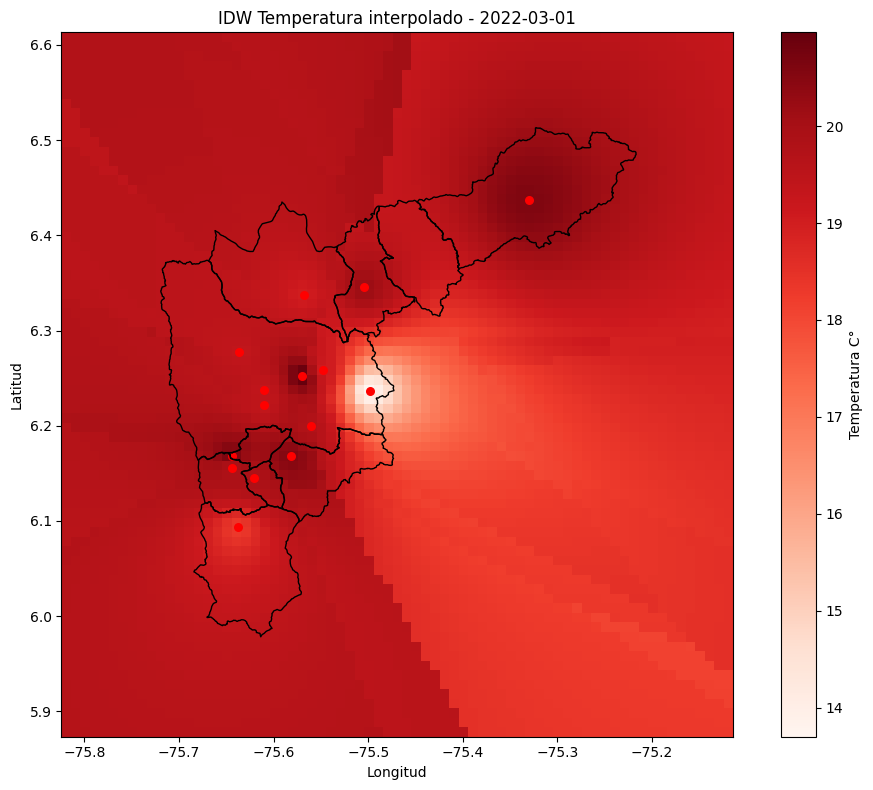

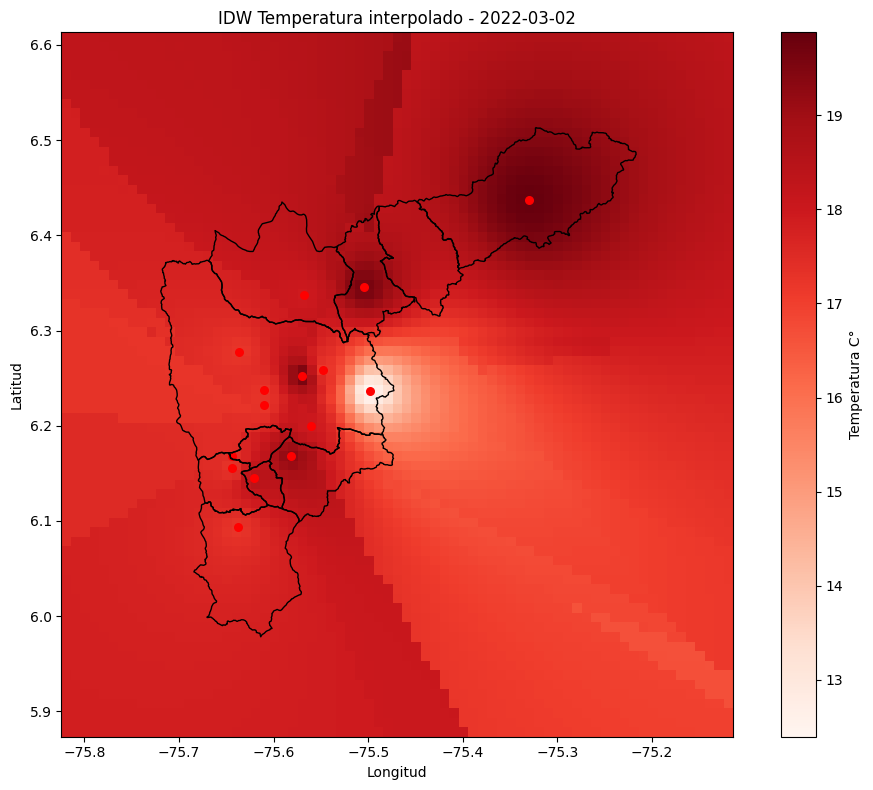

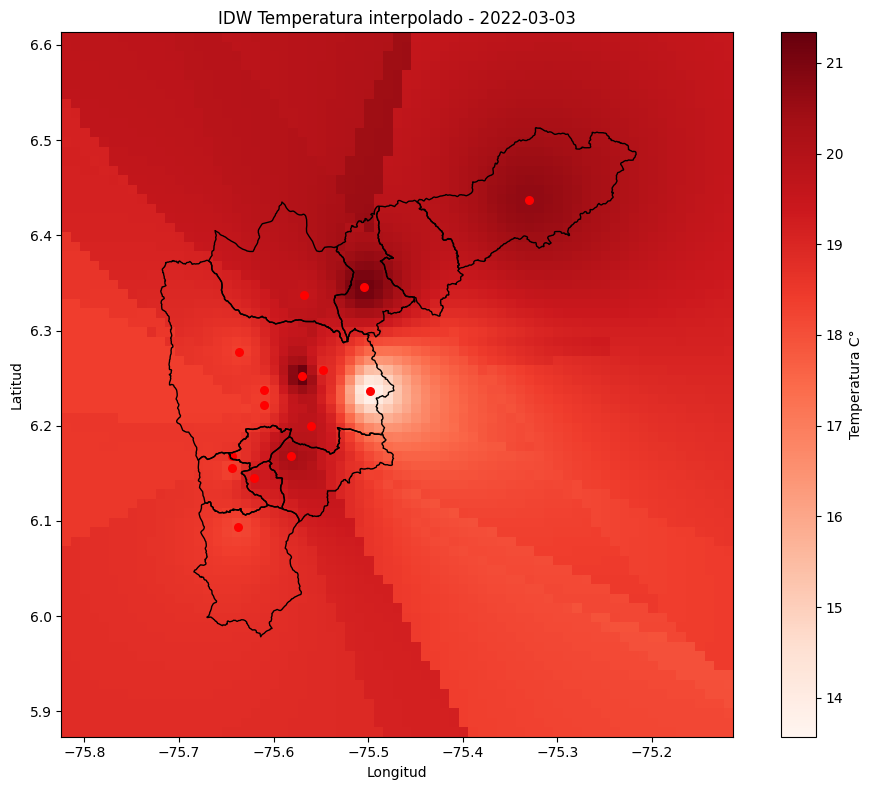

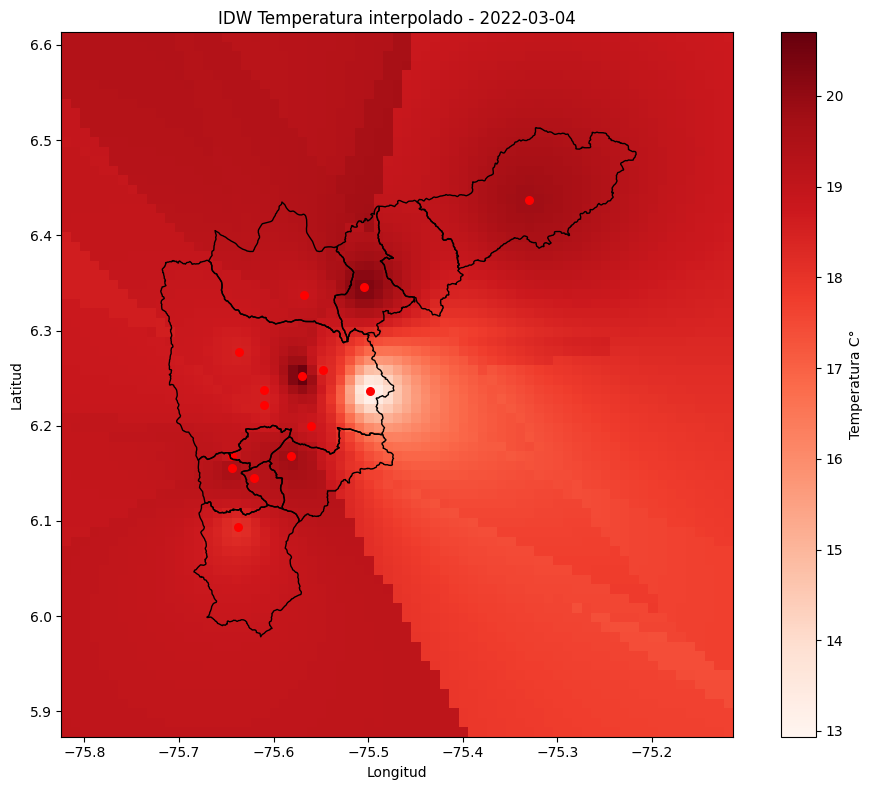

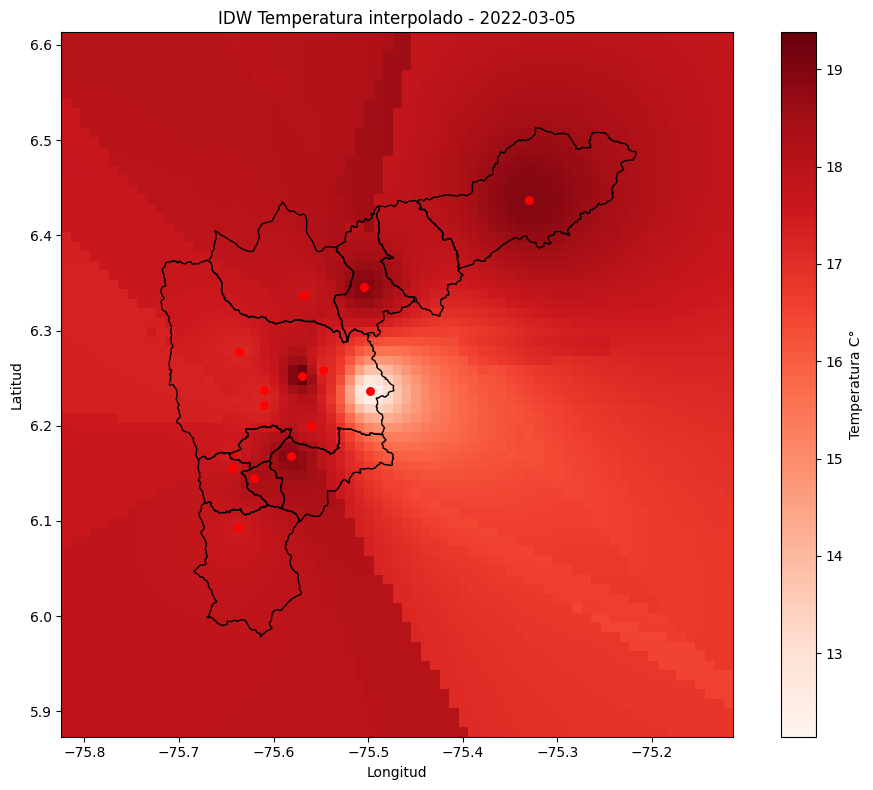

...

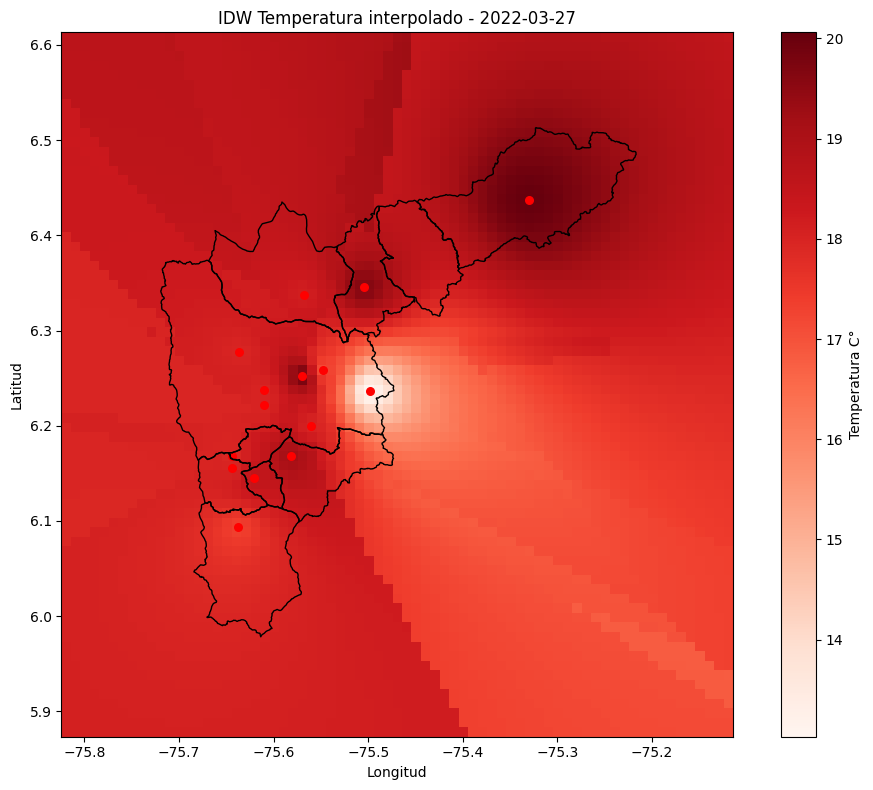

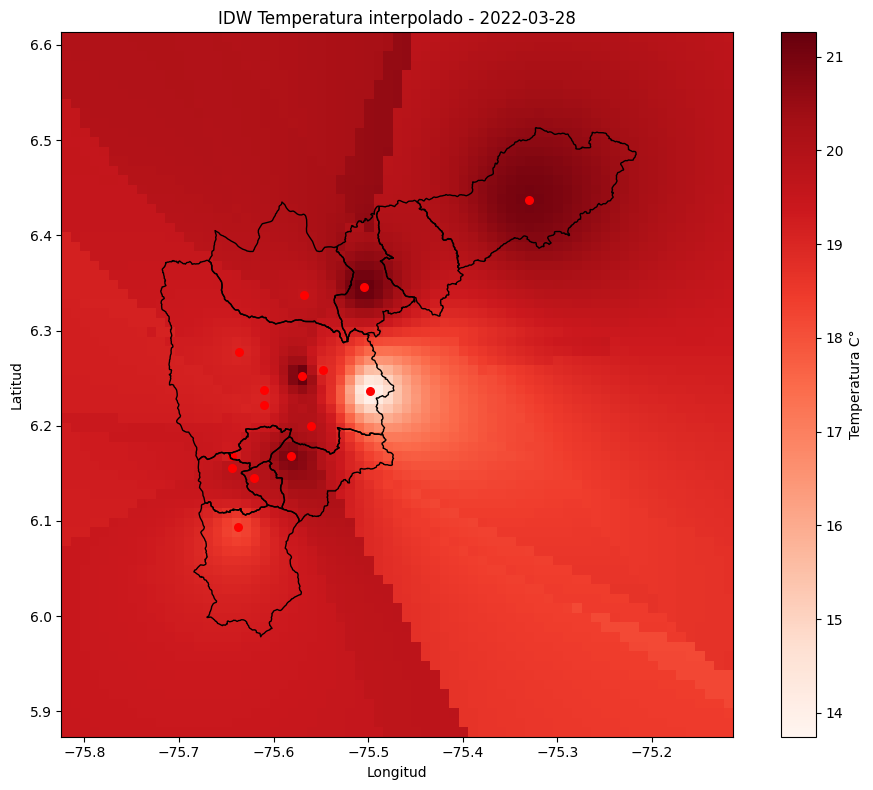

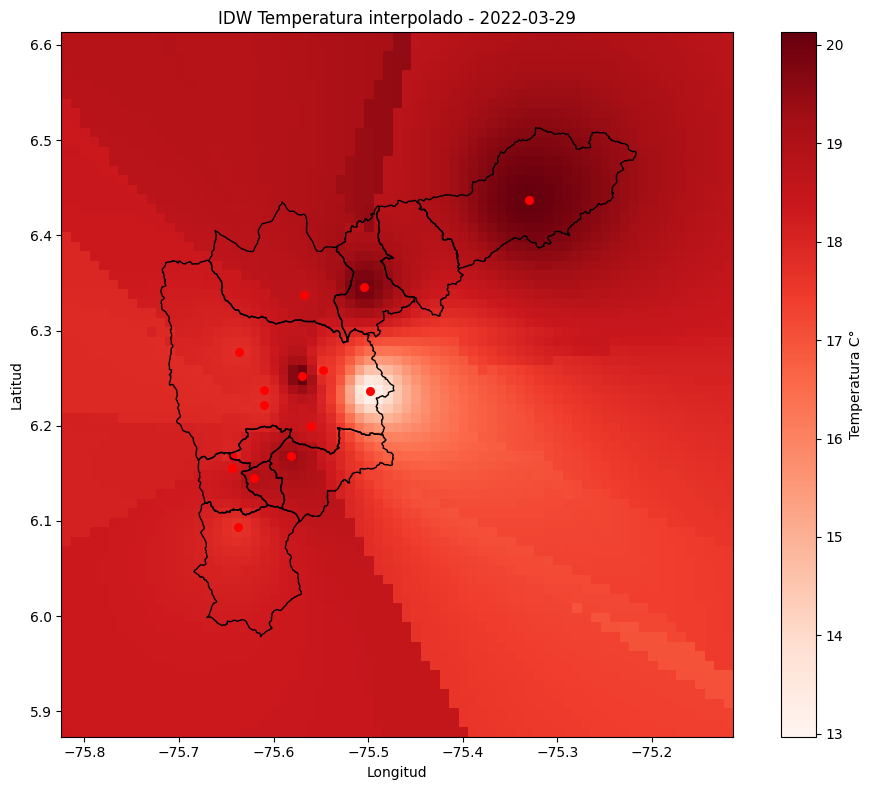

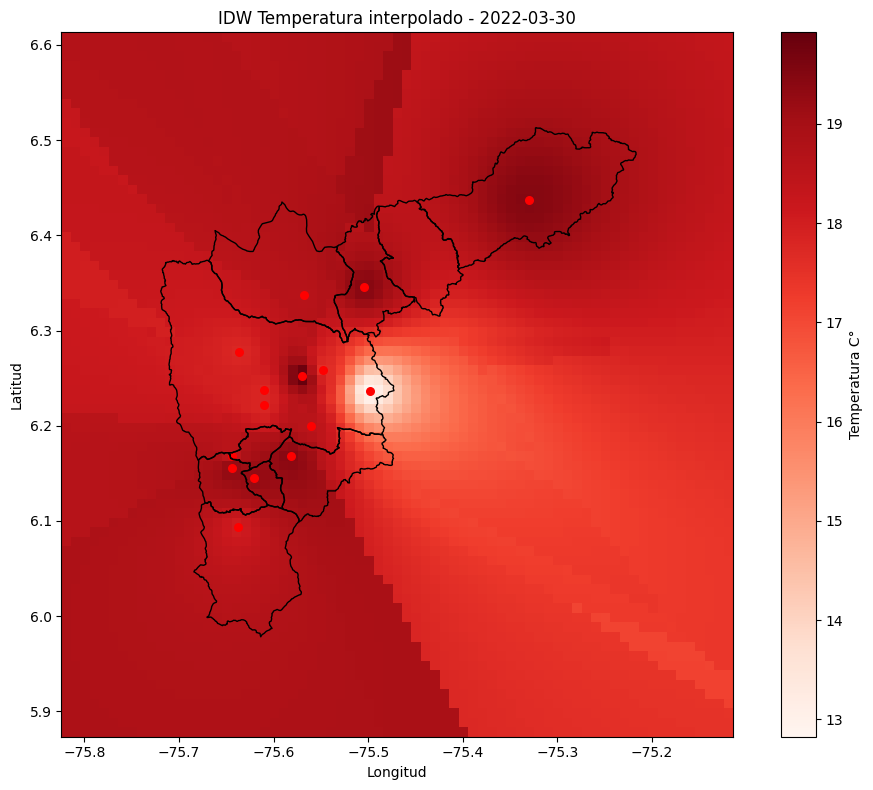

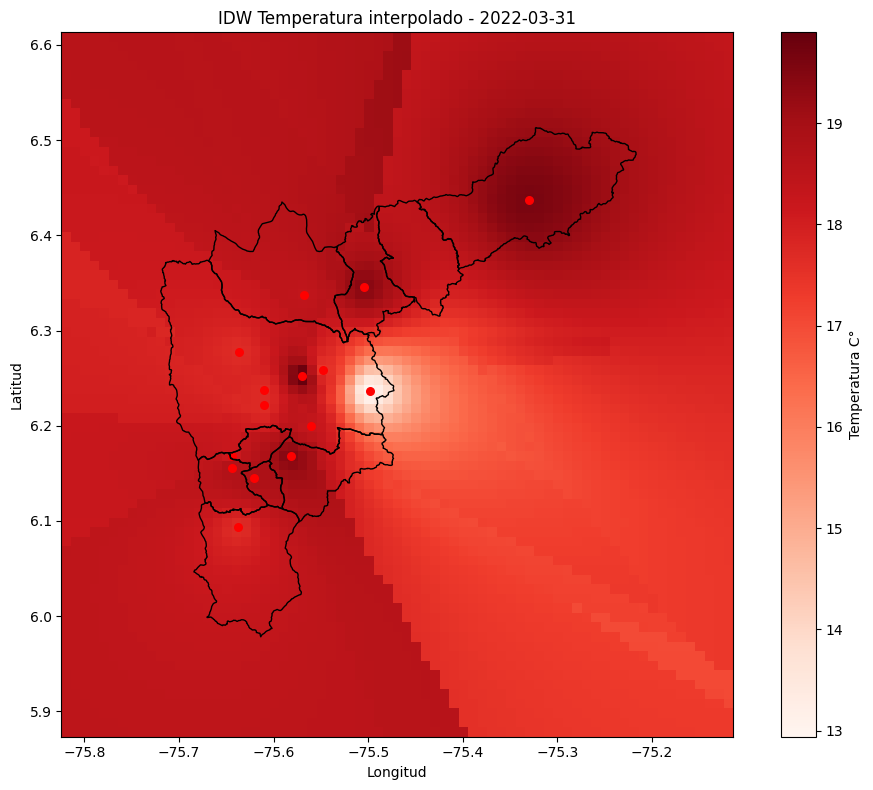

In [52]:
#precipitación 
# --- Definir pesos IDW ---
def idw_weights(distances, p=2):
    distances = distances.copy()
    distances[distances == 0] = 1e-12
    return 1 / distances**p

weights_idw = partial(idw_weights, p=2)

# --- Preparar grid de interpolación ---
grid_points = np.vstack([grid_lon.ravel(), grid_lat.ravel()]).T

# --- Iterar sobre días únicos ---
for fecha in Estaciones['fecha_hora'].unique():
    df_dia = Estaciones[Estaciones['fecha_hora'] == fecha].dropna(subset=['temperatura'])

    # Entradas para el modelo
    X_train = df_dia[['Longitud', 'Latitud']].values
    y_train = df_dia['temperatura'].values

    # Asegurar que hay suficientes datos
    if len(X_train) < 3:
        print(f"No se interpola {fecha}, pocos datos.")
        continue

    # Entrenar modelo IDW con KNN
    model = KNeighborsRegressor(n_neighbors=min(5, len(X_train)), weights=weights_idw)
    model.fit(X_train, y_train)

    # Interpolar en el grid
    y_pred = model.predict(grid_points)
    interp_grid = y_pred.reshape(grid_lon.shape)

    # --- Graficar ---
    fig, ax = plt.subplots(figsize=(10, 8))
    c = ax.pcolormesh(grid_lon, grid_lat, interp_grid, cmap='Reds', shading='auto')
    plt.colorbar(c, ax=ax, label='Temperatura C°')

    municipios.boundary.plot(ax=ax, color='black', linewidth=1)
    estpm.plot(ax=ax, color='red', markersize=30)

    ax.set_title(f"IDW Temperatura interpolado - {pd.to_datetime(fecha).strftime('%Y-%m-%d')}")
    ax.set_xlabel("Longitud")
    ax.set_ylabel("Latitud")
    plt.tight_layout()
    
    # Guardar imagen si quieres
    # plt.savefig(f"interpolacion_pm_{fecha}.png", dpi=300)
    plt.show()


In [205]:
#horarios 
horarios1=pd.read_csv(r"C:\Users\Documents\unal\analisis geoespacial\Trabajo3\horastodos.csv")
horarios1

,Unnamed: 0,Codigo,hora,pm25,pp_horaria,temperatura
0,0,12,1,28.026581,0.294968,19.163871
1,1,12,2,27.870992,0.540774,18.928801
2,2,12,3,27.077382,1.122516,18.679000
3,3,12,4,26.379148,0.409677,18.487376
4,4,12,5,26.380198,0.270387,18.398113
...,...,...,...,...,...,...
355,355,94,20,11.010333,0.098323,12.894070
356,356,94,21,12.649717,0.409677,12.673548
357,357,94,22,12.676909,0.122903,12.506495
358,358,94,23,11.904949,0.155677,12.283457


In [206]:
horarios=estpm.merge(
    horarios1,
    on='Codigo',  
    how='right'  
    
)

In [207]:
horarios.columns

Index(['Unnamed: 0_x', 'Codigo', 'Estacion', 'Ciudad', 'Longitud', 'Latitud',
       'geometry', 'Unnamed: 0_y', 'hora', 'pm25', 'pp_horaria',
       'temperatura'],
      dtype='object')

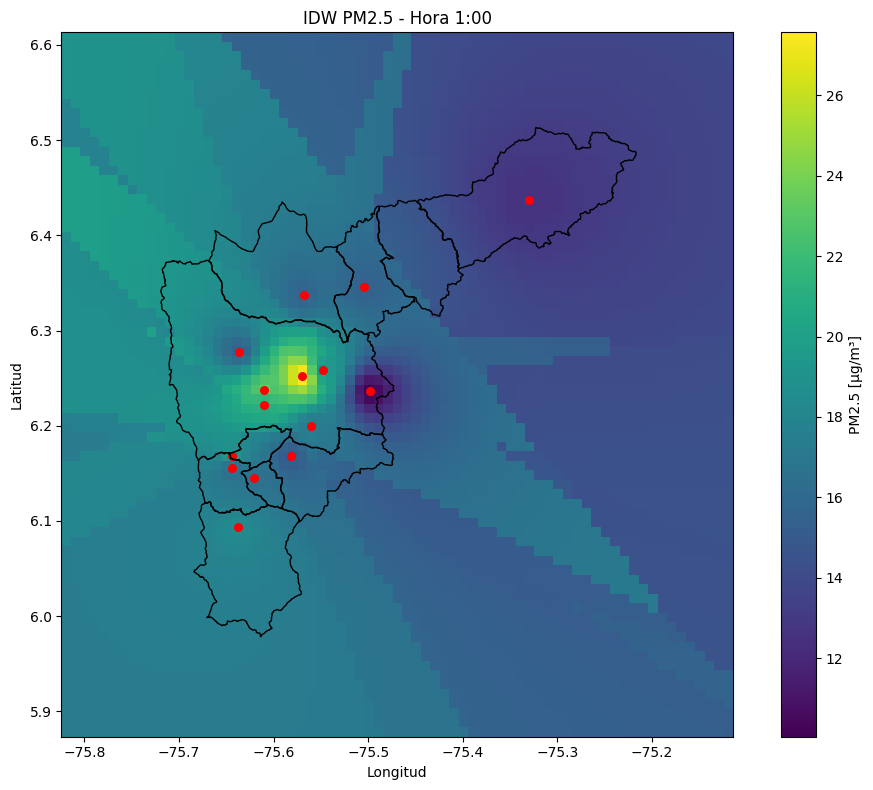

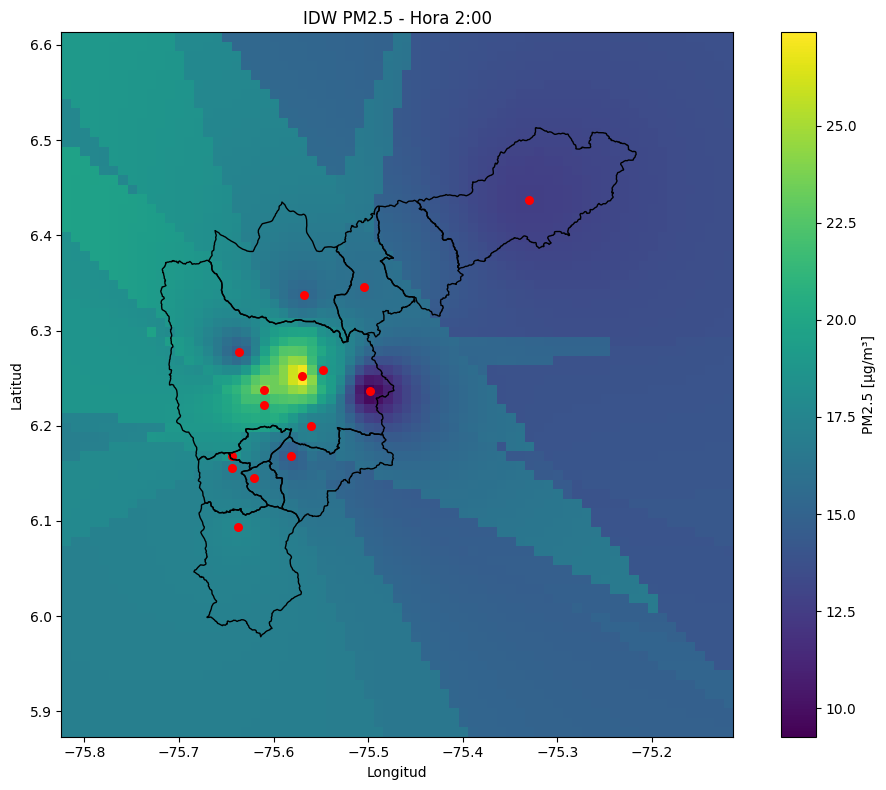

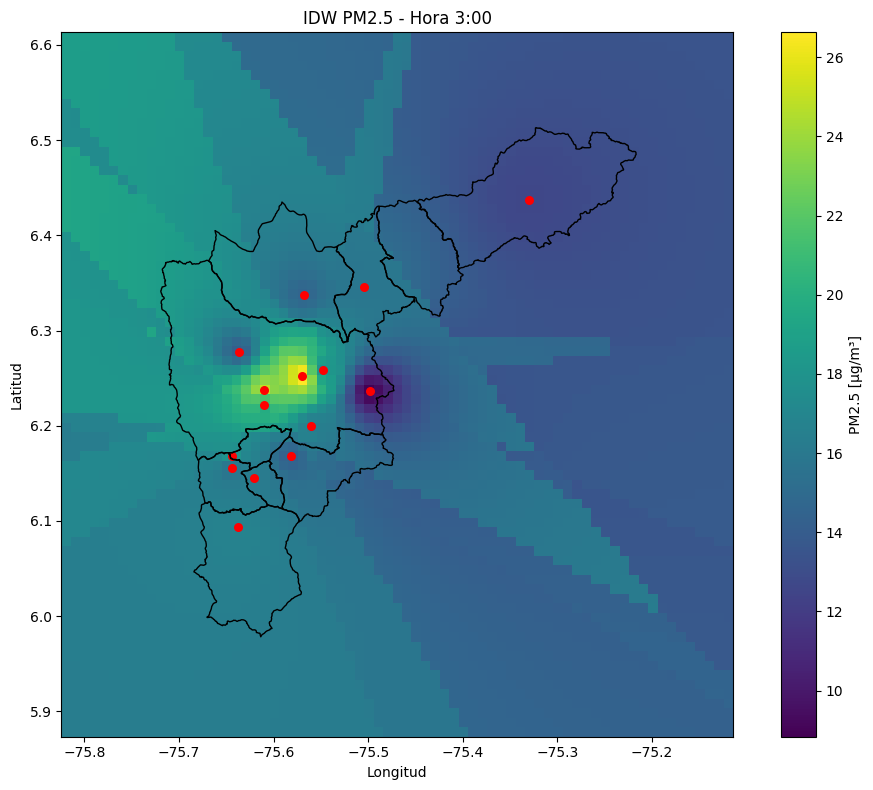

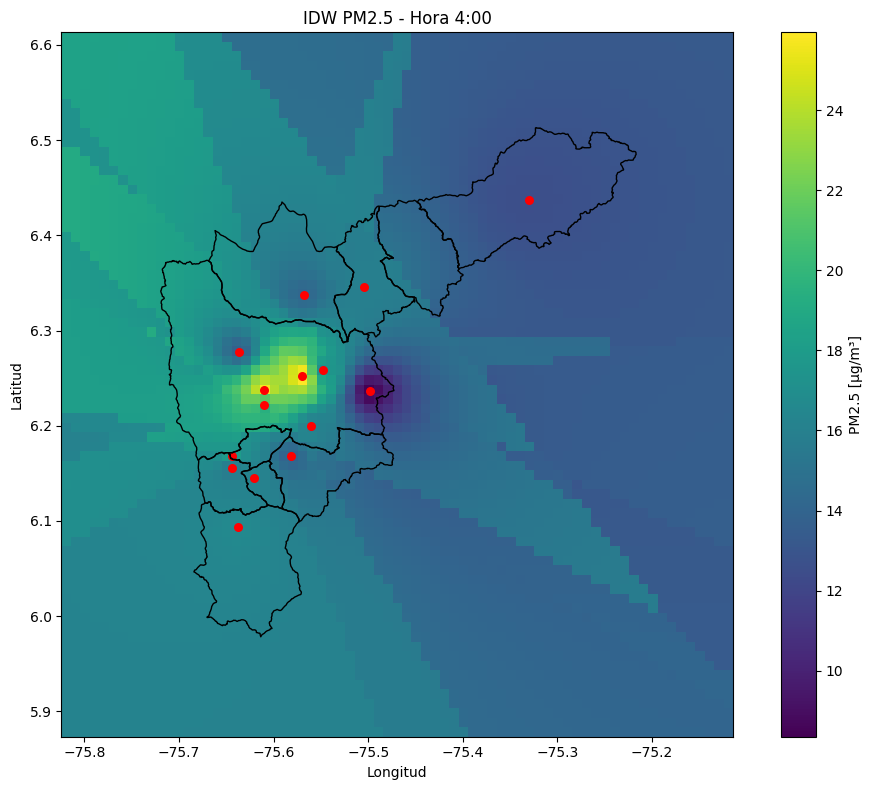

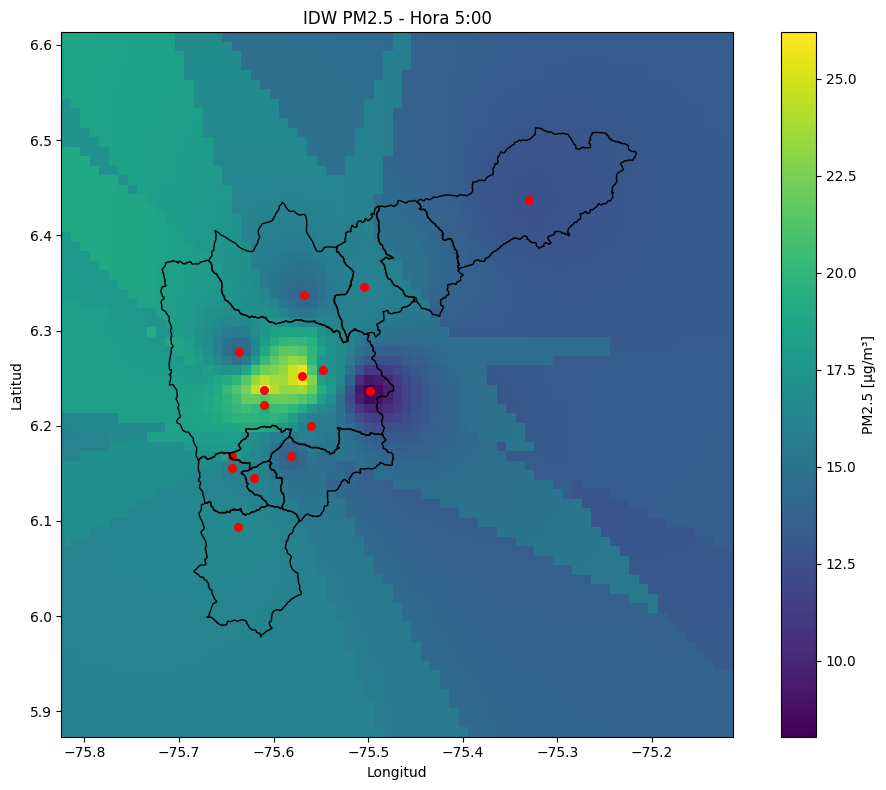

...

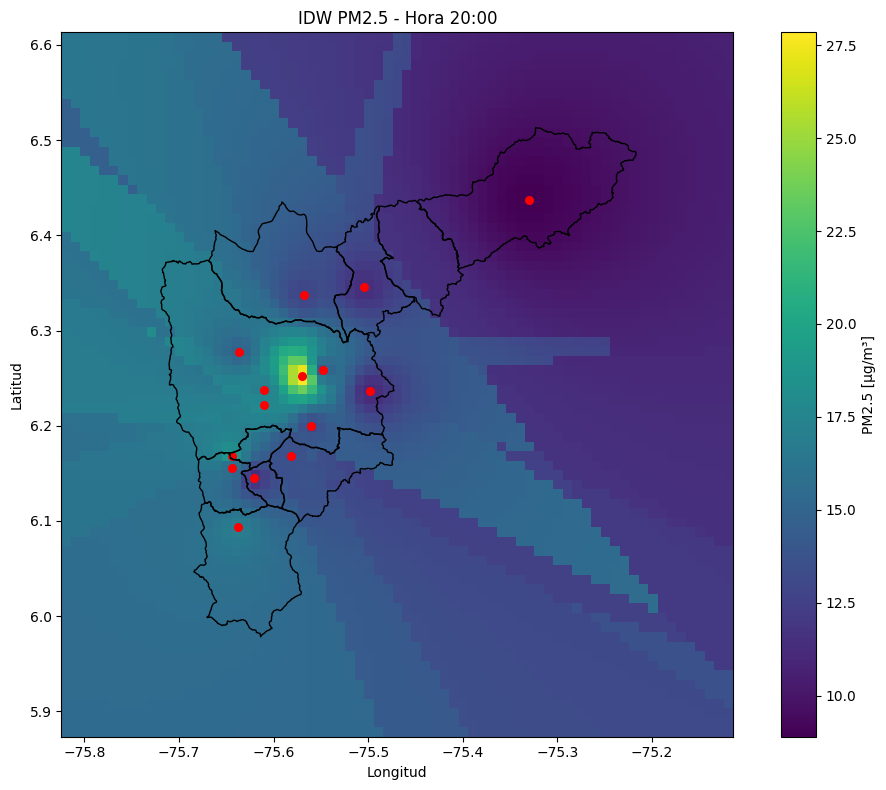

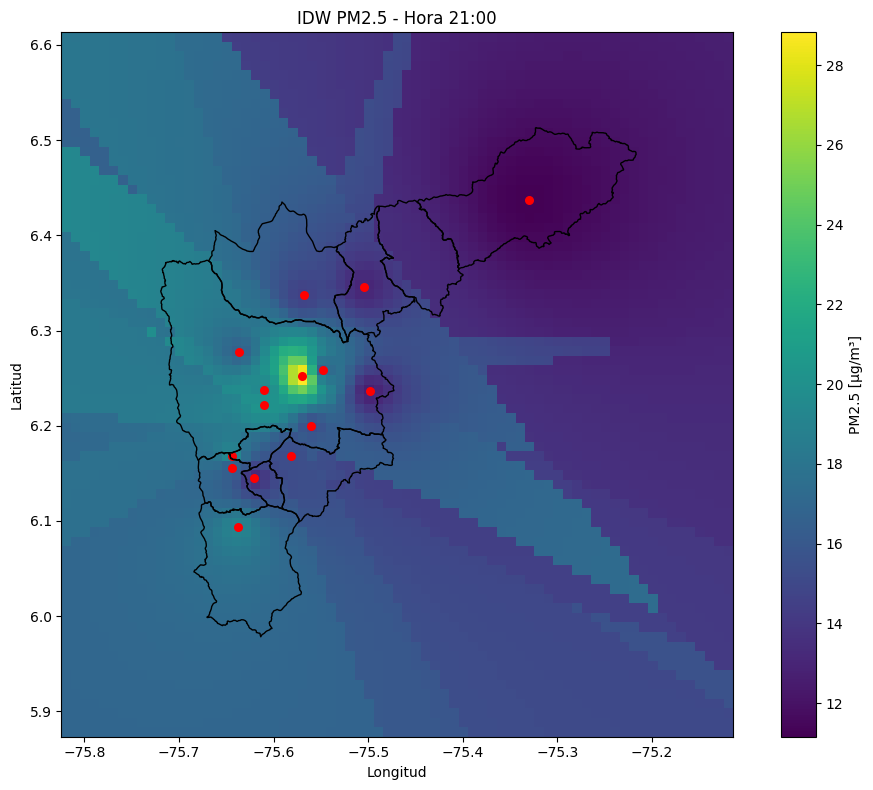

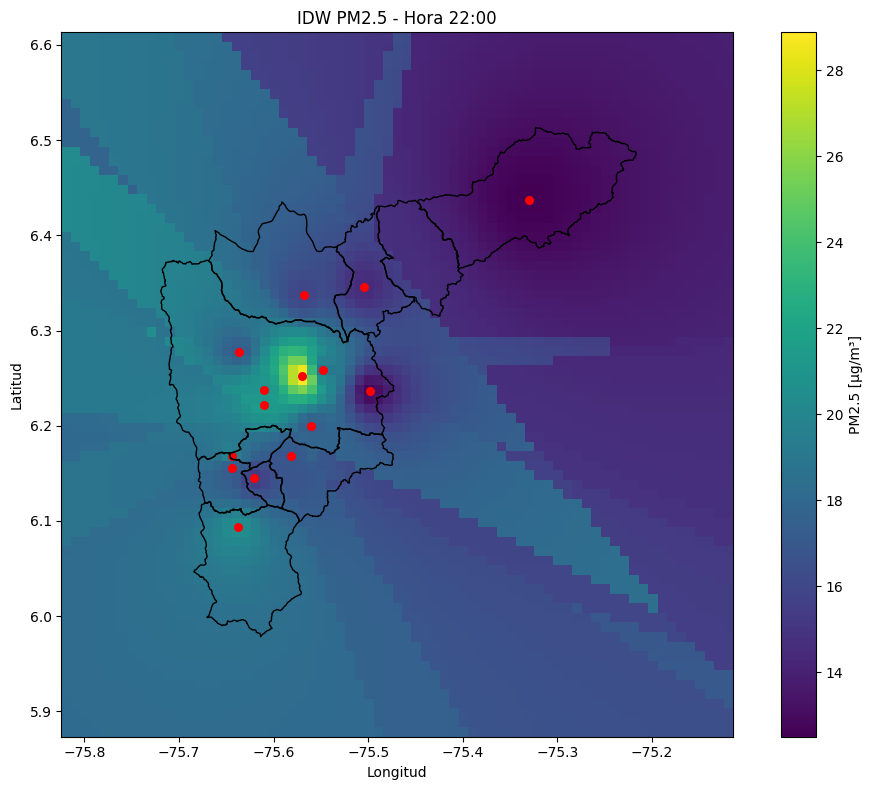

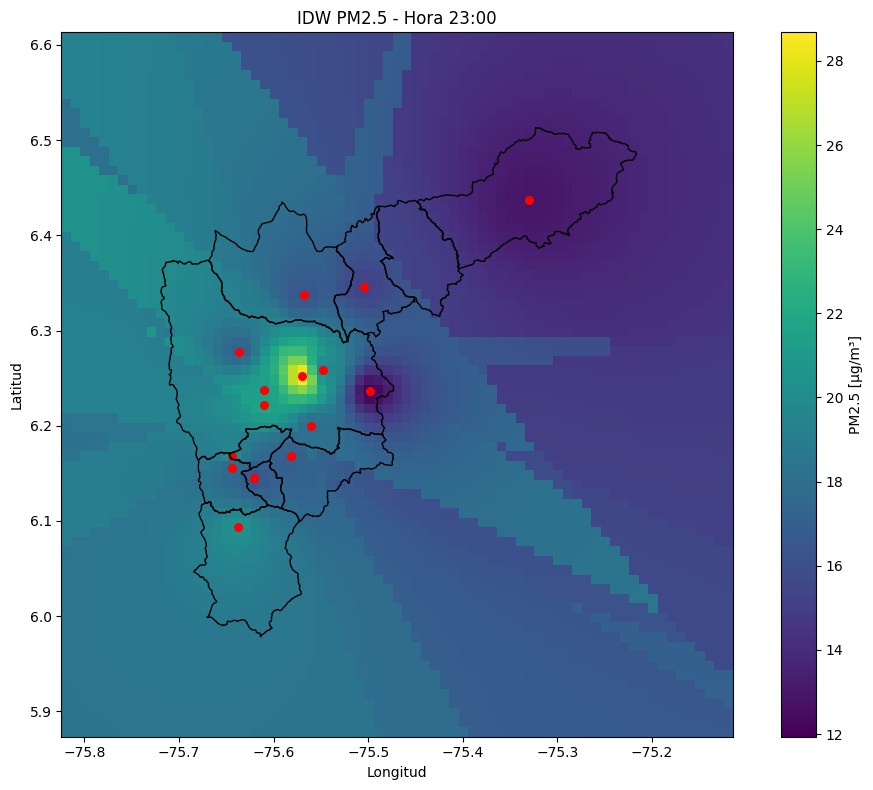

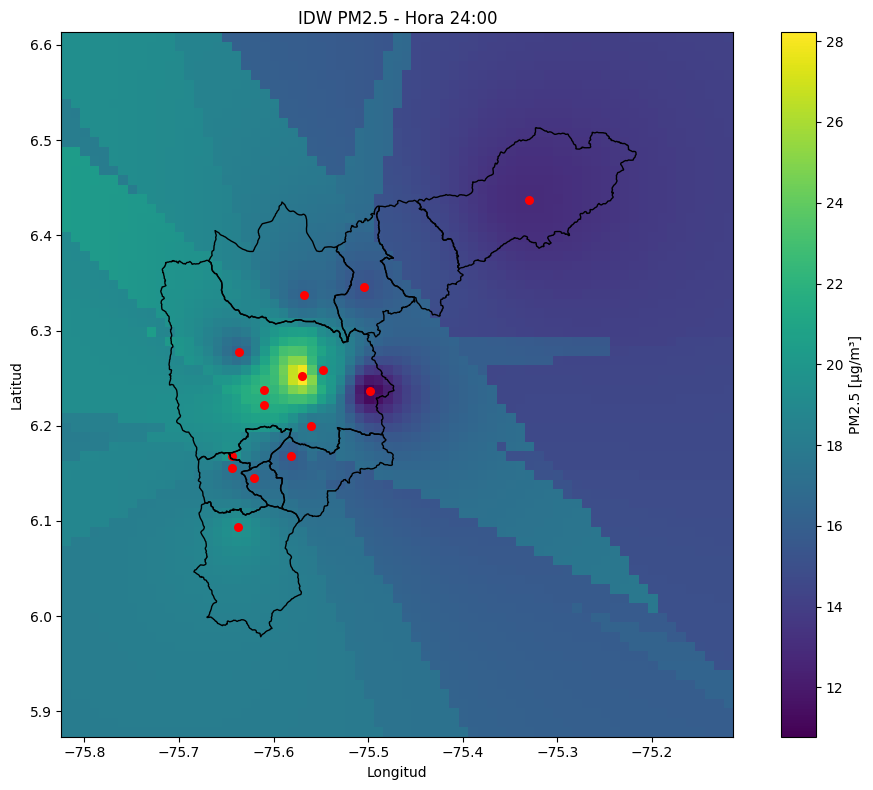

In [51]:
from sklearn.neighbors import KNeighborsRegressor
from functools import partial
import matplotlib.pyplot as plt
import numpy as np

# Función de pesos IDW
def idw_weights(distances, p=2):
    distances = distances.copy()
    distances[distances == 0] = 1e-12
    return 1 / distances**p

weights_idw = partial(idw_weights, p=2)

# Preparar el grid
grid_points = np.vstack([grid_lon.ravel(), grid_lat.ravel()]).T

# Iterar sobre cada hora (1 a 24)
for hora in sorted(horarios['hora'].unique()):
    df_hora = horarios[horarios['hora'] == hora].dropna(subset=['pm25'])

    X_train = df_hora[['Longitud', 'Latitud']].values
    y_train = df_hora['pm25'].values

    if len(X_train) < 3:
        print(f"⚠️ No se interpola hora {hora}, pocos datos.")
        continue

    model = KNeighborsRegressor(n_neighbors=min(5, len(X_train)), weights=weights_idw)
    model.fit(X_train, y_train)

    y_pred = model.predict(grid_points)
    interp_grid = y_pred.reshape(grid_lon.shape)

    # --- Graficar ---
    fig, ax = plt.subplots(figsize=(10, 8))
    c = ax.pcolormesh(grid_lon, grid_lat, interp_grid, cmap='viridis', shading='auto')
    plt.colorbar(c, ax=ax, label='PM2.5 [µg/m³]')

    municipios.boundary.plot(ax=ax, color='black', linewidth=1)
    estpm.plot(ax=ax, color='red', markersize=30)

    ax.set_title(f"IDW PM2.5 - Hora {hora}:00")
    ax.set_xlabel("Longitud")
    ax.set_ylabel("Latitud")
    plt.tight_layout()

    # Guardar si deseas
    # plt.savefig(f"idw_pm25_hora_{hora:02d}.png", dpi=300)
    plt.show()


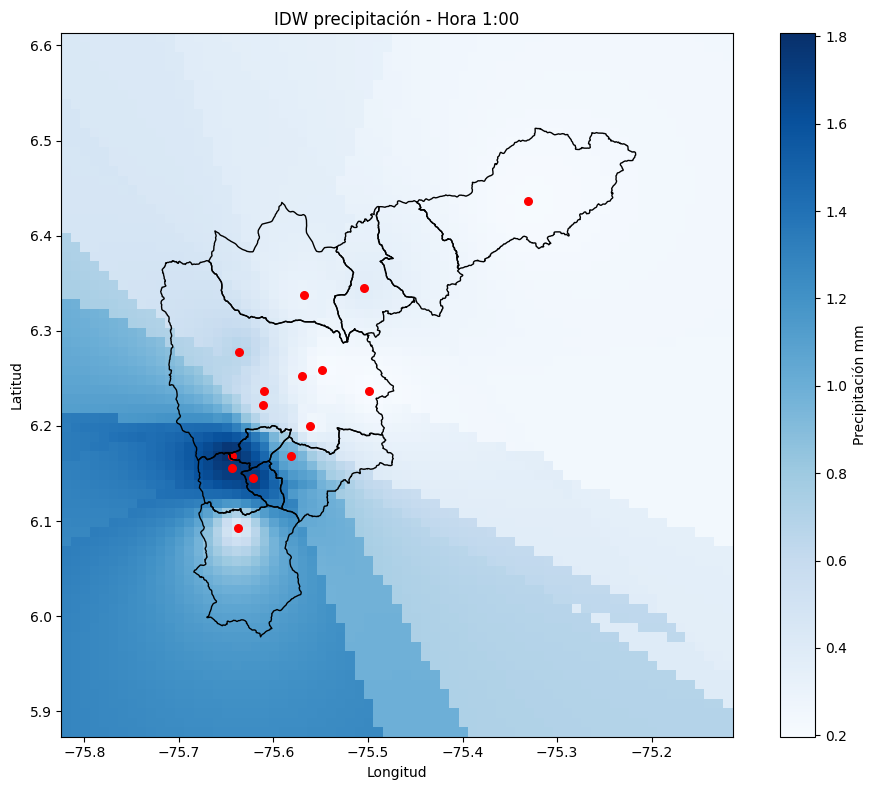

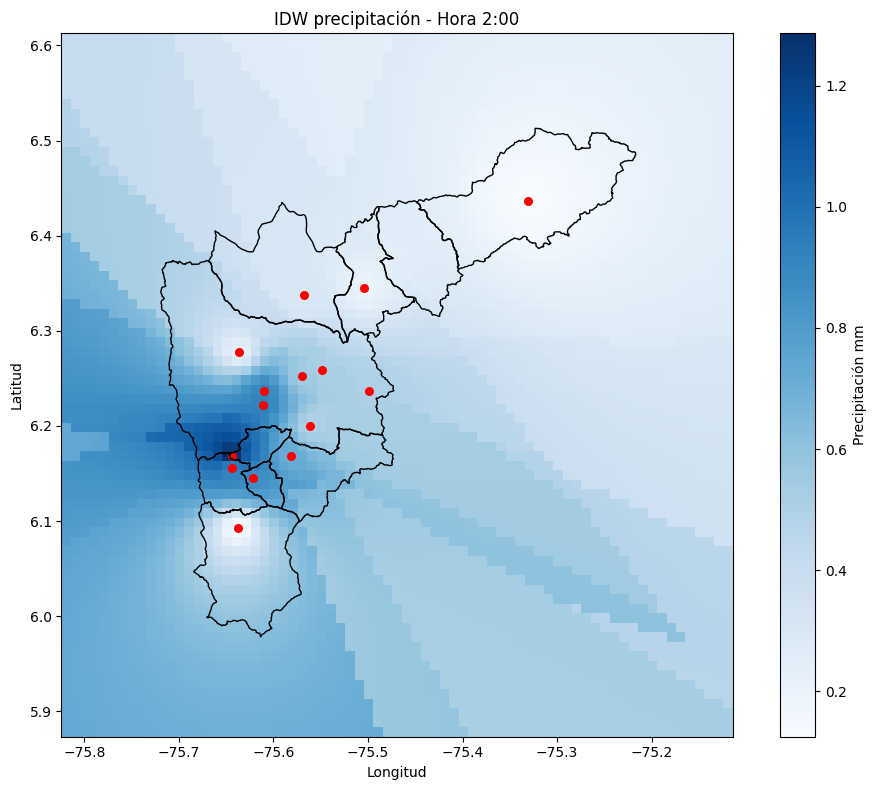

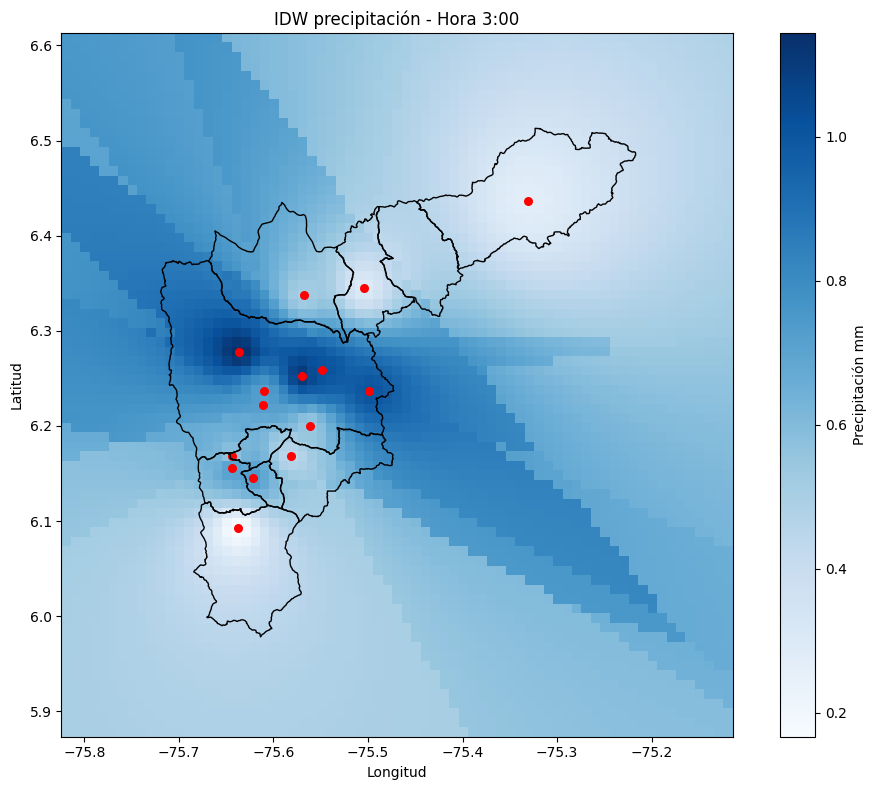

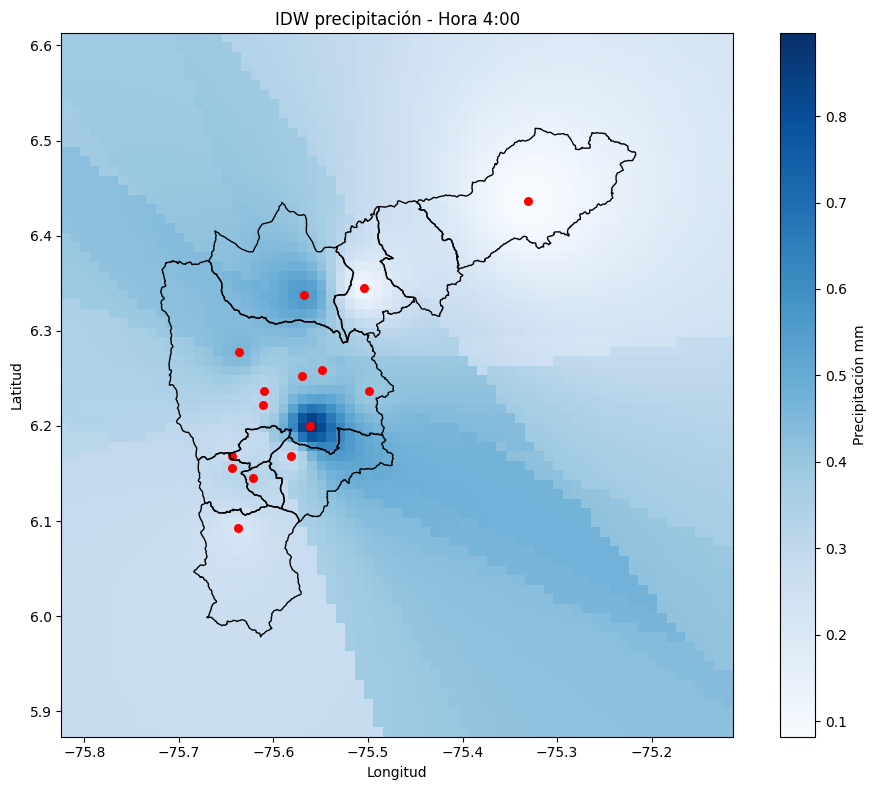

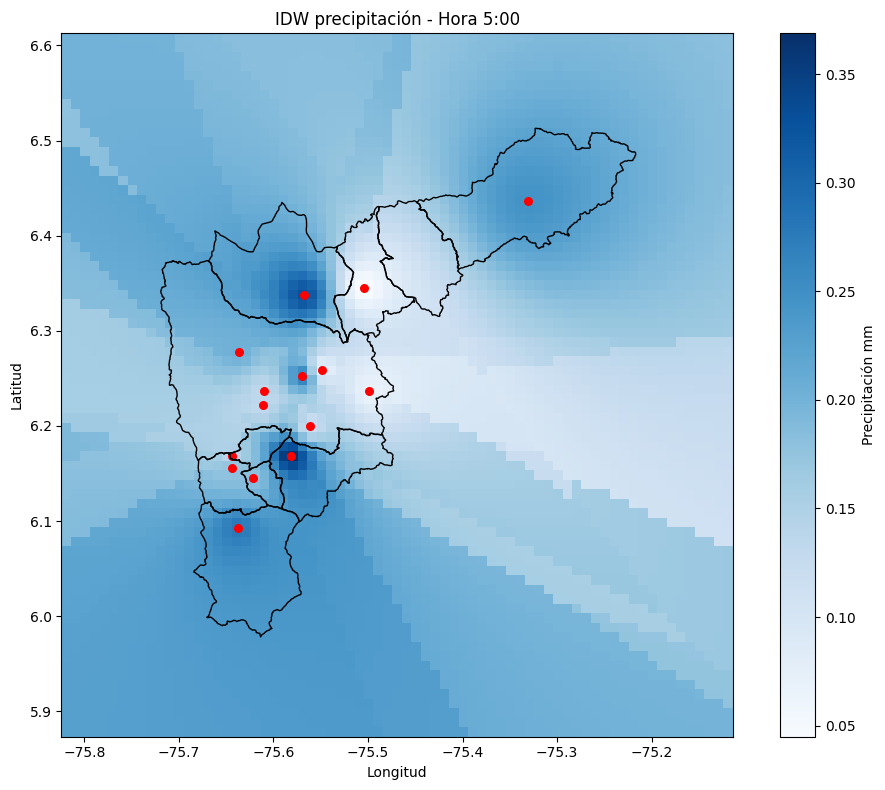

...

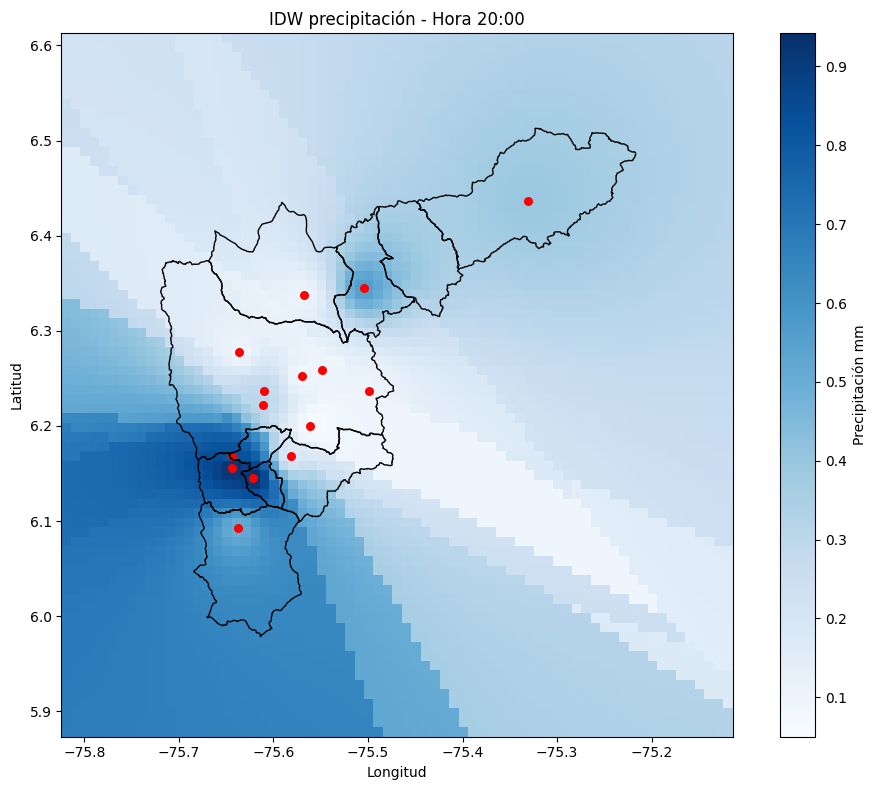

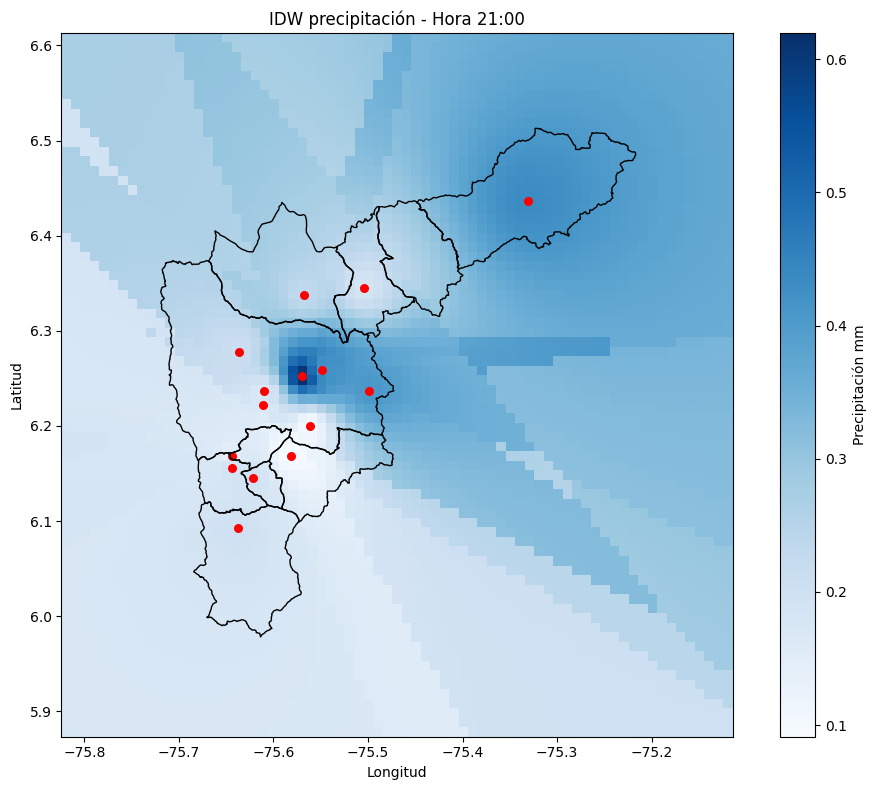

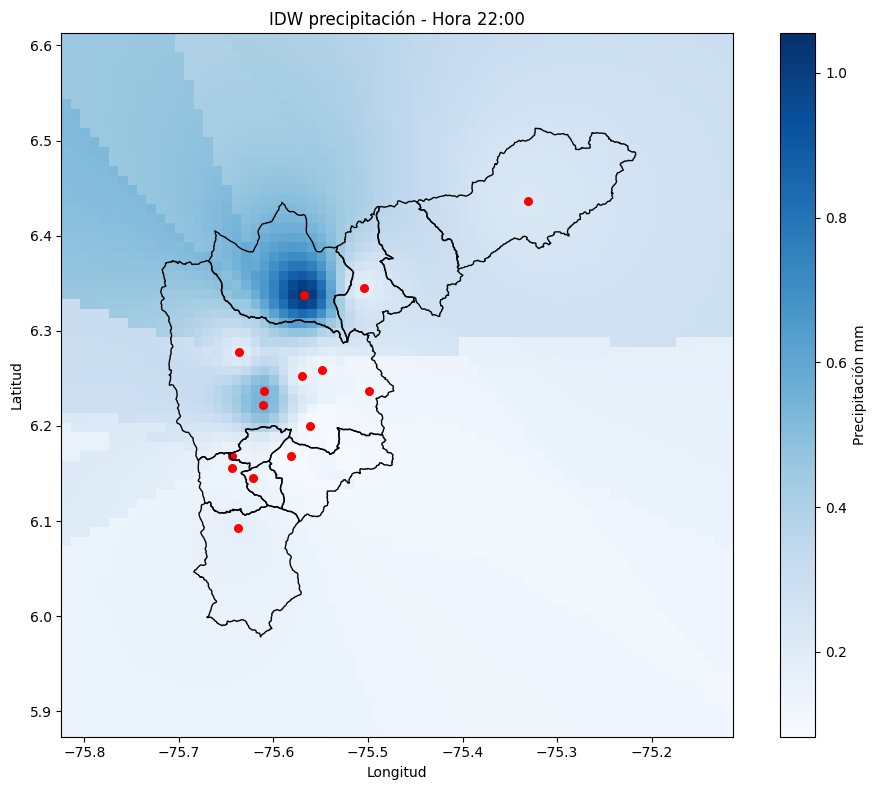

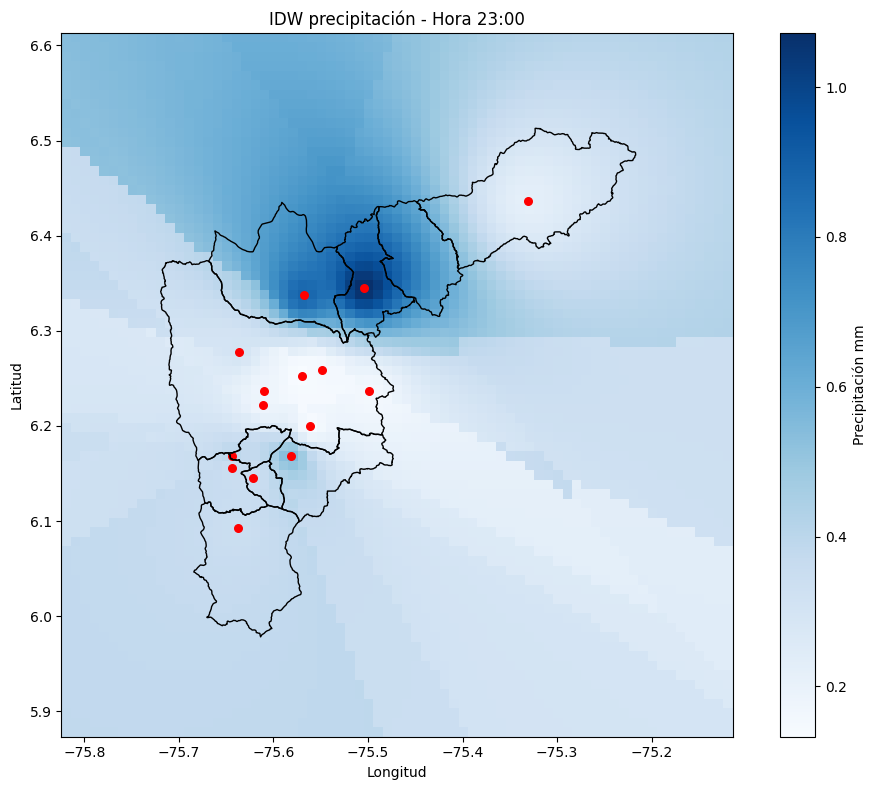

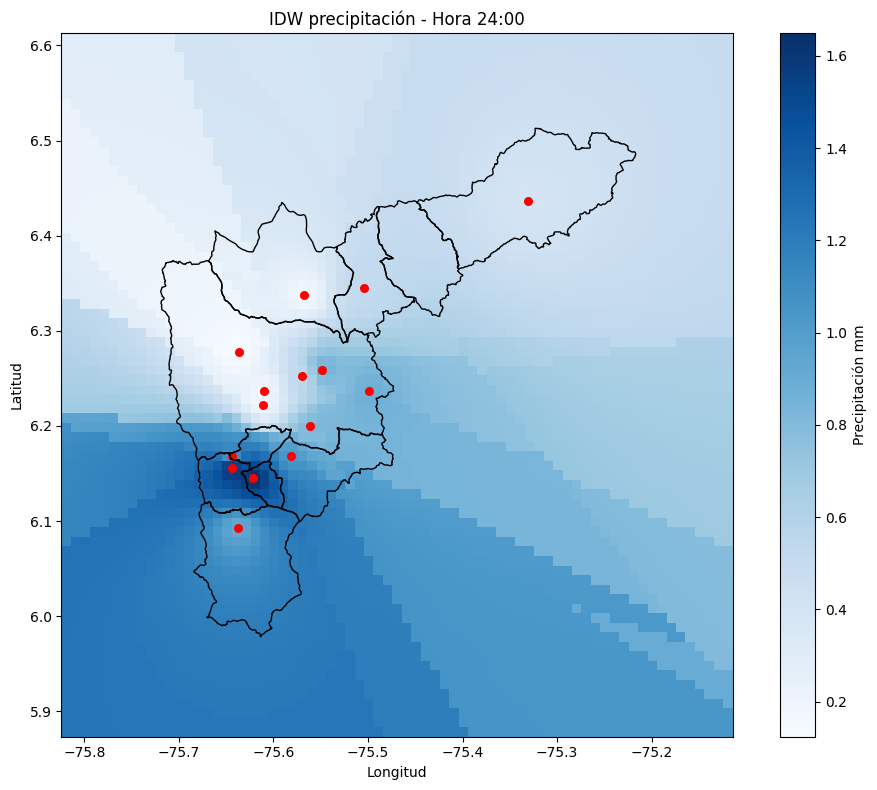

In [55]:
from sklearn.neighbors import KNeighborsRegressor
from functools import partial
import matplotlib.pyplot as plt
import numpy as np

# Función de pesos IDW
def idw_weights(distances, p=2):
    distances = distances.copy()
    distances[distances == 0] = 1e-12
    return 1 / distances**p

weights_idw = partial(idw_weights, p=2)

# Preparar el grid
grid_points = np.vstack([grid_lon.ravel(), grid_lat.ravel()]).T

# Iterar sobre cada hora (1 a 24)
for hora in sorted(horarios['hora'].unique()):
    df_hora = horarios[horarios['hora'] == hora].dropna(subset=['pp_horaria'])

    X_train = df_hora[['Longitud', 'Latitud']].values
    y_train = df_hora['pp_horaria'].values

    if len(X_train) < 3:
        print(f"⚠️ No se interpola hora {hora}, pocos datos.")
        continue

    model = KNeighborsRegressor(n_neighbors=min(5, len(X_train)), weights=weights_idw)
    model.fit(X_train, y_train)

    y_pred = model.predict(grid_points)
    interp_grid = y_pred.reshape(grid_lon.shape)

    # --- Graficar ---
    fig, ax = plt.subplots(figsize=(10, 8))
    c = ax.pcolormesh(grid_lon, grid_lat, interp_grid, cmap='Blues', shading='auto')
    plt.colorbar(c, ax=ax, label='Precipitación mm')

    municipios.boundary.plot(ax=ax, color='black', linewidth=1)
    estpm.plot(ax=ax, color='red', markersize=30)

    ax.set_title(f"IDW precipitación - Hora {hora}:00")
    ax.set_xlabel("Longitud")
    ax.set_ylabel("Latitud")
    plt.tight_layout()

    # Guardar si deseas
    # plt.savefig(f"idw_pm25_hora_{hora:02d}.png", dpi=300)
    plt.show()


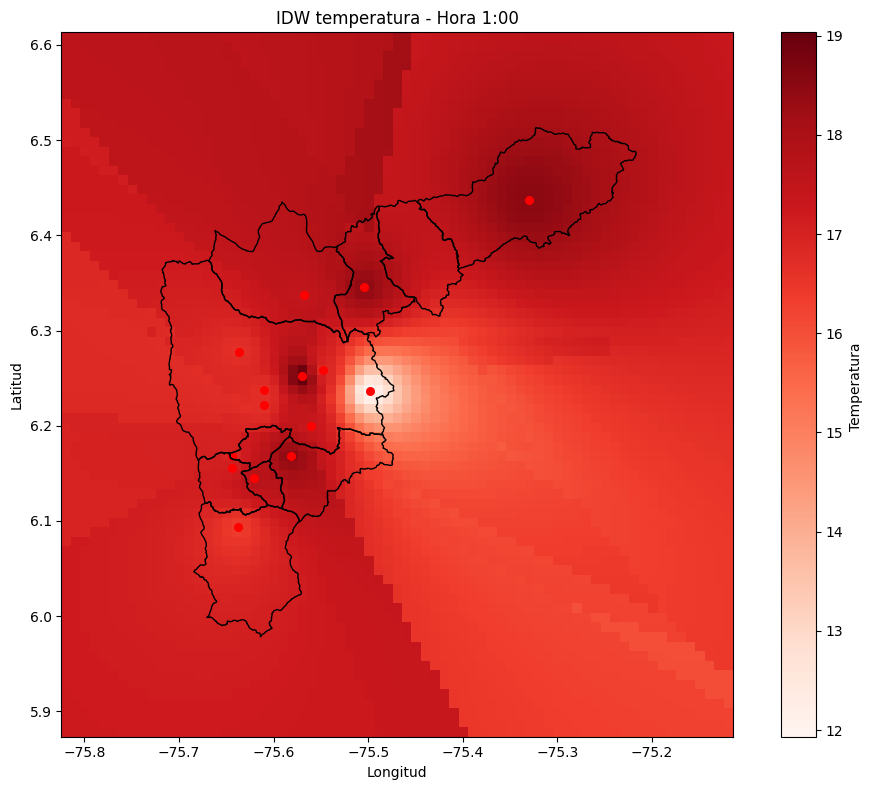

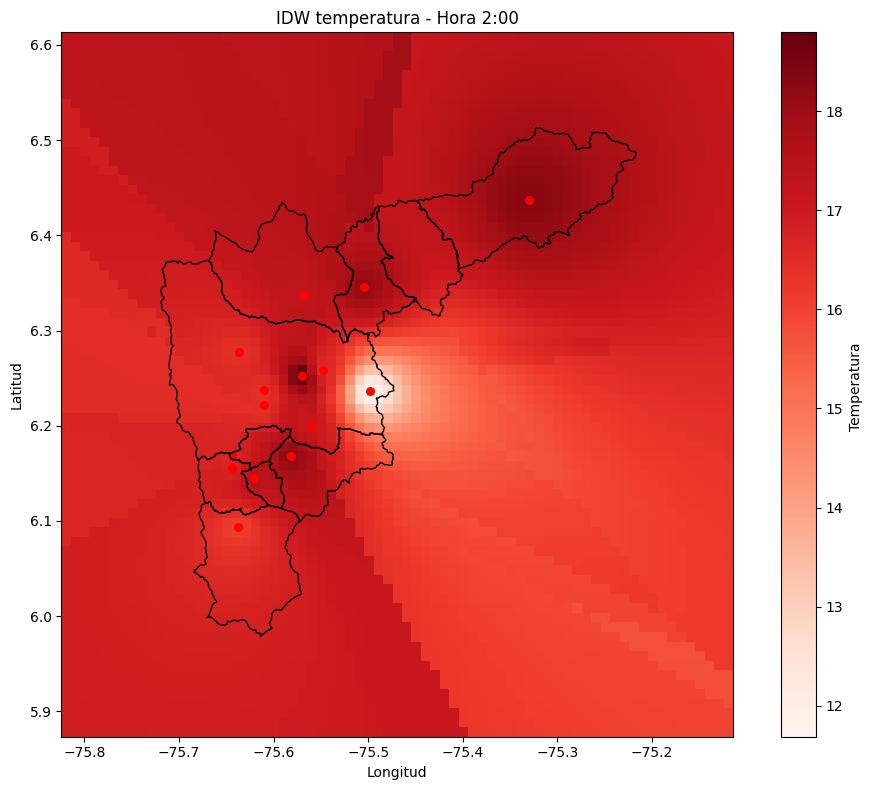

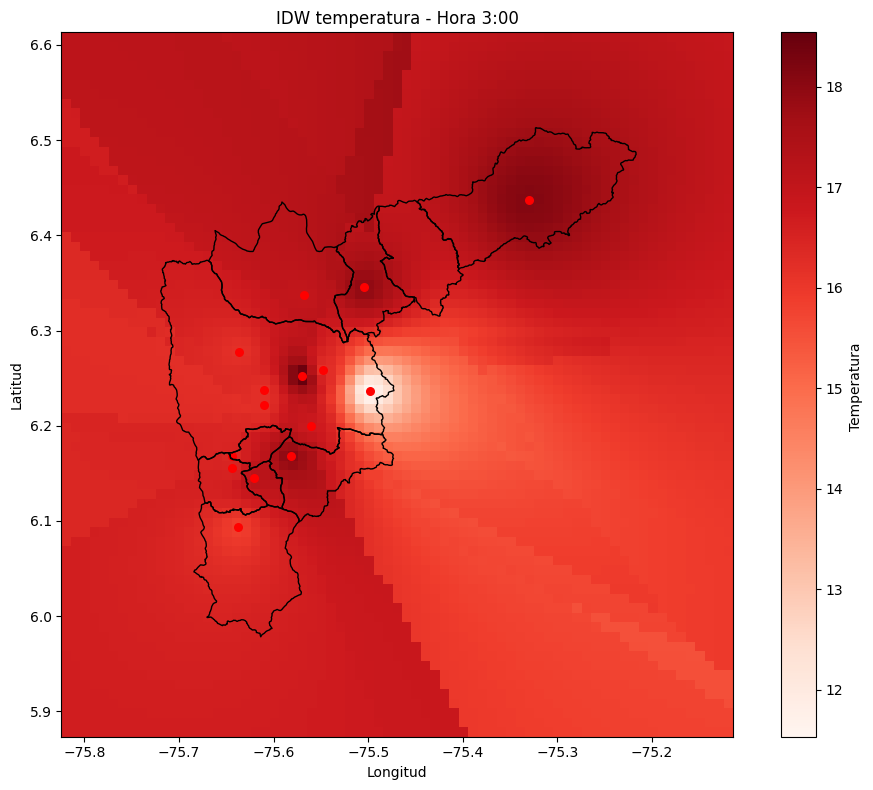

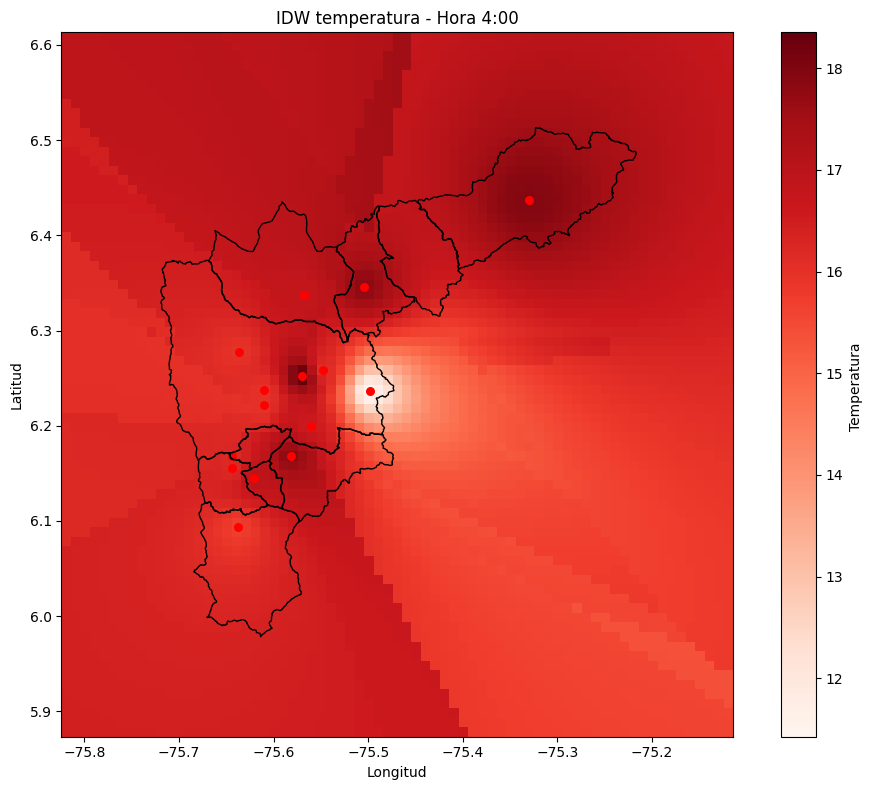

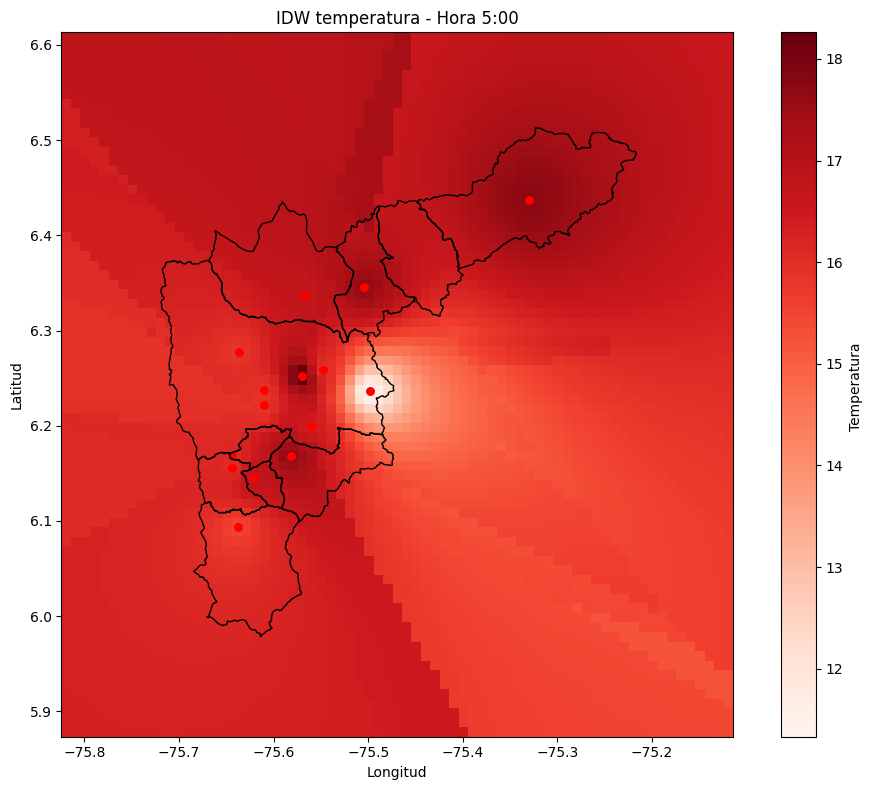

...

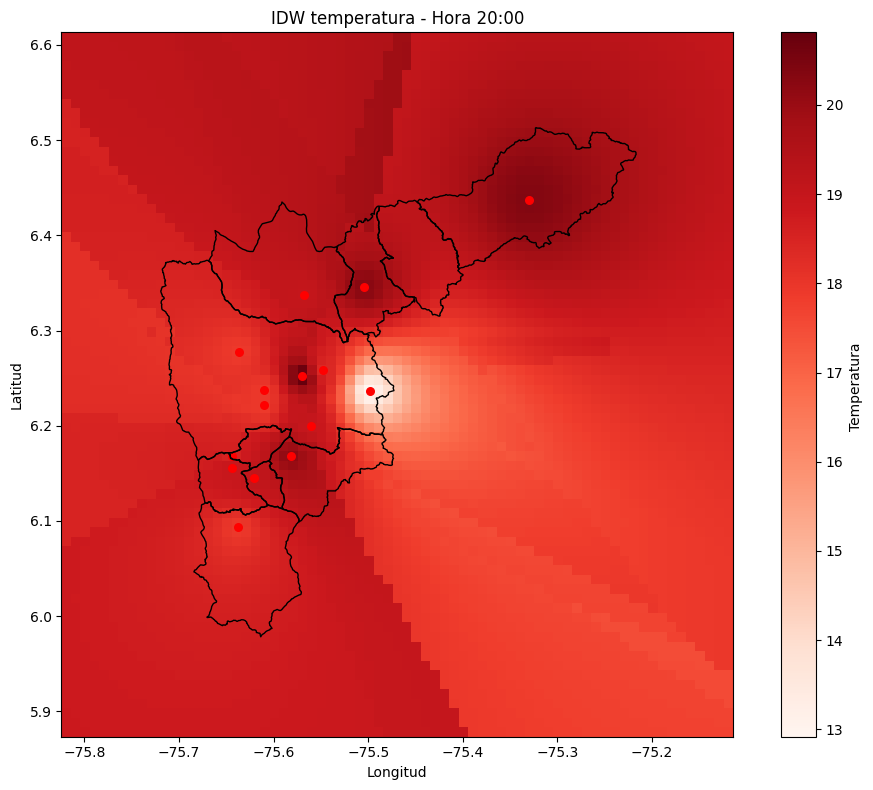

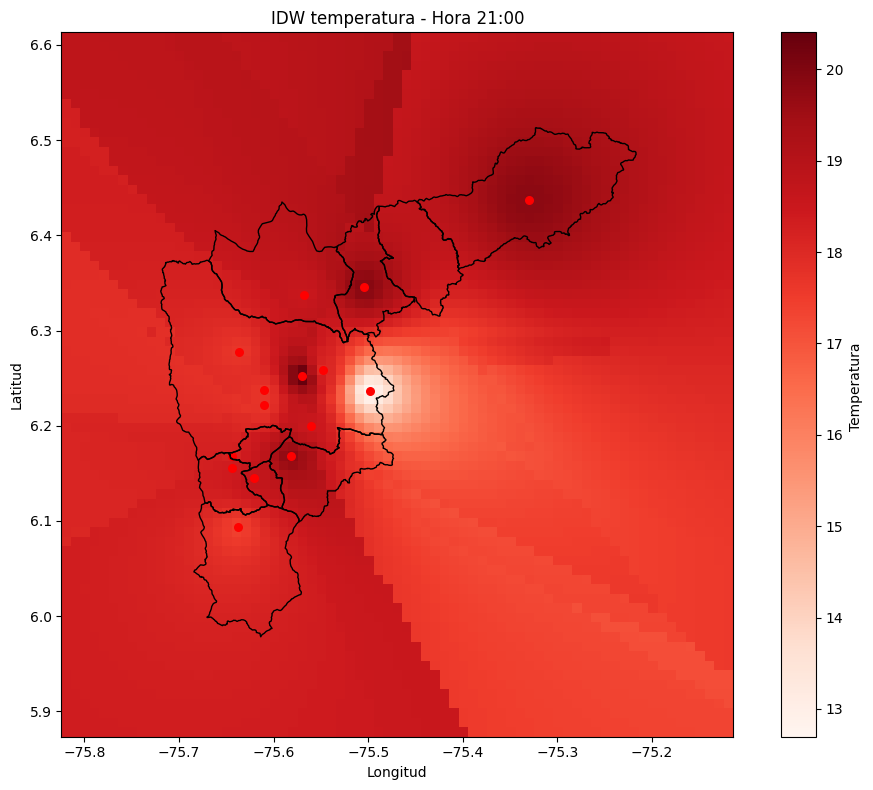

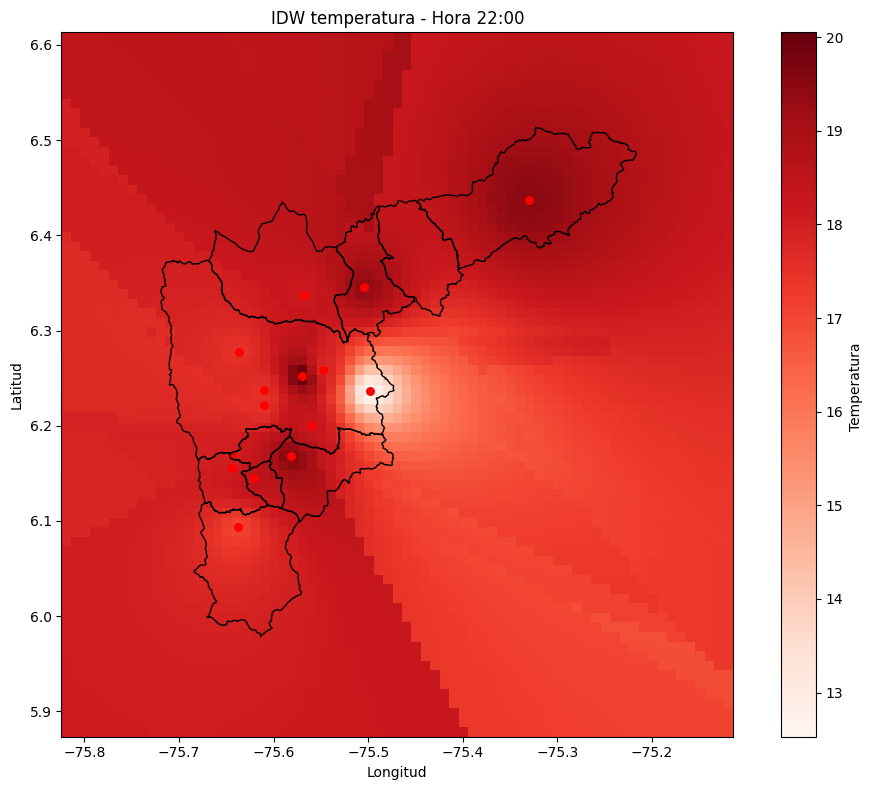

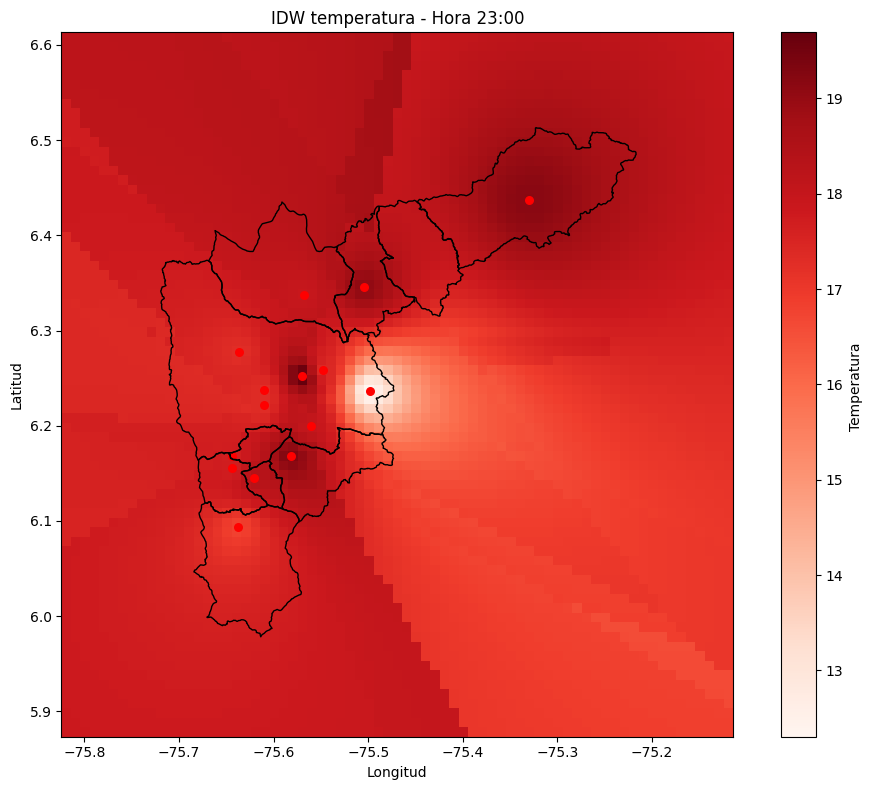

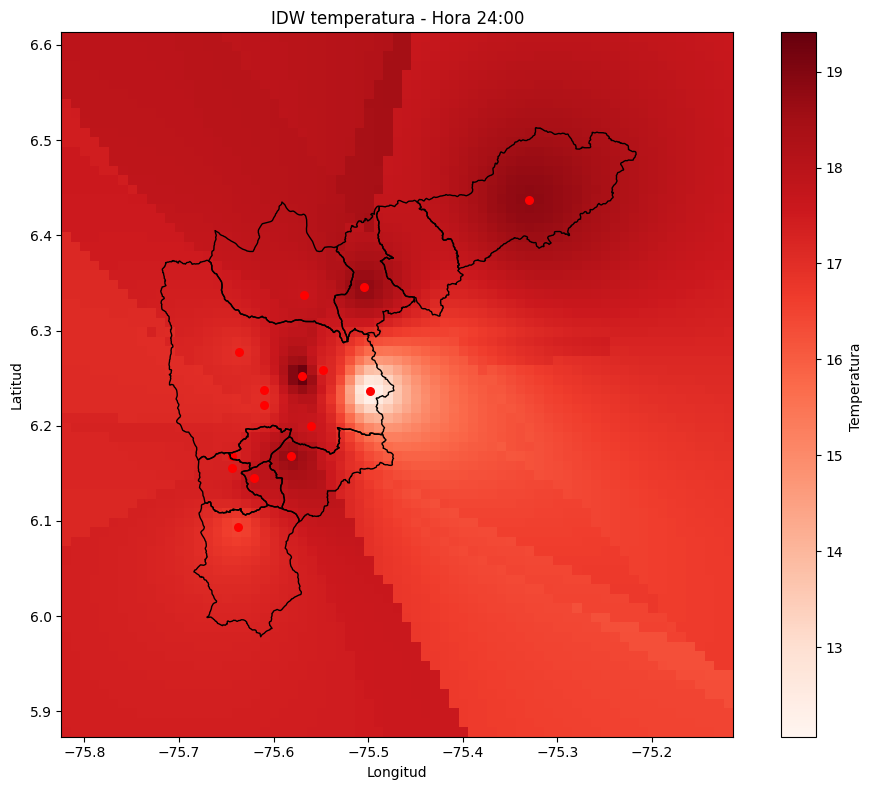

In [57]:
from sklearn.neighbors import KNeighborsRegressor
from functools import partial
import matplotlib.pyplot as plt
import numpy as np

# Función de pesos IDW
def idw_weights(distances, p=2):
    distances = distances.copy()
    distances[distances == 0] = 1e-12
    return 1 / distances**p

weights_idw = partial(idw_weights, p=2)

# Preparar el grid
grid_points = np.vstack([grid_lon.ravel(), grid_lat.ravel()]).T

# Iterar sobre cada hora (1 a 24)
for hora in sorted(horarios['hora'].unique()):
    df_hora = horarios[horarios['hora'] == hora].dropna(subset=['temperatura'])

    X_train = df_hora[['Longitud', 'Latitud']].values
    y_train = df_hora['temperatura'].values

    if len(X_train) < 3:
        print(f"⚠️ No se interpola hora {hora}, pocos datos.")
        continue

    model = KNeighborsRegressor(n_neighbors=min(5, len(X_train)), weights=weights_idw)
    model.fit(X_train, y_train)

    y_pred = model.predict(grid_points)
    interp_grid = y_pred.reshape(grid_lon.shape)

    # --- Graficar ---
    fig, ax = plt.subplots(figsize=(10, 8))
    c = ax.pcolormesh(grid_lon, grid_lat, interp_grid, cmap='Reds', shading='auto')
    plt.colorbar(c, ax=ax, label='Temperatura ')

    municipios.boundary.plot(ax=ax, color='black', linewidth=1)
    estpm.plot(ax=ax, color='red', markersize=30)

    ax.set_title(f"IDW temperatura - Hora {hora}:00")
    ax.set_xlabel("Longitud")
    ax.set_ylabel("Latitud")
    plt.tight_layout()

    # Guardar si deseas
    # plt.savefig(f"idw_pm25_hora_{hora:02d}.png", dpi=300)
    plt.show()


In [70]:
horarios

,Unnamed: 0_x,Codigo,Estacion,Ciudad,Longitud,Latitud,geometry,Unnamed: 0_y,hora,pm25,pp_horaria,temperatura
0,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),0,1,28.026581,0.294968,19.163871
1,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),1,2,27.870992,0.540774,18.928801
2,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),2,3,27.077382,1.122516,18.679000
3,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),3,4,26.379148,0.409677,18.487376
4,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),4,5,26.380198,0.270387,18.398113
...,...,...,...,...,...,...,...,...,...,...,...,...
355,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),355,20,11.010333,0.098323,12.894070
356,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),356,21,12.649717,0.409677,12.673548
357,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),357,22,12.676909,0.122903,12.506495
358,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),358,23,11.904949,0.155677,12.283457


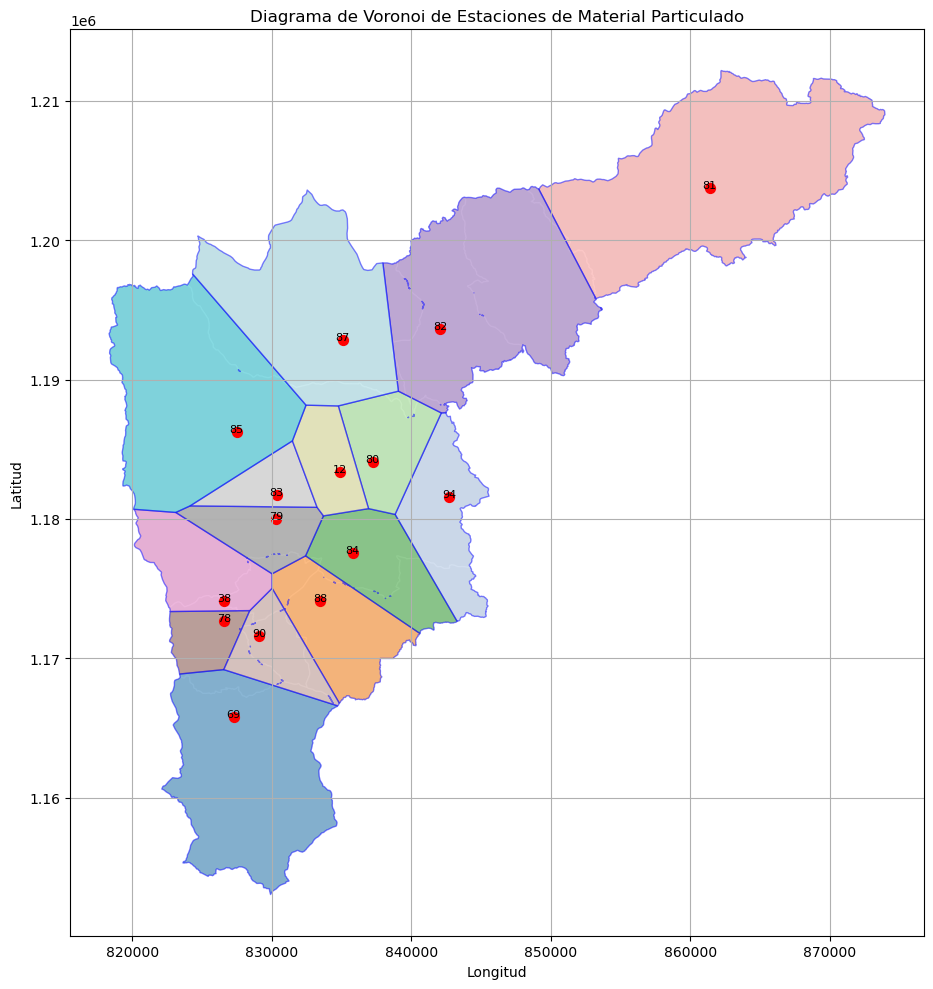

In [208]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point, MultiPoint, Polygon
from shapely.ops import voronoi_diagram
import numpy as np

# 1. Cargar los datos
# Asumo que estpm es un DataFrame de pandas con columnas: Codigo, Longitud, Latitud
# Convertimos a GeoDataFrame
geometry = [Point(xy) for xy in zip(estpm['Longitud'], estpm['Latitud'])]
gdf_estaciones = gpd.GeoDataFrame(estpm, geometry=geometry, crs="EPSG:4326")


# 2. Alinear sistemas de coordenadas (reproyectar a un CRS adecuado)
# Por ejemplo, usar un CRS proyectado para Colombia (cambia según tu ubicación)
crs_proyectado = "EPSG:3116"  # Ejemplo para Colombia
gdf_estaciones = gdf_estaciones.to_crs(crs_proyectado)
municipios = municipios.to_crs(crs_proyectado)

# 3. Crear polígonos de Voronoi
# Obtener todos los puntos como MultiPoint
multipunto = MultiPoint(gdf_estaciones.geometry.tolist())

# Generar diagrama de Voronoi
voronoi = voronoi_diagram(multipunto)

# Convertir a GeoDataFrame
poligonos_voronoi = gpd.GeoDataFrame(geometry=list(voronoi.geoms), crs=crs_proyectado)

# 4. Recortar los polígonos de Voronoi con el área de los municipios
# Crear un polígono que englobe todos los municipios
area_total = municipios.unary_union

# Recortar los polígonos de Voronoi
poligonos_voronoi_recortados = gpd.clip(poligonos_voronoi, area_total)

# 5. Visualización
fig, ax = plt.subplots(figsize=(15, 10))

# Dibujar municipios de fondo
municipios.plot(ax=ax, color='lightgrey', edgecolor='white', alpha=0.5)

# Dibujar polígonos de Voronoi
poligonos_voronoi_recortados.plot(ax=ax, alpha=0.5, edgecolor='blue', cmap='tab20')

# Dibujar estaciones
gdf_estaciones.plot(ax=ax, color='red', markersize=50)

# Añadir etiquetas
for x, y, label in zip(gdf_estaciones.geometry.x, gdf_estaciones.geometry.y, gdf_estaciones['Codigo']):
    ax.text(x, y, label, fontsize=8, ha='center')

# Configuración adicional
plt.title('Diagrama de Voronoi de Estaciones de Material Particulado')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.grid(True)
plt.tight_layout()
plt.show()

In [17]:
horarios

,Unnamed: 0_x,Codigo,Estacion,Ciudad,Longitud,Latitud,geometry,Unnamed: 0_y,hora,pm25,pp_horaria,temperatura
0,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),0,1,28.026581,0.294968,19.163871
1,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),1,2,27.870992,0.540774,18.928801
2,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),2,3,27.077382,1.122516,18.679000
3,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),3,4,26.379148,0.409677,18.487376
4,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),4,5,26.380198,0.270387,18.398113
...,...,...,...,...,...,...,...,...,...,...,...,...
355,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),355,20,11.010333,0.098323,12.894070
356,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),356,21,12.649717,0.409677,12.673548
357,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),357,22,12.676909,0.122903,12.506495
358,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),358,23,11.904949,0.155677,12.283457


In [115]:
horarios.columns

Index(['Unnamed: 0_x', 'Codigo', 'Estacion', 'Ciudad', 'Longitud', 'Latitud',
       'geometry', 'Unnamed: 0_y', 'hora', 'pm25', 'pp_horaria',
       'temperatura'],
      dtype='object')

In [22]:
horarios.columns

Index(['Unnamed: 0_x', 'Codigo', 'Estacion', 'Ciudad', 'Longitud', 'Latitud',
       'geometry', 'Unnamed: 0_y', 'hora', 'pm25', 'pp_horaria',
       'temperatura'],
      dtype='object')

In [225]:
bounds = municipios.total_bounds  # [xmin, ymin, xmax, ymax]
lon_min, lat_min, lon_max, lat_max = bounds
margin = 0.1
lon_min -= margin
lon_max += margin
lat_min -= margin
lat_max += margin

grid_res = 0.01
grid_lon, grid_lat = np.meshgrid(
    np.arange(lon_min, lon_max, grid_res),
    np.arange(lat_min, lat_max, grid_res)
)


In [251]:
def kriging_por_hora(df, municipios, hora, grid_lon, grid_lat):
    # 1. Filtrar la hora
    df_hora = df[df['hora'] == hora]

    # 2. Extraer datos necesarios
    x = df_hora['Longitud'].values
    y = df_hora['Latitud'].values
    z = df_hora['pm25'].values

    # 3. Kriging Universal
    UK = UniversalKriging(
        x, y, z,
        variogram_model='linear',  # puedes cambiar a 'gaussian', 'spherical' etc.
        drift_terms=['regional_lineal']
    )

    z_krig, ss = UK.execute('grid', grid_lon[0], grid_lat[:,0])  # ejecutar sobre malla

    # 4. Graficar
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Mapa interpolado
    im = ax.contourf(grid_lon, grid_lat, z_krig, cmap='plasma', levels=20)

    # Estaciones de calidad del aire
    ax.scatter(x, y, c='black', marker='o', label='Estaciones')

    # Municipios
    municipios.boundary.plot(ax=ax, edgecolor='gray', linewidth=1)

    # Colorbar
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('PM2.5 µg/m³')

    # Título
    ax.set_title(f'Kriging Universal PM2.5 - Hora {hora}')
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')
    ax.legend()
    plt.tight_layout()
    plt.show()


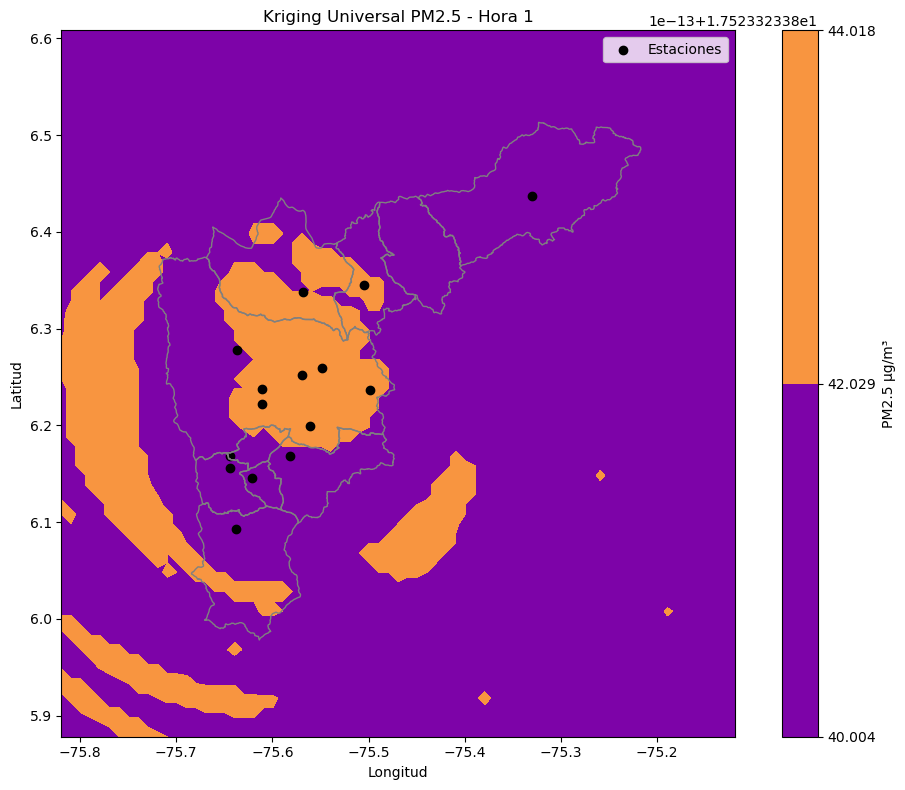

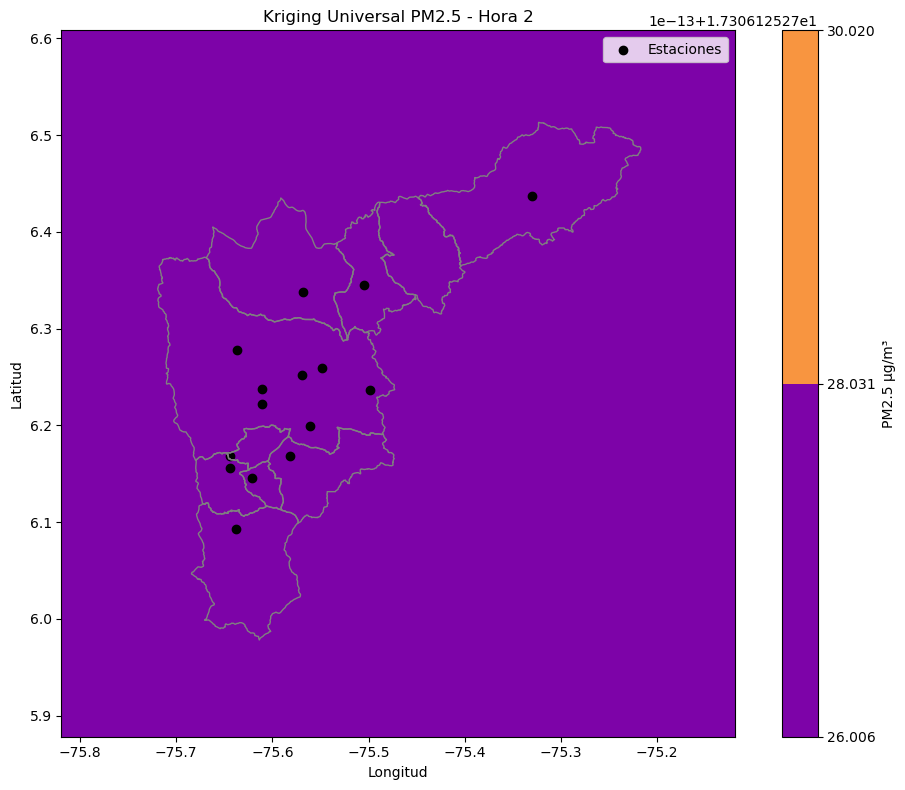

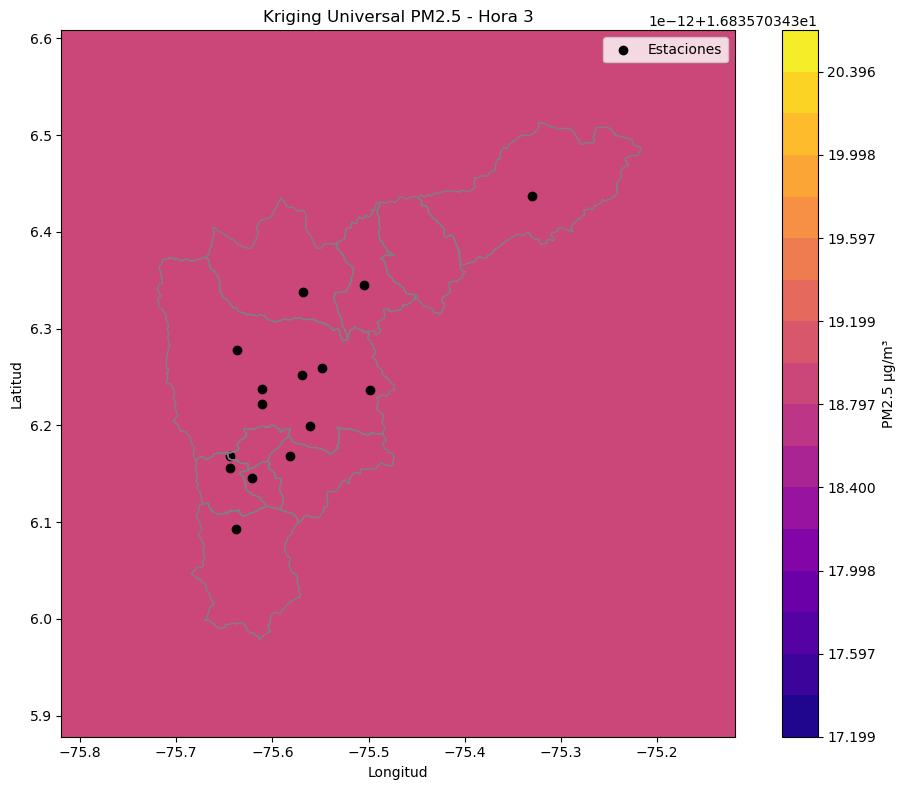

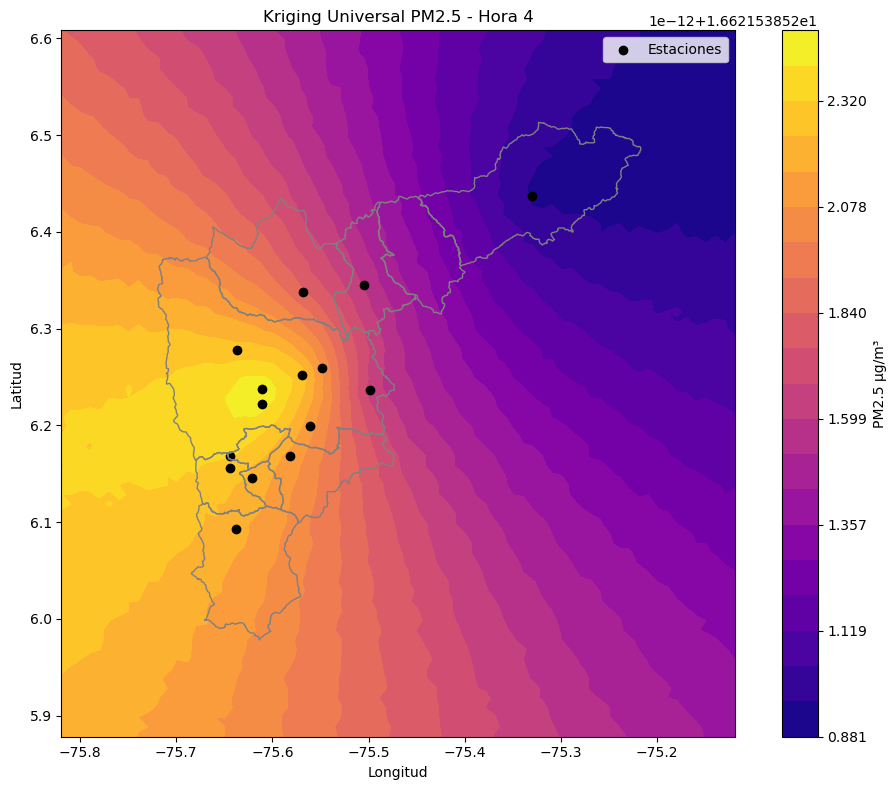

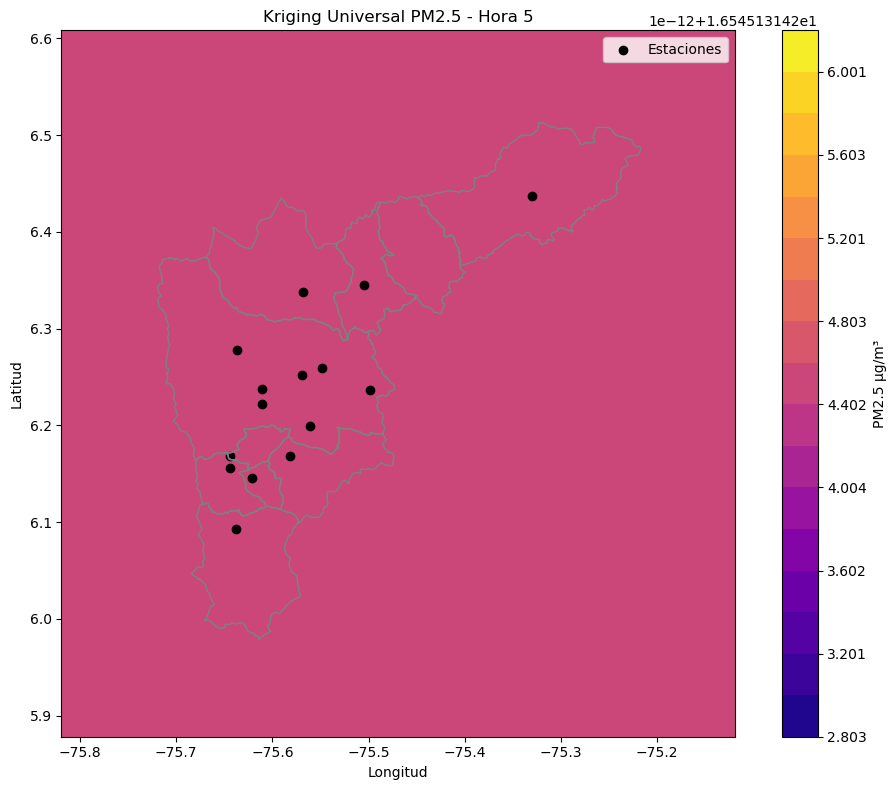

...

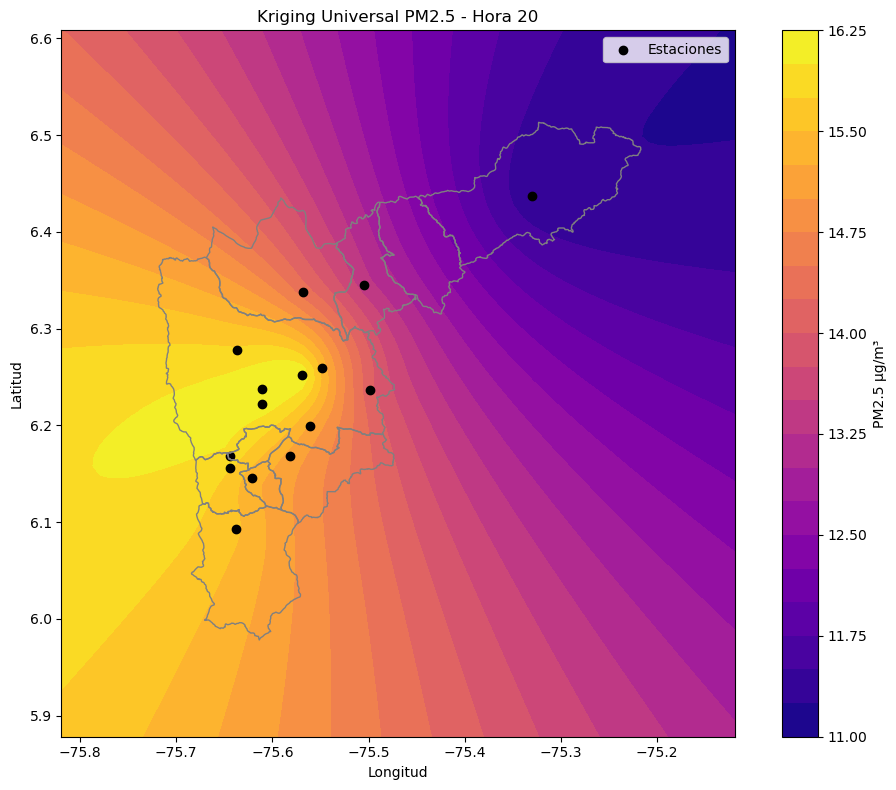

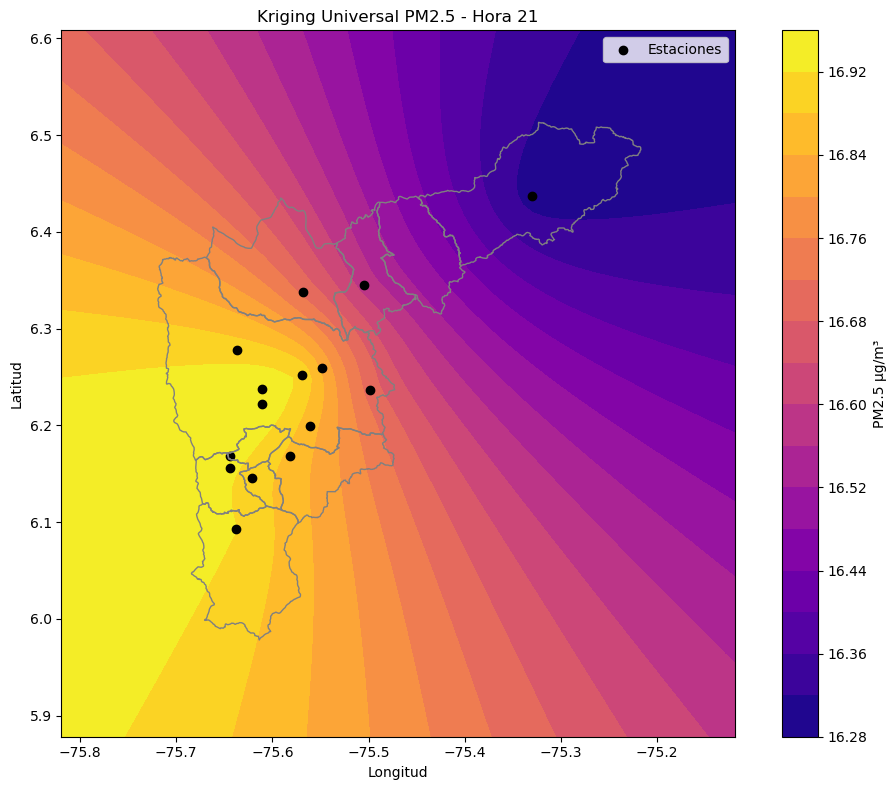

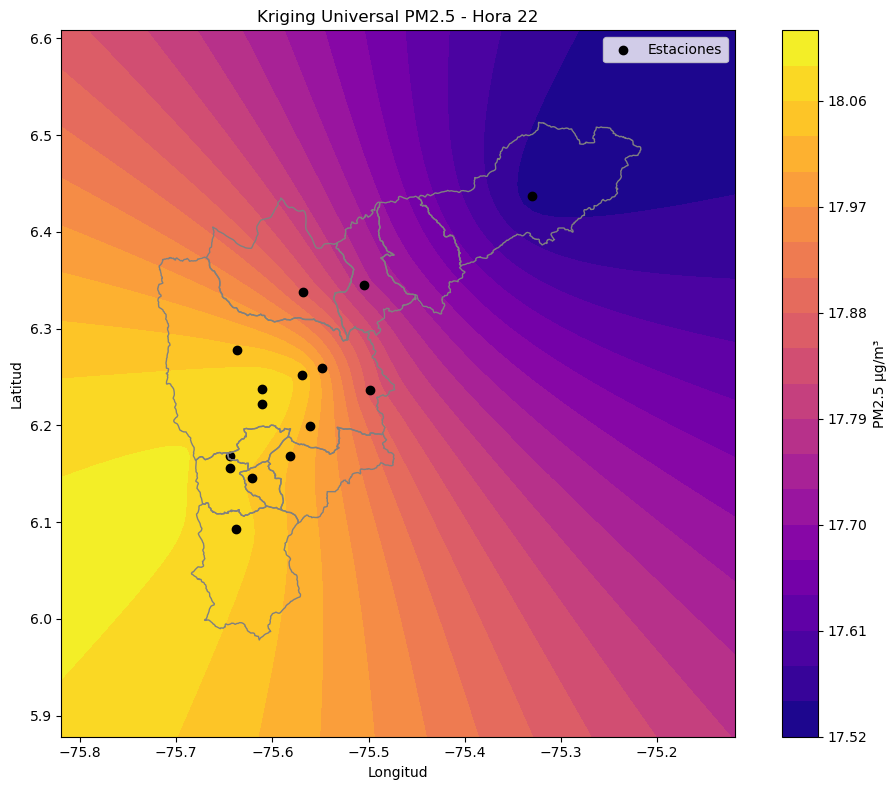

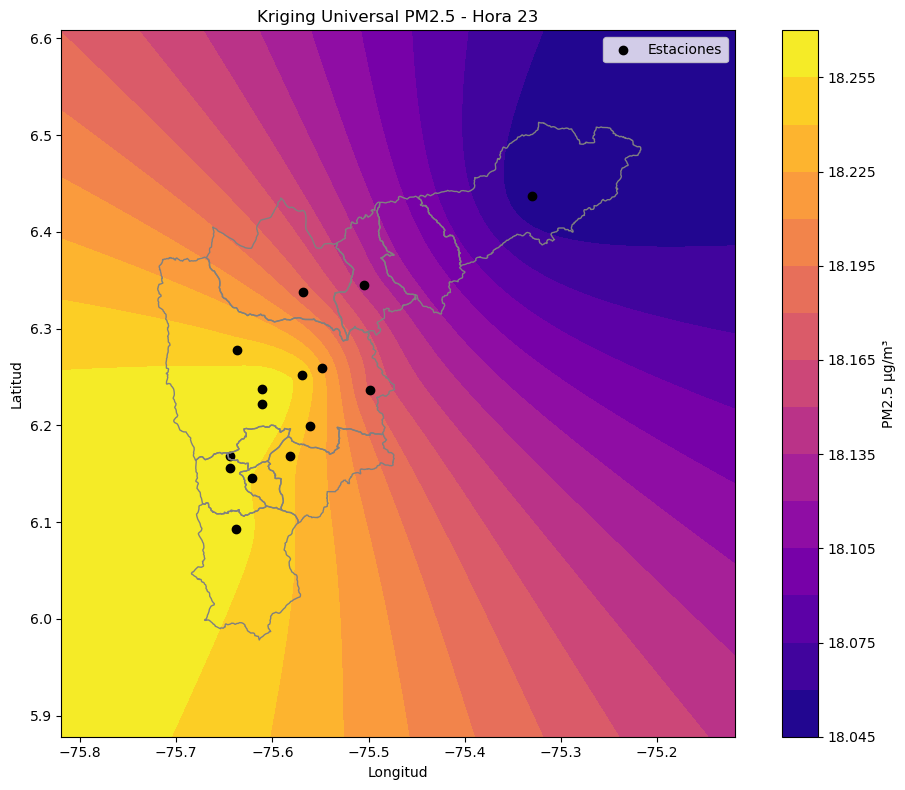

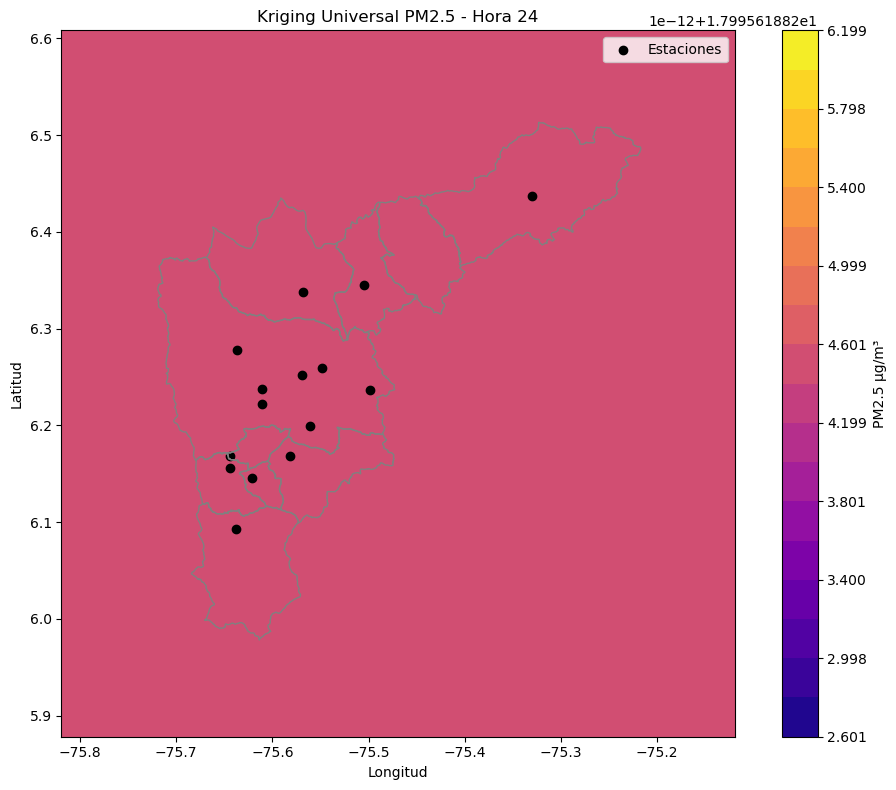

In [252]:
for h in range(1, 25):
    kriging_por_hora(df=horarios, municipios=municipios, hora=h, grid_lon=grid_lon, grid_lat=grid_lat)



=== Procesando hora 1 ===


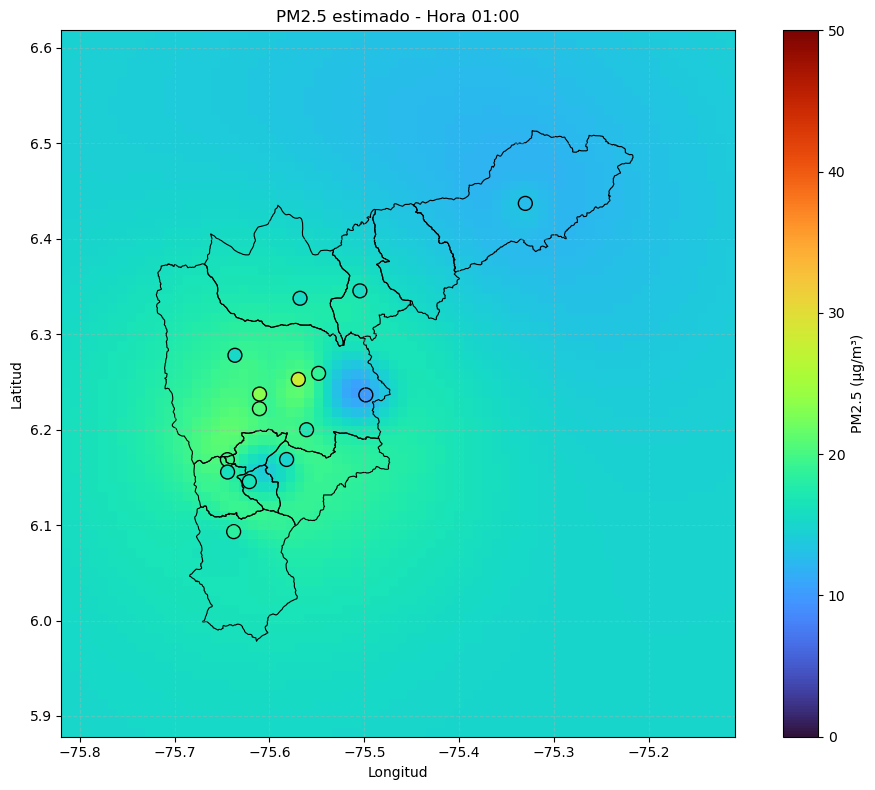


=== Procesando hora 2 ===


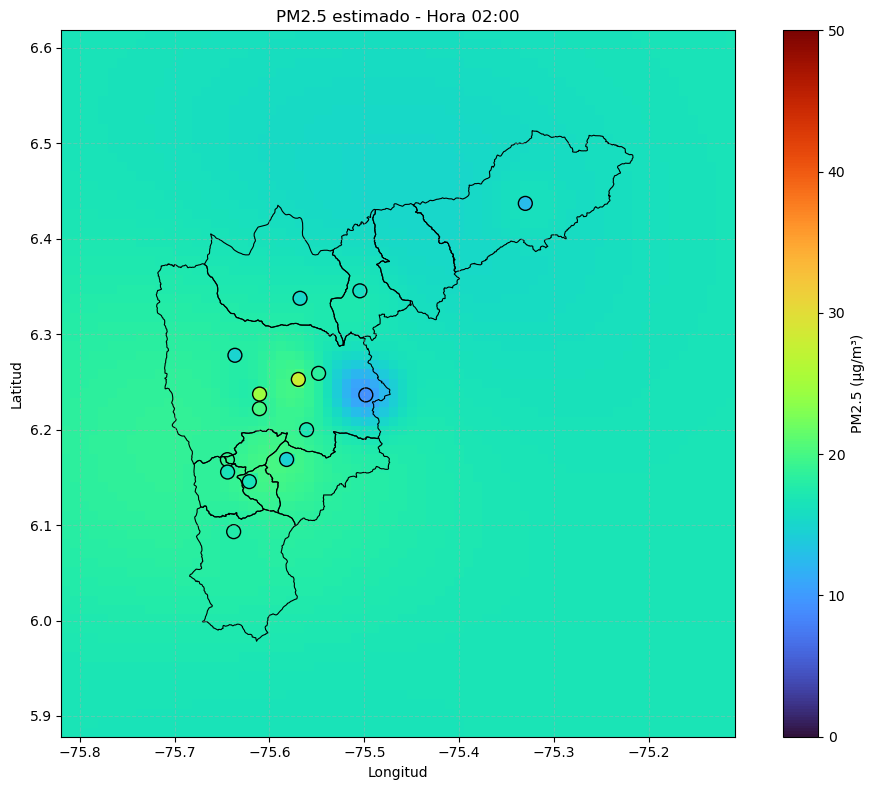


=== Procesando hora 3 ===


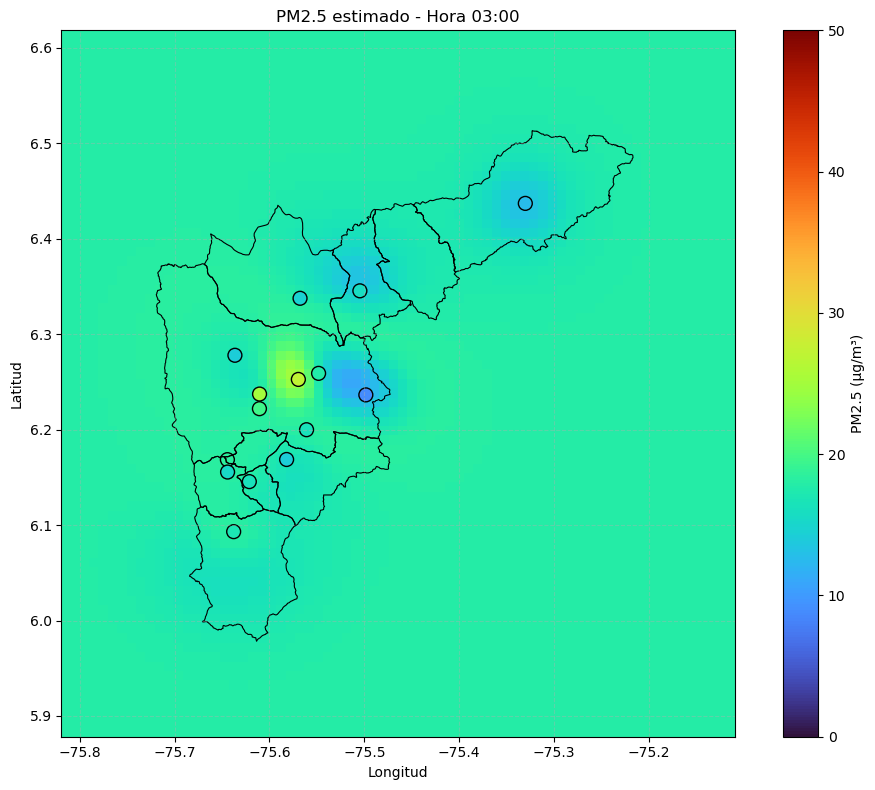


=== Procesando hora 4 ===


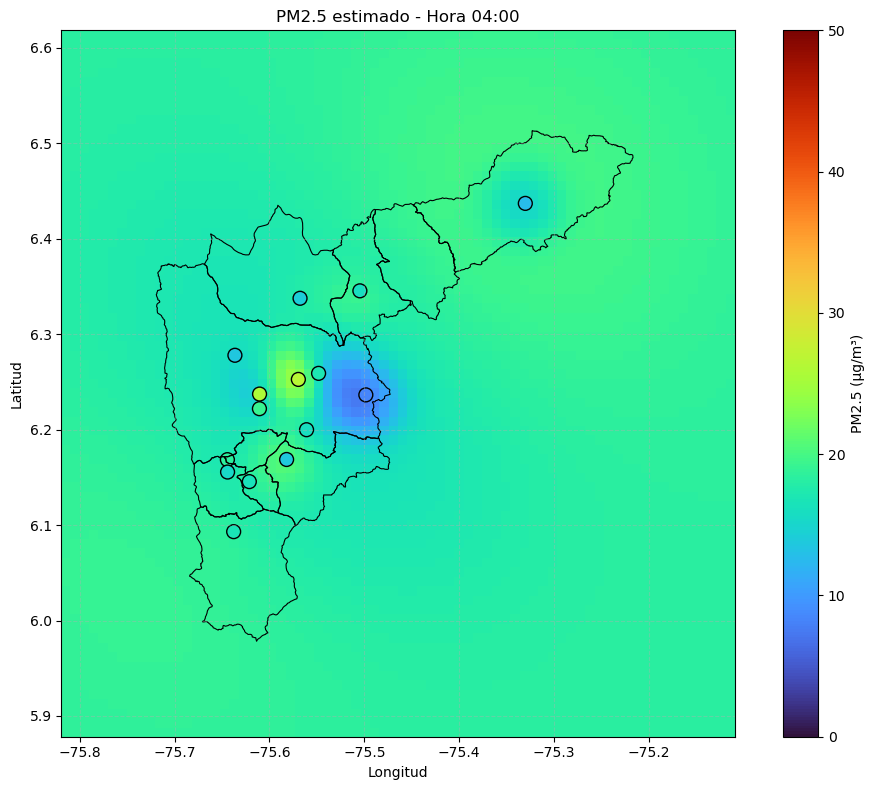


=== Procesando hora 5 ===


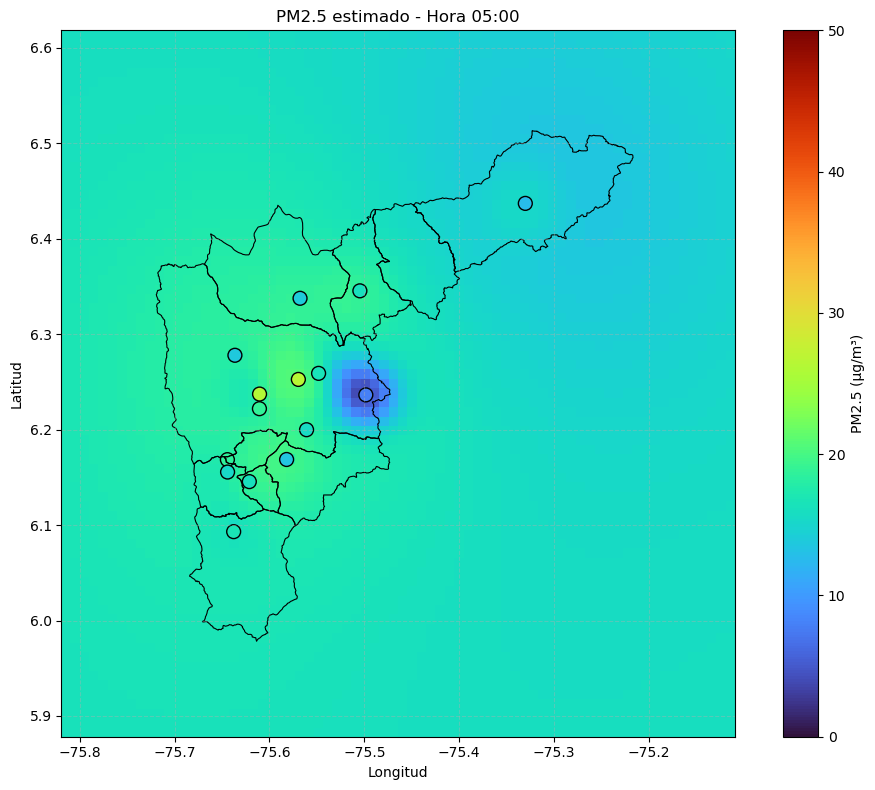


=== Procesando hora 6 ===


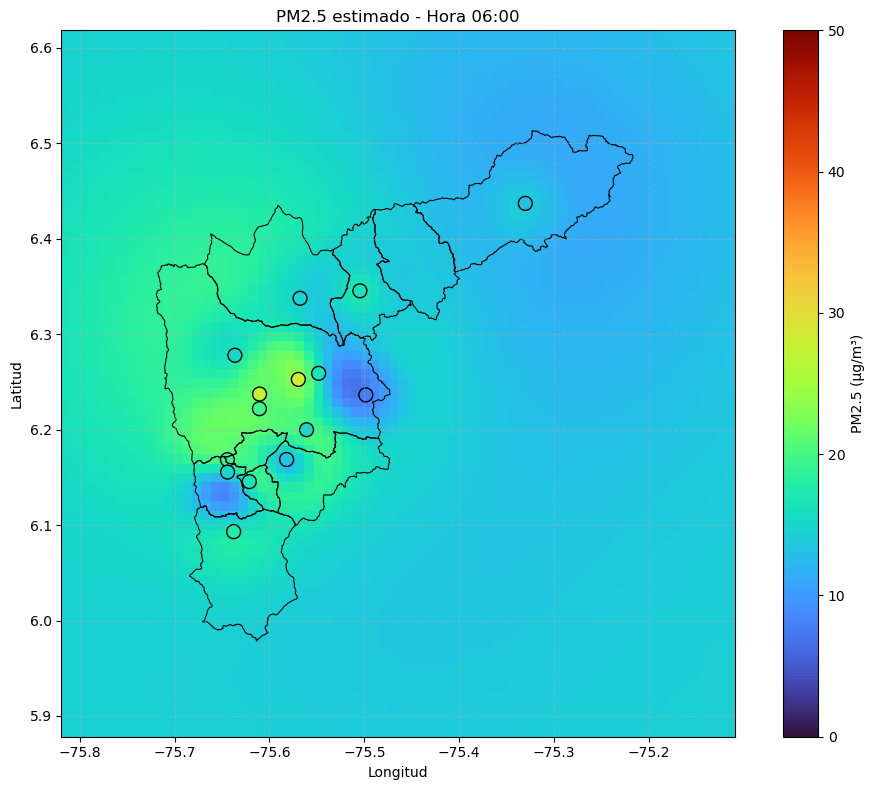


=== Procesando hora 7 ===


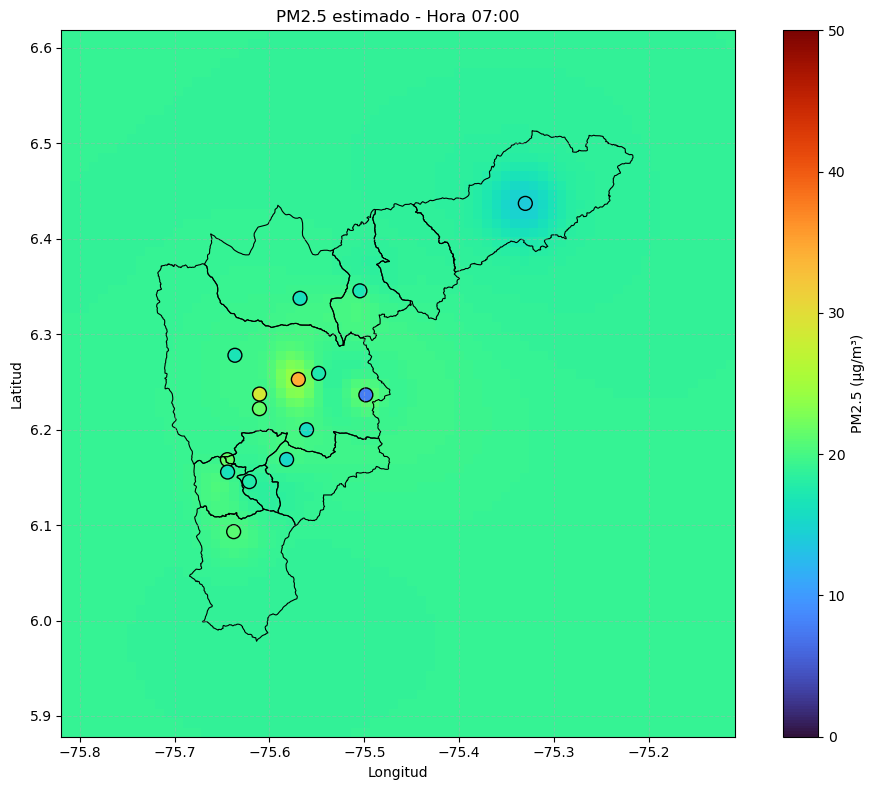


=== Procesando hora 8 ===


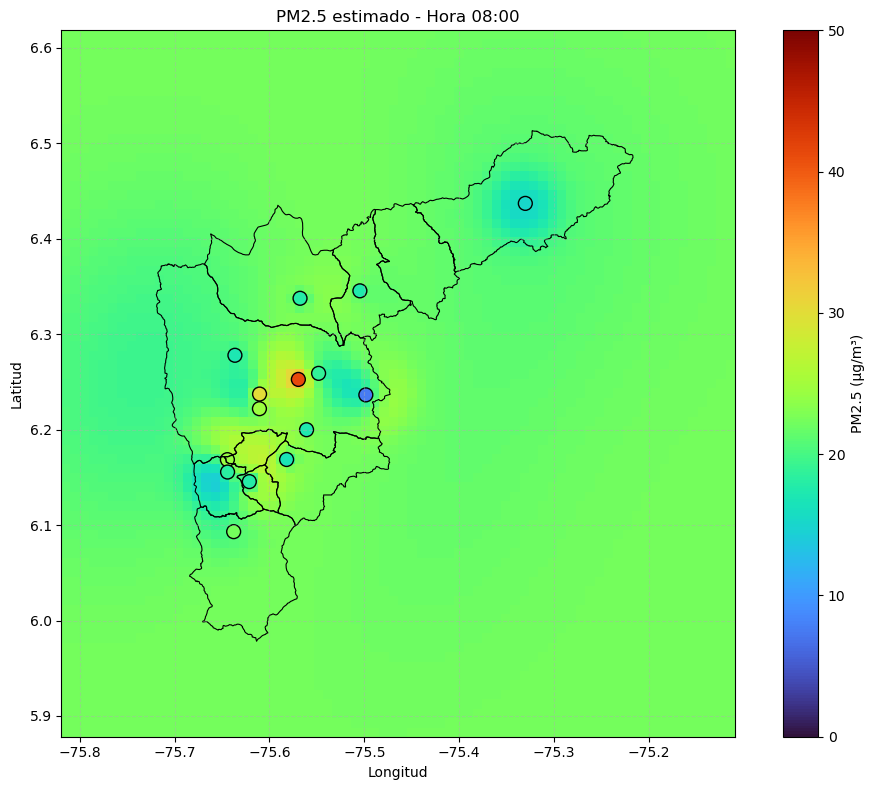


=== Procesando hora 9 ===


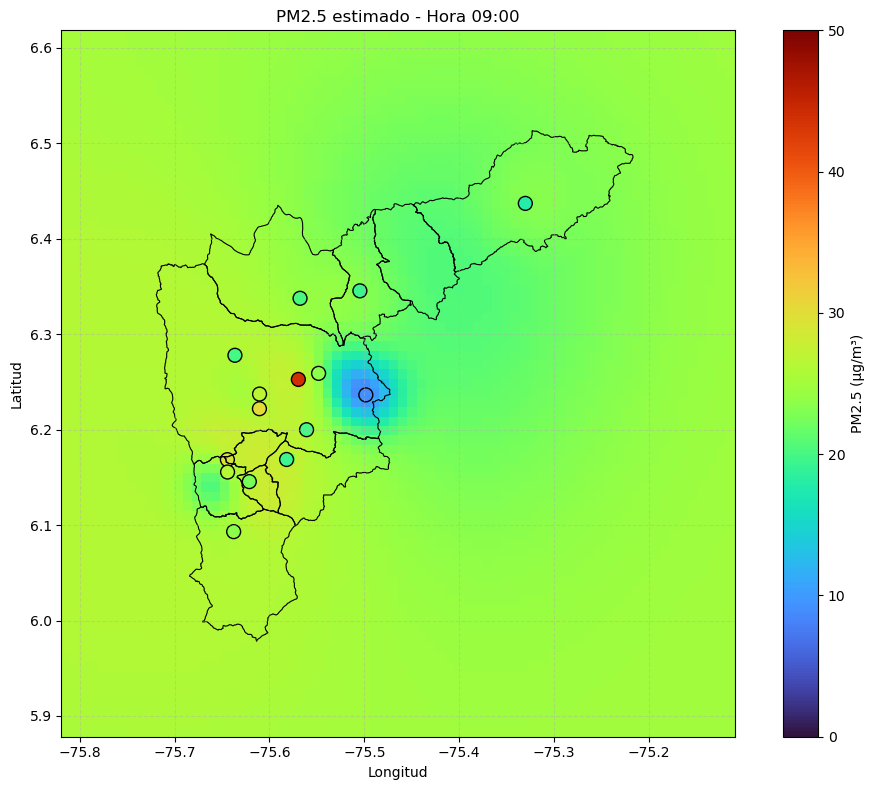


=== Procesando hora 10 ===


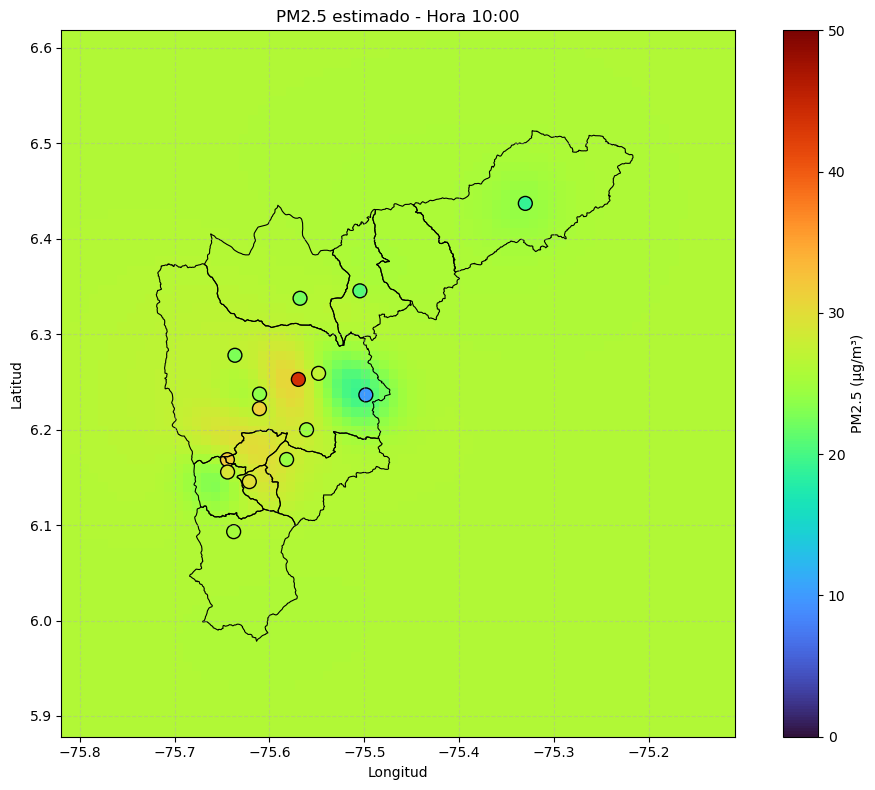


=== Procesando hora 11 ===


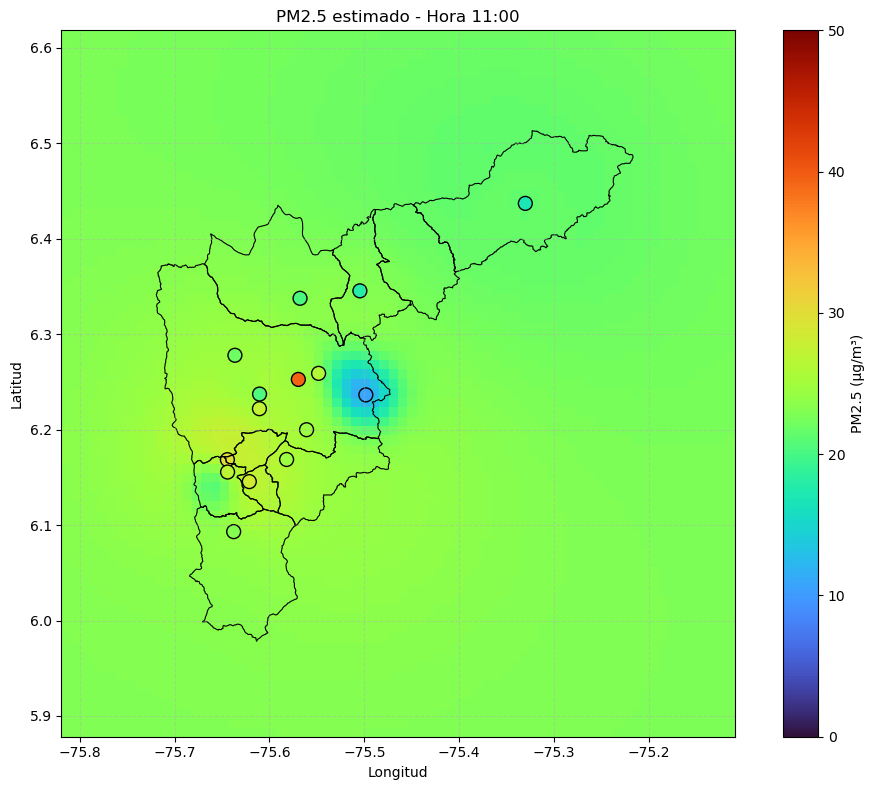


=== Procesando hora 12 ===


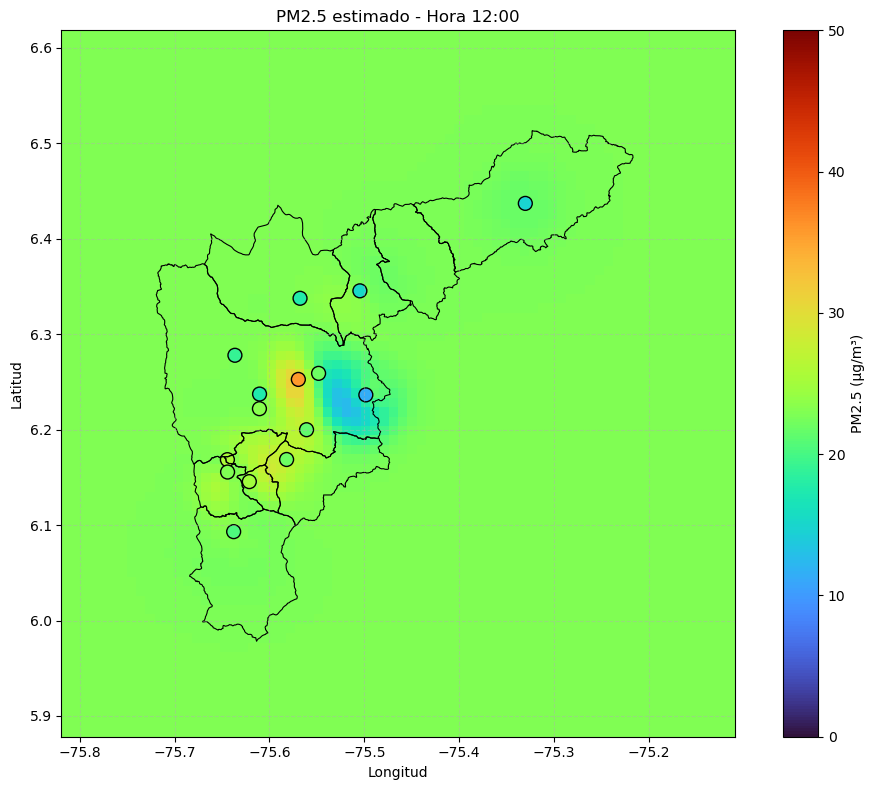


=== Procesando hora 13 ===


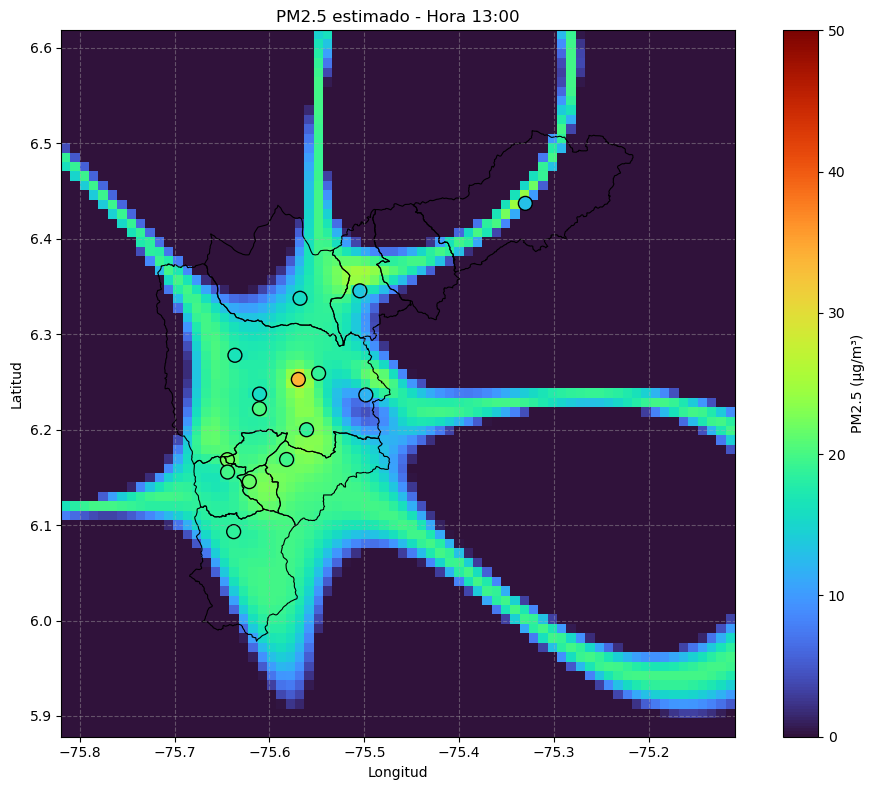


=== Procesando hora 14 ===


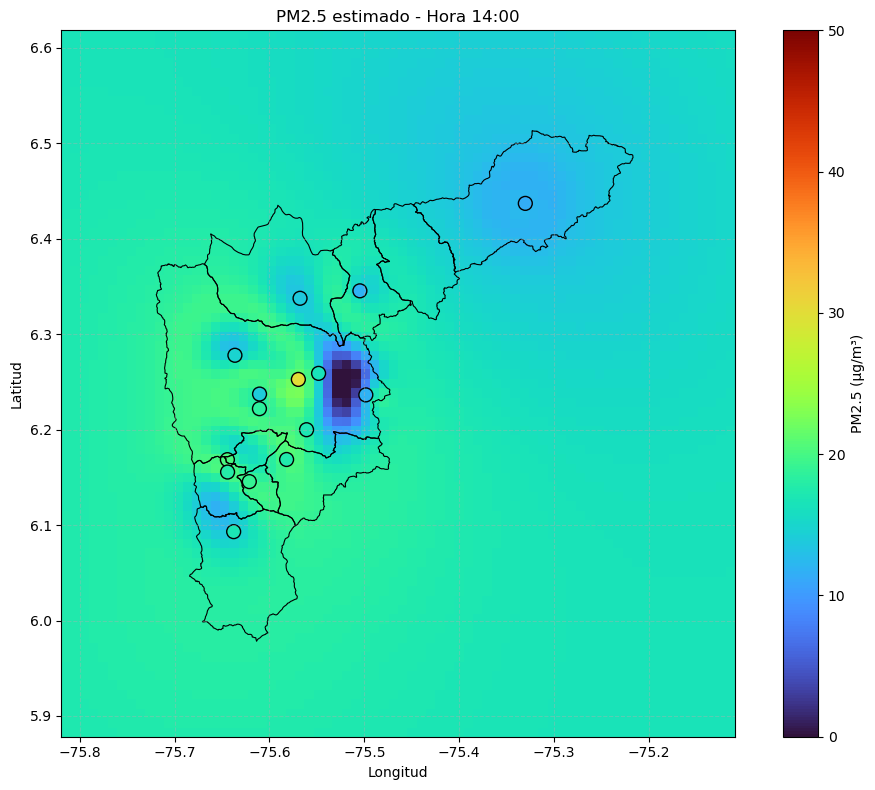


=== Procesando hora 15 ===


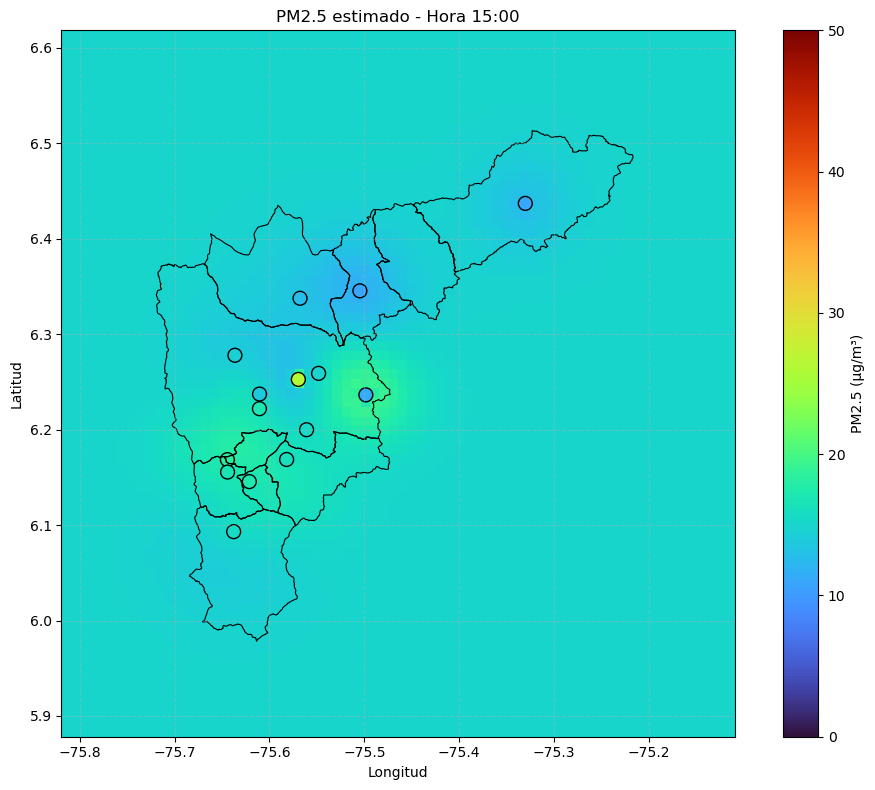


=== Procesando hora 16 ===


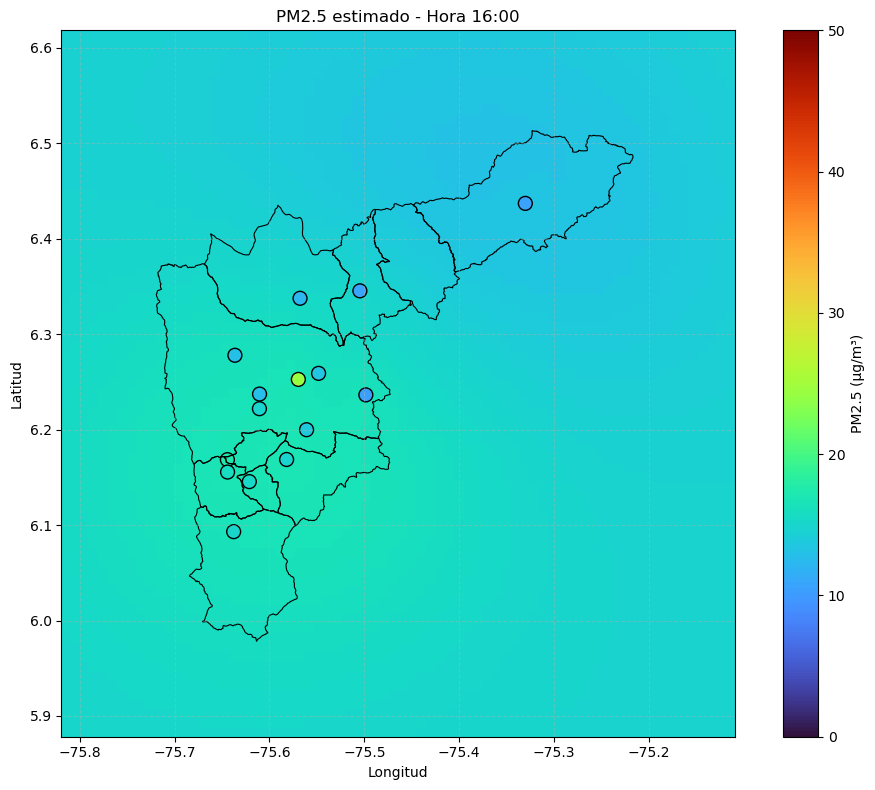


=== Procesando hora 17 ===


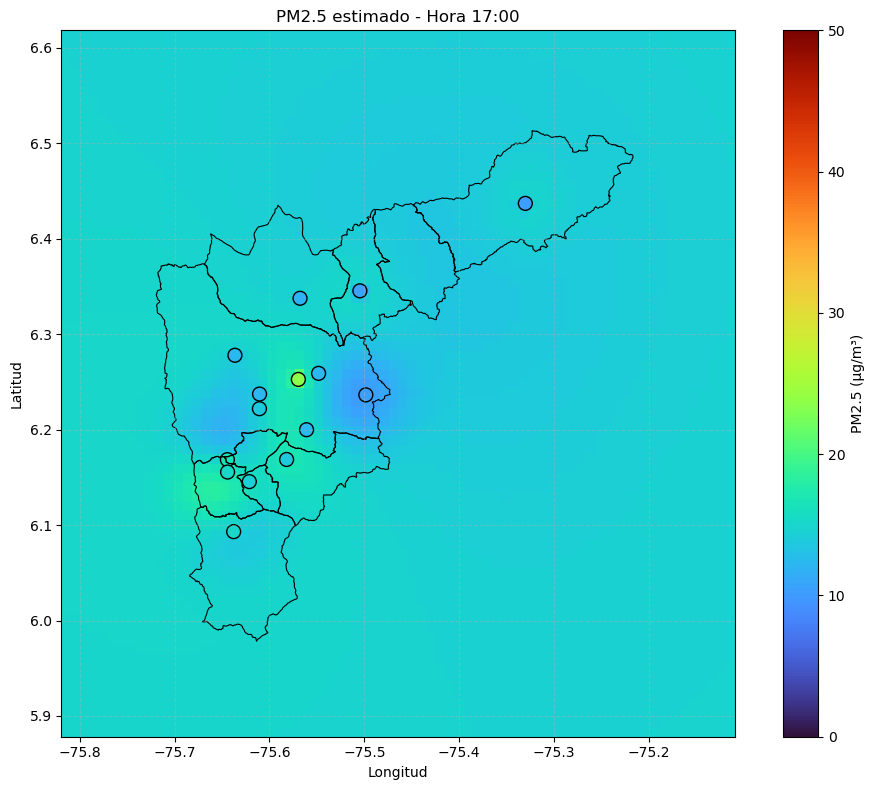


=== Procesando hora 18 ===


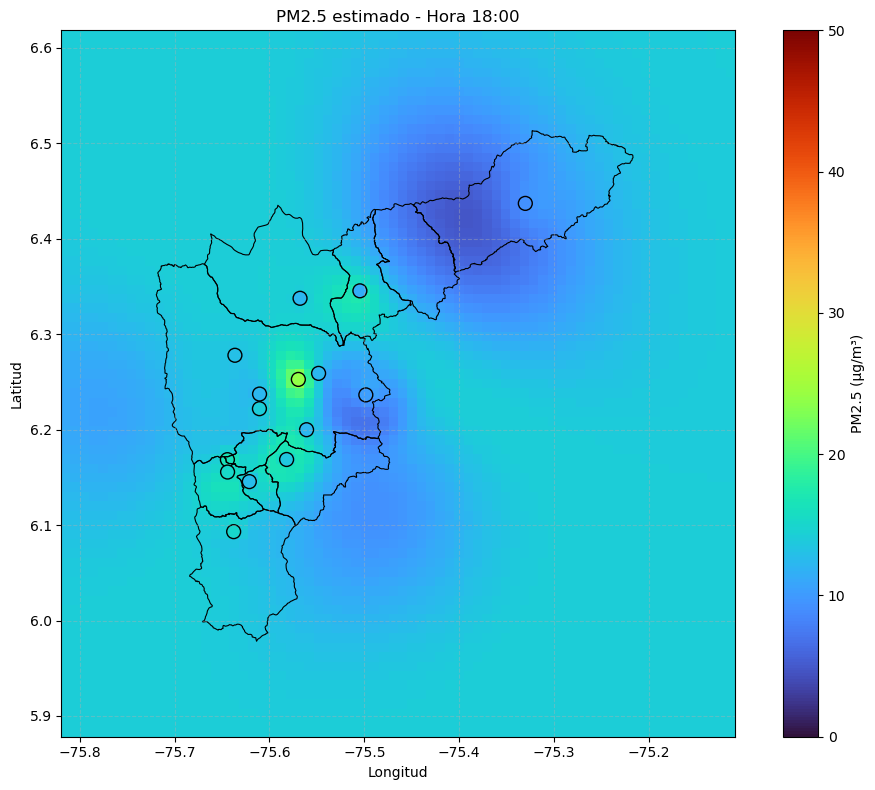


=== Procesando hora 19 ===


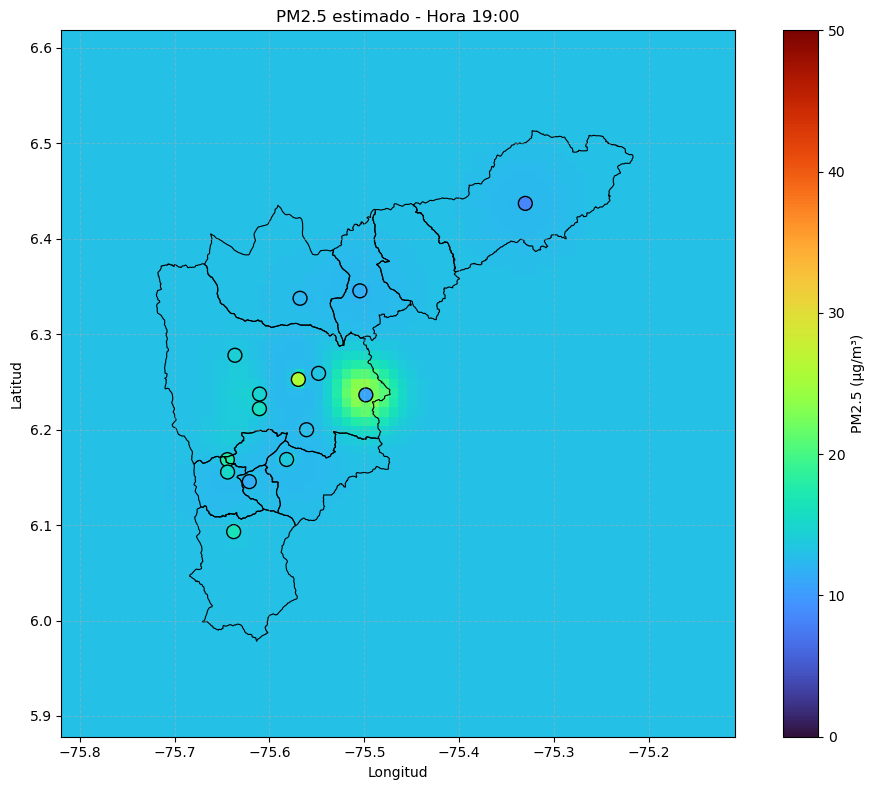


=== Procesando hora 20 ===


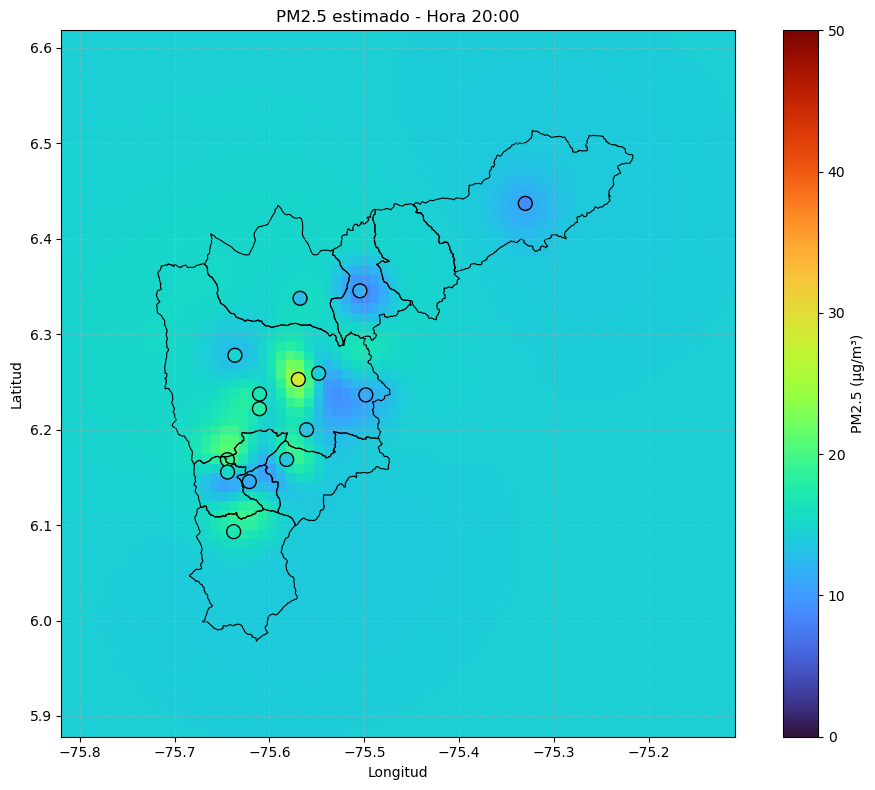


=== Procesando hora 21 ===


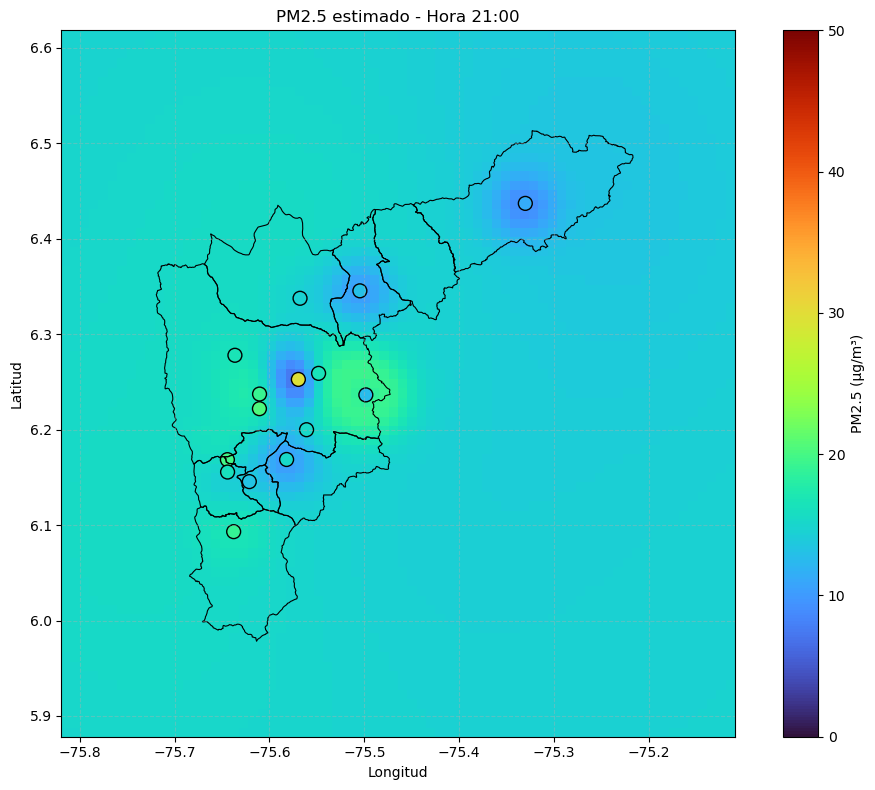


=== Procesando hora 22 ===


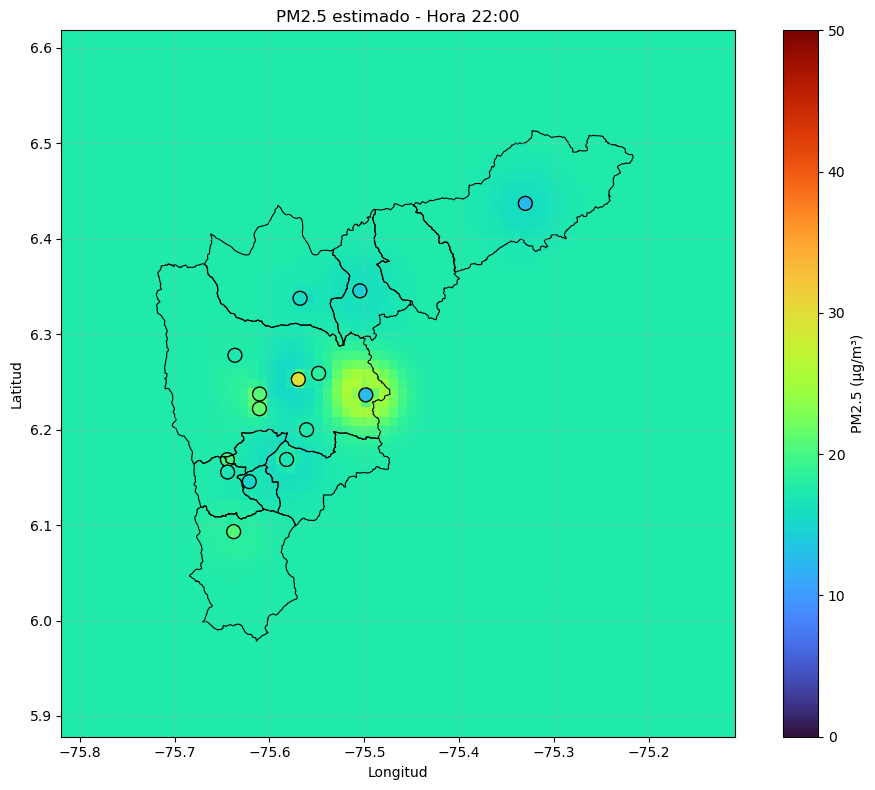


=== Procesando hora 23 ===


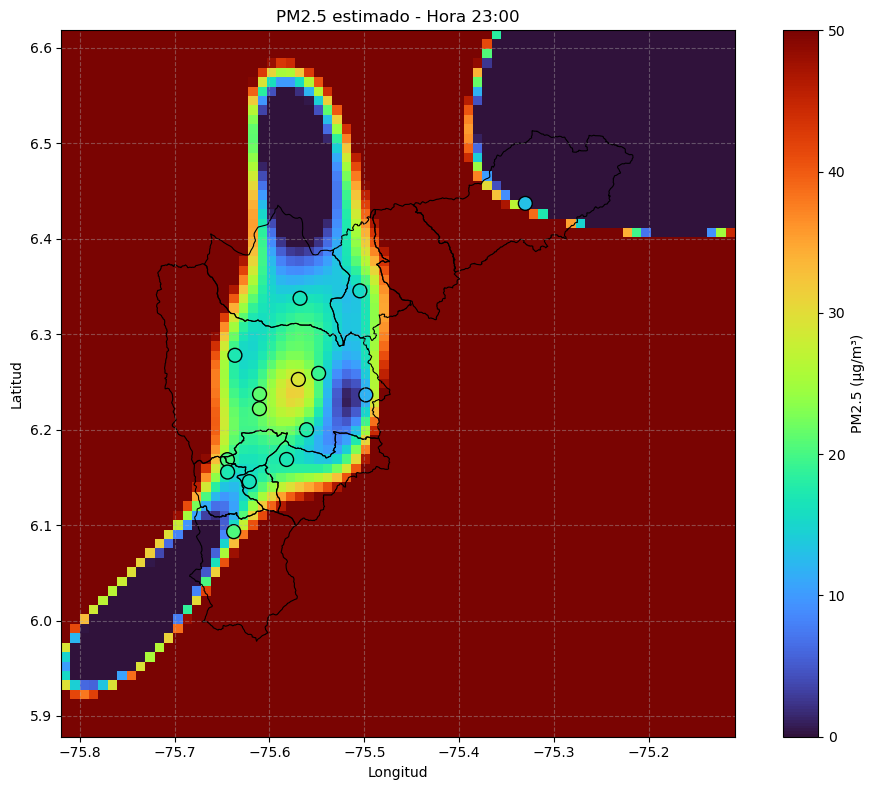


=== Procesando hora 24 ===


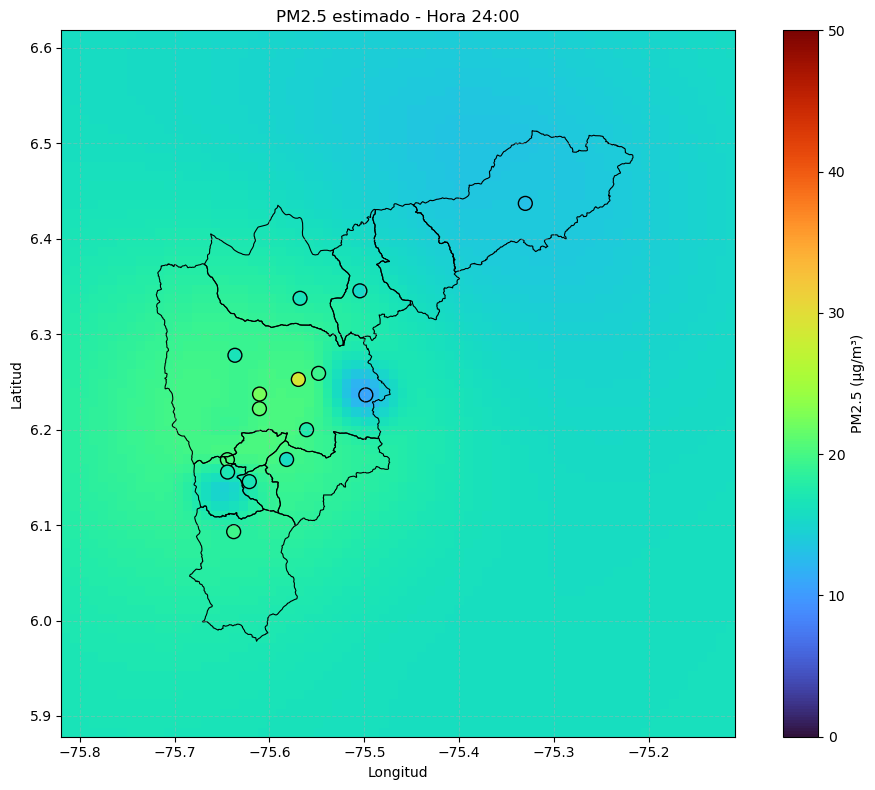

In [344]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from pykrige.ok import OrdinaryKriging
from sklearn.preprocessing import PolynomialFeatures
import geopandas as gpd

#malla
gridx = grid_lon[0]
gridy = grid_lat[:, 0]

# Procesar por hora
for hora in range(1, 25):
    print(f"\n=== Procesando hora {hora} ===")

    df_h = df[df['hora'] == hora].copy()
    if df_h.shape[0] < 10:
        print(f"⚠️ No hay suficientes datos para hora {hora}")
        continue

    # 1. Regresión polinómica PM2.5 ~ temperatura + pp
    X = df_h[['temperatura', 'pp_horaria']].values
    z = df_h['pm25'].values

    poly = PolynomialFeatures(degree=2, include_bias=False)
    X_poly = poly.fit_transform(X)

    reg = LinearRegression()
    reg.fit(X_poly, z)

    z_pred = reg.predict(X_poly)
    residuos = z - z_pred
    df_h['residuos'] = residuos

    # 2. Kriging para temperatura
    OK_temp = OrdinaryKriging(
        df_h['Longitud'], df_h['Latitud'], df_h['temperatura'],
        variogram_model='gaussian', verbose=False, enable_plotting=False
    )
    temp_grid, _ = OK_temp.execute('grid', gridx, gridy)

    # 3. Kriging para precipitación
    OK_pp = OrdinaryKriging(
        df_h['Longitud'], df_h['Latitud'], df_h['pp_horaria'],
        variogram_model='gaussian', verbose=False, enable_plotting=False
    )
    pp_grid, _ = OK_pp.execute('grid', gridx, gridy)

    # 4. Kriging de residuos
    if df_h['residuos'].notna().sum() < 3:
        print(f"⚠️ No hay suficientes residuos válidos para kriging en hora {hora}")
        continue

    OK_res = OrdinaryKriging(
        df_h['Longitud'], df_h['Latitud'], df_h['residuos'],
        variogram_model='gaussian', verbose=False, enable_plotting=False
    )
    res_grid, _ = OK_res.execute('grid', gridx, gridy)

    # 5. Predicción final
    X_pred = np.column_stack((temp_grid.flatten(), pp_grid.flatten()))
    X_pred_poly = poly.transform(X_pred)
    pm25_reg = reg.predict(X_pred_poly).reshape(temp_grid.shape)
    pm25_final = pm25_reg + res_grid

    # 6. Visualización con shapefile
    fig, ax = plt.subplots(figsize=(10, 8))
    im = ax.imshow(pm25_final,
                   extent=[gridx.min(), gridx.max(), gridy.min(), gridy.max()],
                   origin='lower', cmap='turbo', vmin=0, vmax=50)

    # Puntos medidos
    sc = ax.scatter(df_h['Longitud'], df_h['Latitud'], c=df_h['pm25'],
                    edgecolor='k', cmap='turbo', vmin=0, vmax=50, s=100)

    # Mapa de municipios encima
    municipios.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=0.8)

    # Estética
    fig.colorbar(im, ax=ax, label='PM2.5 (µg/m³)')
    ax.set_title(f'PM2.5 estimado - Hora {hora:02d}:00')
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')
    ax.grid(True, linestyle='--', alpha=0.4)
    plt.tight_layout()
    plt.show()


In [365]:
from skgstat import Variogram
from scipy.spatial.distance import pdist, squareform
import matplotlib.pyplot as plt
import numpy as np

def variograma_empirico_tipo_R(df_hora, max_dist=None, n_bins=10):
    # 1. Filtrar datos
    coords = df_hora[['Longitud', 'Latitud']].dropna().values
    values = df_hora['residuos'].dropna().values

    if len(coords) != len(values) or len(coords) < 3:
        print("⚠️ Datos insuficientes o mal formateados.")
        return

    # 2. Crear variograma
    V = Variogram(
        coordinates=coords,
        values=values,
        n_lags=n_bins,
        model='gaussian',
        maxlag=max_dist,
        normalize=False,
        use_nugget=True,
        fit_method='trf',
        fit_kwargs={"max_nfev": 5000}
    )

    # 3. Extraer bins y semivarianzas
    bin_edges = V.bins
    centers = 0.5 * (bin_edges[1:] + bin_edges[:-1])
    gamma = V.experimental

    # 4. Calcular distancias y diferencias manualmente
    dist_matrix = squareform(pdist(coords))
    diff_matrix = squareform(pdist(values[:, None], metric='euclidean'))**2

    distances = dist_matrix[np.triu_indices(len(coords), k=1)]
    diffs_squared = diff_matrix[np.triu_indices(len(coords), k=1)]

    # 5. Gráficas
    plt.figure(figsize=(9, 8))

    # Panel superior
    plt.subplot(2, 1, 1)
    plt.scatter(distances, diffs_squared, facecolors='none', edgecolors='gray', alpha=0.5)
    plt.ylabel(r"$(z_i - z_j)^2$")
    plt.xlabel("Distancia entre pares")
    plt.grid(True)

    # Panel inferior
    plt.subplot(2, 1, 2)
    plt.scatter(distances, 0.5 * diffs_squared, color='gray', s=10, alpha=0.5)

    for lag in bin_edges:
        plt.axvline(lag, color='red', linestyle='--', alpha=0.4)

    # ⚠️ Corregimos posibles diferencias de longitud
    valid_bins = min(len(centers), len(gamma))
    plt.scatter(centers[:valid_bins], gamma[:valid_bins], color='red', s=80, label='γ(h) promedio por bin')

    # Modelo ajustado
    h_vals = np.linspace(0, bin_edges[-1], 200)
    model_curve = V.fitted_model(h_vals)
    plt.plot(h_vals, model_curve, 'b-', label='Modelo Gaussiano', linewidth=2)

    plt.xlabel("Distancia entre pares")
    plt.ylabel("γ")
    plt.title("Variograma empírico de residuos (modelo gaussiano)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()



=== Procesando hora 1 ===


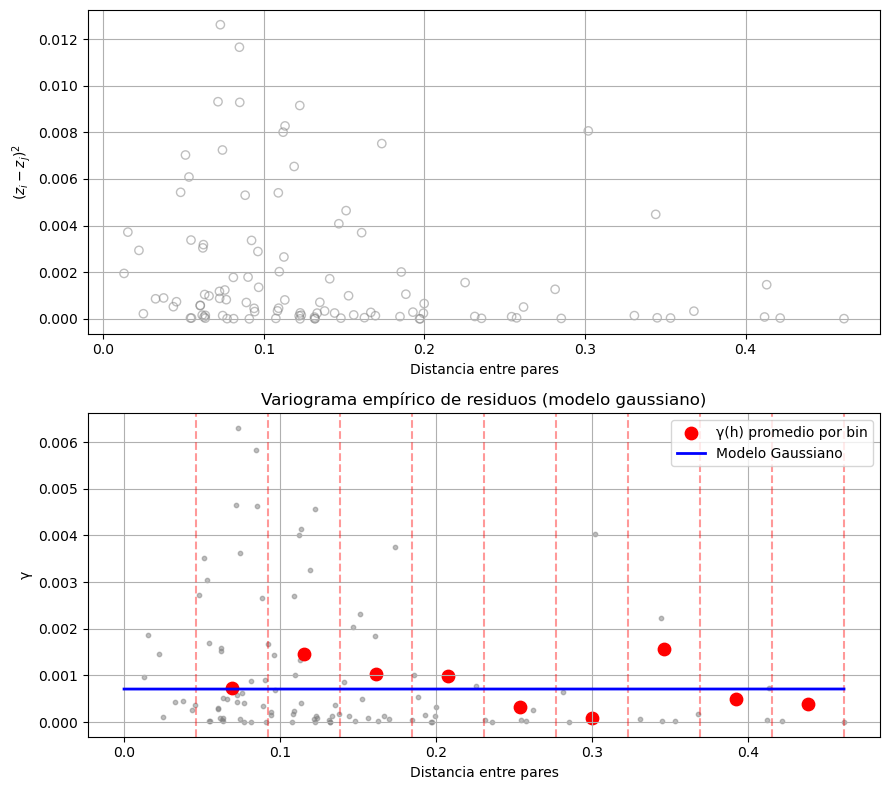


=== Procesando hora 2 ===


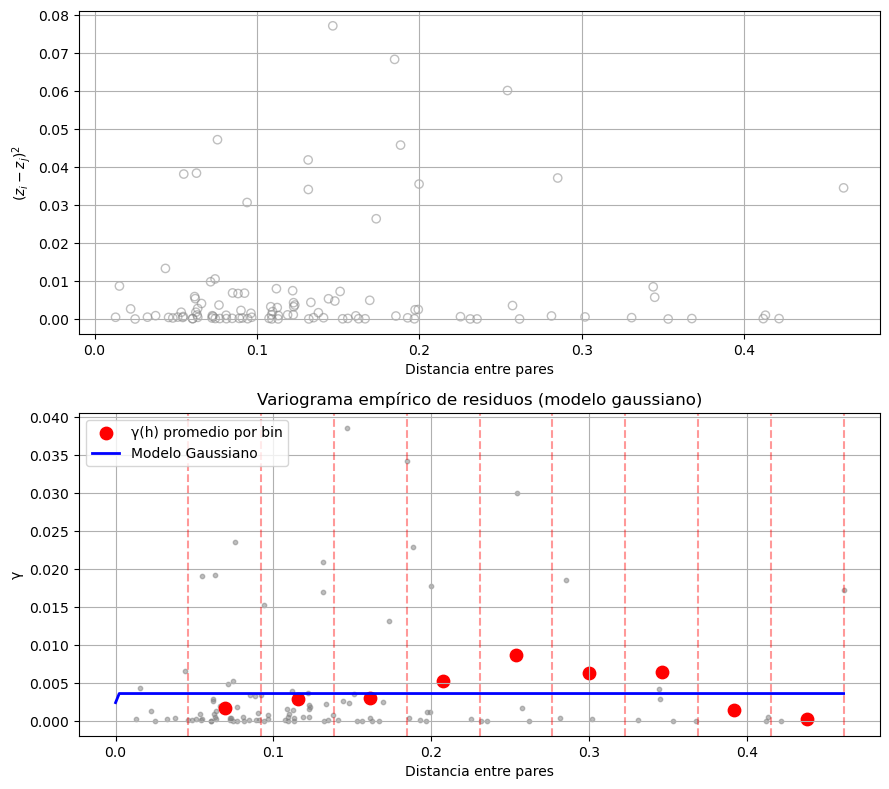


=== Procesando hora 3 ===


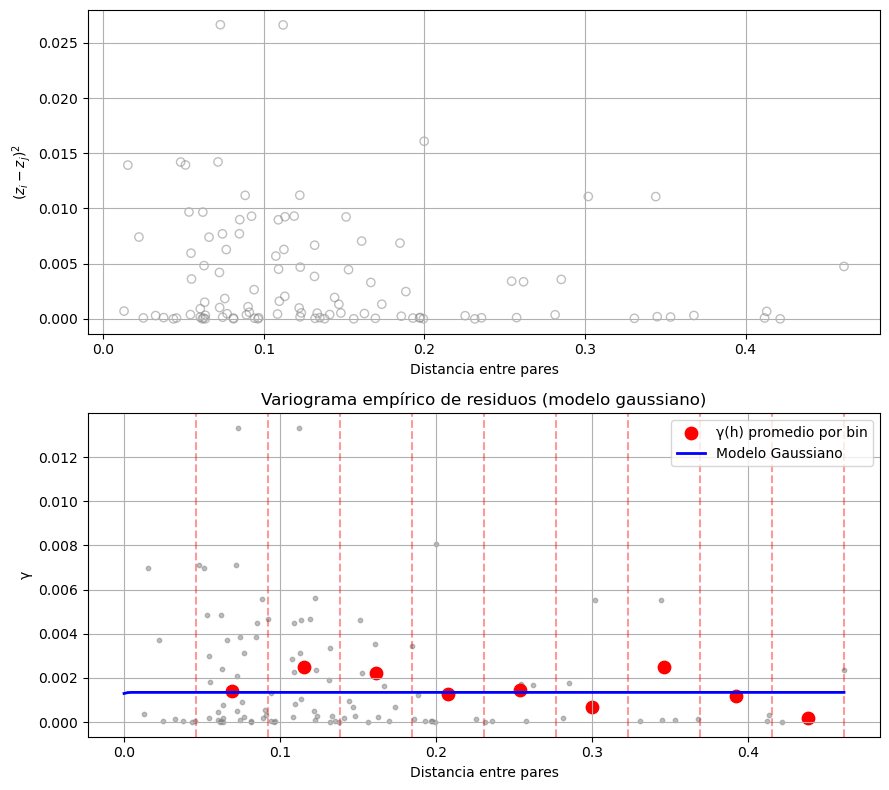


=== Procesando hora 4 ===


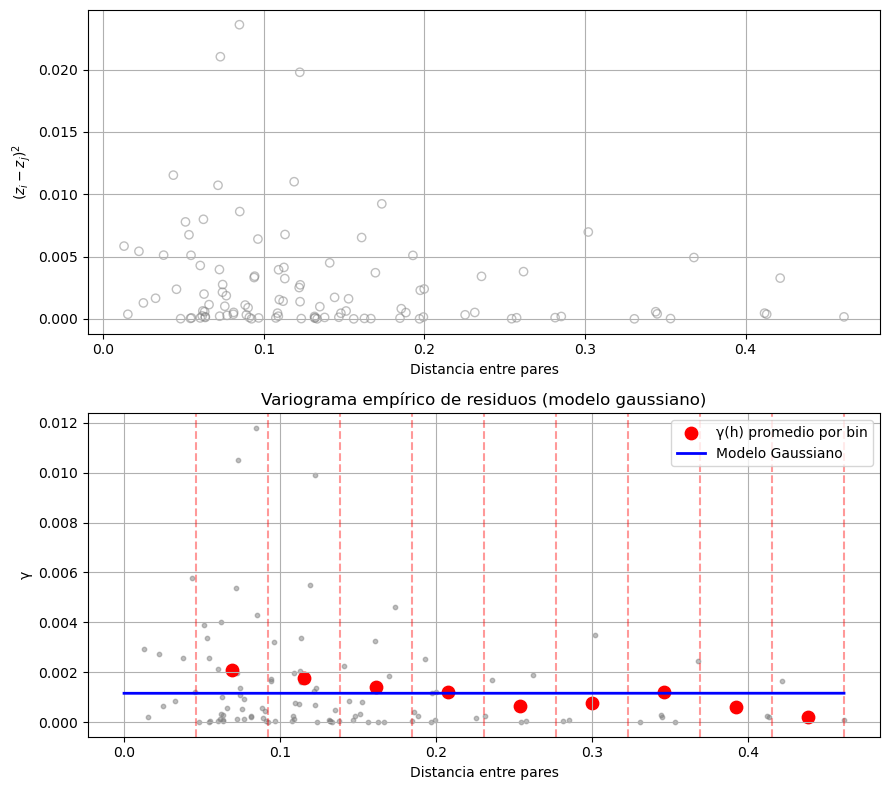


=== Procesando hora 5 ===


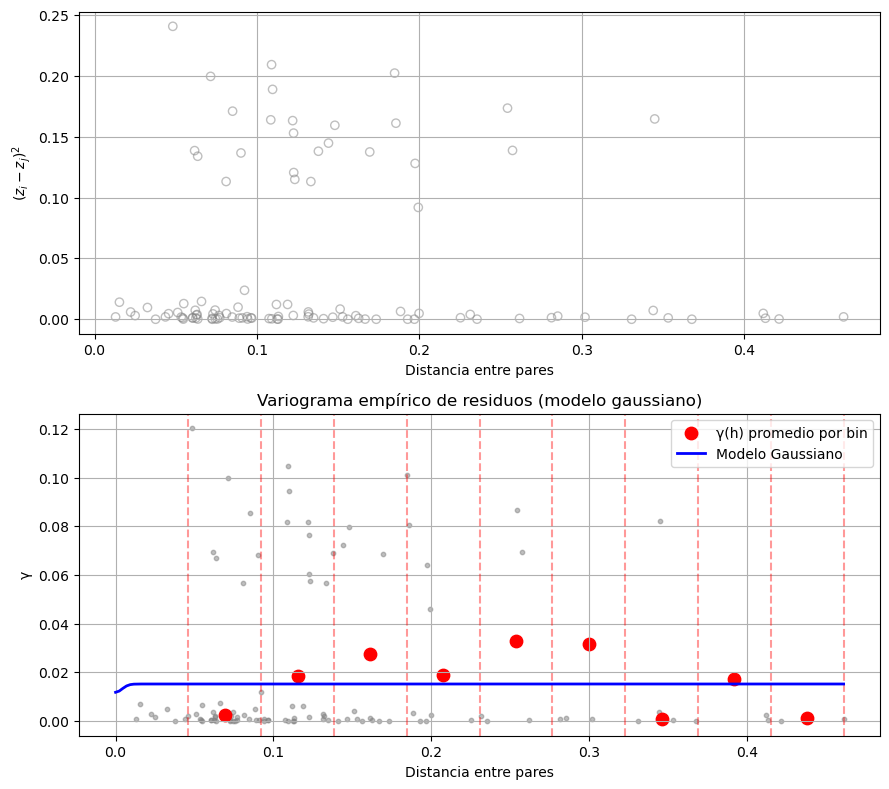


=== Procesando hora 6 ===


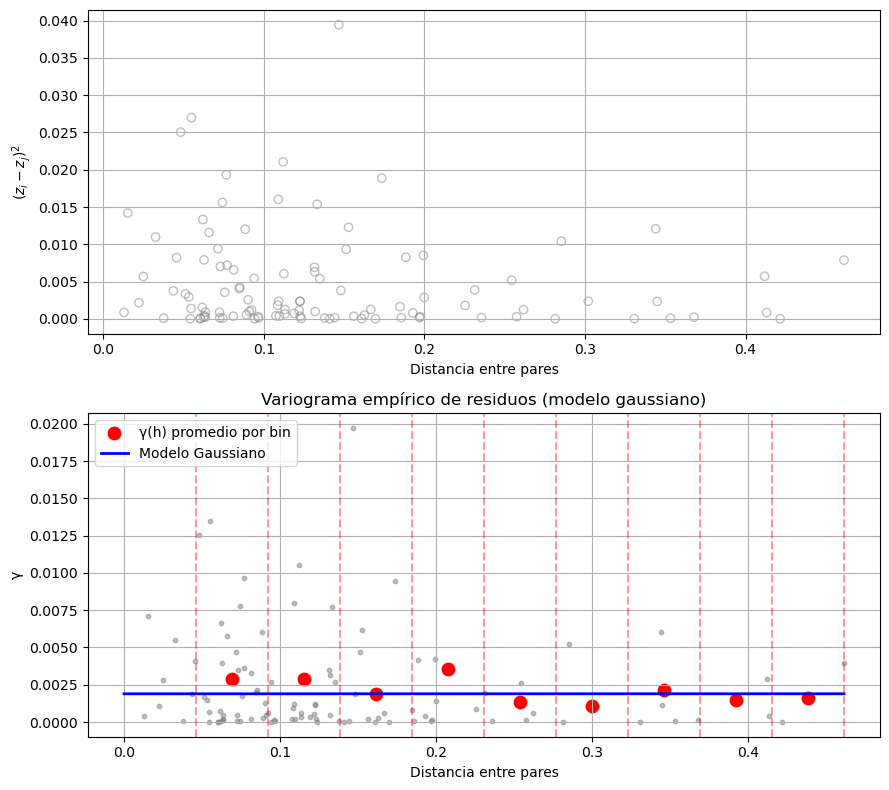


=== Procesando hora 7 ===


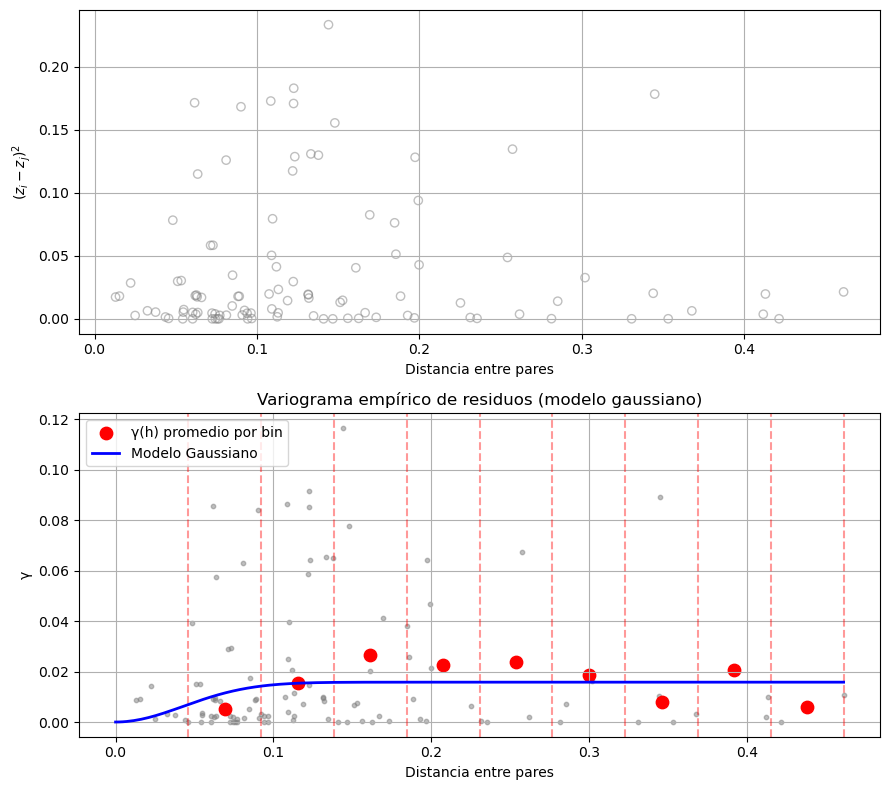


=== Procesando hora 8 ===


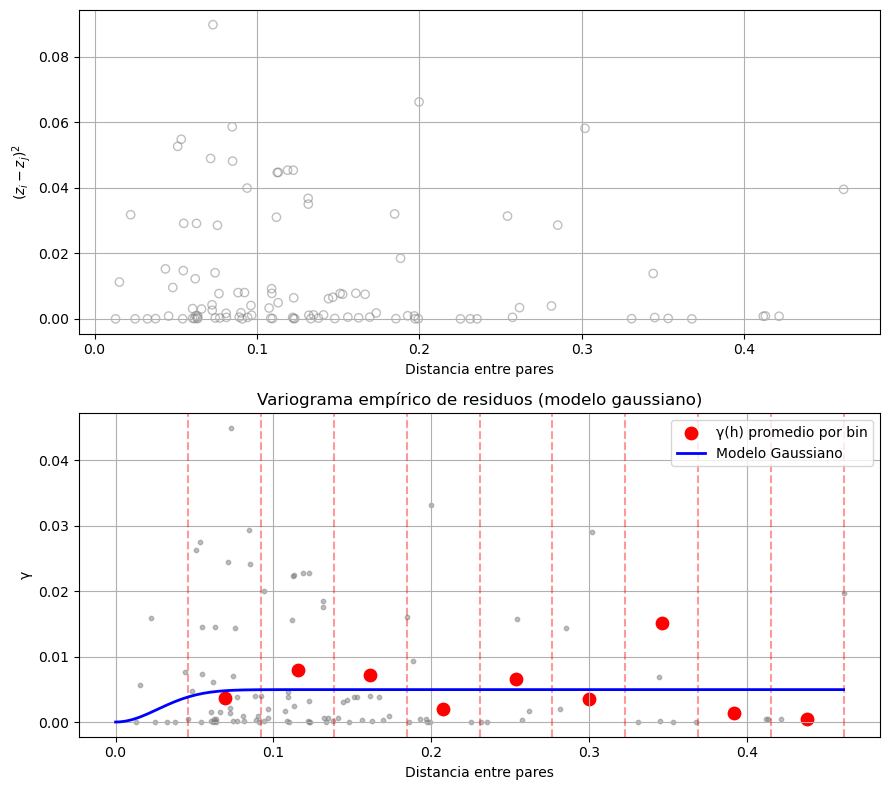


=== Procesando hora 9 ===


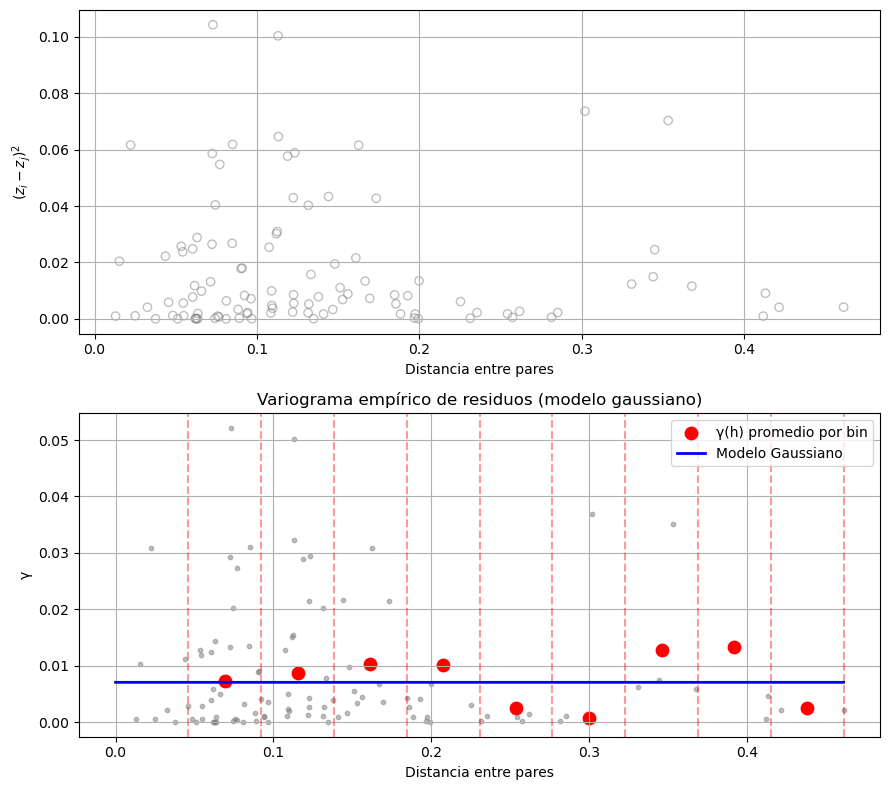


=== Procesando hora 10 ===


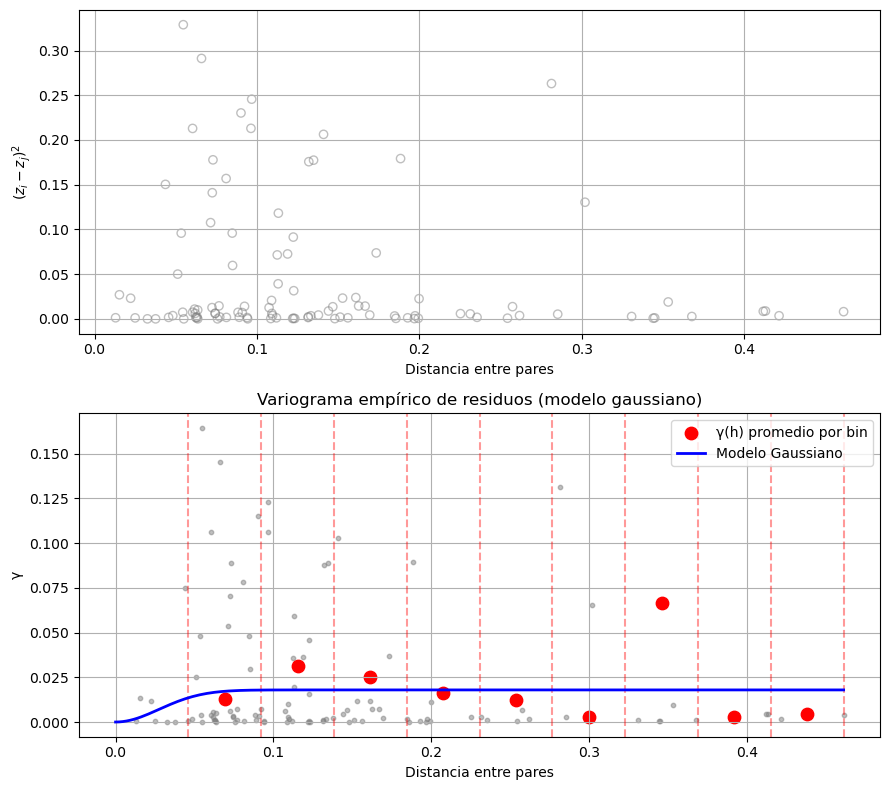


=== Procesando hora 11 ===


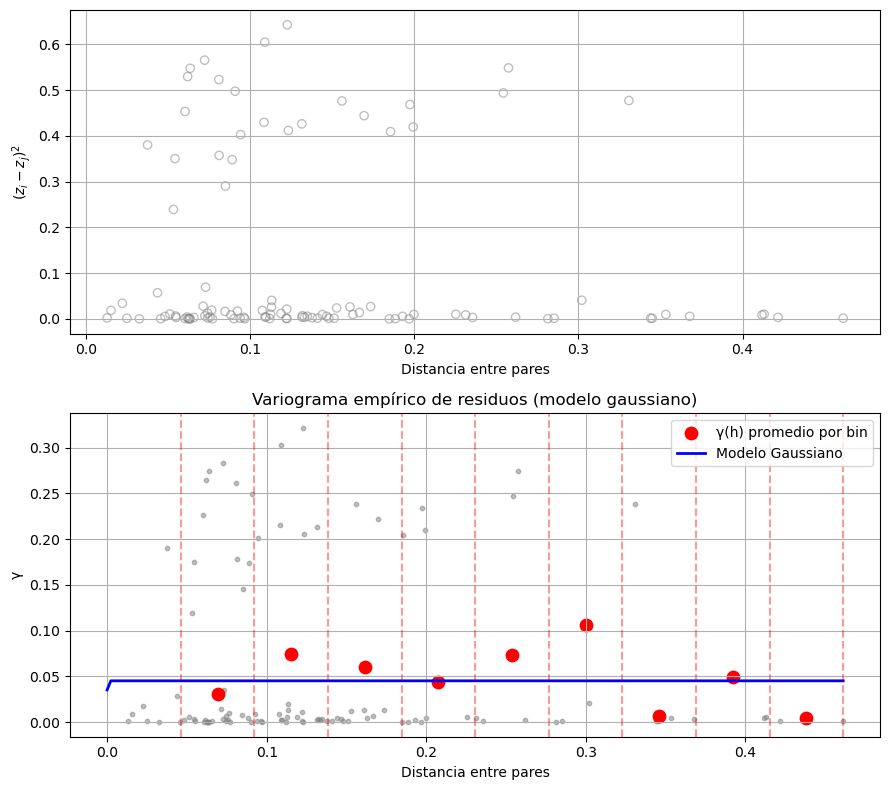


=== Procesando hora 12 ===


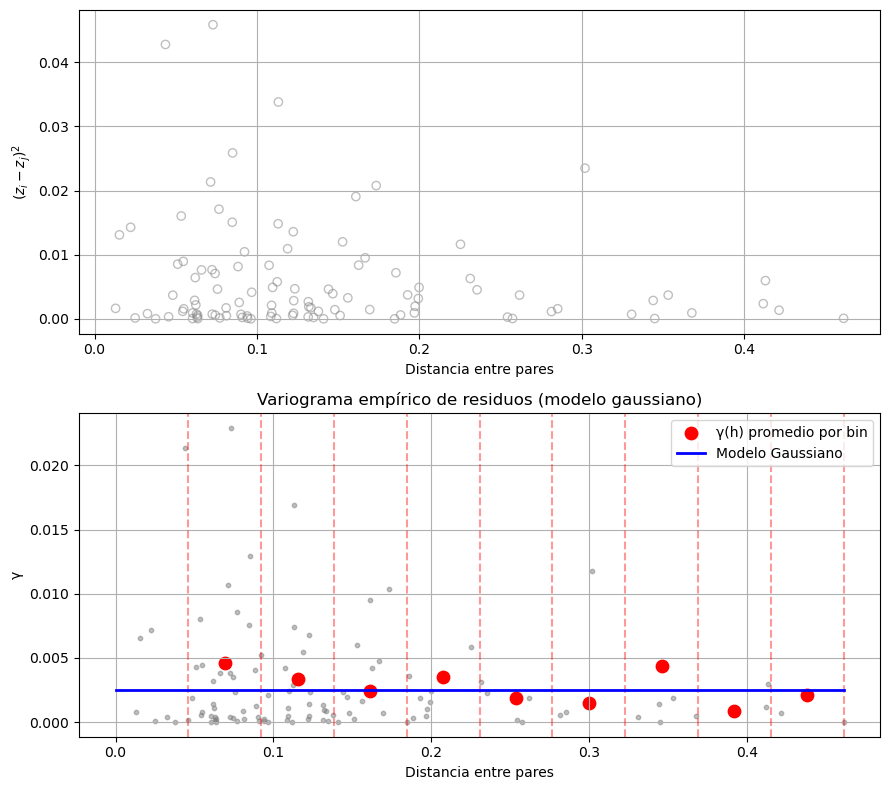


=== Procesando hora 13 ===


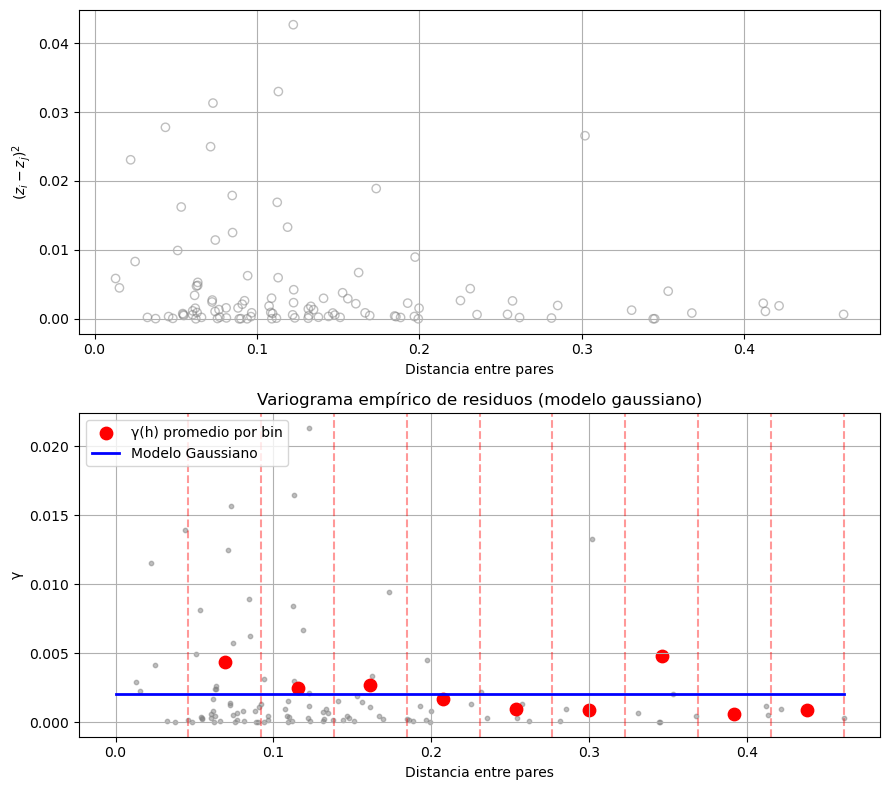


=== Procesando hora 14 ===


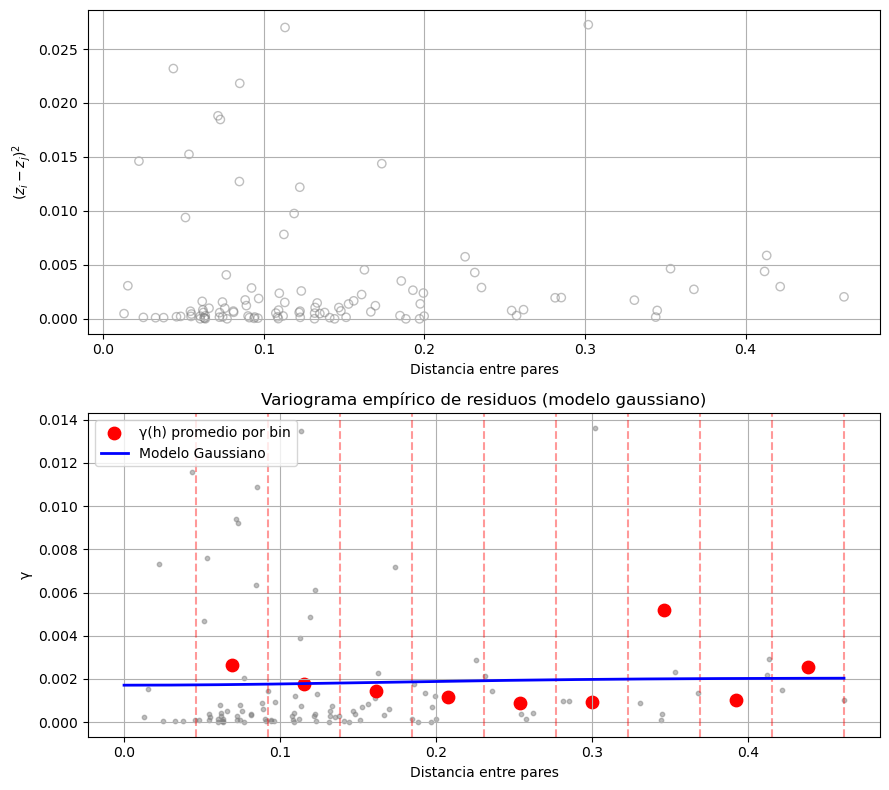


=== Procesando hora 15 ===


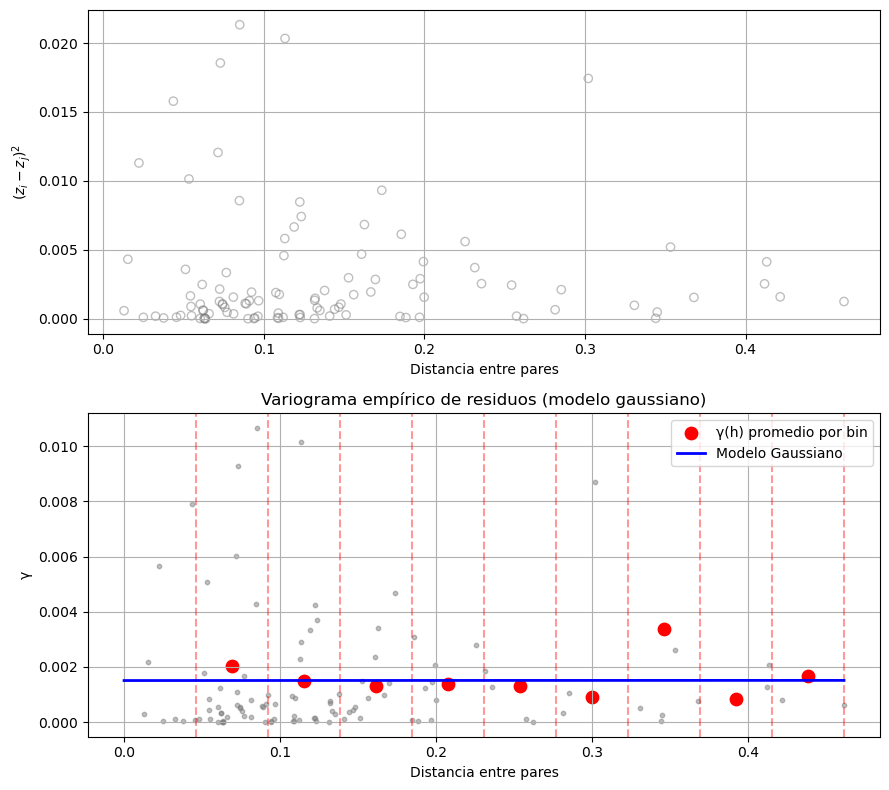


=== Procesando hora 16 ===


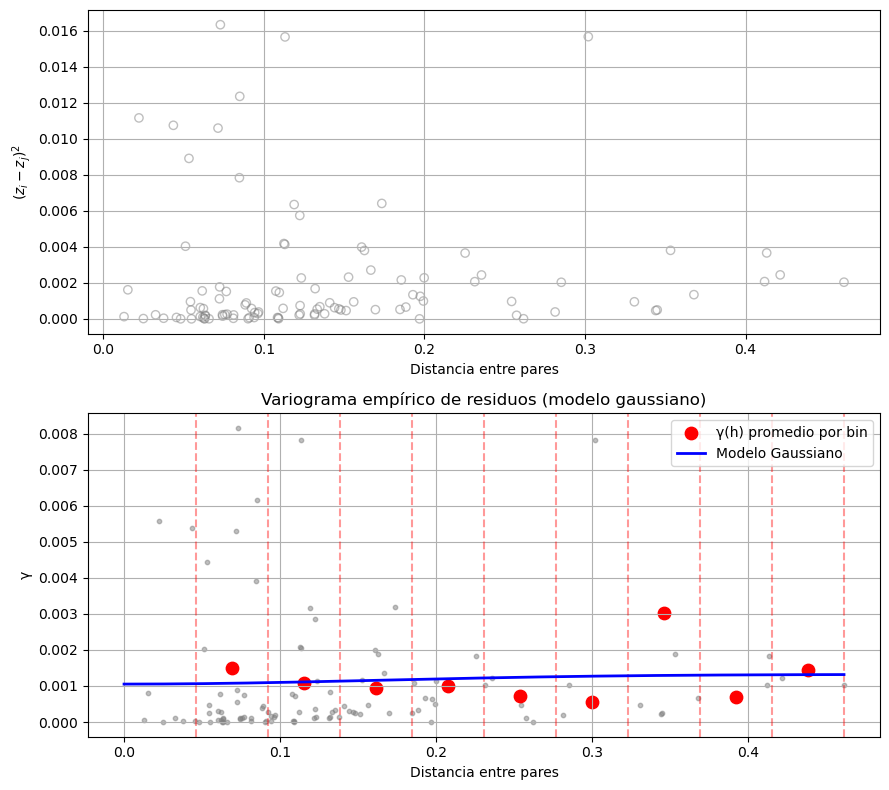


=== Procesando hora 17 ===


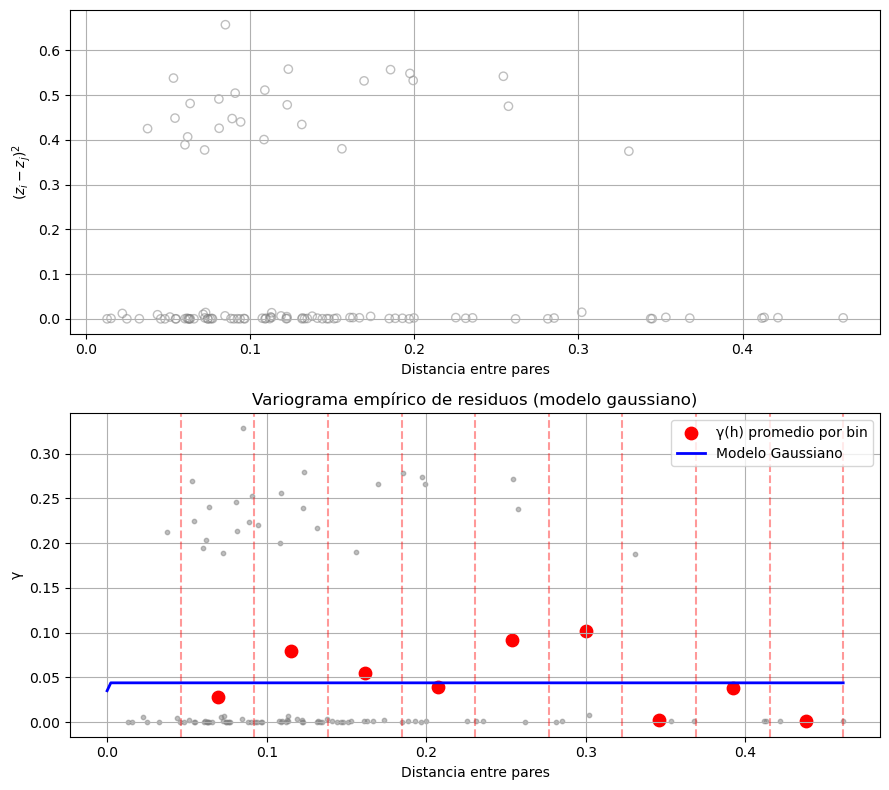


=== Procesando hora 18 ===


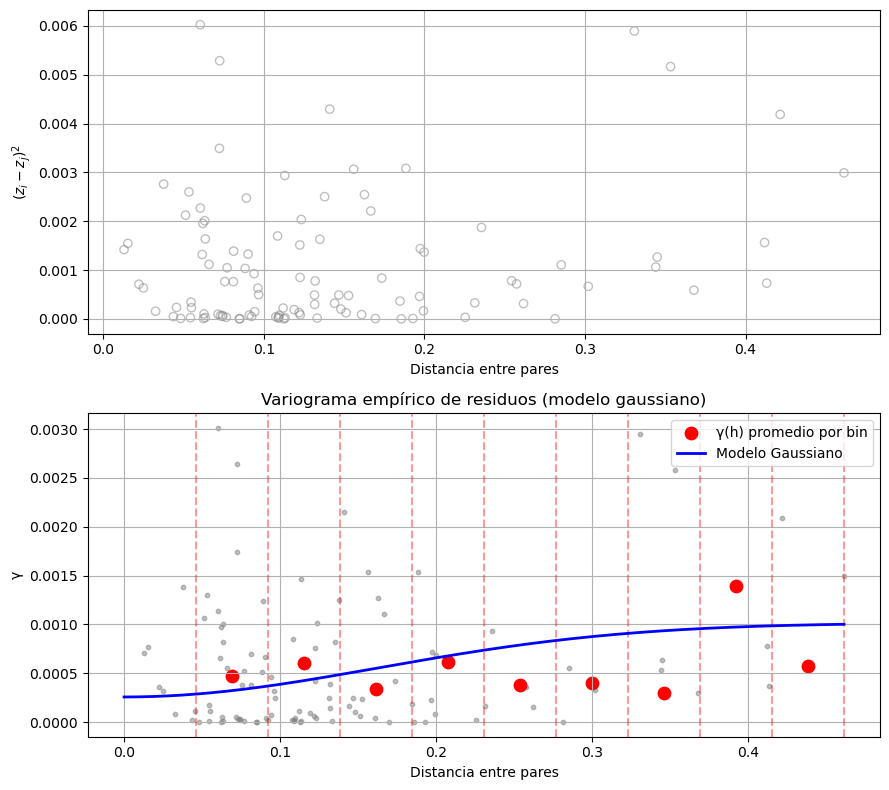


=== Procesando hora 19 ===


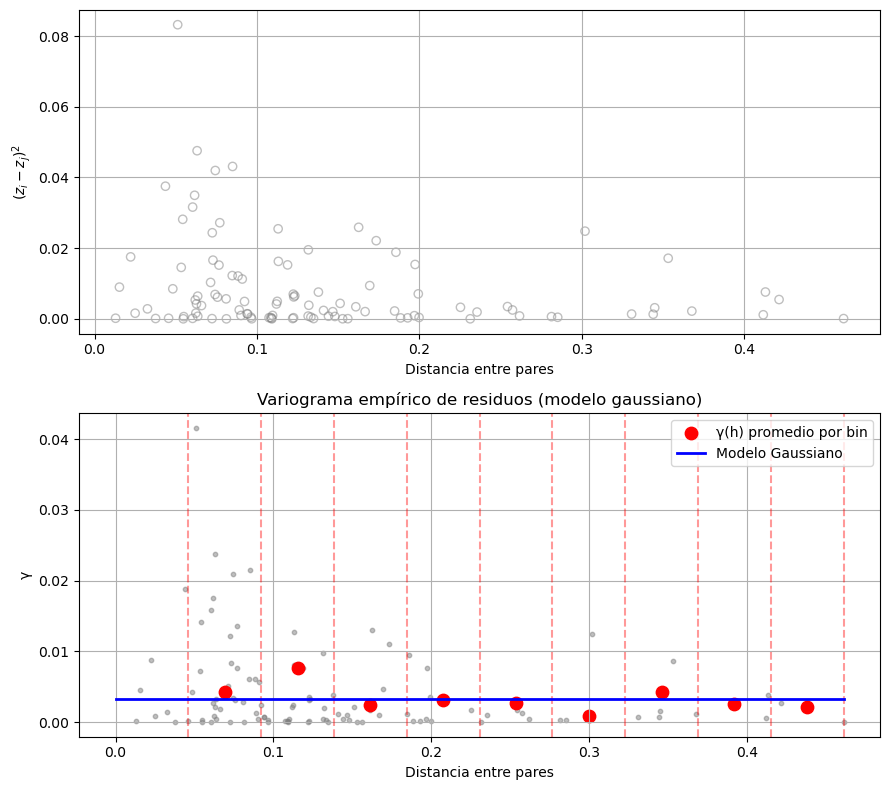


=== Procesando hora 20 ===


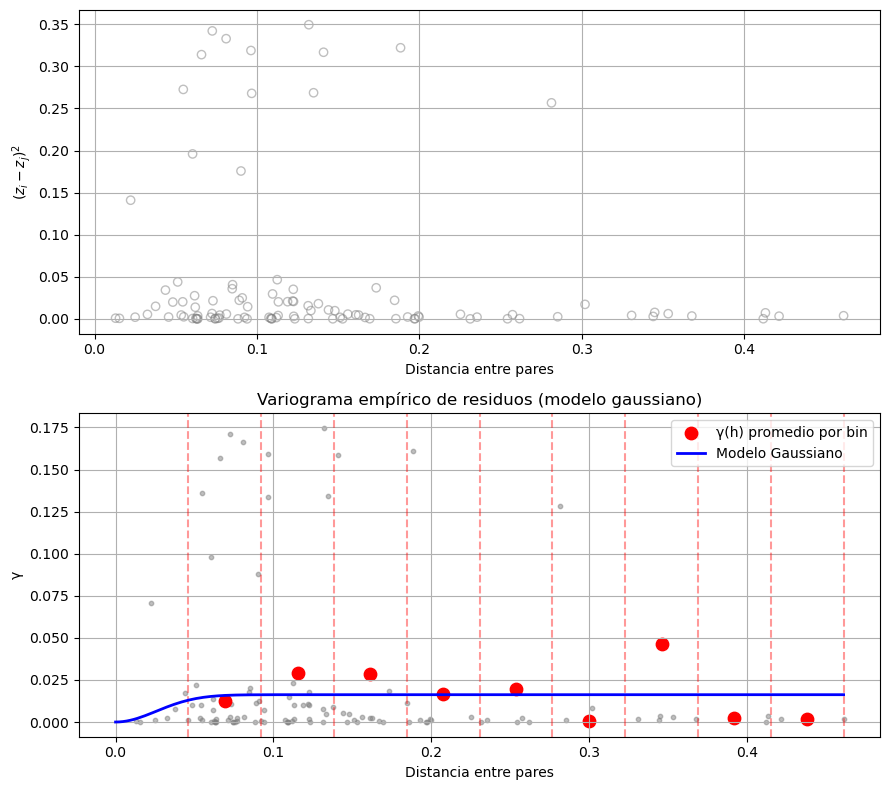


=== Procesando hora 21 ===


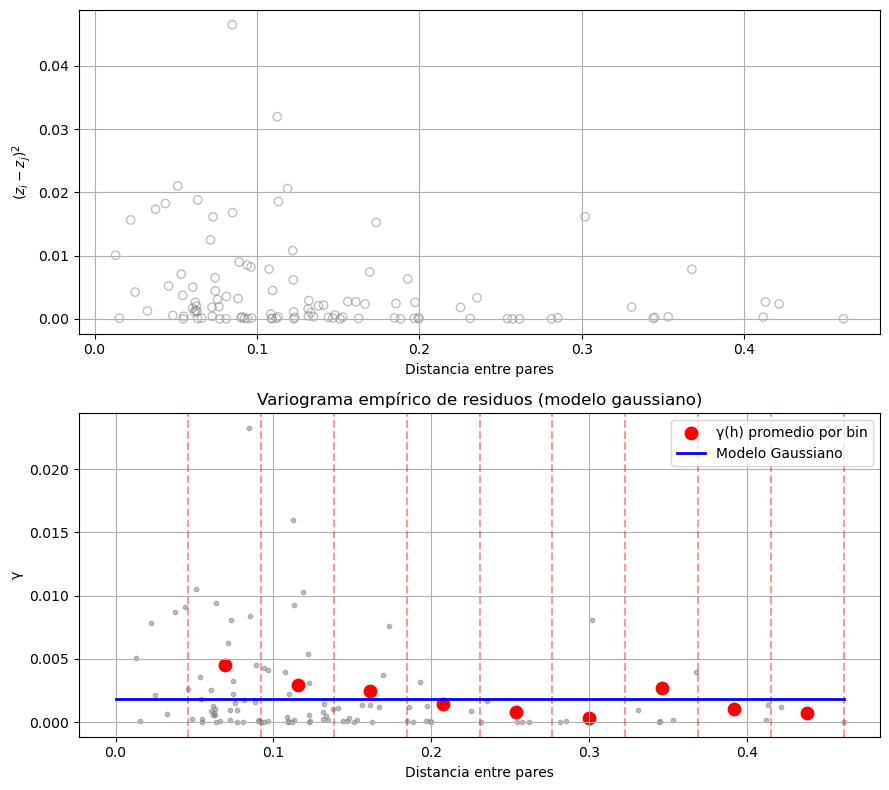


=== Procesando hora 22 ===


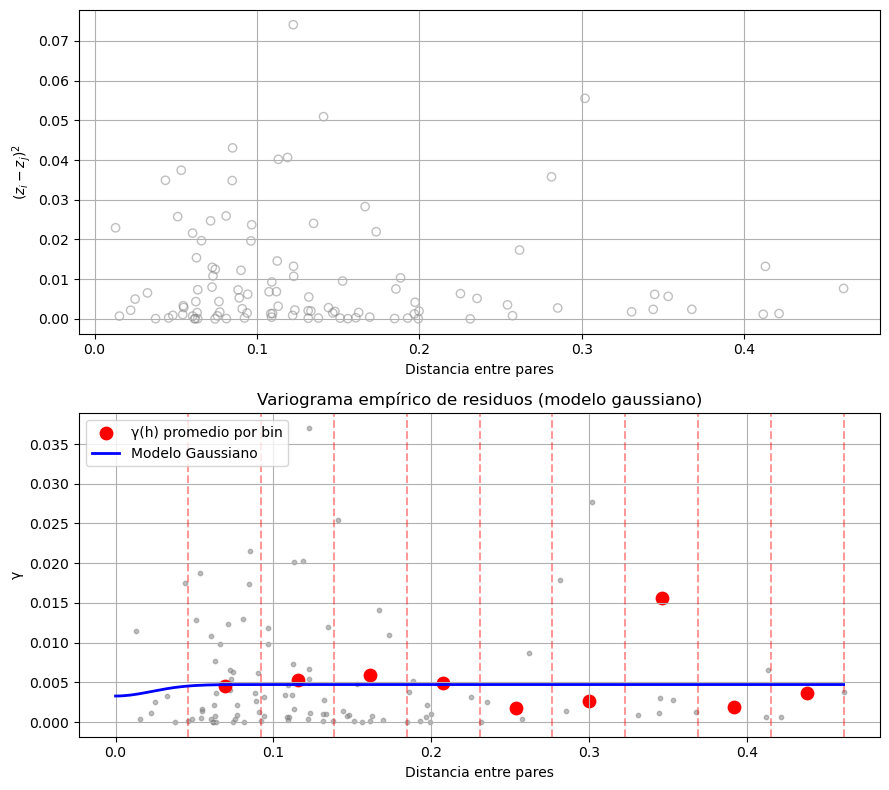


=== Procesando hora 23 ===


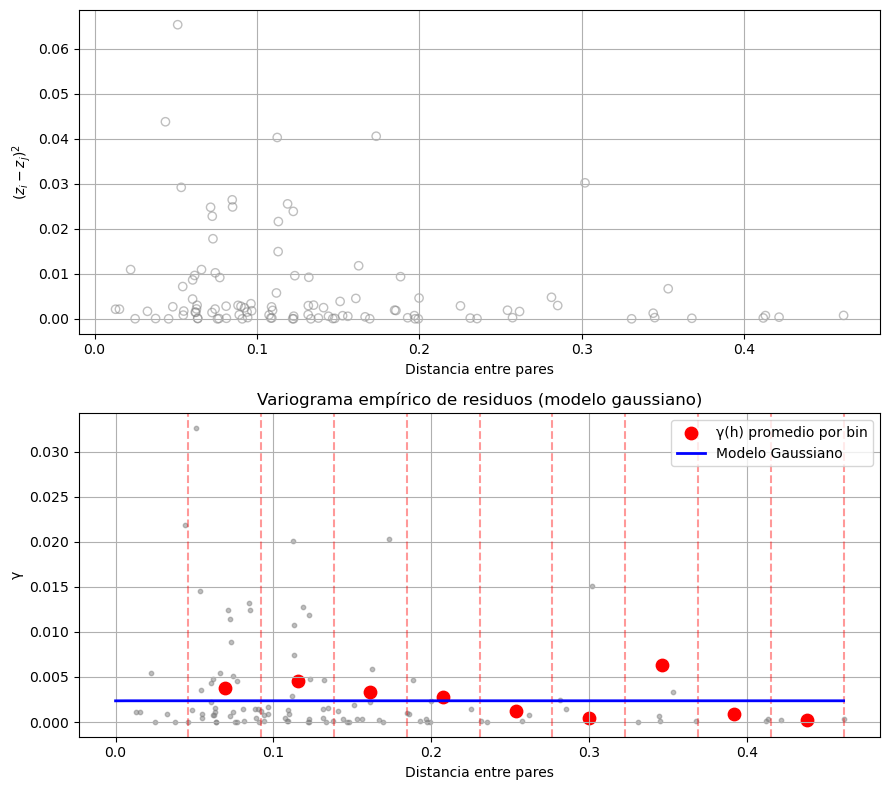


=== Procesando hora 24 ===


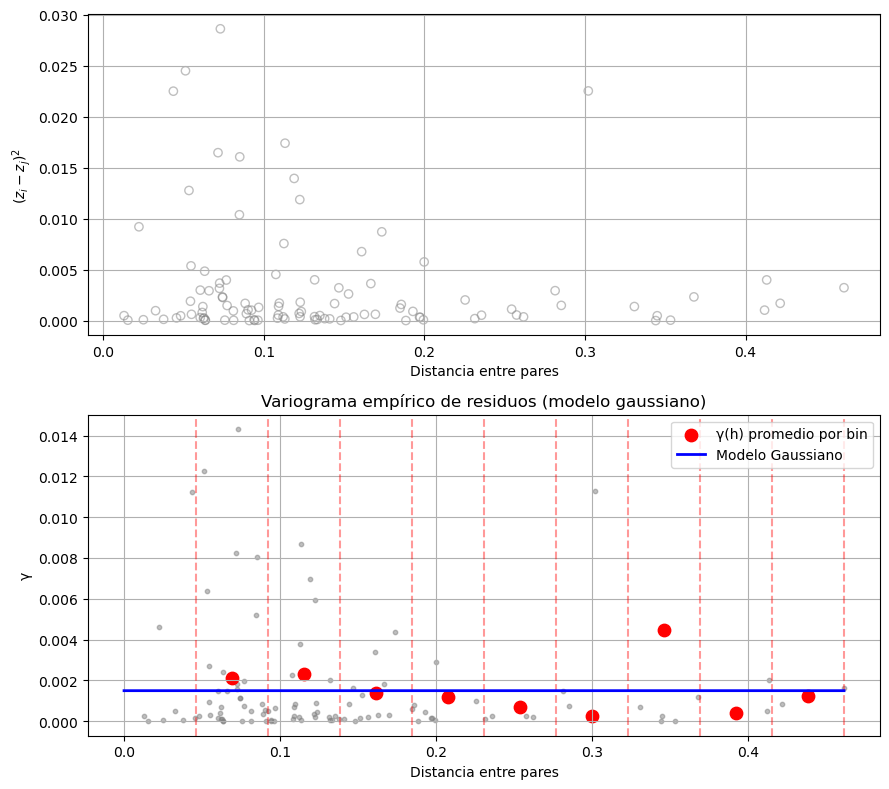

In [371]:
for hora in range(1, 25):
    print(f"\n=== Procesando hora {hora} ===")

    df_h = df[df['hora'] == hora].copy()
    if df_h.shape[0] < 10:
        print(f"⚠️ No hay suficientes datos para hora {hora}")
        continue

    # Recalcular residuos si no están
    df_h['residuos'] = df_h['pm25'] - df_h['pm25_pred']

    # Graficar y guardar variograma de residuos
    variograma_empirico_tipo_R(df_h, hora)



In [369]:
df_h.columns

Index(['Unnamed: 0_x', 'Codigo', 'Estacion', 'Ciudad', 'Longitud', 'Latitud',
       'geometry', 'Unnamed: 0_y', 'hora', 'pm25', 'pp_horaria', 'temperatura',
       'pm25_pred', 'error_abs', 'error_rel', 'residuos'],
      dtype='object')

In [372]:
print("Distancias (bins):", V.bins)


Distancias (bins): [0.04612197 0.09224394 0.13836591 0.18448789 0.23060986 0.27673183
 0.3228538  0.36897577 0.41509774 0.46121971]


In [373]:
print("Ancho promedio entre bins:", np.diff(V.bins).mean())


Ancho promedio entre bins: 0.046121971336880424


In [374]:
print(df_h.crs)


EPSG:4326


In [376]:
dist_grados = 0.0461
dist_km = dist_grados * 111  # ≈ 5.1 km
print(f"Cada bin ≈ {dist_km:.2f} km")



Cada bin ≈ 5.12 km


In [383]:
from skgstat import Variogram
from scipy.spatial.distance import pdist, squareform
import matplotlib.pyplot as plt
import numpy as np
import os


def variograma_empirico_por_hora(df, max_dist=None, n_bins=10, out_dir=None):
    modelos = ['spherical', 'exponential', 'gaussian', 'cubic', 'matern']
    resultados = {}

    if out_dir:
        os.makedirs(out_dir, exist_ok=True)

    for hora in range(1, 25):
        df_hora = df[df['hora'] == hora]
        coords = df_hora[['Longitud', 'Latitud']].dropna().values
        values = df_hora['residuos'].dropna().values

        if len(coords) != len(values) or len(coords) < 3:
            print(f"⚠️ Hora {hora}: Datos insuficientes")
            continue

        mejor_modelo = None
        mejor_rss = np.inf
        mejor_variograma = None

        for modelo in modelos:
            try:
                V = Variogram(
                    coordinates=coords,
                    values=values,
                    n_lags=n_bins,
                    model=modelo,
                    maxlag=max_dist,
                    normalize=False,
                    use_nugget=True,
                    fit_method='trf',
                    fit_kwargs={"max_nfev": 5000}
                )
                rss = np.sum((V.experimental - V.fitted_model(V.bins[:-1])) ** 2)
                if rss < mejor_rss:
                    mejor_modelo = modelo
                    mejor_rss = rss
                    mejor_variograma = V
            except Exception as e:
                print(f"Hora {hora}: Fallo con modelo {modelo}: {e}")

        if mejor_variograma is None:
            print(f"⚠️ Hora {hora}: No se pudo ajustar un modelo válido")
            continue

        V = mejor_variograma
        bin_edges = V.bins
        centers = 0.5 * (bin_edges[1:] + bin_edges[:-1])
        gamma = V.experimental

        dist_matrix = squareform(pdist(coords))
        diff_matrix = squareform(pdist(values[:, None], metric='euclidean'))**2

        distances = dist_matrix[np.triu_indices(len(coords), k=1)]
        diffs_squared = diff_matrix[np.triu_indices(len(coords), k=1)]

        fig, axs = plt.subplots(2, 1, figsize=(9, 8))

        axs[0].scatter(distances, diffs_squared, facecolors='none', edgecolors='gray', alpha=0.5)
        axs[0].set_ylabel(r"$(z_i - z_j)^2$")
        axs[0].set_xlabel("Distancia entre pares")
        axs[0].grid(True)

        axs[1].scatter(distances, 0.5 * diffs_squared, color='gray', s=10, alpha=0.5)
        for lag in bin_edges:
            axs[1].axvline(lag, color='red', linestyle='--', alpha=0.4)

        valid_bins = min(len(centers), len(gamma))
        axs[1].scatter(centers[:valid_bins], gamma[:valid_bins], color='red', s=80, label='γ(h) promedio por bin')

        h_vals = np.linspace(0, bin_edges[-1], 200)
        model_curve = V.fitted_model(h_vals)
        axs[1].plot(h_vals, model_curve, 'b-', label=f'Modelo {V.model}', linewidth=2)

        axs[1].set_xlabel("Distancia entre pares")
        axs[1].set_ylabel("γ")
        axs[1].set_title(f"Variograma empírico de residuos (hora {hora})")
        axs[1].legend()
        axs[1].grid(True)

        plt.tight_layout()

        if out_dir:
            plt.savefig(os.path.join(out_dir, f"variograma_hora_{hora}.png"))
            plt.close()
        else:
            plt.show()

        resultados[hora] = {
            'modelo': V.model,
            'nugget': V.parameters[0],
            'sill': V.parameters[1],
            'range': V.parameters[2],
            'rss': mejor_rss
        }

    return resultados


Procesando hora 1


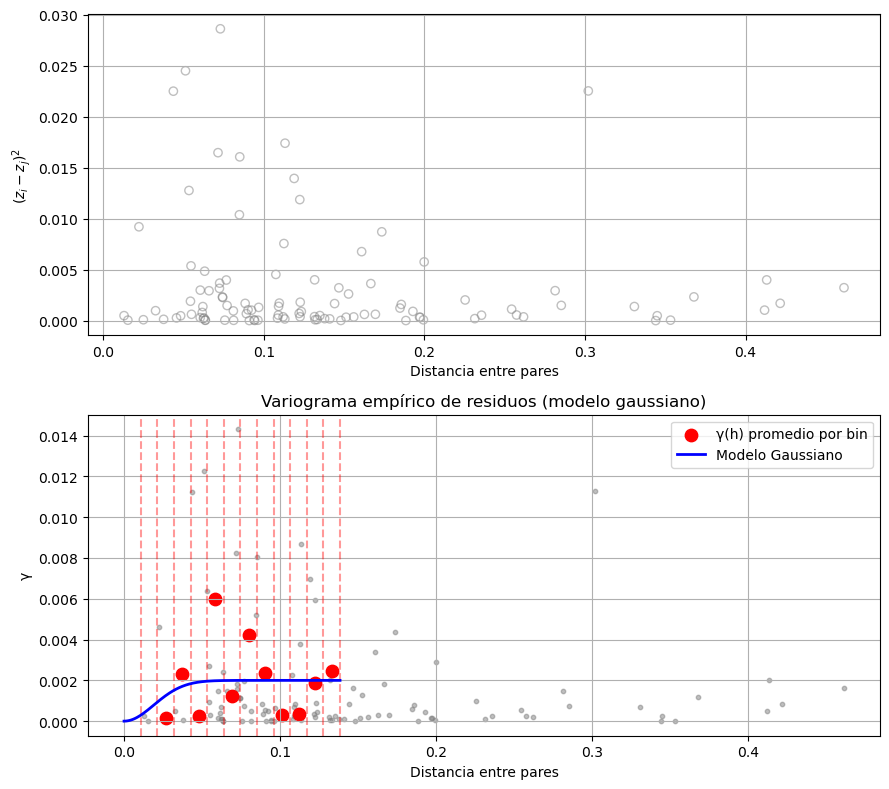

Procesando hora 2


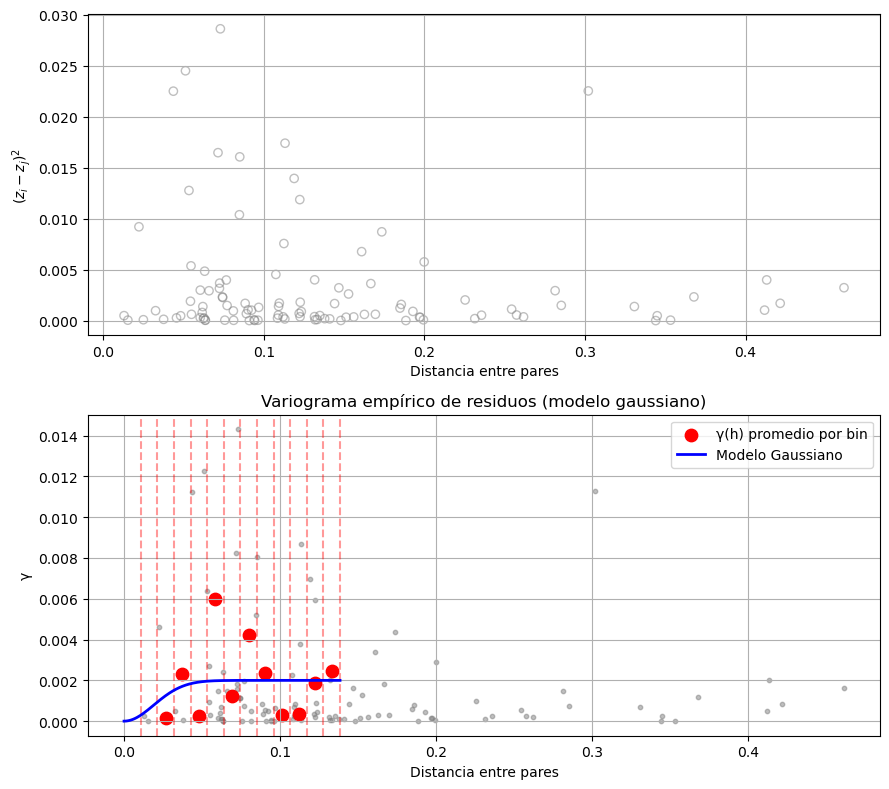

Procesando hora 3


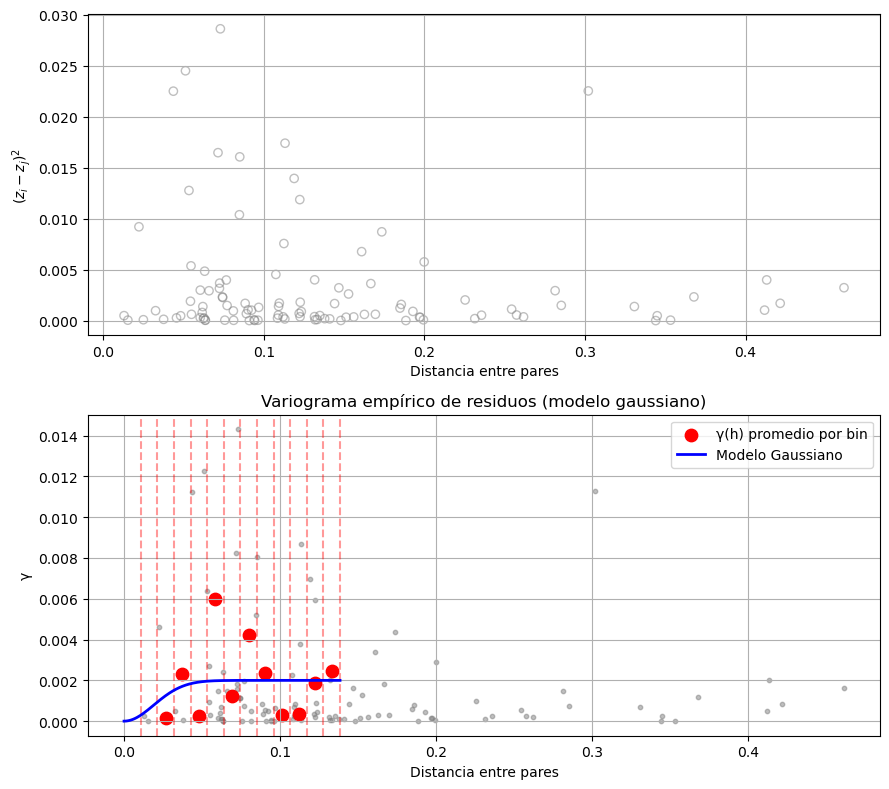

Procesando hora 4


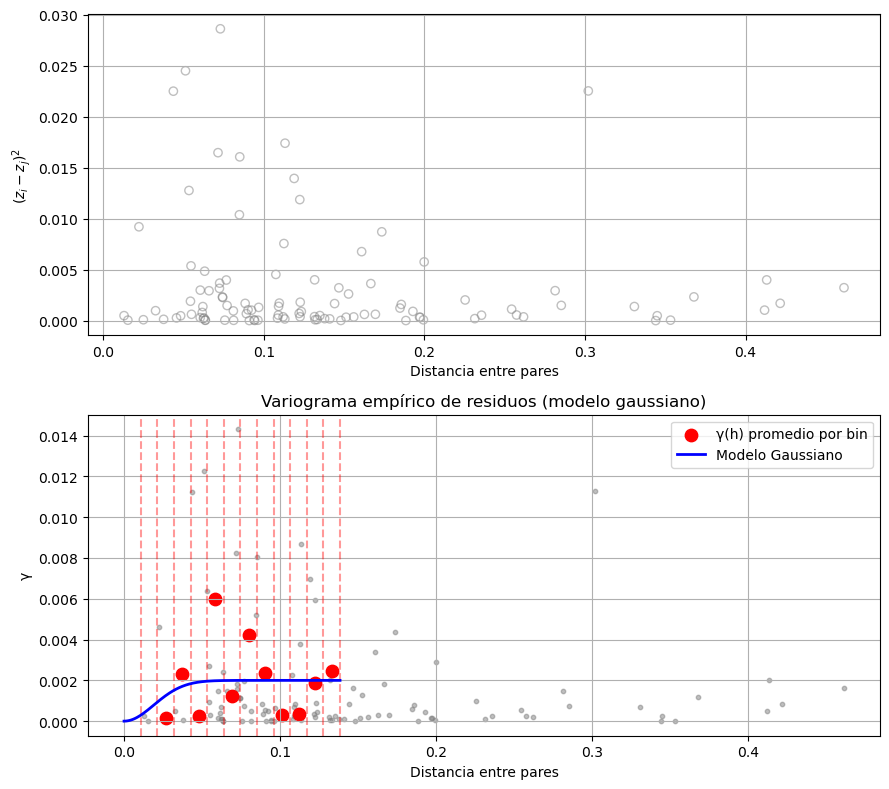

Procesando hora 5


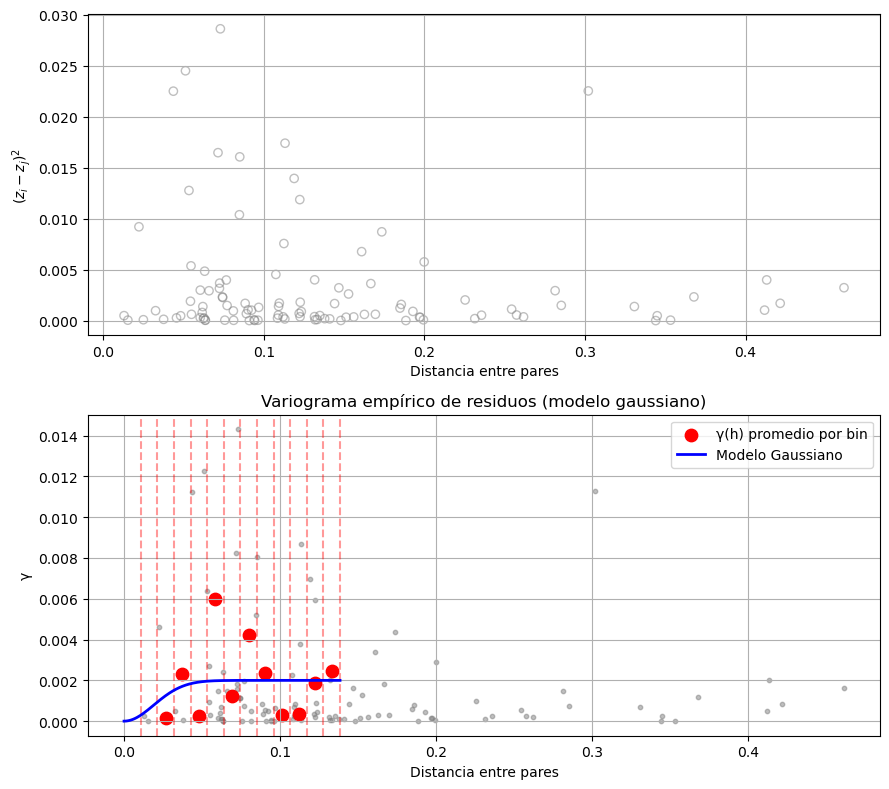

Procesando hora 6


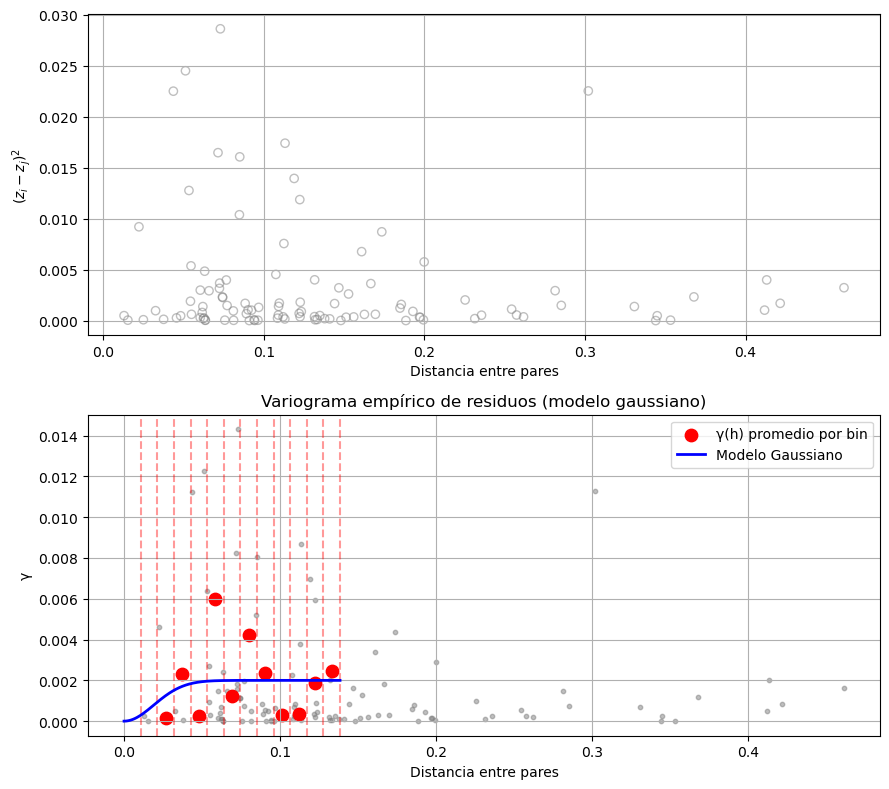

Procesando hora 7


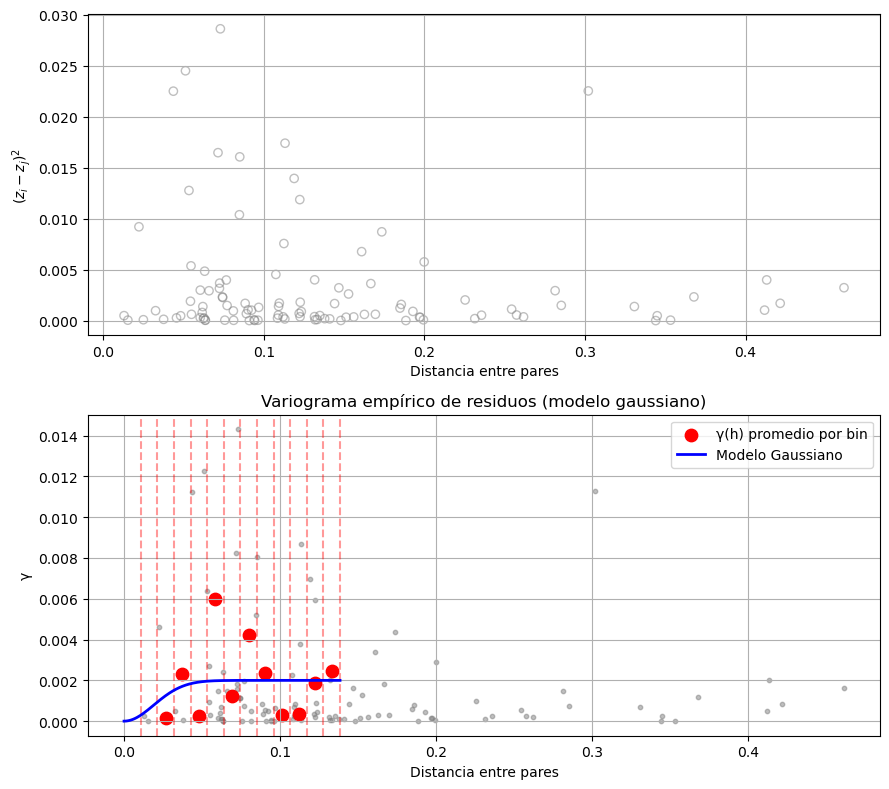

Procesando hora 8


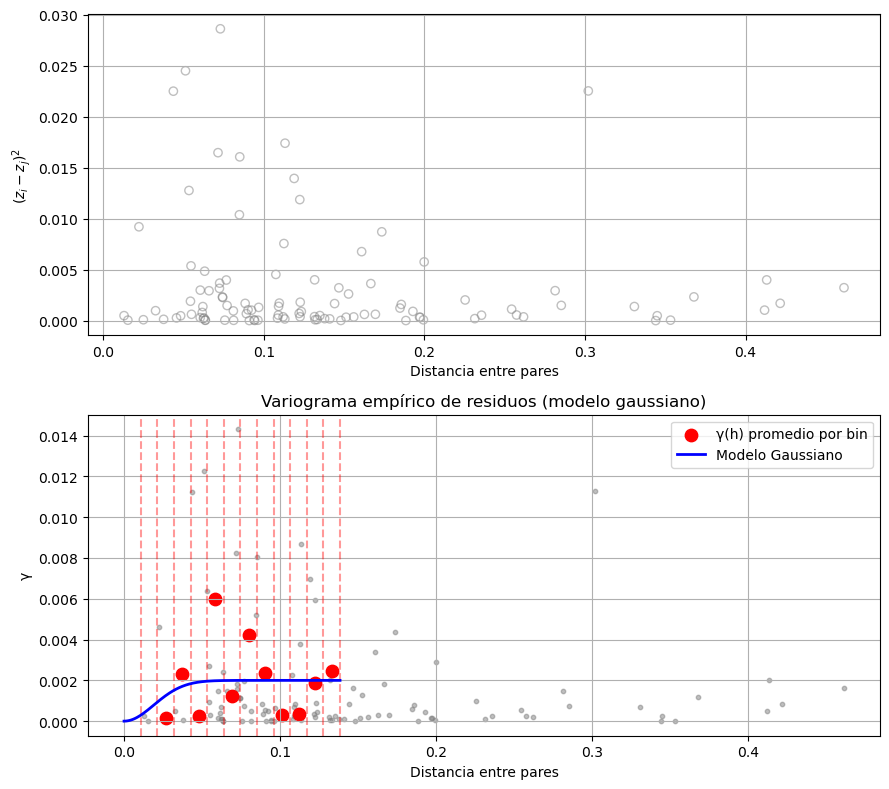

Procesando hora 9


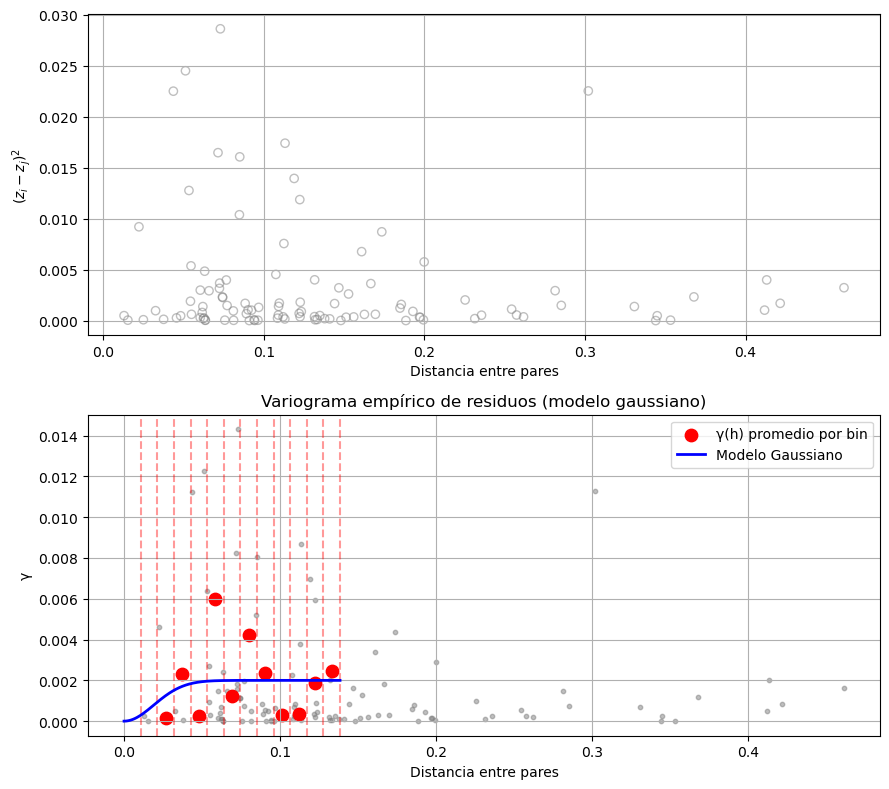

Procesando hora 10


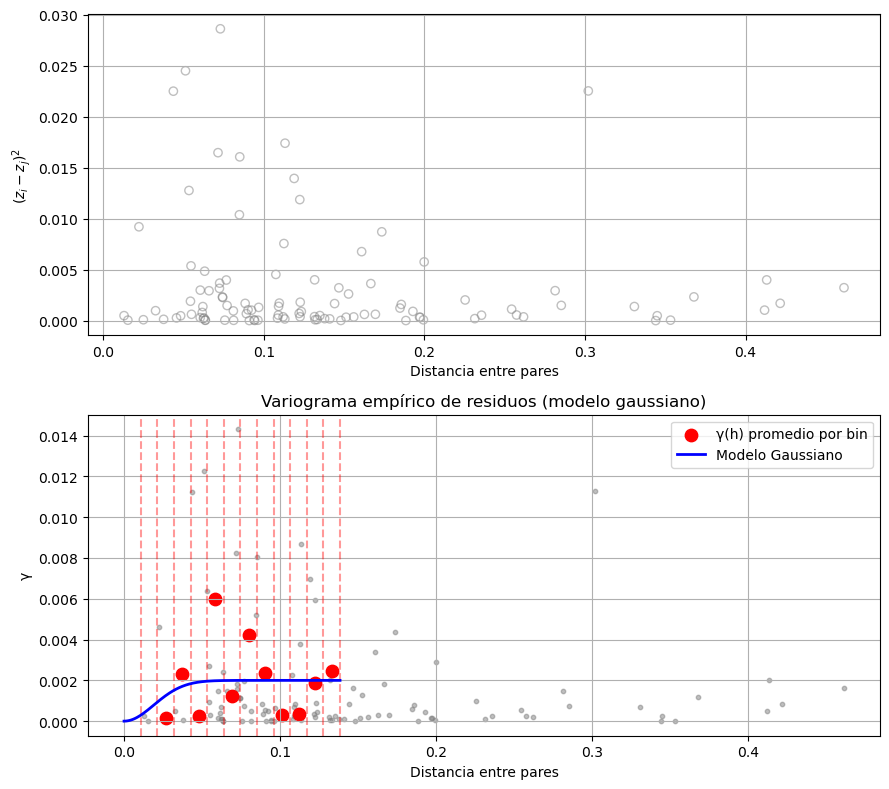

Procesando hora 11


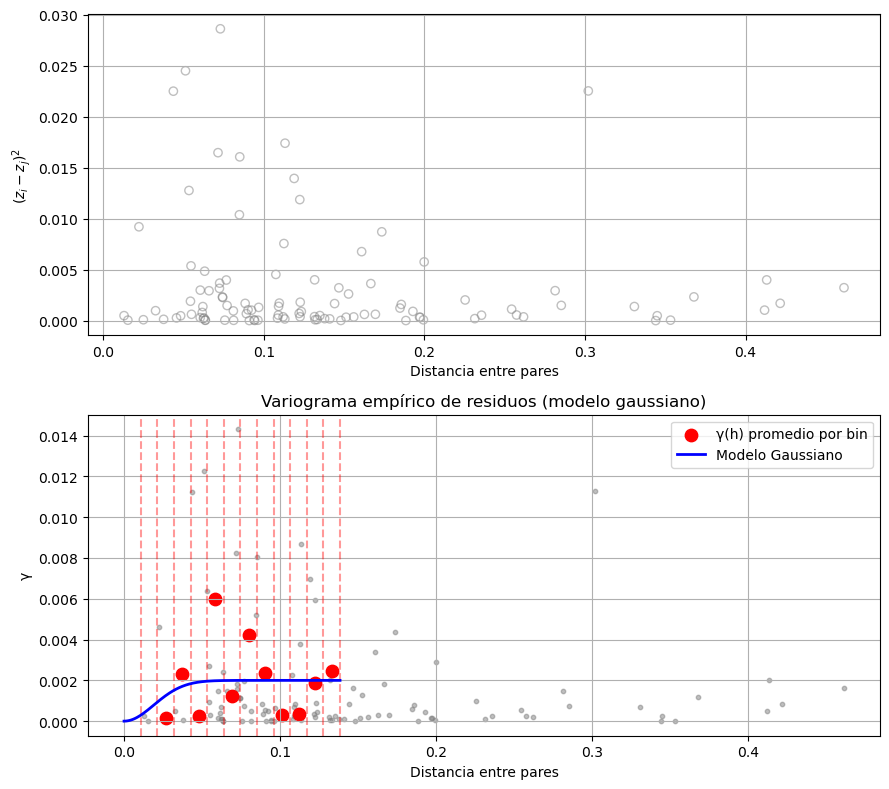

Procesando hora 12


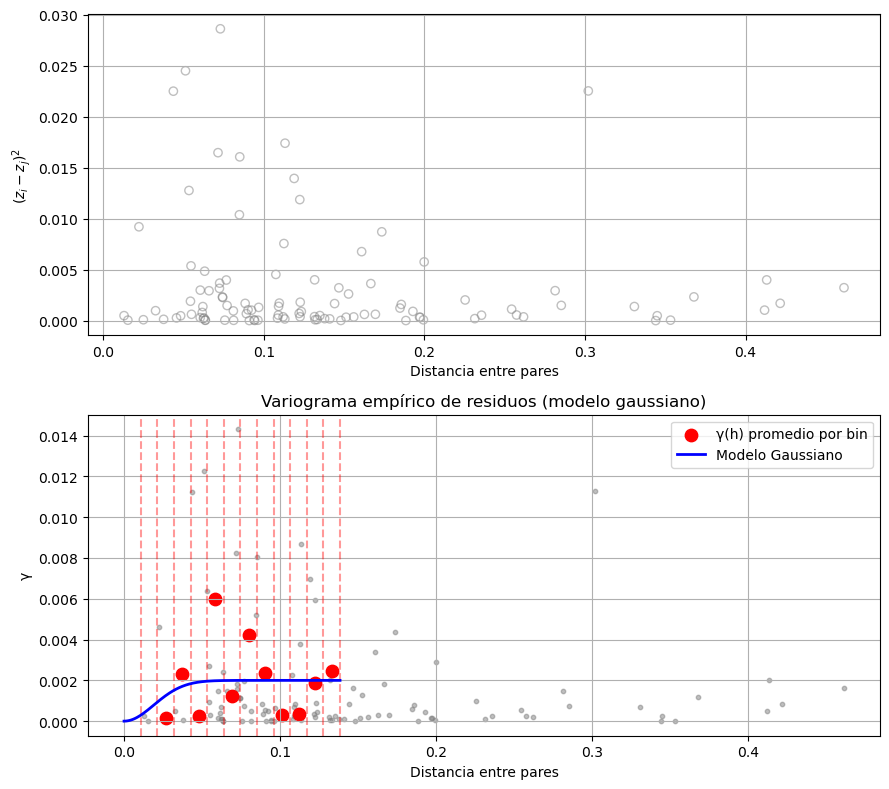

Procesando hora 13


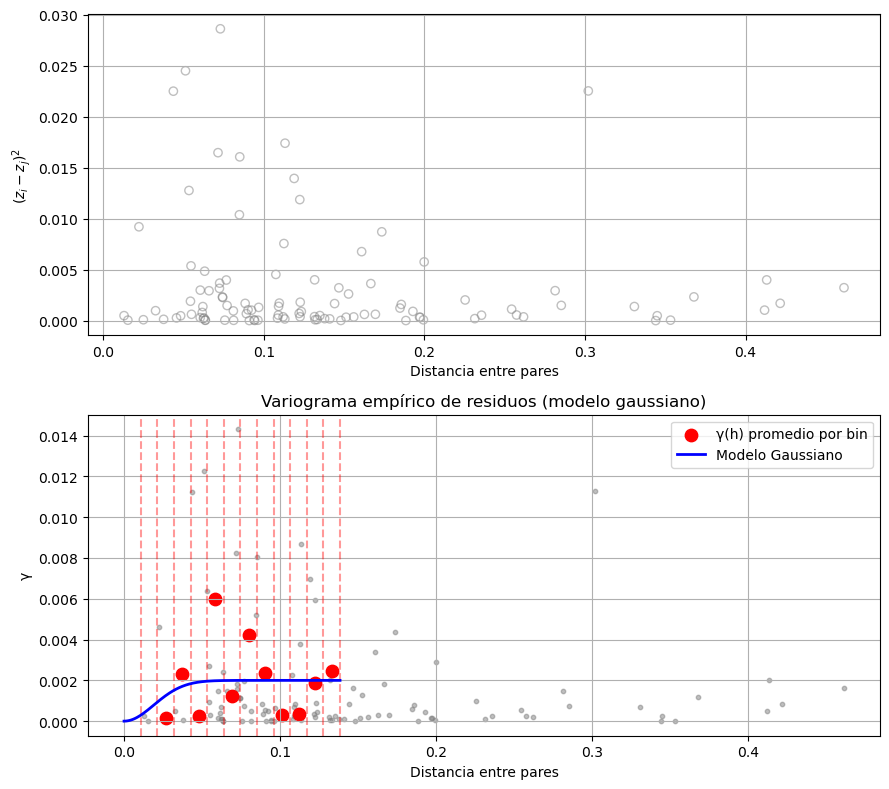

Procesando hora 14


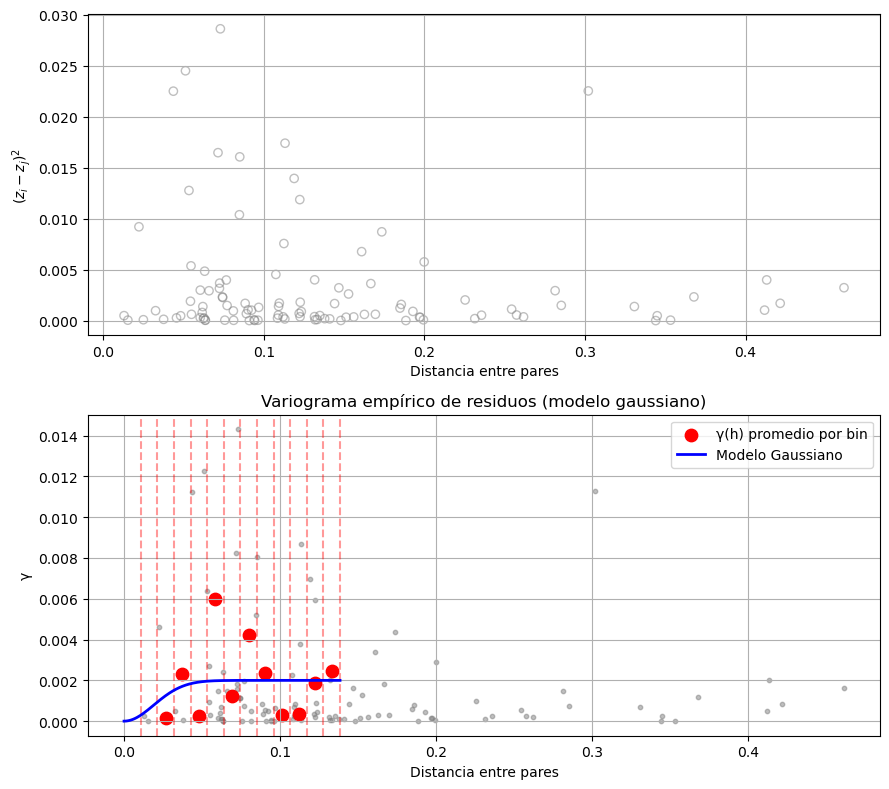

Procesando hora 15


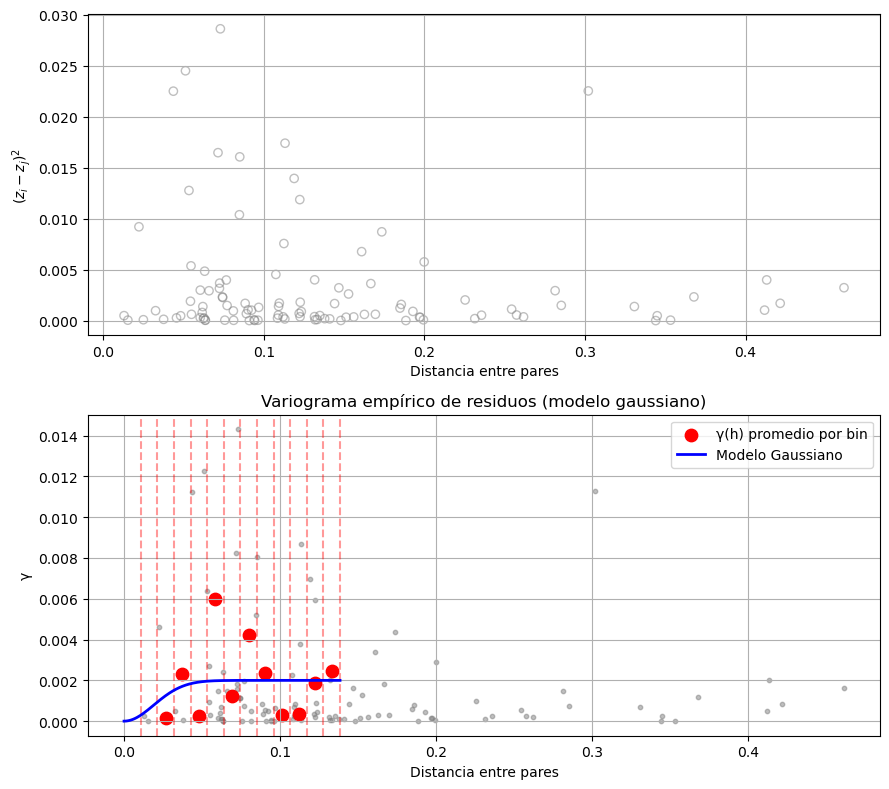

Procesando hora 16


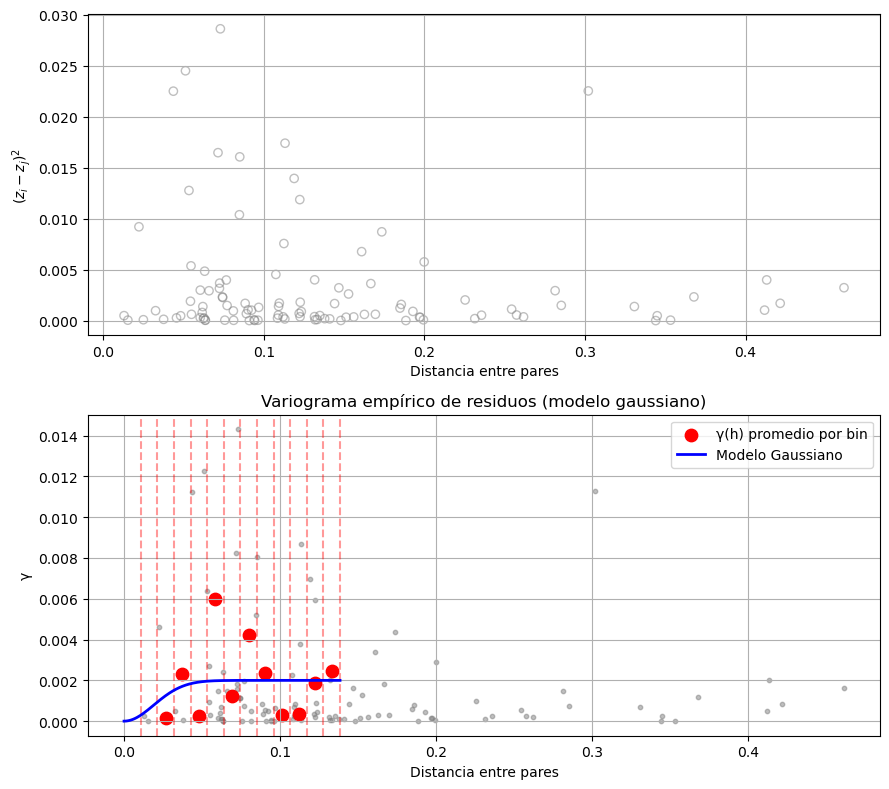

Procesando hora 17


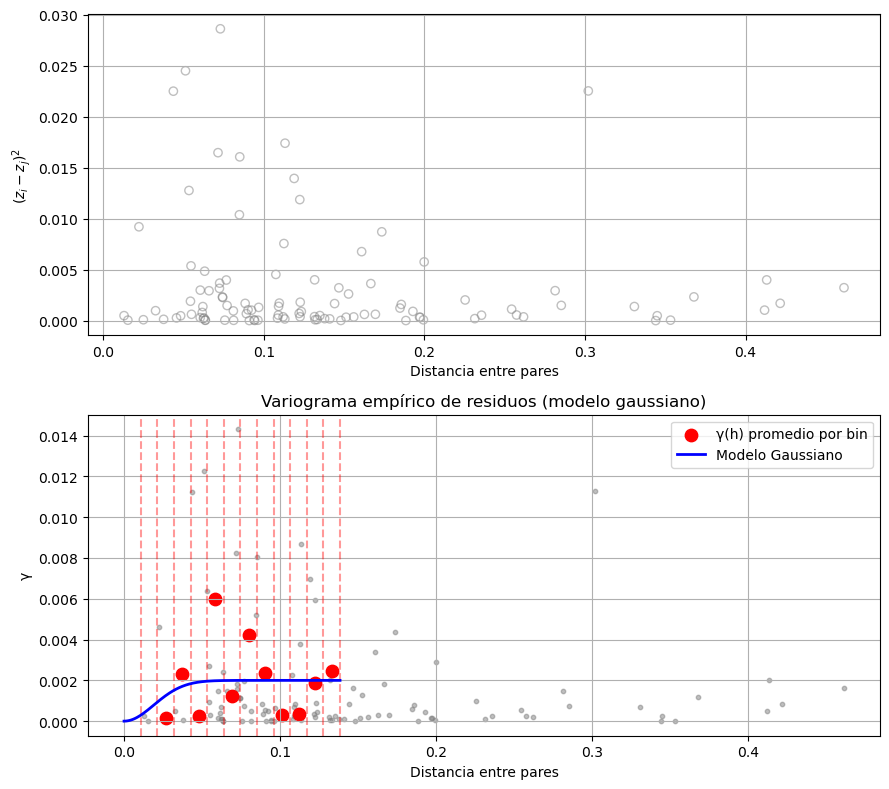

Procesando hora 18


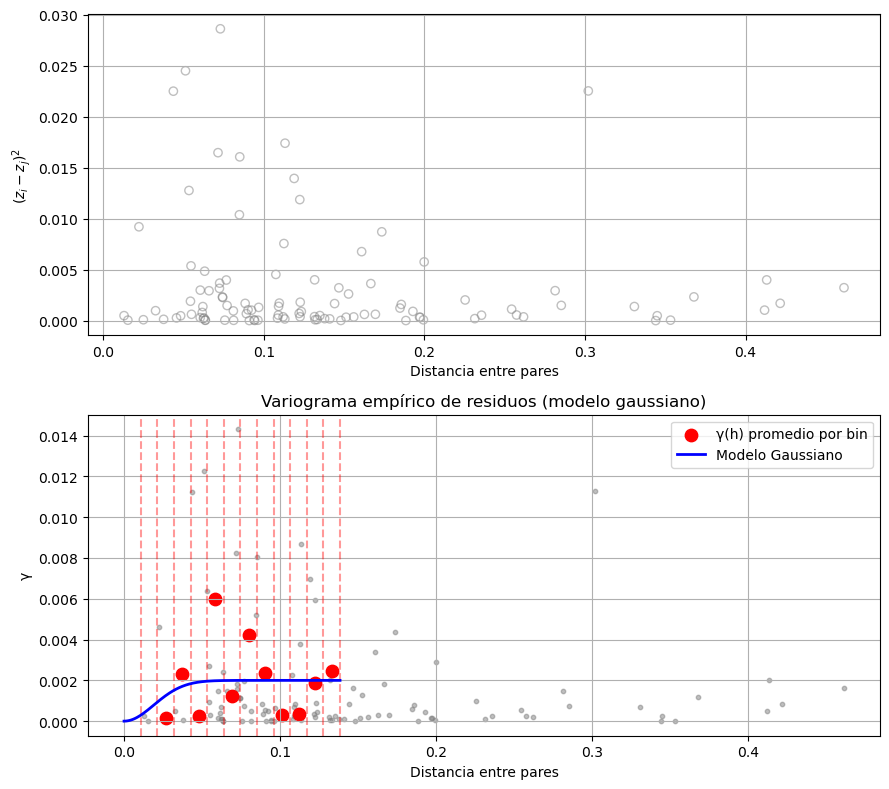

Procesando hora 19


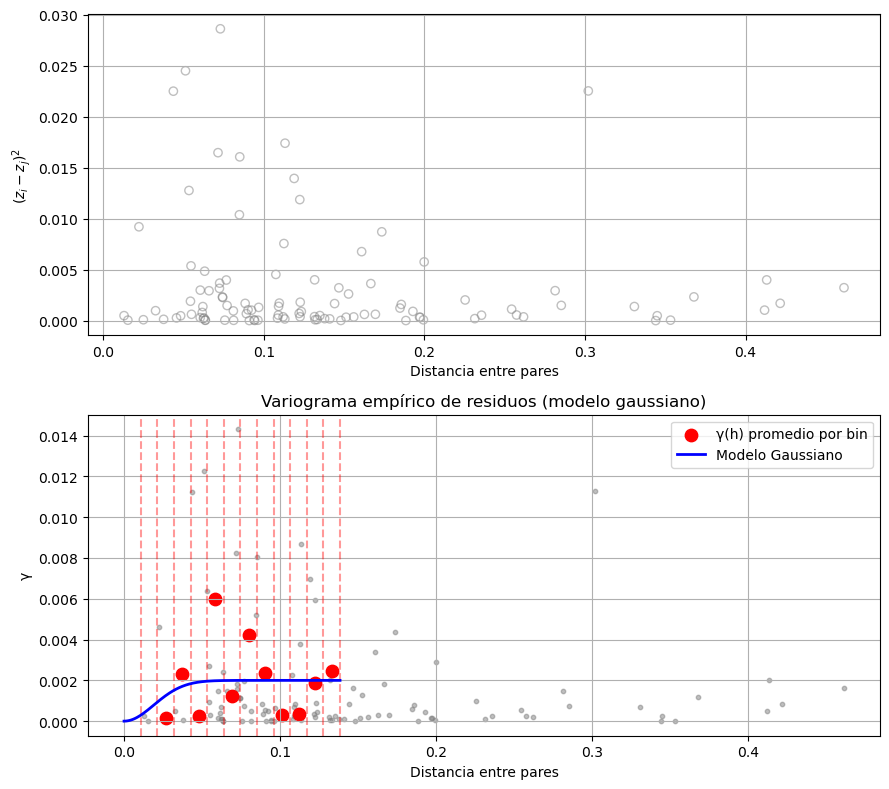

Procesando hora 20


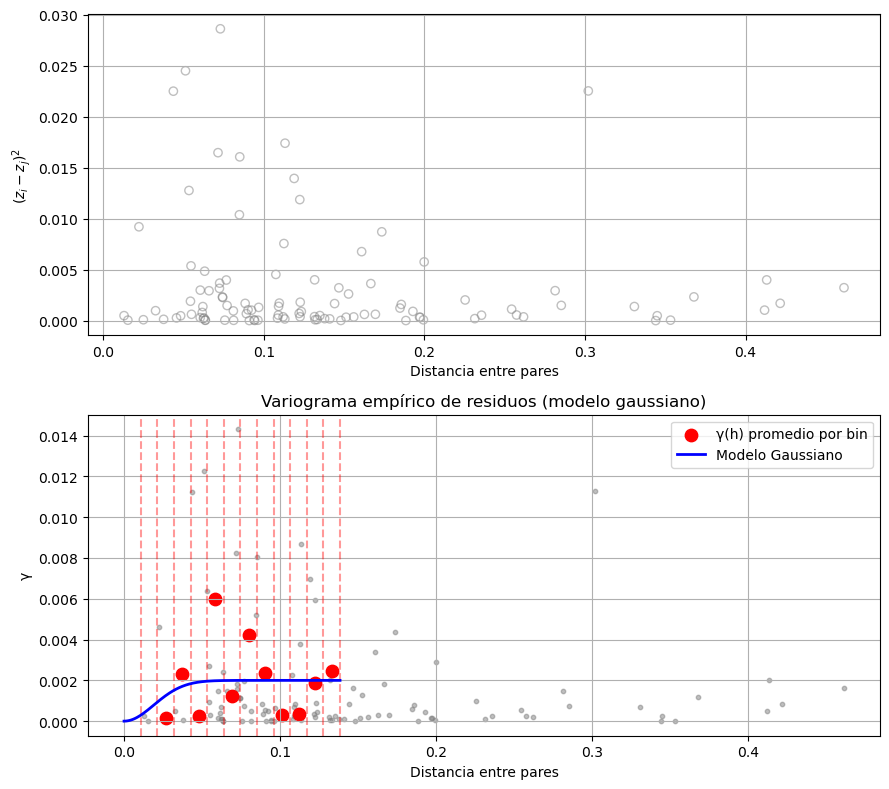

Procesando hora 21


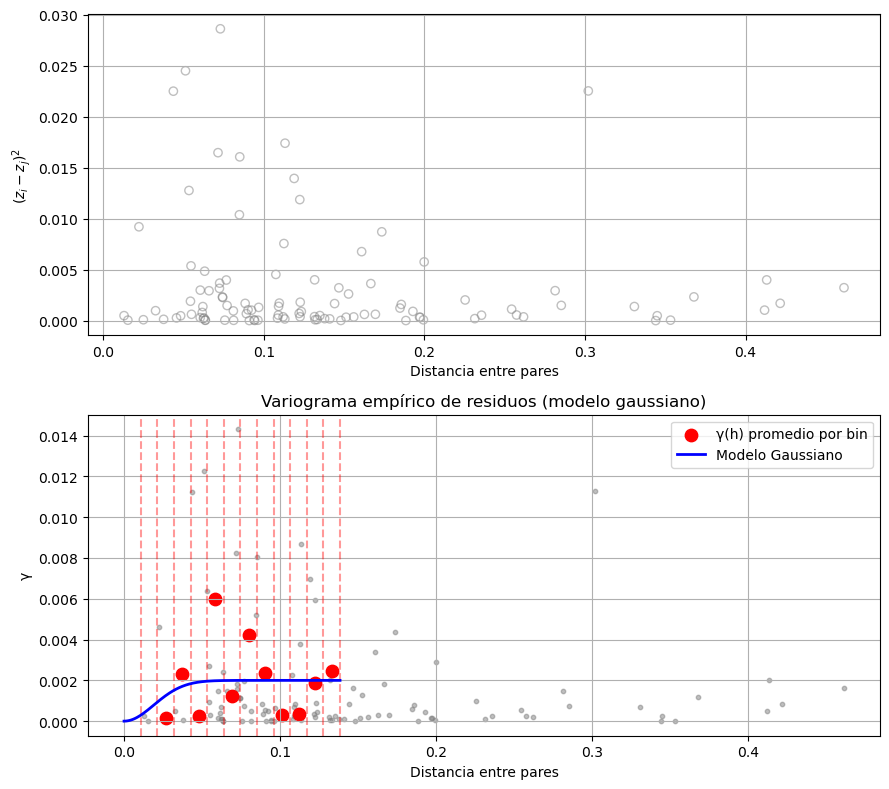

Procesando hora 22


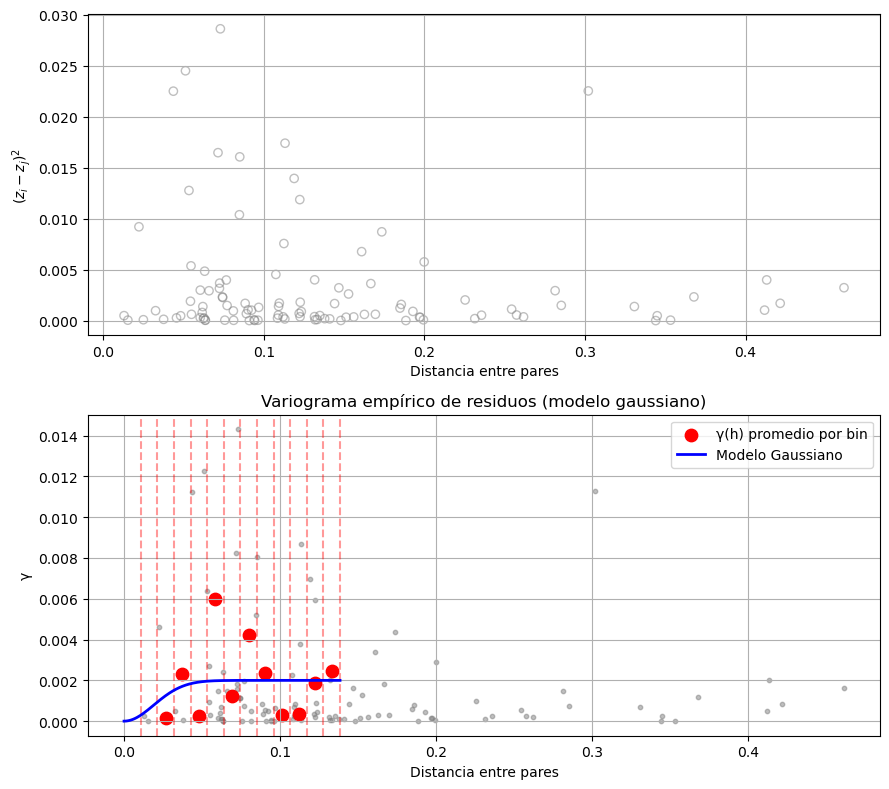

Procesando hora 23


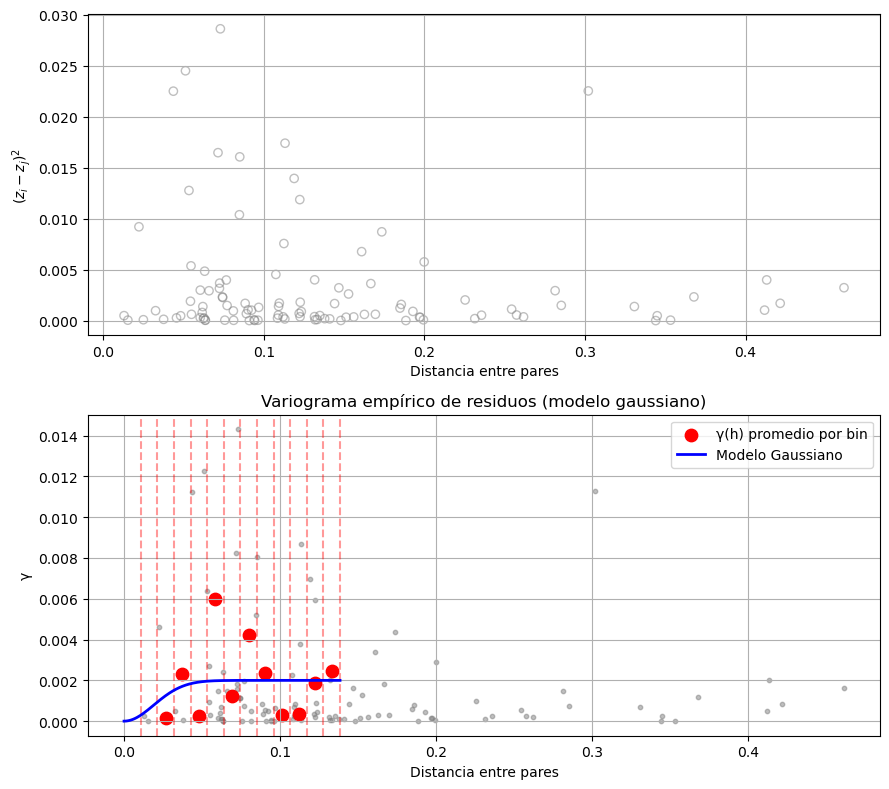

Procesando hora 24


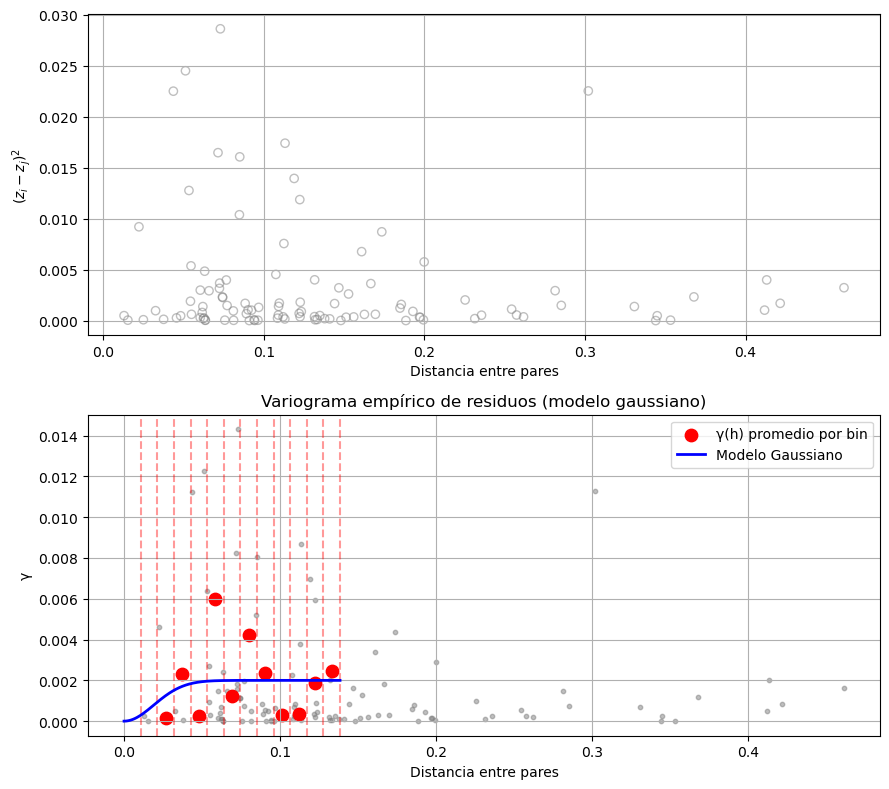

In [394]:
for h in range(1, 25):
    print(f"Procesando hora {h}")
    df_hora = df[df['hora'] == h].copy()

    if len(df_hora) >= 3:
        variograma_empirico_tipo_R(df_h, max_dist=0.3, n_bins=13)
    else:
        print(f"⚠️ No hay suficientes datos para la hora {h}")



In [390]:
from scipy.spatial.distance import pdist

coords = df[['Longitud', 'Latitud']].dropna().values
distancias = pdist(coords)  # en las unidades de tus coordenadas (grados o metros)

# Opción 1: 60% del máximo
max_dist = 0.6 * distancias.max()

# Opción 2: percentil 90
max_dist = np.percentile(distancias, 90)

print(f"Distancia máxima sugerida: {max_dist:.4f} unidades")


Distancia máxima sugerida: 0.2814 unidades


In [26]:
df = horarios.dropna(subset=['pm25', 'pp_horaria', 'temperatura','Latitud','Longitud'])


In [168]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ConstantKernel as C
from sklearn.preprocessing import StandardScaler

# Kernel recomendado: RBF + WhiteKernel
kernel = C(1.0, (1e-3, 1e3)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2)) + \
         WhiteKernel(noise_level=1, noise_level_bounds=(1e-5, 1e1))

# Inicializar escaladores
scaler_X = StandardScaler()
scaler_y = StandardScaler()

# Diccionarios para almacenar los modelos y los X escalados por hora
modelos_por_hora = {}
X_scaled_por_hora = {}

# Entrenamiento por hora
for h in sorted(df['hora'].unique()):
    df_h = df[df['hora'] == h]

    if len(df_h) < 2:
        continue  # Saltar si hay menos de 2 datos

    # Variables
    X_h = df_h[['temperatura', 'pp_horaria', 'Latitud', 'Longitud']].values
    y_h = df_h['pm25'].values

    # Escalado
    X_h_scaled = scaler_X.fit_transform(X_h)
    y_h_scaled = scaler_y.fit_transform(y_h.reshape(-1, 1)).ravel()

    # Entrenar modelo GP
    gp_h = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10, alpha=1e-2)
    gp_h.fit(X_h_scaled, y_h_scaled)

    # Guardar
    modelos_por_hora[h] = gp_h
    X_scaled_por_hora[h] = X_h_scaled


In [396]:
df

,Unnamed: 0_x,Codigo,Estacion,Ciudad,Longitud,Latitud,geometry,Unnamed: 0_y,hora,pm25,pp_horaria,temperatura,pm25_pred,error_abs,error_rel
0,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),0,1,28.026581,0.294968,19.163871,27.952500,0.074081,0.002643
1,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),1,2,27.870992,0.540774,18.928801,27.913971,0.042980,0.001542
2,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),2,3,27.077382,1.122516,18.679000,26.992525,0.084858,0.003134
3,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),3,4,26.379148,0.409677,18.487376,26.313777,0.065371,0.002478
4,0,12,Estación Tráfico Centro,Medellin,-75.56958,6.25256,POINT (-75.56958 6.25256),4,5,26.380198,0.270387,18.398113,26.353076,0.027122,0.001028
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),355,20,11.010333,0.098323,12.894070,11.064183,0.053850,0.004891
356,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),356,21,12.649717,0.409677,12.673548,12.673516,0.023800,0.001881
357,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),357,22,12.676909,0.122903,12.506495,12.591721,0.085188,0.006720
358,1815354,94,Medellín - Santa Elena,Medellín,-75.49847,6.23636,POINT (-75.49847 6.23636),358,23,11.904949,0.155677,12.283457,11.942231,0.037282,0.003132


In [169]:
matrices_covarianza_por_hora = {}

for h in modelos_por_hora.keys():
    gp_h = modelos_por_hora[h]
    X_h_scaled = X_scaled_por_hora[h]

    kernel_fitted = gp_h.kernel_
    K_h = kernel_fitted(X_h_scaled, X_h_scaled)
    matrices_covarianza_por_hora[h] = K_h


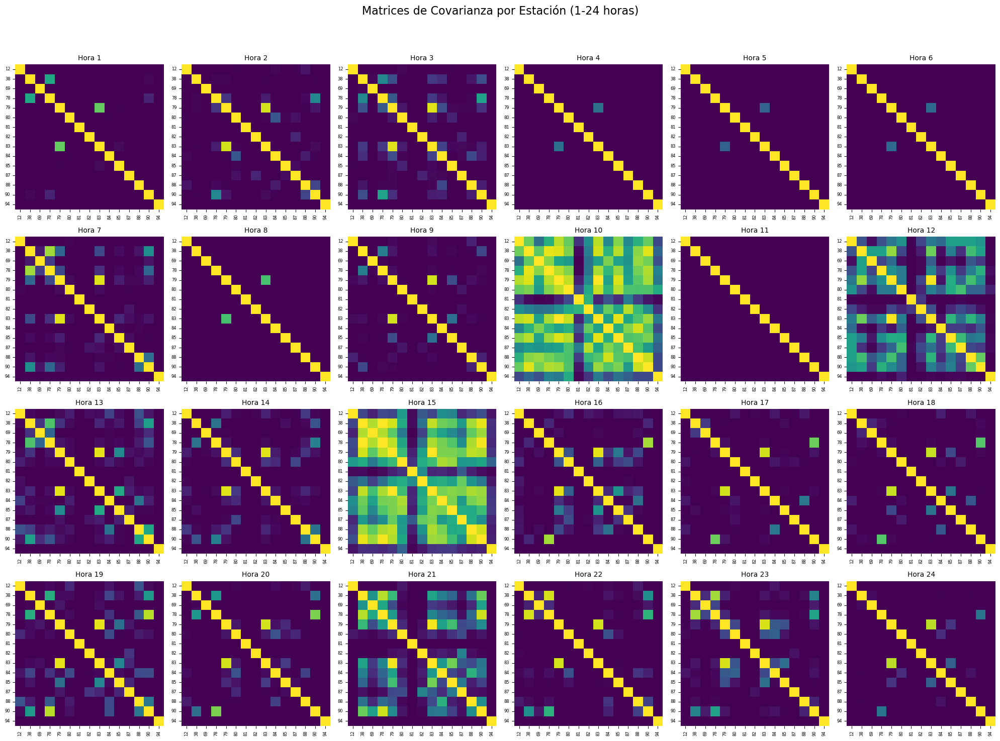

In [397]:
fig, axes = plt.subplots(nrows=4, ncols=6, figsize=(20, 15))
axes = axes.flatten()

for idx, h in enumerate(range(1, 25)):  # De hora 1 a 24
    if h in matrices_covarianza_por_hora:
        K_h = matrices_covarianza_por_hora[h]
        ax = axes[idx]

        # Obtener los códigos de estación en el orden correspondiente
        df_h = df[df['hora'] == h]
        codigos = df_h['Codigo'].tolist()

        # Asegurar el mismo orden que los datos escalados
        if len(codigos) != K_h.shape[0]:
            codigos = [f"E{i}" for i in range(K_h.shape[0])]  # fallback

        sns.heatmap(K_h, cmap='viridis', ax=ax, 
                    xticklabels=codigos, yticklabels=codigos, cbar=False)

        ax.set_title(f'Hora {h}', fontsize=10)
        ax.tick_params(axis='x', labelrotation=90, labelsize=6)
        ax.tick_params(axis='y', labelsize=6)
    else:
        axes[idx].axis('off')

plt.suptitle('Matrices de Covarianza por Estación (1-24 horas)', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


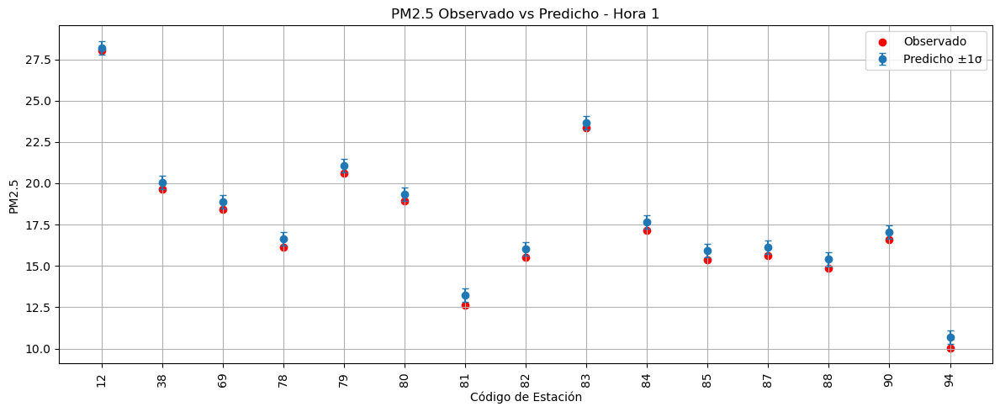

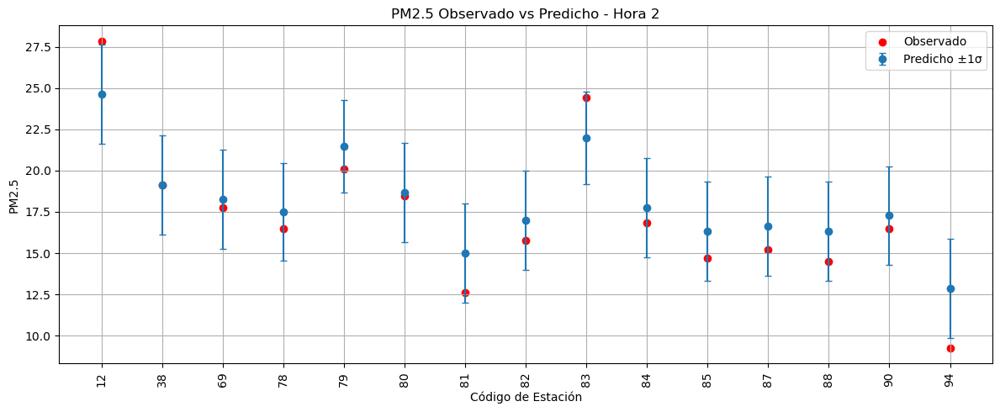

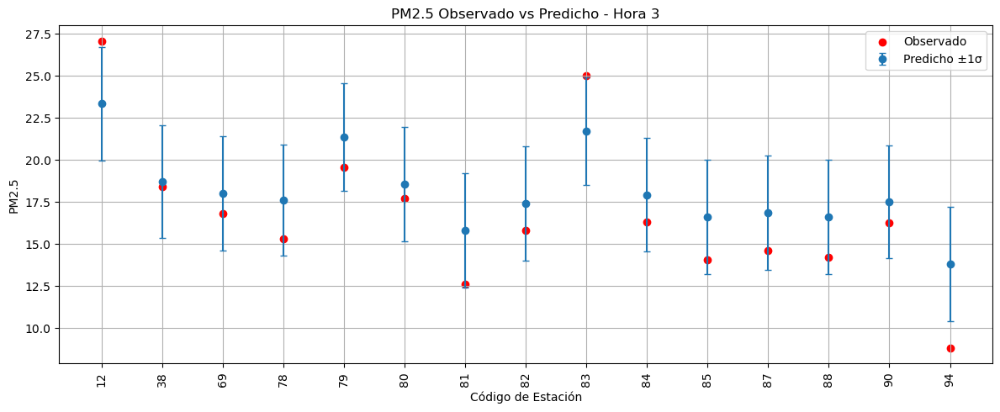

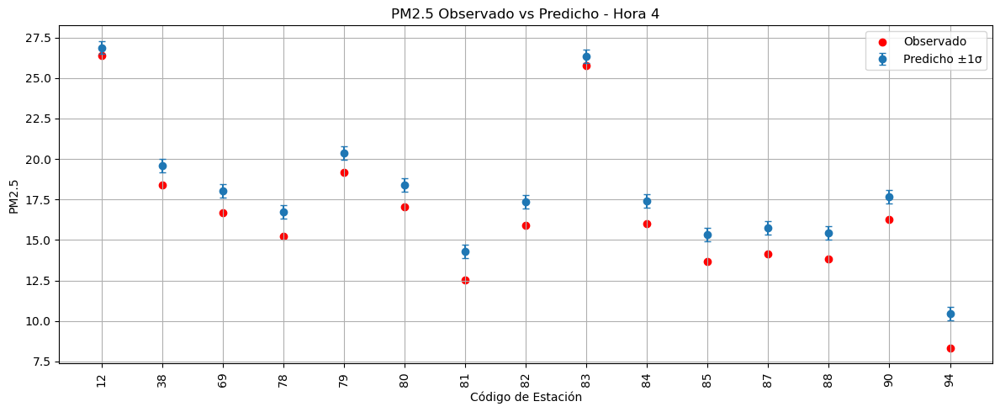

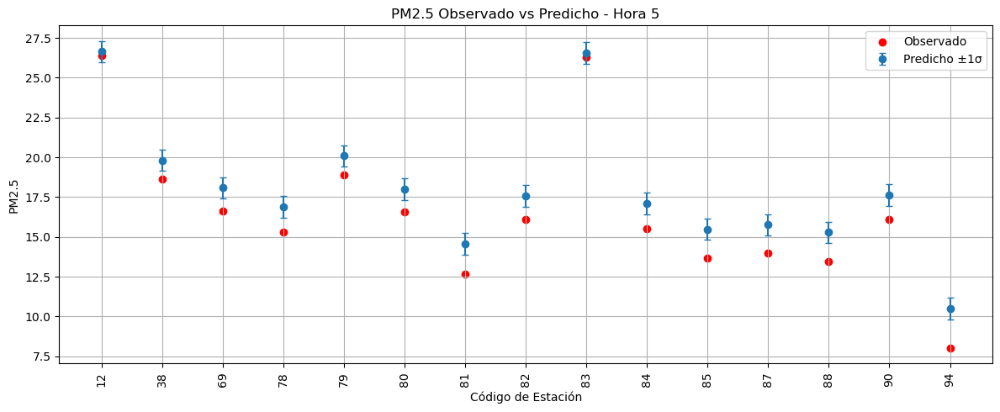

...

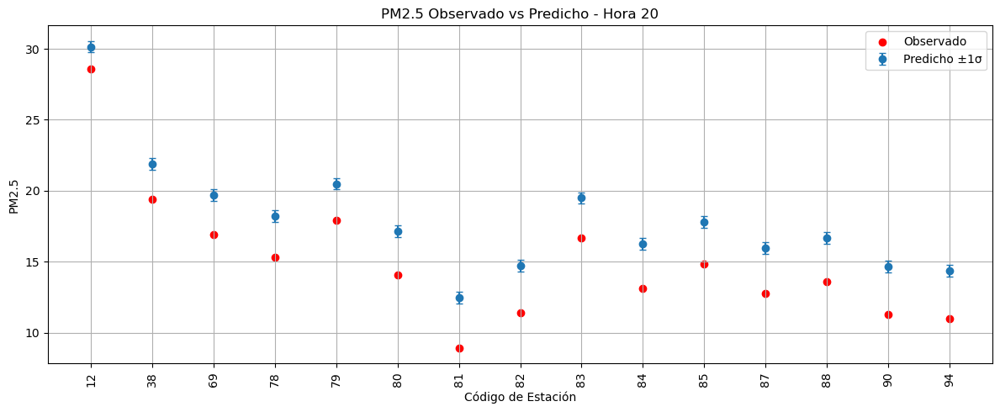

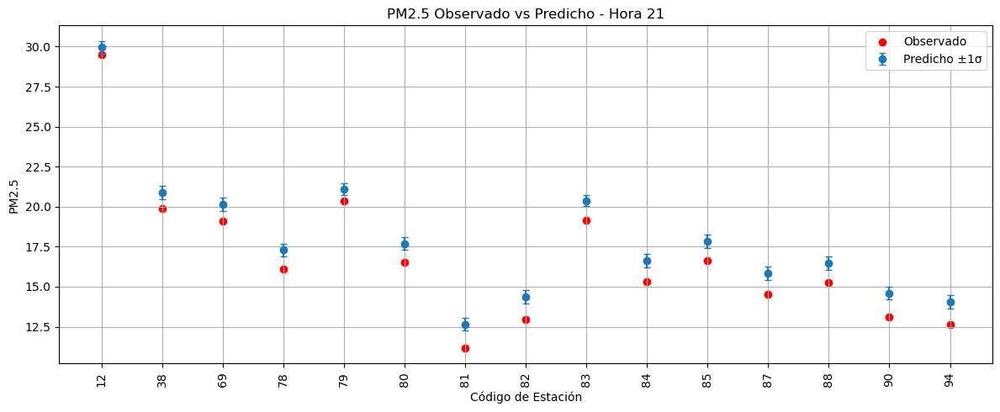

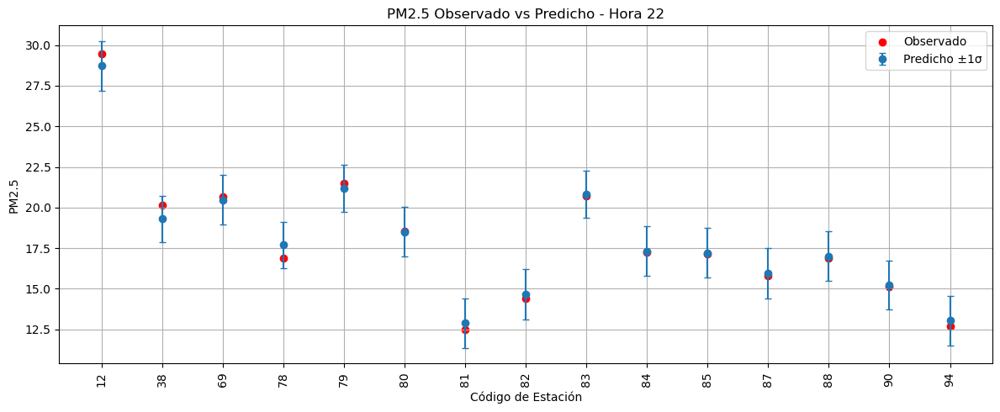

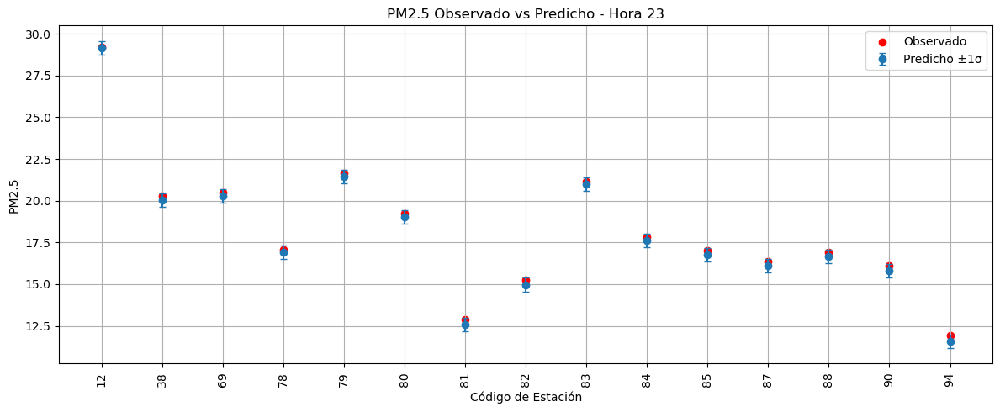

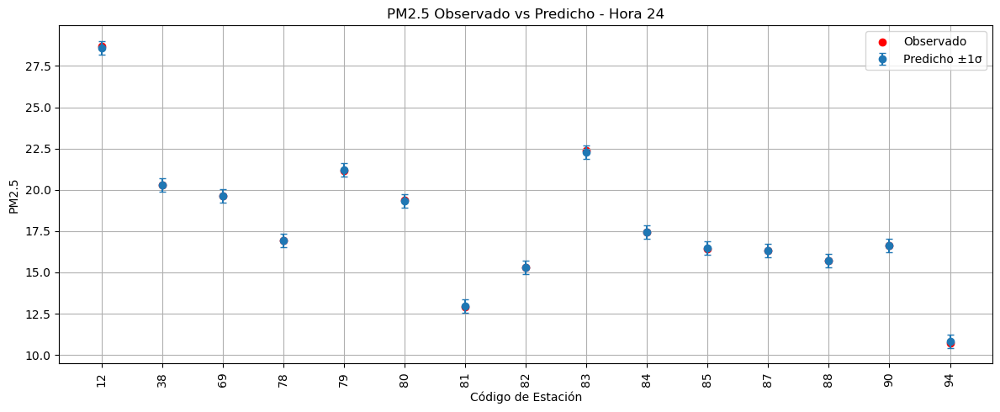

In [171]:
import matplotlib.pyplot as plt
import numpy as np

# Lista completa de estaciones (ordenadas como string)
codigos_estaciones = sorted(df['Codigo'].astype(str).unique())

for h in sorted(df['hora'].unique()):
    if h not in modelos_por_hora:
        continue  # Saltar si no hay modelo entrenado

    df_h = df[df['hora'] == h]
    if len(df_h) < 2:
        continue

    codigos_h = df_h['Codigo'].astype(str).values
    y_h = df_h['pm25'].values

    gp = modelos_por_hora[h]
    X_h_scaled = X_scaled_por_hora[h]

    # Predicción
    y_pred_scaled, y_std_scaled = gp.predict(X_h_scaled, return_std=True)
    y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).ravel()
    y_std = y_std_scaled * scaler_y.scale_[0]
    y_obs = y_h

    # Mapear resultados a códigos
    pred_dict = dict(zip(codigos_h, y_pred))
    obs_dict = dict(zip(codigos_h, y_obs))
    std_dict = dict(zip(codigos_h, y_std))

    # Alinear todos los códigos
    y_pred_full = [pred_dict.get(cod, np.nan) for cod in codigos_estaciones]
    y_obs_full = [obs_dict.get(cod, np.nan) for cod in codigos_estaciones]
    y_std_full = [std_dict.get(cod, np.nan) for cod in codigos_estaciones]

    # Gráfico
    plt.figure(figsize=(12, 5))
    plt.errorbar(codigos_estaciones, y_pred_full, yerr=y_std_full, fmt='o', label='Predicho ±1σ', capsize=3)
    plt.scatter(codigos_estaciones, y_obs_full, color='red', label='Observado')
    plt.title(f'PM2.5 Observado vs Predicho - Hora {h}')
    plt.xlabel('Código de Estación')
    plt.ylabel('PM2.5')
    plt.xticks(rotation=90)
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [185]:
# Aplanar la grilla para convertir en DataFrame
lat_flat = grid_lat.ravel()
lon_flat = grid_lon.ravel()

# Crear DataFrame
df_grilla = pd.DataFrame({
    'Latitud': lat_flat,
    'Longitud': lon_flat
})
# Usar valores promedio (ajústalo si quieres otra lógica)
temp_prom = df['temperatura'].mean()
pp_prom = df['pp_horaria'].mean()

# Añadir variables constantes
df_grilla['temperatura'] = temp_prom
df_grilla['pp_horaria'] = pp_prom
# Expandir grilla a 24 horas
df_grilla = pd.concat([
    df_grilla.assign(hora=h) for h in range(24)
], ignore_index=True)
pm25_predichos = []

for h in range(24):
    df_h = df_grilla[df_grilla['hora'] == h]
    if h not in modelos_por_hora:
        continue

    X_h = df_h[['temperatura', 'pp_horaria', 'Latitud', 'Longitud']].values
    X_h_scaled = scaler_X.fit_transform(X_h)

    gp_h = modelos_por_hora[h]
    y_pred_scaled, _ = gp_h.predict(X_h_scaled, return_std=True)
    y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).ravel()

    df_h = df_h.copy()
    df_h['pm25_predicho'] = y_pred
    pm25_predichos.append(df_h)

# Unir todas las predicciones
df_grilla_pred = pd.concat(pm25_predichos, ignore_index=True)


In [195]:
municipios = municipios.to_crs(epsg=4326)

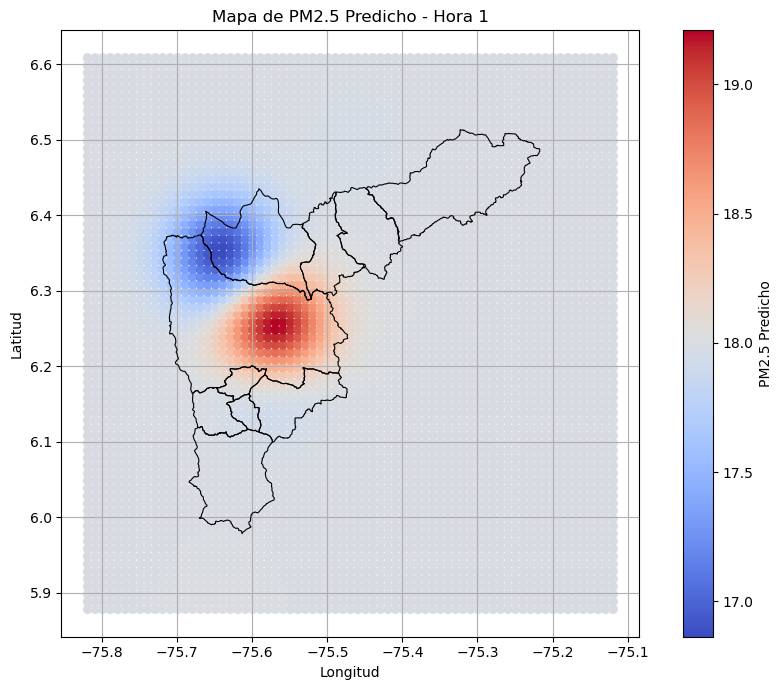

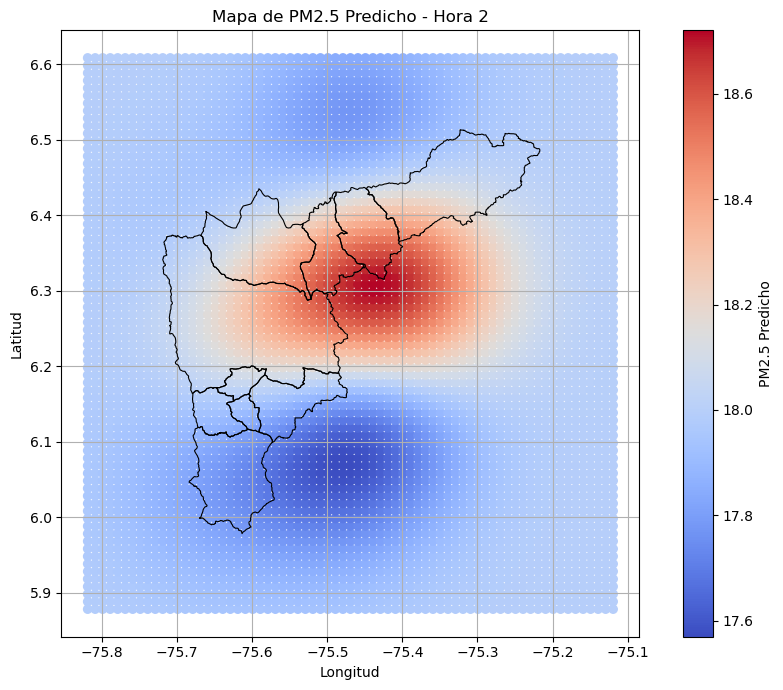

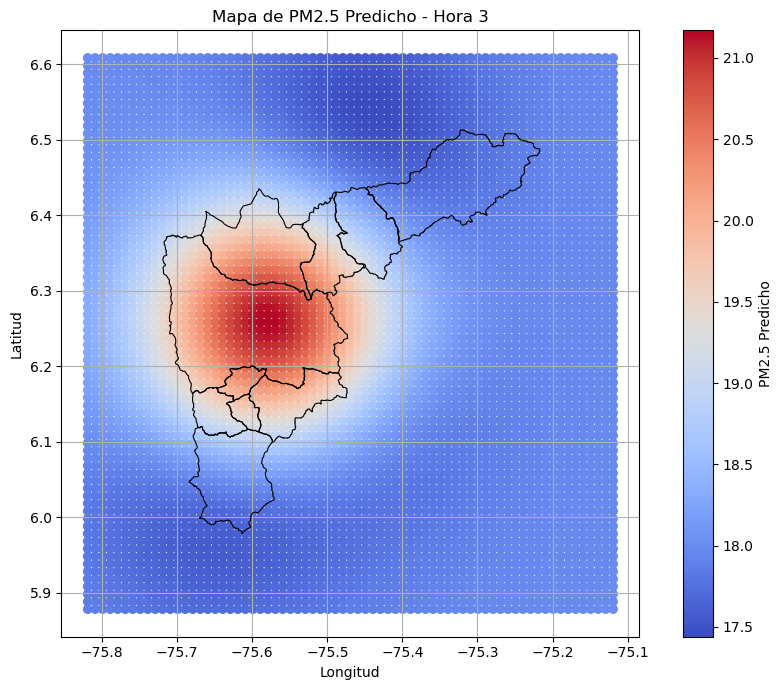

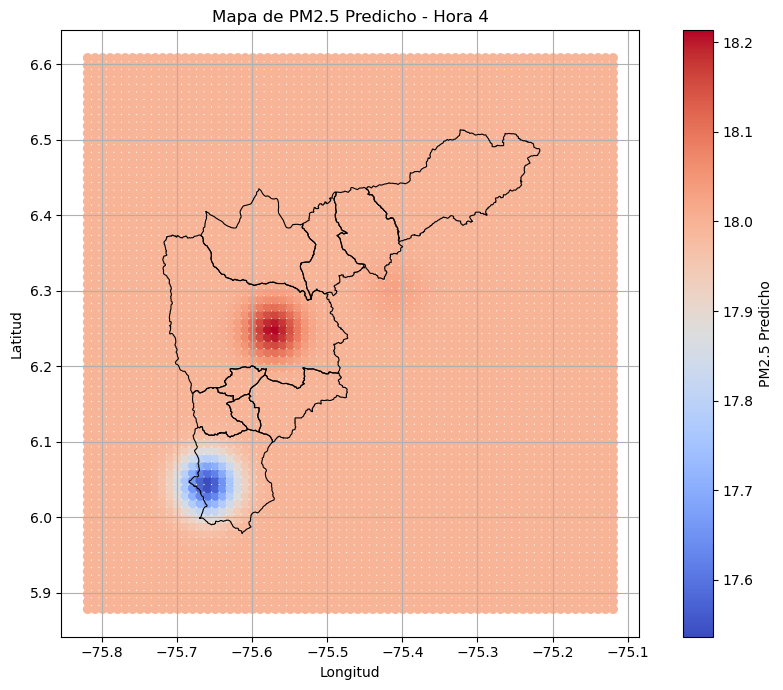

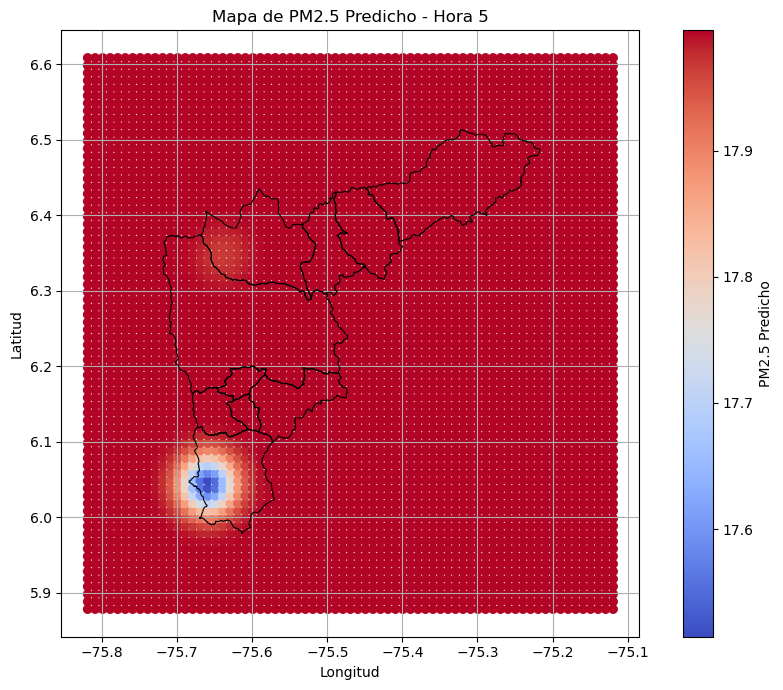

...

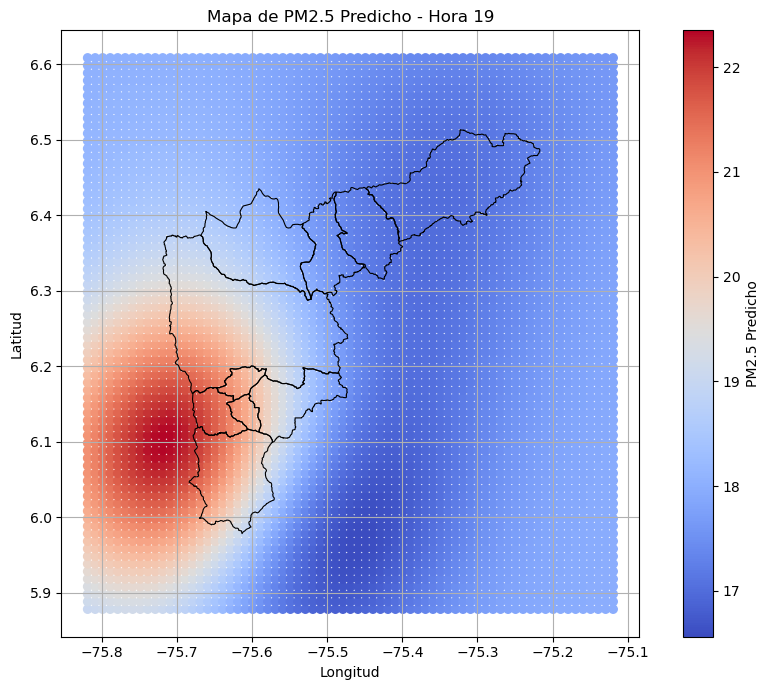

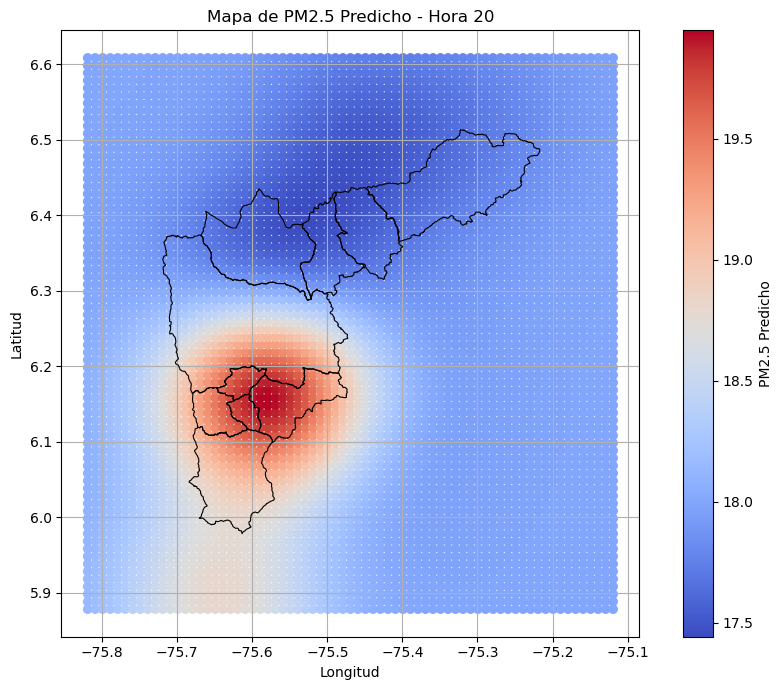

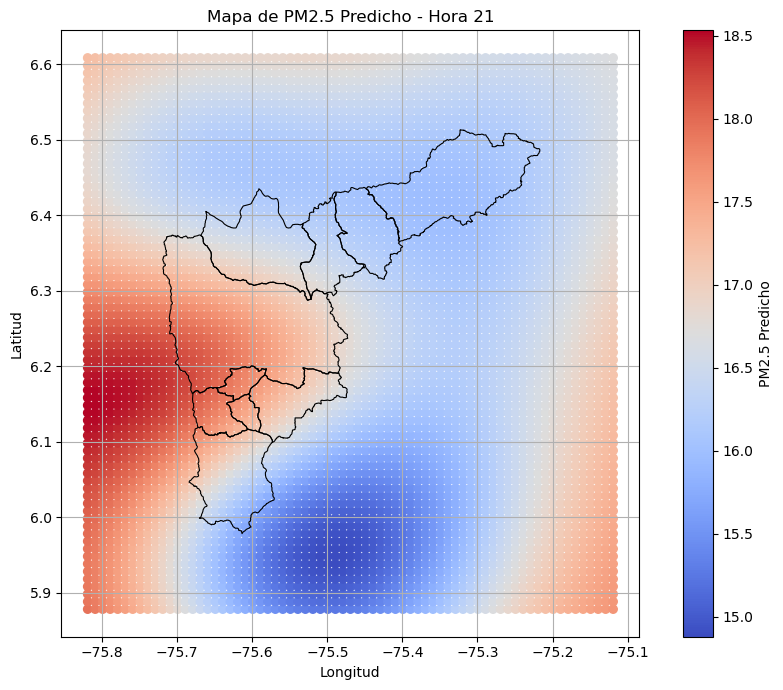

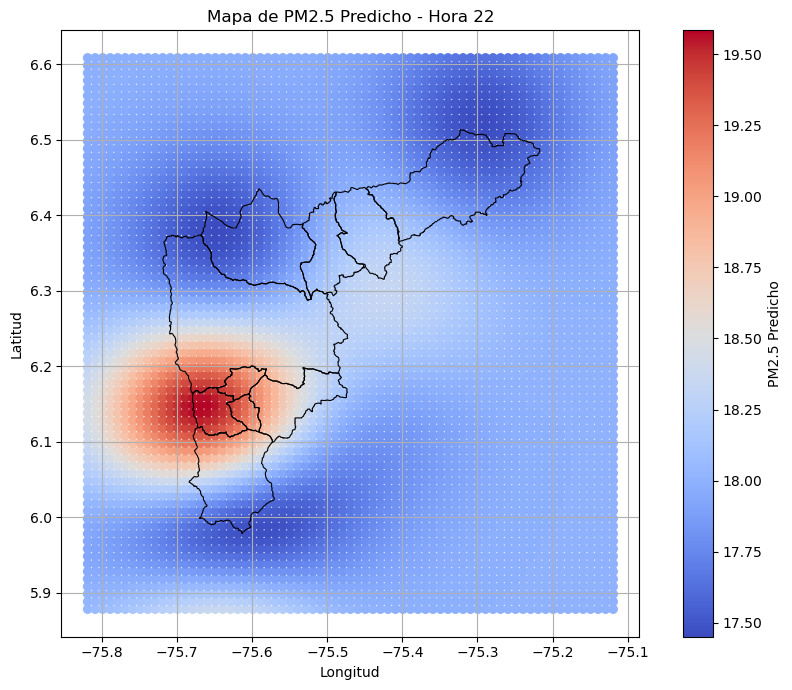

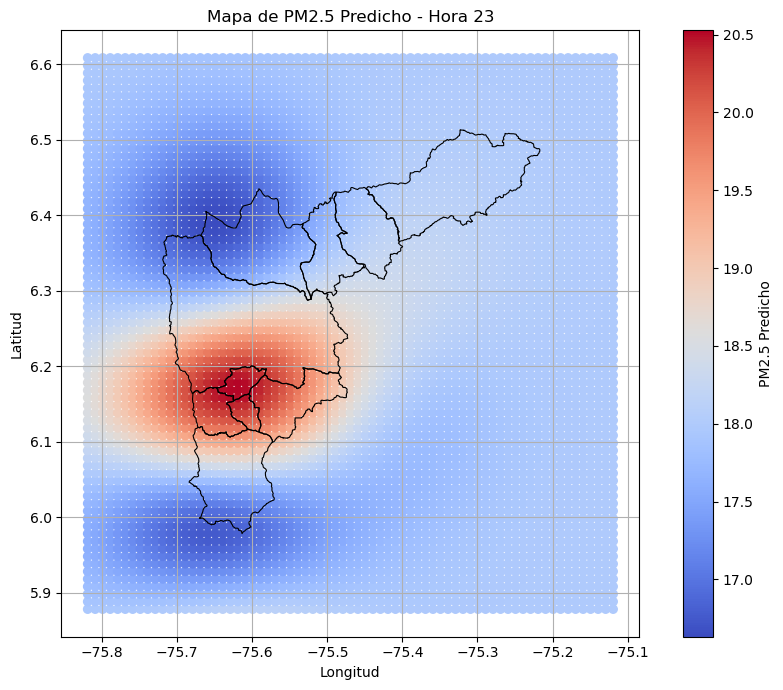

In [198]:
for h in range(24):
    df_h = df_grilla_pred[df_grilla_pred['hora'] == h]
    if df_h.empty:
        continue

    fig, ax = plt.subplots(figsize=(9, 7))

    # 1. Scatter de PM2.5 predicho
    sc = ax.scatter(
        df_h['Longitud'], df_h['Latitud'],
        c=df_h['pm25_predicho'], cmap='coolwarm', s=35, zorder=1
    )

    # 2. Shapefile de municipios (encima)
    municipios.plot(
        ax=ax, facecolor='none', edgecolor='black', linewidth=0.8, zorder=2
    )

    plt.colorbar(sc, ax=ax, label='PM2.5 Predicho')
    ax.set_title(f'Mapa de PM2.5 Predicho - Hora {h}')
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')
    ax.grid(True)
    plt.tight_layout()
    plt.show()


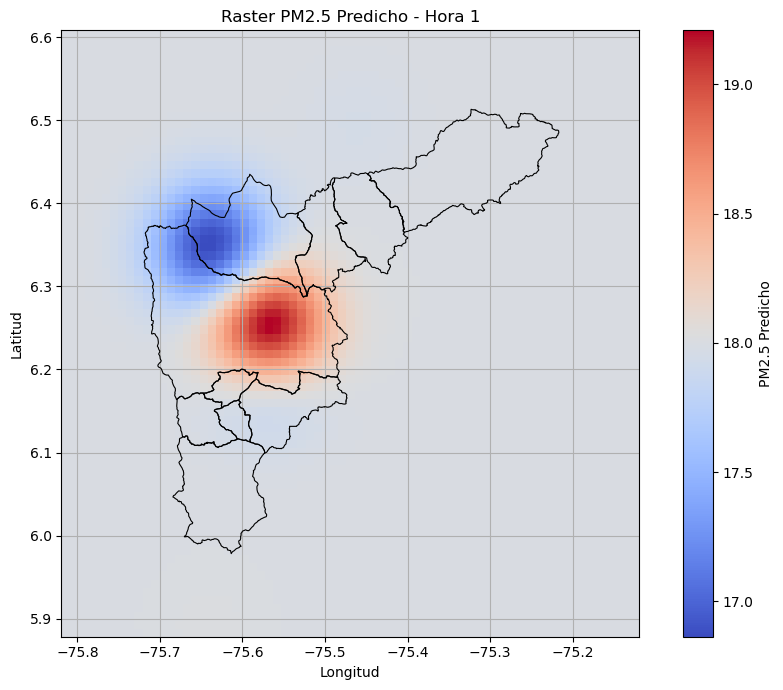

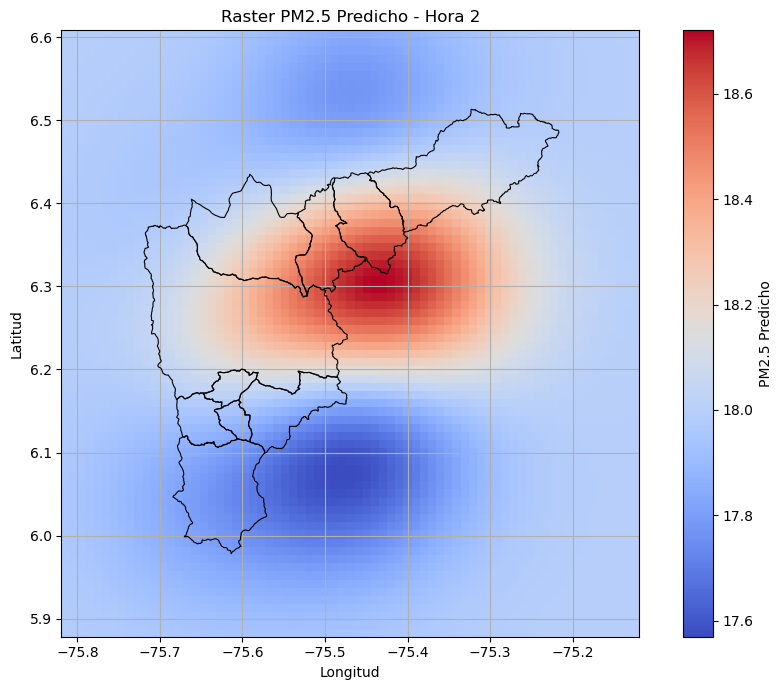

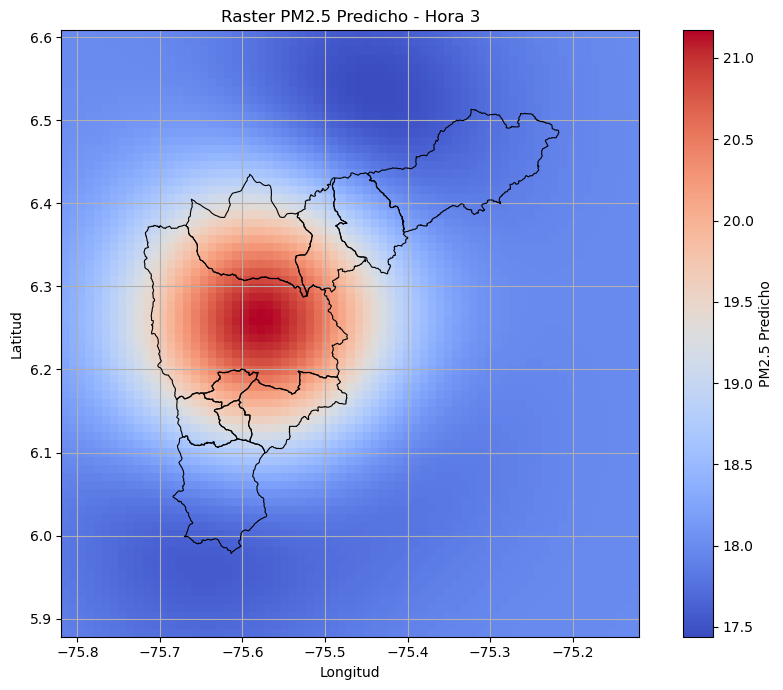

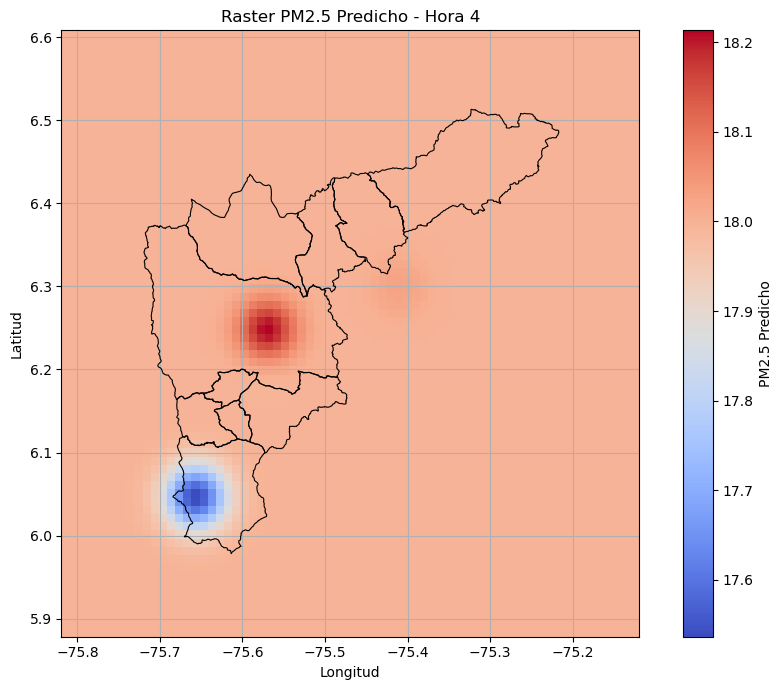

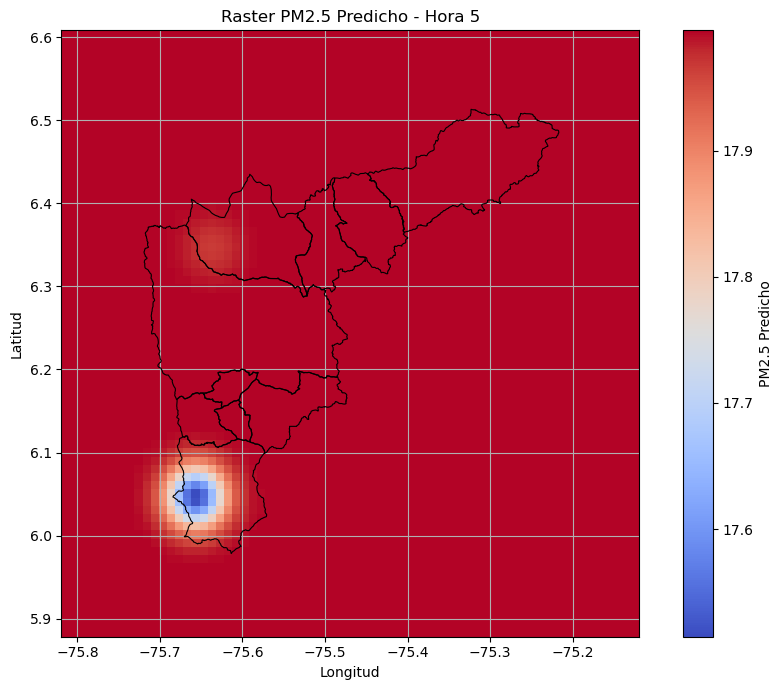

...

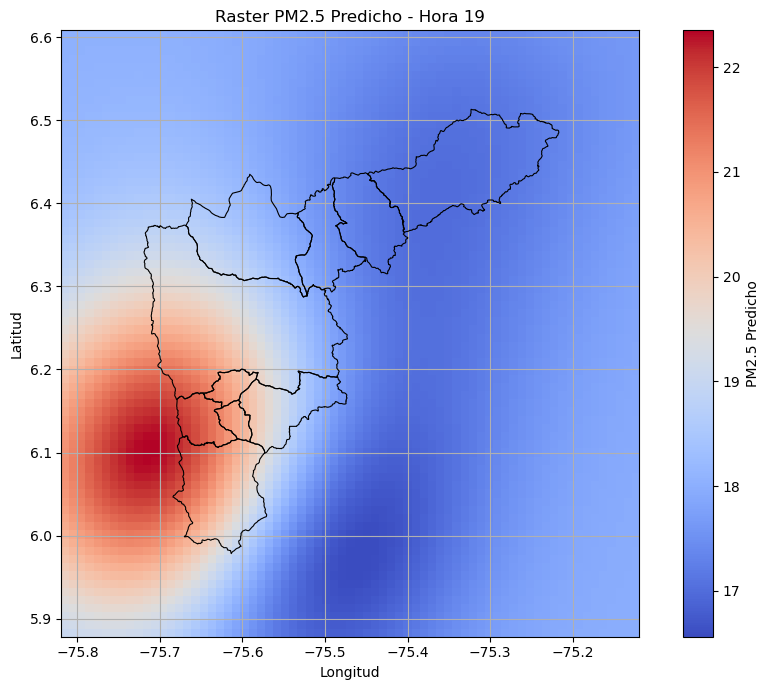

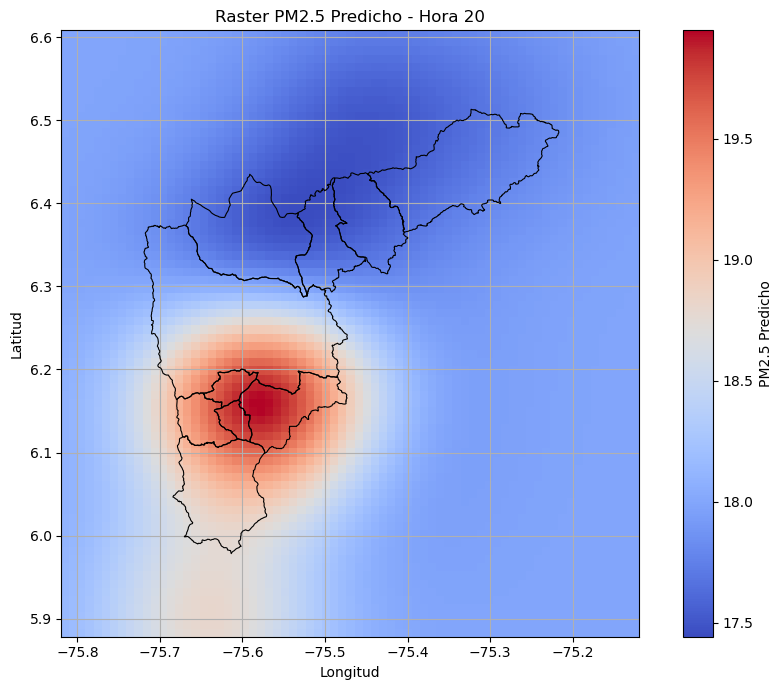

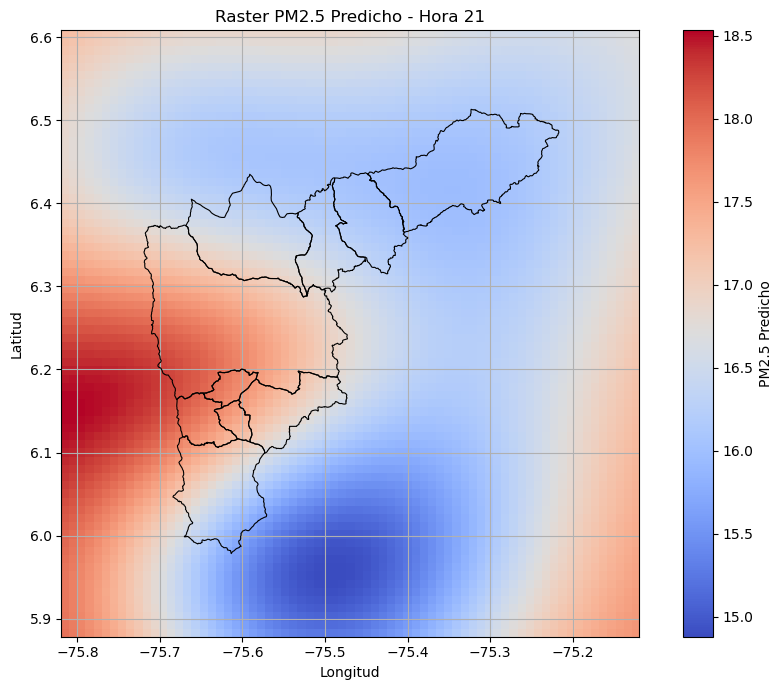

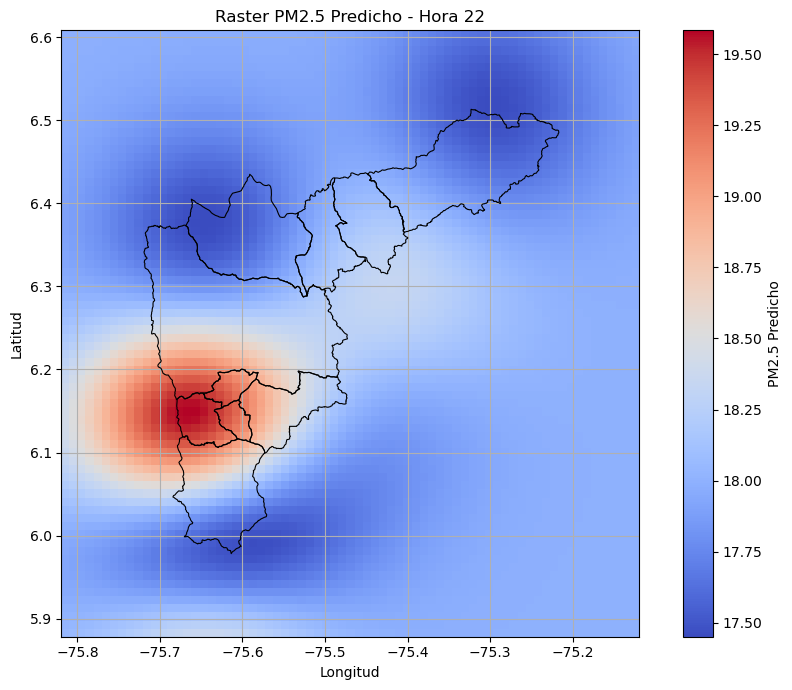

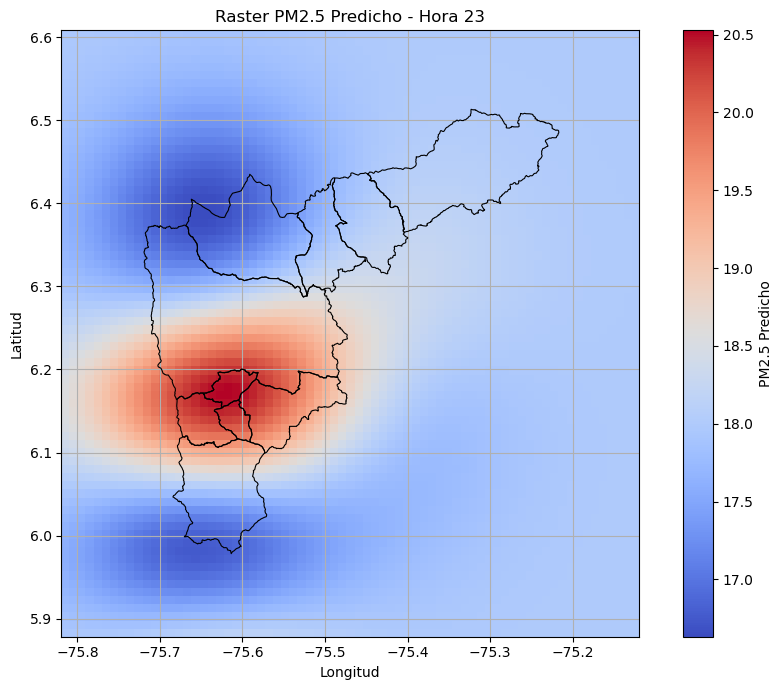

In [204]:
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np

# Asegura que municipios esté en el mismo CRS que tu data
municipios = municipios.to_crs("EPSG:4326")

for h in range(24):
    df_h = df_grilla_pred[df_grilla_pred['hora'] == h]
    if df_h.empty:
        continue

    # Crear grilla de valores
    lon_unique = np.sort(df_h['Longitud'].unique())
    lat_unique = np.sort(df_h['Latitud'].unique())
    grid_lon, grid_lat = np.meshgrid(lon_unique, lat_unique)

    # Crear matriz de PM2.5 predicho
    grid_pm25 = df_h.pivot_table(index='Latitud', columns='Longitud', values='pm25_predicho')
    grid_pm25 = grid_pm25.values  # Convertir a array para imshow

    # Mapa
    fig, ax = plt.subplots(figsize=(9, 7))

    img = ax.imshow(
        grid_pm25,
        extent=[lon_unique.min(), lon_unique.max(), lat_unique.min(), lat_unique.max()],
        origin='lower',
        cmap='coolwarm',
        aspect='auto',
        zorder=1
    )

    # Agregar shapefile de municipios encima
    municipios.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=0.8, zorder=2)

    plt.colorbar(img, ax=ax, label='PM2.5 Predicho')
    ax.set_title(f'Raster PM2.5 Predicho - Hora {h}')
    ax.set_xlabel('Longitud')
    ax.set_ylabel('Latitud')
    ax.grid(True)
    plt.tight_layout()
    plt.show()


In [174]:
#usanodo nuevos puntos para predecir 
df_nuevos_puntos=pd.read_csv(r"C:\Users\Documents\unal\analisis geoespacial\Trabajo3\horarioGEE.csv")
df_nuevos_puntos

,Unnamed: 0,Codigo,hora,lat,lon,temp_C,precip_mm
0,0,1001,0,6.162000,-75.644000,15.873729,12.101268
1,1,1001,1,6.162000,-75.644000,15.321435,0.533841
2,2,1001,2,6.162000,-75.644000,14.838349,1.000158
3,3,1001,3,6.162000,-75.644000,14.436152,1.381181
4,4,1001,4,6.162000,-75.644000,14.062604,1.780512
...,...,...,...,...,...,...,...
307,307,1013,19,6.428938,-75.590986,17.829011,5.929493
308,308,1013,20,6.428938,-75.590986,17.053810,8.048955
309,309,1013,21,6.428938,-75.590986,16.072054,10.702758
310,310,1013,22,6.428938,-75.590986,15.187546,12.834521


In [175]:
# Renombrar solo las columnas 'A' y 'B'
df_nuevos_puntos = df_nuevos_puntos.rename(columns={'lat': 'Latitud', 'lon': 'Longitud','temp_C':'temperatura','precip_mm':'pp_horaria'})
df_nuevos_puntos


,Unnamed: 0,Codigo,hora,Latitud,Longitud,temperatura,pp_horaria
0,0,1001,0,6.162000,-75.644000,15.873729,12.101268
1,1,1001,1,6.162000,-75.644000,15.321435,0.533841
2,2,1001,2,6.162000,-75.644000,14.838349,1.000158
3,3,1001,3,6.162000,-75.644000,14.436152,1.381181
4,4,1001,4,6.162000,-75.644000,14.062604,1.780512
...,...,...,...,...,...,...,...
307,307,1013,19,6.428938,-75.590986,17.829011,5.929493
308,308,1013,20,6.428938,-75.590986,17.053810,8.048955
309,309,1013,21,6.428938,-75.590986,16.072054,10.702758
310,310,1013,22,6.428938,-75.590986,15.187546,12.834521


In [176]:
# Asegúrate de importar numpy si no lo has hecho
import numpy as np

# Crear listas para guardar resultados
pm25_predichos = []
pm25_std = []

# Recorrer cada fila (punto nuevo)
for idx, row in df_nuevos_puntos.iterrows():
    h = row['hora']
    
    # Verificar que haya modelo para esa hora
    if h not in modelos_por_hora:
        pm25_predichos.append(np.nan)
        pm25_std.append(np.nan)
        continue

    # Extraer variables de entrada
    X_new = np.array([[row['temperatura'], row['pp_horaria'], row['Latitud'], row['Longitud']]])

    # Escalar con el mismo escalador X que usaste (¡usa el mismo objeto!)
    X_new_scaled = scaler_X.transform(X_new)

    # Predecir usando el modelo correspondiente a esa hora
    gp = modelos_por_hora[h]
    y_pred_scaled, y_std_scaled = gp.predict(X_new_scaled, return_std=True)

    # Invertir el escalado de y
    y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).ravel()[0]
    y_std = y_std_scaled[0] * scaler_y.scale_[0]  # Ajustar la desviación

    # Guardar resultados
    pm25_predichos.append(y_pred)
    pm25_std.append(y_std)

# Añadir columnas al dataframe original
df_nuevos_puntos['pm25_predicho'] = pm25_predichos
df_nuevos_puntos['pm25_std'] = pm25_std


In [177]:
df_nuevos_puntos

,Unnamed: 0,Codigo,hora,Latitud,Longitud,temperatura,pp_horaria,pm25_predicho,pm25_std
0,0,1001,0,6.162000,-75.644000,15.873729,12.101268,NaN,NaN
1,1,1001,1,6.162000,-75.644000,15.321435,0.533841,17.995634,4.125157
2,2,1001,2,6.162000,-75.644000,14.838349,1.000158,17.997471,4.082572
3,3,1001,3,6.162000,-75.644000,14.436152,1.381181,17.993336,4.093070
4,4,1001,4,6.162000,-75.644000,14.062604,1.780512,17.995619,4.053634
...,...,...,...,...,...,...,...,...,...
307,307,1013,19,6.428938,-75.590986,17.829011,5.929493,17.995619,4.680996
308,308,1013,20,6.428938,-75.590986,17.053810,8.048955,17.995619,4.335649
309,309,1013,21,6.428938,-75.590986,16.072054,10.702758,17.995619,4.936154
310,310,1013,22,6.428938,-75.590986,15.187546,12.834521,17.995619,4.319692


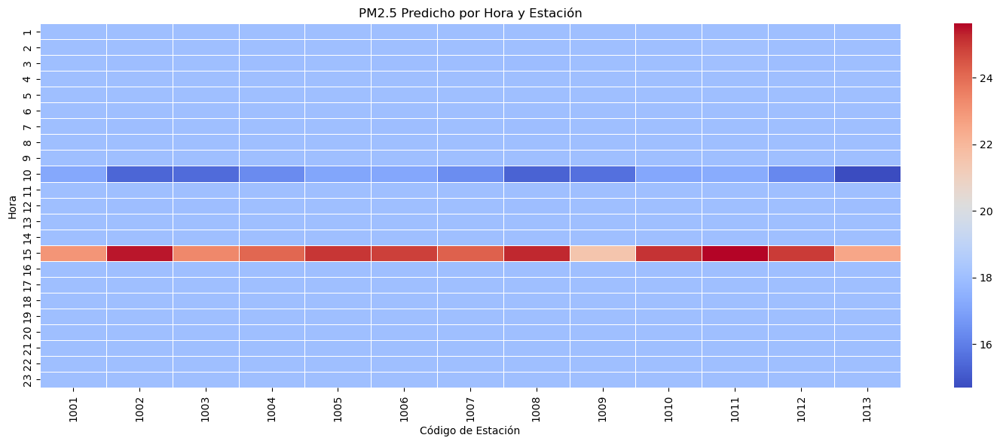

In [179]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Asegurarse que 'Codigo' sea string para mantener formato uniforme
df_nuevos_puntos['Codigo'] = df_nuevos_puntos['Codigo'].astype(str)

# Crear tabla tipo matriz: filas = hora, columnas = estaciones, valores = PM2.5 predicho
tabla_pm25 = df_nuevos_puntos.pivot_table(
    index='hora',
    columns='Codigo',
    values='pm25_predicho'
)

# Graficar heatmap
plt.figure(figsize=(15, 6))
sns.heatmap(tabla_pm25, cmap='coolwarm', annot=False, linewidths=0.5)

plt.title('PM2.5 Predicho por Hora y Estación')
plt.xlabel('Código de Estación')
plt.ylabel('Hora')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


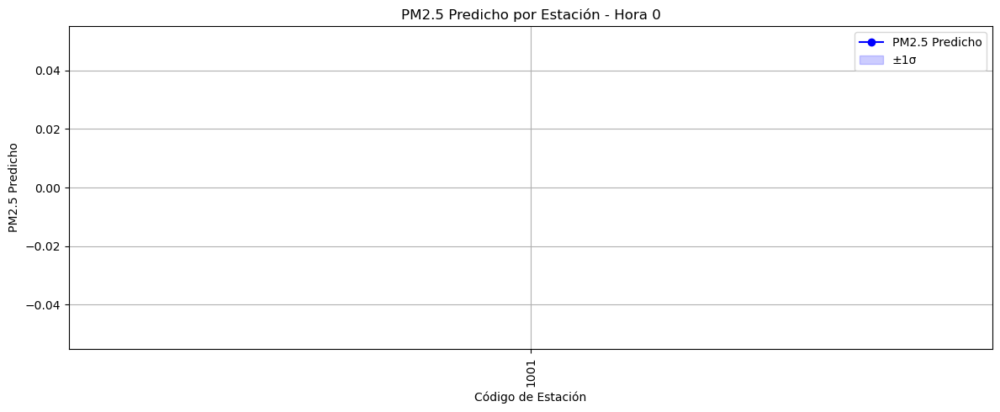

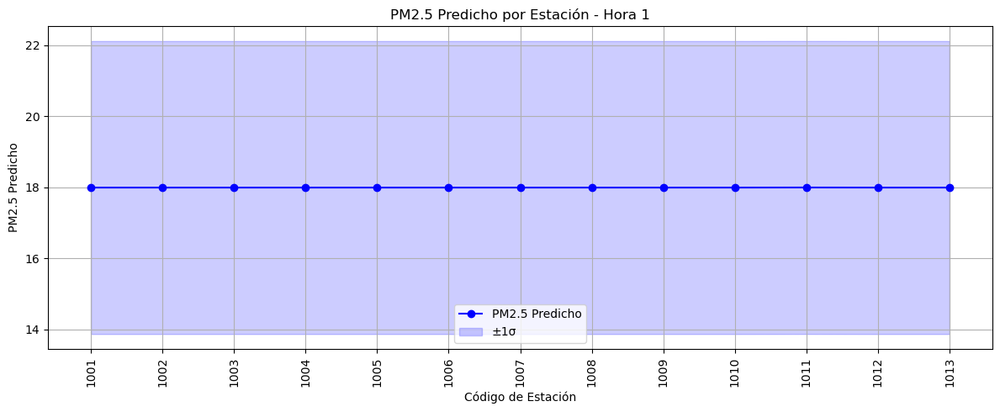

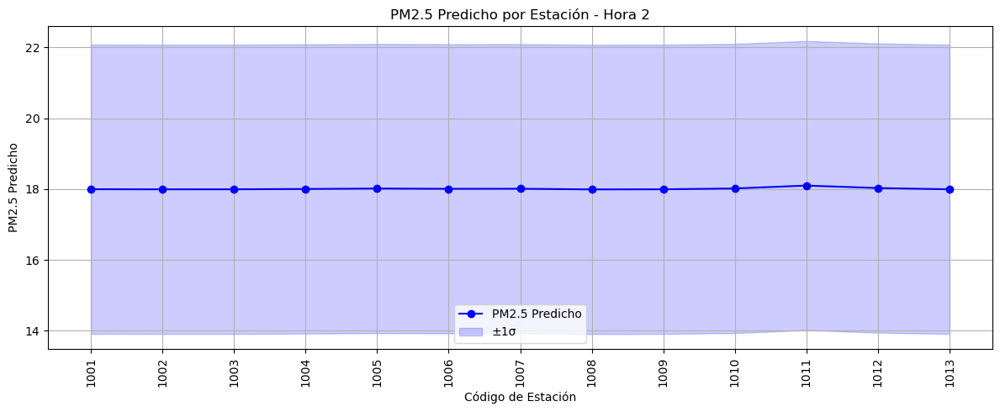

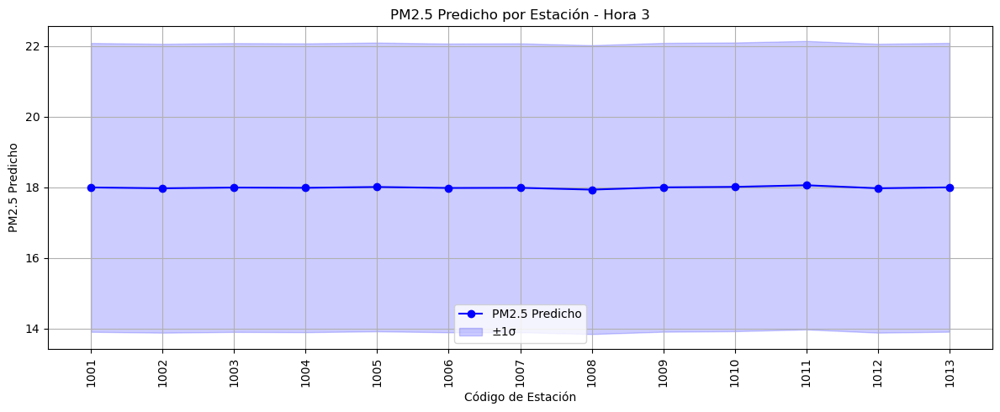

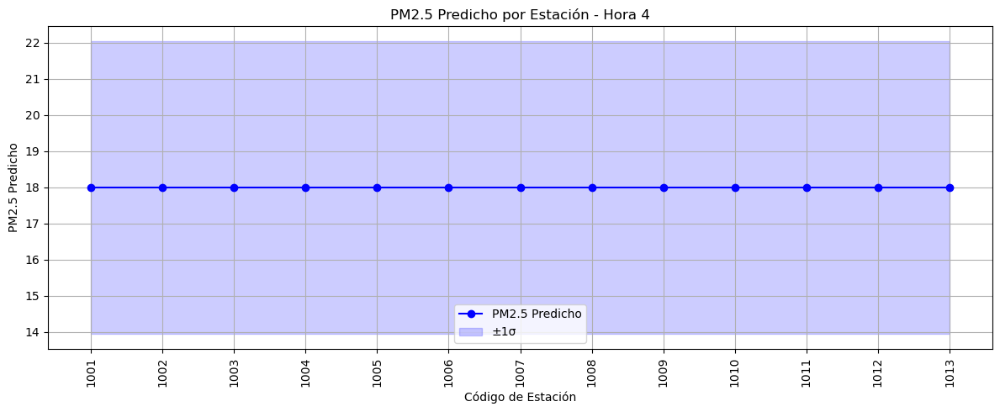

...

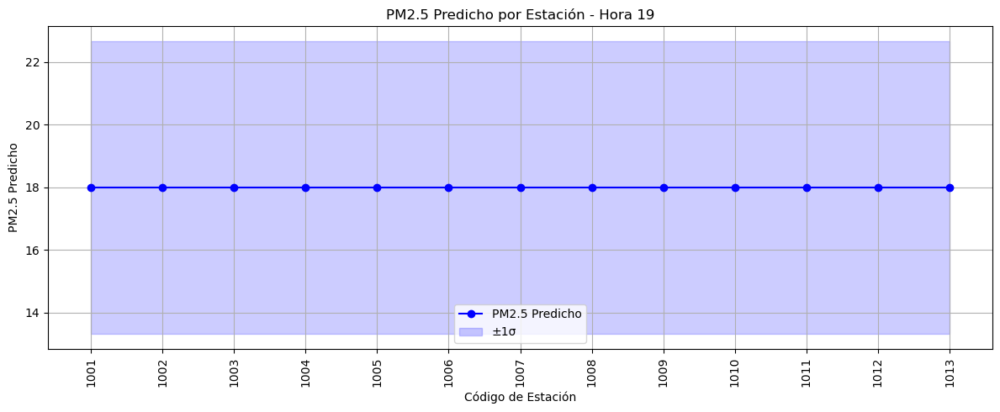

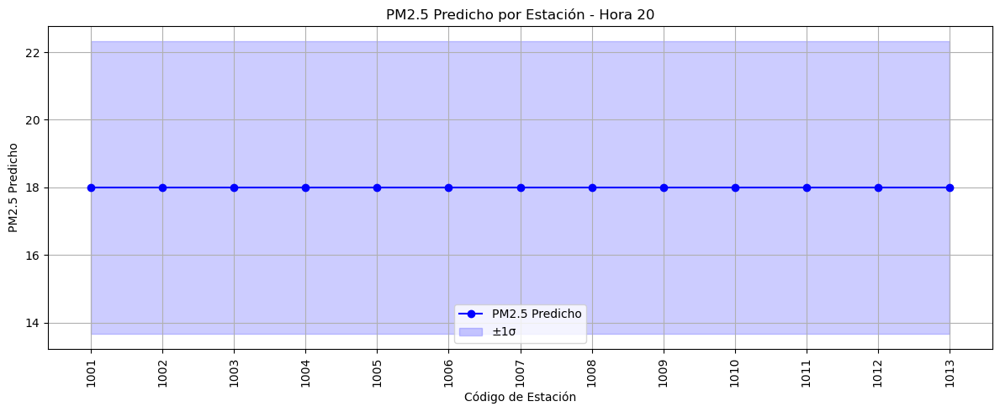

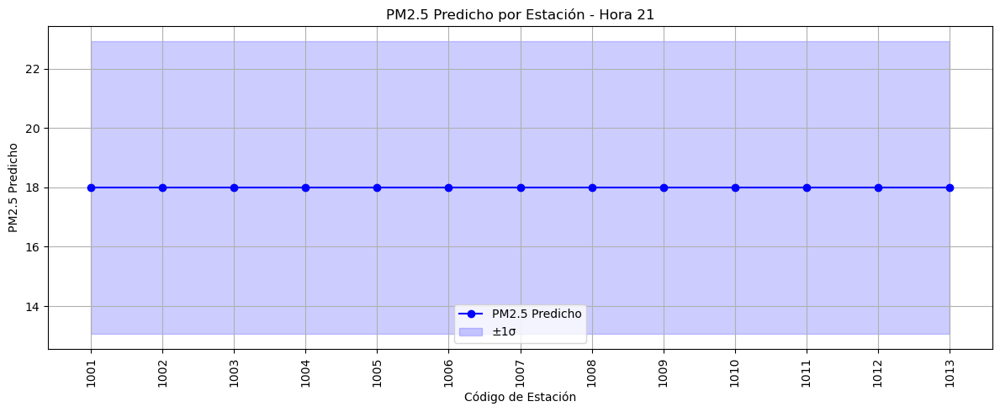

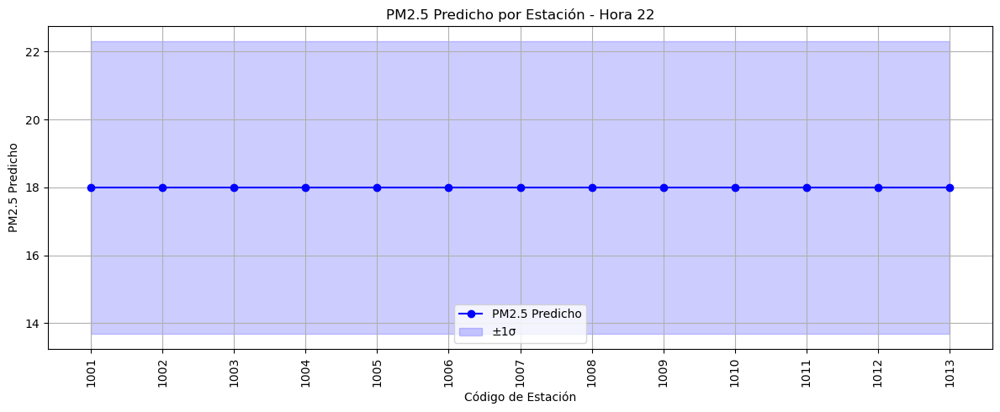

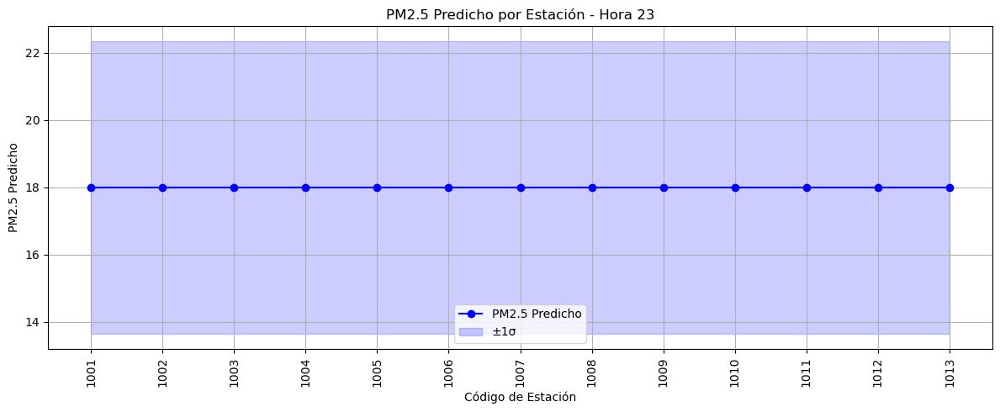

In [180]:
import matplotlib.pyplot as plt

# Asegurarse de que 'Codigo' sea string
df_nuevos_puntos['Codigo'] = df_nuevos_puntos['Codigo'].astype(str)

# Estaciones ordenadas
codigos_estaciones = sorted(df_nuevos_puntos['Codigo'].unique())

# Gráficos por cada hora
for h in range(24):
    df_h = df_nuevos_puntos[df_nuevos_puntos['hora'] == h]
    
    if df_h.empty:
        continue

    # Ordenar para que estén alineadas las estaciones
    df_h = df_h.set_index('Codigo').reindex(codigos_estaciones).reset_index()

    # Gráfico
    plt.figure(figsize=(12, 5))
    plt.plot(df_h['Codigo'], df_h['pm25_predicho'], marker='o', label='PM2.5 Predicho', color='blue')
    
    if 'pm25_std' in df_h.columns:
        plt.fill_between(
            df_h['Codigo'],
            df_h['pm25_predicho'] - df_h['pm25_std'],
            df_h['pm25_predicho'] + df_h['pm25_std'],
            color='blue', alpha=0.2, label='±1σ'
        )

    plt.title(f'PM2.5 Predicho por Estación - Hora {h}')
    plt.xlabel('Código de Estación')
    plt.ylabel('PM2.5 Predicho')
    plt.xticks(rotation=90)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


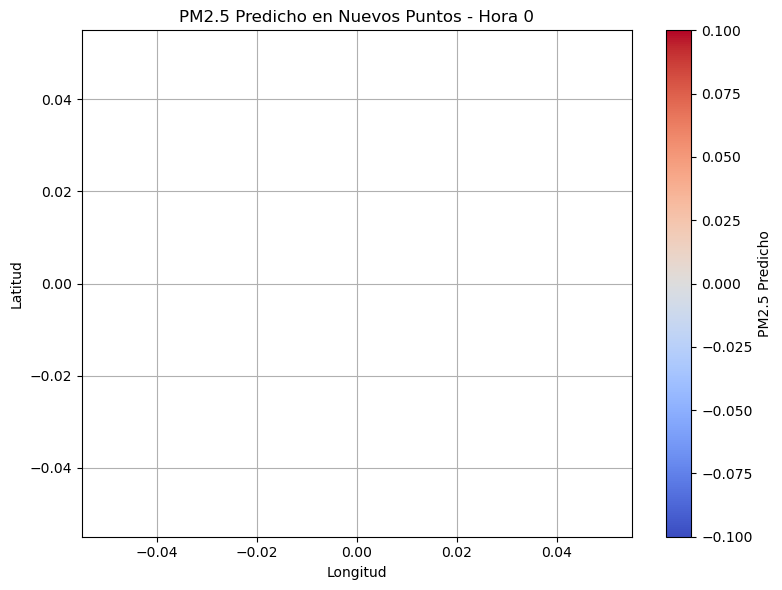

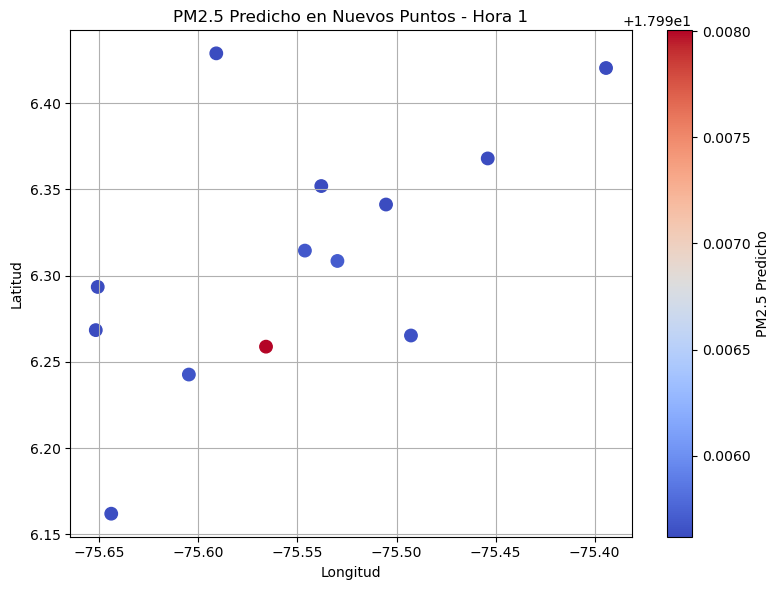

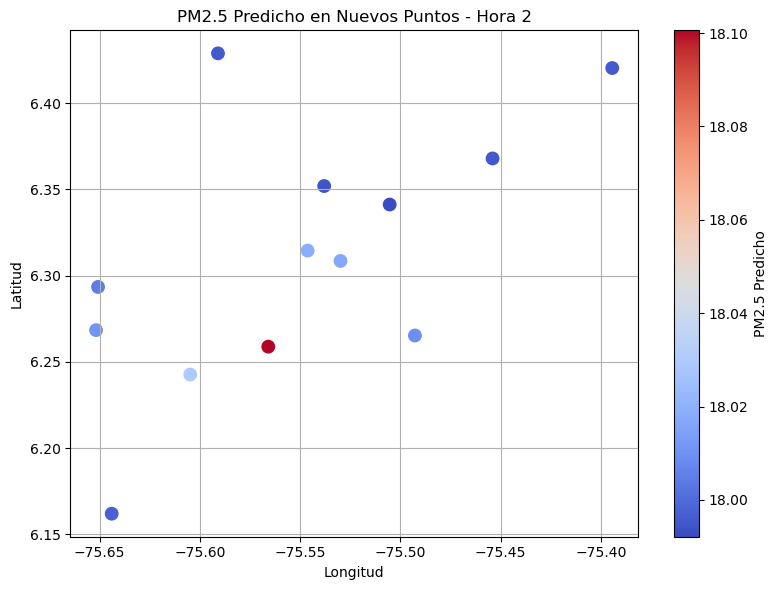

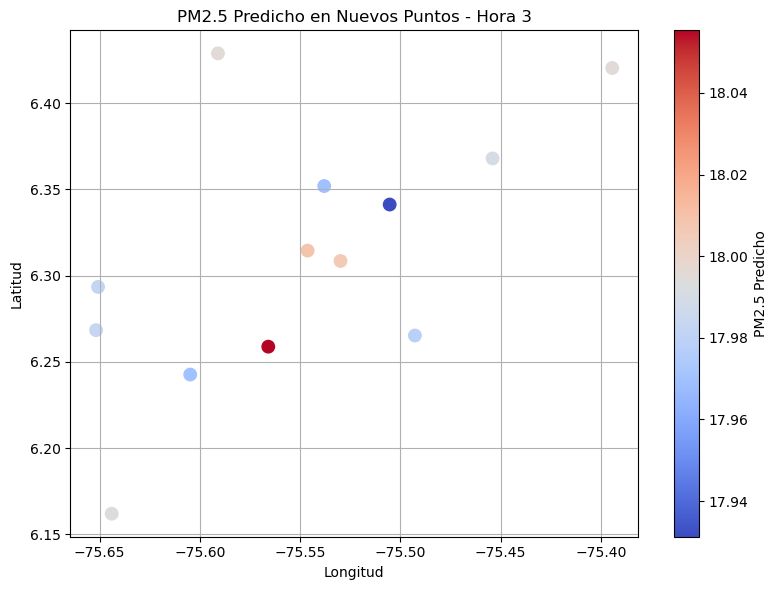

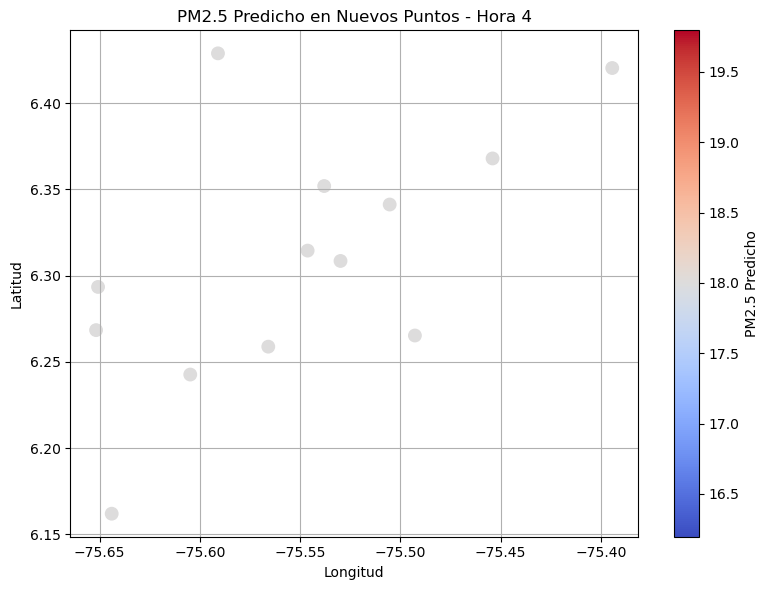

...

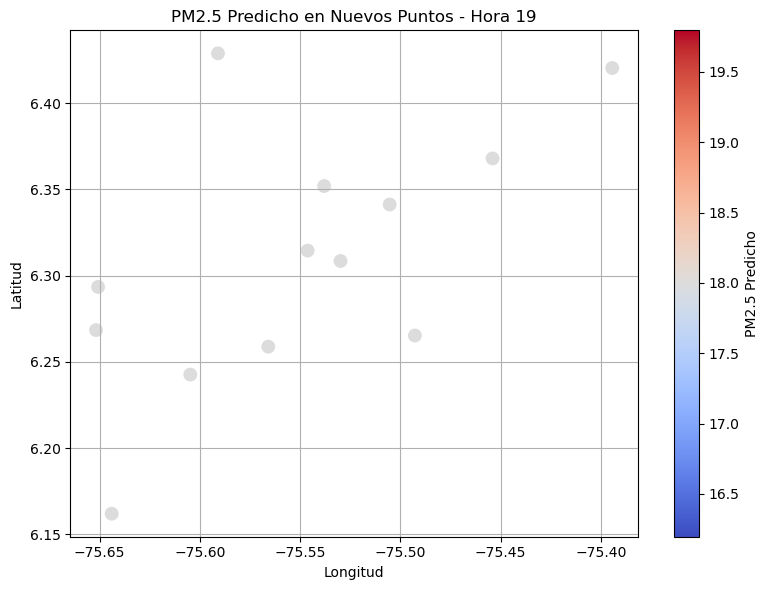

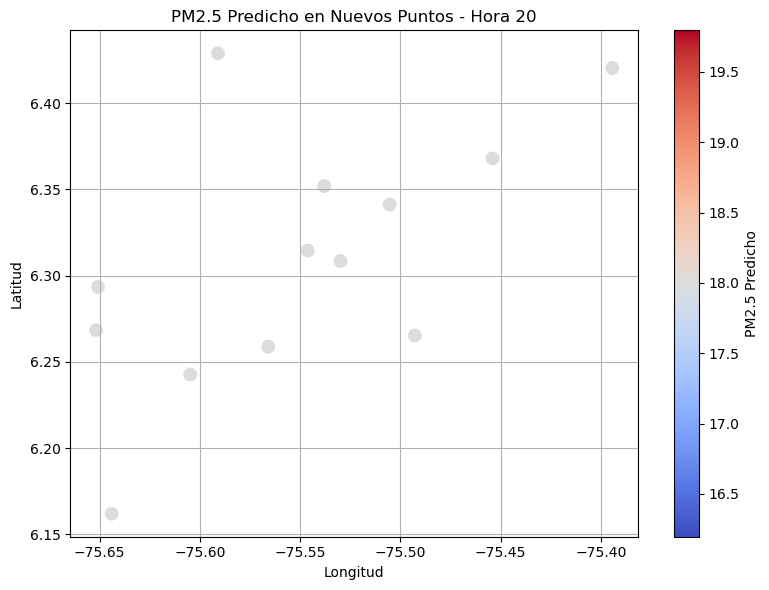

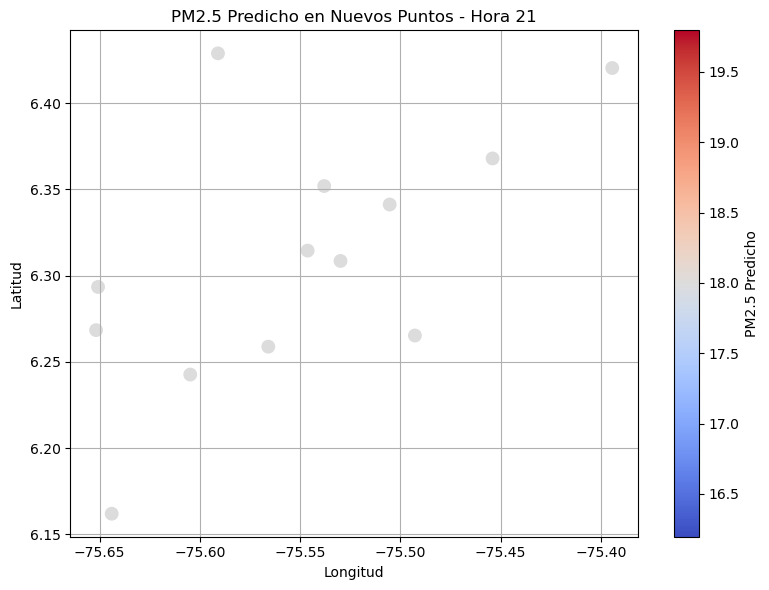

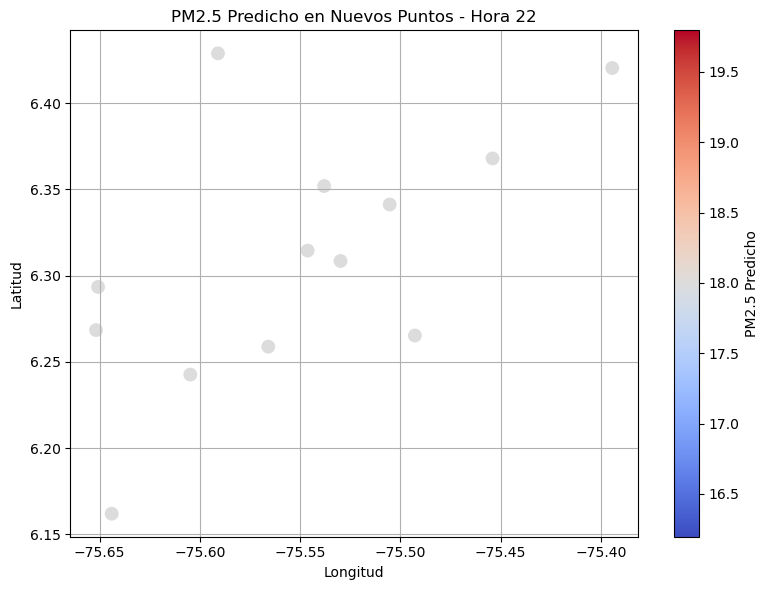

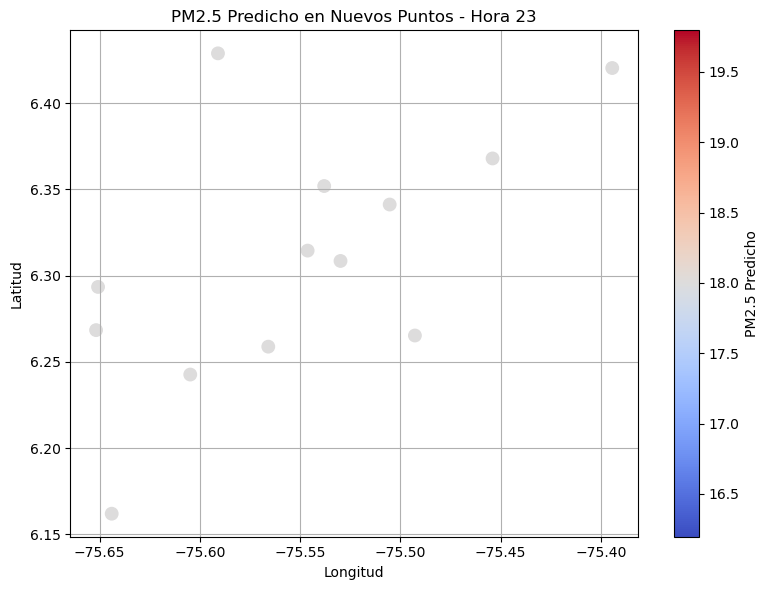

In [182]:
import matplotlib.pyplot as plt

# Iterar por hora
for h in range(24):
    df_h = df_nuevos_puntos[df_nuevos_puntos['hora'] == h]

    if df_h.empty:
        continue

    plt.figure(figsize=(8, 6))
    sc = plt.scatter(
        df_h['Longitud'], df_h['Latitud'],
        c=df_h['pm25_predicho'], cmap='coolwarm', s=80
    )
    plt.colorbar(sc, label='PM2.5 Predicho')
    plt.title(f'PM2.5 Predicho en Nuevos Puntos - Hora {h}')
    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
